In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import optuna

c:\Users\Max\anaconda3\envs\sdypy_dev\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
import numpy as np
from scipy.signal import gausspulse
import matplotlib.pyplot as plt

from filter_tc.sensitivity_analysis.data_generation import *

In [4]:
loading = 'compression'

event_to_trend_amplitudes = np.arange(0.1, 0.7, 0.1)
event_length_to_trend_periods = np.arange(0.1, 0.7, 0.1)
time_shifts = np.arange(0.005, 0.025, 0.005)

amplitude_shift = 0.5

datasets = {}

for event_to_trend_amplitude in event_to_trend_amplitudes:
    for event_length_to_trend_period in event_length_to_trend_periods:
        for time_shift in time_shifts:
            trend, events, noise_amplitude, no_samples = \
                create_inputs(
                    event_to_trend_amplitude,
                    event_length_to_trend_period,
                    noise_to_trend = 1/50,
                    no_samples = 1000,
                    trend_freq = 4.0,
                    trend_amplitude = 200
                )
            t, y_measurements, input_, y_lf, y_events, y_noise = \
                generate_test_data(
                    trend,
                    events,
                    no_samples,
                    noise_amplitude,
                    loading,
                    amplitude_shift,
                    time_shift
                )
            datasets[(event_to_trend_amplitude, event_length_to_trend_period, time_shift)] = {
                't':t,
                'y_measurements':y_measurements,
                'input_':input_,
                'y_lf':y_lf,
                'y_events':y_events,
                'y_noise':y_noise
            }

In [5]:
import optuna
from filter_tc.particle_filter import ParticleFilter
from filter_tc.utils import learn_alpha
from sklearn.metrics import mean_squared_error



def evaluate_pf(pf_settings, inputs, measurement, y_lf, fold=5):
    mses = []
    for i in range(fold):
        pf = ParticleFilter(
            num_particles=pf_settings['num_particles'],
            r_measurement_noise=pf_settings['r_measurement_noise'],
            q_process_noise=np.array([pf_settings['q_process_noise_0'], 1]),
            loc=-pf_settings['loc'],
            alpha=pf_settings['pf_alpha']
        )
        predictions = pf.filter(measurement, inputs, loading=loading)
        mses.append(mean_squared_error(predictions, y_lf))
    return np.mean(mses)

def objective(trial, measurement, inputs, y_lf):
    pf_alpha = learn_alpha(inputs[0].reshape(-1, 1), measurement)
    # Suggest values for the hyperparameters
    num_particles = 1000 #trial.suggest_int('num_particles', 100, 2000)
    r_measurement_noise = trial.suggest_float('r_measurement_noise', 1e-4, 1e2, log=True)
    q_process_noise_0 = trial.suggest_float('q_process_noise_0',1e-2, 1e2, log=True)
    loc = trial.suggest_float('loc', 1e-4, 1e2, log=True)
  
    pf_settings = {
        'num_particles': num_particles,
        'r_measurement_noise': r_measurement_noise,
        'q_process_noise_0': q_process_noise_0,
        'loc': loc,
        'pf_alpha': pf_alpha
    }
    # Evaluate your Particle Filter
    try:
        metric = evaluate_pf(pf_settings, inputs, measurement, y_lf)  # You'll need to define this function
    except:
        print('failed metric for parameters: ', 'num_particles:', num_particles, 'r_measurement_noise:', r_measurement_noise, 'q_process_noise_0:', q_process_noise_0, 'loc:', loc)
        metric = np.inf
    return metric

In [6]:
from functools import partial

studies = {}
best_params = {}
for key_ in list(datasets.keys()):
    inputs = np.vstack([datasets[key_]['input_'], np.insert(np.diff(datasets[key_]['input_']),0,0)])
    measurement = datasets[key_]['y_measurements']
    y_lf = datasets[key_]['y_lf']
    objective_partial = partial(objective, measurement=measurement, inputs=inputs, y_lf=y_lf)
    study = optuna.create_study(direction='minimize')
    study.optimize(objective_partial, n_trials=100)  # Adjust n_trials to your preference
    best_params[key_] = study.best_params
    studies[key_] = study
    print("Best parameters for event_to_trend_amplitude:",key_[0],
          ' and event_length_to_trend_period:',key_[1],
          ': ', best_params[key_])

[I 2024-03-14 21:41:36,374] A new study created in memory with name: no-name-148c9926-9ebd-4668-a592-7bfb8911b015
[I 2024-03-14 21:41:40,282] Trial 0 finished with value: 15.097870690960317 and parameters: {'r_measurement_noise': 0.051686424648302705, 'q_process_noise_0': 1.4388416276627163, 'loc': 0.030904016483672907}. Best is trial 0 with value: 15.097870690960317.
[I 2024-03-14 21:41:44,051] Trial 1 finished with value: 25.324249179145493 and parameters: {'r_measurement_noise': 0.4052816251120658, 'q_process_noise_0': 42.44641493894711, 'loc': 2.092031938814059}. Best is trial 0 with value: 15.097870690960317.
[I 2024-03-14 21:41:47,761] Trial 2 finished with value: 6448.926810735048 and parameters: {'r_measurement_noise': 0.23702137616552638, 'q_process_noise_0': 49.55169776866293, 'loc': 81.12063186910696}. Best is trial 0 with value: 15.097870690960317.
[I 2024-03-14 21:41:50,511] Trial 3 finished with value: 221.63421446056867 and parameters: {'r_measurement_noise': 0.027998528

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.211457751135852, 'q_process_noise_0': 0.7911146598499116, 'loc': 1.9582876842846466}


[I 2024-03-14 21:46:02,318] Trial 0 finished with value: 20.43159627978979 and parameters: {'r_measurement_noise': 0.16802911616347402, 'q_process_noise_0': 2.0997986116090575, 'loc': 0.11006689126306142}. Best is trial 0 with value: 20.43159627978979.
[I 2024-03-14 21:46:04,831] Trial 1 finished with value: 275.28245624560776 and parameters: {'r_measurement_noise': 0.406833079873098, 'q_process_noise_0': 9.2076330811245, 'loc': 16.868564322303506}. Best is trial 0 with value: 20.43159627978979.
[I 2024-03-14 21:46:07,028] Trial 2 finished with value: 865.424615079624 and parameters: {'r_measurement_noise': 0.0012048353881641408, 'q_process_noise_0': 0.13864939585113625, 'loc': 0.003309082143743408}. Best is trial 0 with value: 20.43159627978979.
[I 2024-03-14 21:46:09,115] Trial 3 finished with value: 1082.3590821929442 and parameters: {'r_measurement_noise': 0.0061490505791065376, 'q_process_noise_0': 0.05392311619021782, 'loc': 9.99015902291379}. Best is trial 0 with value: 20.43159

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.0429472065610635, 'q_process_noise_0': 1.0817609360183362, 'loc': 0.002200899880678545}


[I 2024-03-14 21:50:08,262] Trial 0 finished with value: 323.8533757464936 and parameters: {'r_measurement_noise': 26.536296474484224, 'q_process_noise_0': 8.207244833839125, 'loc': 0.25245215491376766}. Best is trial 0 with value: 323.8533757464936.
[I 2024-03-14 21:50:10,541] Trial 1 finished with value: 3862.3016219513133 and parameters: {'r_measurement_noise': 0.0008924532338859902, 'q_process_noise_0': 1.3547820253067109, 'loc': 62.22966901181663}. Best is trial 0 with value: 323.8533757464936.
[I 2024-03-14 21:50:13,364] Trial 2 finished with value: 191.0095634635405 and parameters: {'r_measurement_noise': 20.499162923881038, 'q_process_noise_0': 2.4840365347094178, 'loc': 0.0002623083012987599}. Best is trial 2 with value: 191.0095634635405.
[I 2024-03-14 21:50:15,876] Trial 3 finished with value: 25.428165935014242 and parameters: {'r_measurement_noise': 2.4187121679313353, 'q_process_noise_0': 4.392685703462469, 'loc': 0.748652331881121}. Best is trial 3 with value: 25.4281659

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.9541295854135675, 'q_process_noise_0': 1.485753938427808, 'loc': 0.40259219172790495}


[I 2024-03-14 21:54:24,249] Trial 0 finished with value: 30.62550388487954 and parameters: {'r_measurement_noise': 0.00016764003501733998, 'q_process_noise_0': 11.634693262217448, 'loc': 2.7775741965814147}. Best is trial 0 with value: 30.62550388487954.
[I 2024-03-14 21:54:26,634] Trial 1 finished with value: 26.42056007895686 and parameters: {'r_measurement_noise': 0.0012081399460663505, 'q_process_noise_0': 42.55373684245442, 'loc': 0.5132063151139472}. Best is trial 1 with value: 26.42056007895686.
[I 2024-03-14 21:54:28,719] Trial 2 finished with value: 2970.6320824454483 and parameters: {'r_measurement_noise': 0.002966073955884526, 'q_process_noise_0': 0.36459987283283973, 'loc': 0.007660614214924996}. Best is trial 1 with value: 26.42056007895686.
[I 2024-03-14 21:54:31,380] Trial 3 finished with value: 2039.9100703847132 and parameters: {'r_measurement_noise': 59.60605621145428, 'q_process_noise_0': 47.571291317166754, 'loc': 1.095896451925623}. Best is trial 1 with value: 26.4

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.055286171265107674, 'q_process_noise_0': 1.6749043294072727, 'loc': 0.03423898804244601}


[I 2024-03-14 21:58:25,685] Trial 0 finished with value: 20.685106919261973 and parameters: {'r_measurement_noise': 0.663675941336012, 'q_process_noise_0': 0.40106992272792014, 'loc': 0.16779440288578723}. Best is trial 0 with value: 20.685106919261973.
[I 2024-03-14 21:58:28,448] Trial 1 finished with value: 491.32158077420036 and parameters: {'r_measurement_noise': 20.708775125237555, 'q_process_noise_0': 0.03200166844274982, 'loc': 46.472077286163056}. Best is trial 0 with value: 20.685106919261973.
[I 2024-03-14 21:58:31,118] Trial 2 finished with value: 492.11016381449673 and parameters: {'r_measurement_noise': 32.46191432728234, 'q_process_noise_0': 9.857055137621137, 'loc': 0.5059318688262807}. Best is trial 0 with value: 20.685106919261973.
[I 2024-03-14 21:58:33,444] Trial 3 finished with value: 55.50309088122755 and parameters: {'r_measurement_noise': 0.18528808609624908, 'q_process_noise_0': 0.4090778735822542, 'loc': 0.00029935578000702865}. Best is trial 0 with value: 20.6

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0016704437448000903, 'q_process_noise_0': 0.9713481207216025, 'loc': 0.7477427162885852}


[I 2024-03-14 22:02:23,565] Trial 0 finished with value: 724.0531042878783 and parameters: {'r_measurement_noise': 20.714460623928506, 'q_process_noise_0': 0.025511420851259976, 'loc': 0.11570226250055449}. Best is trial 0 with value: 724.0531042878783.
[I 2024-03-14 22:02:26,056] Trial 1 finished with value: 27.19900961309593 and parameters: {'r_measurement_noise': 0.019733526241485933, 'q_process_noise_0': 0.9830503095577457, 'loc': 0.06739727656086085}. Best is trial 1 with value: 27.19900961309593.
[I 2024-03-14 22:02:28,461] Trial 2 finished with value: 32.4304279983417 and parameters: {'r_measurement_noise': 0.0009238503826201514, 'q_process_noise_0': 3.7501000033286207, 'loc': 0.0006221123799182789}. Best is trial 1 with value: 27.19900961309593.
[I 2024-03-14 22:02:30,460] Trial 3 finished with value: 859.158728142644 and parameters: {'r_measurement_noise': 0.6618575863186917, 'q_process_noise_0': 0.013663860800118287, 'loc': 0.027704436165796043}. Best is trial 1 with value: 2

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0002866038077606509, 'q_process_noise_0': 1.2829480660469774, 'loc': 0.00023627576508110143}


[I 2024-03-14 22:06:19,002] Trial 0 finished with value: 32.744536034774086 and parameters: {'r_measurement_noise': 0.007012776981446394, 'q_process_noise_0': 4.580242767454816, 'loc': 0.052930527485584807}. Best is trial 0 with value: 32.744536034774086.
[I 2024-03-14 22:06:20,984] Trial 1 finished with value: 1859.9556003852667 and parameters: {'r_measurement_noise': 0.027970295724218868, 'q_process_noise_0': 0.012067294333403464, 'loc': 0.0036914140599690407}. Best is trial 0 with value: 32.744536034774086.
[I 2024-03-14 22:06:23,733] Trial 2 finished with value: 53.23816223343935 and parameters: {'r_measurement_noise': 5.398726825925551, 'q_process_noise_0': 0.948966654468291, 'loc': 1.4043917773698429}. Best is trial 0 with value: 32.744536034774086.
[I 2024-03-14 22:06:25,926] Trial 3 finished with value: 3309.4069589869796 and parameters: {'r_measurement_noise': 0.004588802063811514, 'q_process_noise_0': 0.1631077401752073, 'loc': 27.67435026504509}. Best is trial 0 with value: 

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0016734040390215961, 'q_process_noise_0': 1.8458786069064017, 'loc': 0.2741144636420867}


[I 2024-03-14 22:10:15,984] Trial 0 finished with value: 2959.4586000713953 and parameters: {'r_measurement_noise': 20.488572440756496, 'q_process_noise_0': 0.011008329080536103, 'loc': 75.36396993910598}. Best is trial 0 with value: 2959.4586000713953.
[I 2024-03-14 22:10:18,155] Trial 1 finished with value: 2518.7134171839016 and parameters: {'r_measurement_noise': 57.47734842383364, 'q_process_noise_0': 0.035876982213021505, 'loc': 0.000286133364302499}. Best is trial 1 with value: 2518.7134171839016.
[I 2024-03-14 22:10:20,740] Trial 2 finished with value: 32.988094080764526 and parameters: {'r_measurement_noise': 0.00012566625215591973, 'q_process_noise_0': 2.6507952699049238, 'loc': 0.10400706509948242}. Best is trial 2 with value: 32.988094080764526.
[I 2024-03-14 22:10:22,862] Trial 3 finished with value: 2779.9445199865954 and parameters: {'r_measurement_noise': 2.886930482780645, 'q_process_noise_0': 0.0498799056303282, 'loc': 0.006272664175969471}. Best is trial 2 with value

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.006476900342152148, 'q_process_noise_0': 2.1415710049518064, 'loc': 1.8746560659398162}


[I 2024-03-14 22:14:17,355] Trial 0 finished with value: 113.00019413560588 and parameters: {'r_measurement_noise': 1.562026155319309, 'q_process_noise_0': 0.08314428924052672, 'loc': 0.004297080360126099}. Best is trial 0 with value: 113.00019413560588.
[I 2024-03-14 22:14:19,859] Trial 1 finished with value: 51.70149071058573 and parameters: {'r_measurement_noise': 0.03671016022112251, 'q_process_noise_0': 50.901432596081776, 'loc': 5.59687885689296}. Best is trial 1 with value: 51.70149071058573.
[I 2024-03-14 22:14:22,543] Trial 2 finished with value: 155.24445244177943 and parameters: {'r_measurement_noise': 2.617015316518749, 'q_process_noise_0': 0.4322211112817007, 'loc': 17.72554035554835}. Best is trial 1 with value: 51.70149071058573.
[I 2024-03-14 22:14:24,808] Trial 3 finished with value: 431.20727488407573 and parameters: {'r_measurement_noise': 0.1820397331901549, 'q_process_noise_0': 0.12741455402147478, 'loc': 14.326964078321463}. Best is trial 1 with value: 51.70149071

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.008034955715150756, 'q_process_noise_0': 0.7209985106280716, 'loc': 0.2820711277622904}


[I 2024-03-14 22:18:19,558] Trial 0 finished with value: 214.08333006447123 and parameters: {'r_measurement_noise': 2.349695105757309, 'q_process_noise_0': 40.174737792274804, 'loc': 17.445742558488814}. Best is trial 0 with value: 214.08333006447123.
[I 2024-03-14 22:18:21,718] Trial 1 finished with value: 700.0889649688428 and parameters: {'r_measurement_noise': 0.0003397380145969086, 'q_process_noise_0': 0.41880388477700076, 'loc': 0.00484472062970848}. Best is trial 0 with value: 214.08333006447123.
[I 2024-03-14 22:18:23,976] Trial 2 finished with value: 449.2517245152743 and parameters: {'r_measurement_noise': 0.014812390185143118, 'q_process_noise_0': 0.7018650376599137, 'loc': 0.15672977420359296}. Best is trial 0 with value: 214.08333006447123.
[I 2024-03-14 22:18:26,406] Trial 3 finished with value: 39.34593160528944 and parameters: {'r_measurement_noise': 0.0053654123576603, 'q_process_noise_0': 5.884015861331691, 'loc': 0.9306459974409244}. Best is trial 3 with value: 39.34

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.6676576385641595, 'q_process_noise_0': 1.2681777809151664, 'loc': 3.150766227922007}


[I 2024-03-14 22:22:20,628] Trial 0 finished with value: 43.03372803504424 and parameters: {'r_measurement_noise': 0.6775613440094479, 'q_process_noise_0': 17.622002460568343, 'loc': 0.0017477602892743123}. Best is trial 0 with value: 43.03372803504424.
[I 2024-03-14 22:22:23,228] Trial 1 finished with value: 44.042065651572756 and parameters: {'r_measurement_noise': 1.30191428498429, 'q_process_noise_0': 1.0352679403106744, 'loc': 0.802797456806686}. Best is trial 0 with value: 43.03372803504424.
[I 2024-03-14 22:22:25,879] Trial 2 finished with value: 53.971814809711724 and parameters: {'r_measurement_noise': 2.92823902355368, 'q_process_noise_0': 4.357788539368236, 'loc': 0.01570455817489759}. Best is trial 0 with value: 43.03372803504424.
[I 2024-03-14 22:22:28,368] Trial 3 finished with value: 34.47491244772571 and parameters: {'r_measurement_noise': 0.009597531458691145, 'q_process_noise_0': 1.7265770267145142, 'loc': 2.39182063347839}. Best is trial 3 with value: 34.474912447725

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.014623604099743072, 'q_process_noise_0': 2.0324705935719374, 'loc': 1.5894076675640967}


[I 2024-03-14 22:26:21,862] Trial 0 finished with value: 44.10828088686636 and parameters: {'r_measurement_noise': 0.5283637420407767, 'q_process_noise_0': 13.01380472560422, 'loc': 0.0007555861044762359}. Best is trial 0 with value: 44.10828088686636.
[I 2024-03-14 22:26:24,413] Trial 1 finished with value: 43.32602619432943 and parameters: {'r_measurement_noise': 0.33036822102775354, 'q_process_noise_0': 15.833185779249723, 'loc': 0.0003182376149286845}. Best is trial 1 with value: 43.32602619432943.
[I 2024-03-14 22:26:27,171] Trial 2 finished with value: 1176.829925958468 and parameters: {'r_measurement_noise': 59.77367255487357, 'q_process_noise_0': 1.713475233131096, 'loc': 0.0013783775041393573}. Best is trial 1 with value: 43.32602619432943.
[I 2024-03-14 22:26:29,763] Trial 3 finished with value: 85.37024642030596 and parameters: {'r_measurement_noise': 2.5873836755084345, 'q_process_noise_0': 8.769054463507935, 'loc': 11.099299487279279}. Best is trial 1 with value: 43.326026

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.018381017167740273, 'q_process_noise_0': 1.8401942502962396, 'loc': 1.8273934681711101}


[I 2024-03-14 22:30:23,507] Trial 0 finished with value: 50.47660430639253 and parameters: {'r_measurement_noise': 0.23813165672520453, 'q_process_noise_0': 11.049239982916035, 'loc': 0.04056023052632098}. Best is trial 0 with value: 50.47660430639253.
[I 2024-03-14 22:30:25,783] Trial 1 finished with value: 97.44551196908859 and parameters: {'r_measurement_noise': 0.022909111466561747, 'q_process_noise_0': 0.3736578627865865, 'loc': 0.41742038603494724}. Best is trial 0 with value: 50.47660430639253.
[I 2024-03-14 22:30:27,917] Trial 2 finished with value: 234.28387246734488 and parameters: {'r_measurement_noise': 0.001318138014444526, 'q_process_noise_0': 0.01941973816123313, 'loc': 0.0003171548215090147}. Best is trial 0 with value: 50.47660430639253.
[I 2024-03-14 22:30:30,432] Trial 3 finished with value: 44.44338610629436 and parameters: {'r_measurement_noise': 0.028824541931426664, 'q_process_noise_0': 29.10002703814752, 'loc': 2.0212913519174283}. Best is trial 3 with value: 44

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.28908942108588026, 'q_process_noise_0': 0.5637184236835951, 'loc': 1.8866957664006057}


[I 2024-03-14 22:34:28,290] Trial 0 finished with value: 51.54583645125426 and parameters: {'r_measurement_noise': 2.393628328741205, 'q_process_noise_0': 18.353621490149965, 'loc': 2.749635070588514}. Best is trial 0 with value: 51.54583645125426.
[I 2024-03-14 22:34:31,547] Trial 1 finished with value: 2364.5198835432097 and parameters: {'r_measurement_noise': 85.00175263380821, 'q_process_noise_0': 0.36761451606417755, 'loc': 0.0005132119327982004}. Best is trial 0 with value: 51.54583645125426.
[I 2024-03-14 22:34:34,245] Trial 2 finished with value: 98.00017125090412 and parameters: {'r_measurement_noise': 4.957854097082489, 'q_process_noise_0': 1.3877151256053746, 'loc': 0.17147091517188565}. Best is trial 0 with value: 51.54583645125426.
[I 2024-03-14 22:34:36,830] Trial 3 finished with value: 54.65337531051638 and parameters: {'r_measurement_noise': 0.1756255013954289, 'q_process_noise_0': 9.526624652706724, 'loc': 0.000252974470500161}. Best is trial 0 with value: 51.545836451

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.007245111043369308, 'q_process_noise_0': 2.206372235530858, 'loc': 2.377882646134942}


[I 2024-03-14 22:38:38,696] Trial 0 finished with value: 452.6510865709026 and parameters: {'r_measurement_noise': 68.85440297197722, 'q_process_noise_0': 5.788493192988911, 'loc': 19.509871814019128}. Best is trial 0 with value: 452.6510865709026.
[I 2024-03-14 22:38:41,614] Trial 1 finished with value: 1478.6781869940692 and parameters: {'r_measurement_noise': 0.0006249566129099155, 'q_process_noise_0': 0.5823908018774364, 'loc': 0.44609683394298716}. Best is trial 0 with value: 452.6510865709026.
[I 2024-03-14 22:38:44,381] Trial 2 finished with value: 1507.3983561485943 and parameters: {'r_measurement_noise': 30.09240548545961, 'q_process_noise_0': 0.04342824005217862, 'loc': 0.016398428824174246}. Best is trial 0 with value: 452.6510865709026.
[I 2024-03-14 22:38:47,629] Trial 3 finished with value: 44.68456063663099 and parameters: {'r_measurement_noise': 0.1507549875873381, 'q_process_noise_0': 4.900378720161442, 'loc': 3.4812233176915104}. Best is trial 3 with value: 44.6845606

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.00015418743038167945, 'q_process_noise_0': 2.060315326841959, 'loc': 2.214670551990339}


[I 2024-03-14 22:44:03,562] Trial 0 finished with value: 2820.893557441598 and parameters: {'r_measurement_noise': 5.319088416926201, 'q_process_noise_0': 0.0635191738006555, 'loc': 7.91951942666964}. Best is trial 0 with value: 2820.893557441598.
[I 2024-03-14 22:44:06,404] Trial 1 finished with value: 2124.349574204974 and parameters: {'r_measurement_noise': 0.0062587062593082885, 'q_process_noise_0': 0.8837157868542584, 'loc': 0.5512493822404723}. Best is trial 1 with value: 2124.349574204974.
[I 2024-03-14 22:44:10,111] Trial 2 finished with value: 566.7757004935214 and parameters: {'r_measurement_noise': 28.762007003511982, 'q_process_noise_0': 15.179315177985604, 'loc': 0.00017228059332060285}. Best is trial 2 with value: 566.7757004935214.
[I 2024-03-14 22:44:13,483] Trial 3 finished with value: 52.26777607402099 and parameters: {'r_measurement_noise': 0.12143608345323471, 'q_process_noise_0': 9.729516934844556, 'loc': 0.0011158930484371065}. Best is trial 3 with value: 52.26777

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 1.5037848084510863, 'q_process_noise_0': 1.6037750997909728, 'loc': 5.063832325332993}


[I 2024-03-14 22:49:36,748] Trial 0 finished with value: 93.33258119051887 and parameters: {'r_measurement_noise': 0.07564597114274296, 'q_process_noise_0': 0.3584119362967664, 'loc': 0.03675890772413107}. Best is trial 0 with value: 93.33258119051887.
[I 2024-03-14 22:49:39,978] Trial 1 finished with value: 53.6473398838405 and parameters: {'r_measurement_noise': 0.023646813096372316, 'q_process_noise_0': 34.41857927602049, 'loc': 0.3505103519667332}. Best is trial 1 with value: 53.6473398838405.
[I 2024-03-14 22:49:43,006] Trial 2 finished with value: 128.0531838764157 and parameters: {'r_measurement_noise': 34.91682642610949, 'q_process_noise_0': 0.03171789846781889, 'loc': 0.005446603817934193}. Best is trial 1 with value: 53.6473398838405.
[I 2024-03-14 22:49:46,117] Trial 3 finished with value: 41.254376943127404 and parameters: {'r_measurement_noise': 0.04431481328422134, 'q_process_noise_0': 0.907807551696586, 'loc': 0.007607541072281512}. Best is trial 3 with value: 41.2543769

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.05084392069008957, 'q_process_noise_0': 0.8634014360486097, 'loc': 2.4908406096900957}


[I 2024-03-14 22:54:55,713] Trial 0 finished with value: 2016.6053623011508 and parameters: {'r_measurement_noise': 55.018199730926966, 'q_process_noise_0': 42.0589525009577, 'loc': 0.002991851521969485}. Best is trial 0 with value: 2016.6053623011508.
[I 2024-03-14 22:54:59,277] Trial 1 finished with value: 185.47573852266578 and parameters: {'r_measurement_noise': 13.339248561434152, 'q_process_noise_0': 3.659741943020815, 'loc': 0.00024240612818460217}. Best is trial 1 with value: 185.47573852266578.
[I 2024-03-14 22:55:02,707] Trial 2 finished with value: 55.144274923474846 and parameters: {'r_measurement_noise': 0.24211770994288917, 'q_process_noise_0': 1.566821648751829, 'loc': 0.020529378074145097}. Best is trial 2 with value: 55.144274923474846.
[I 2024-03-14 22:55:05,654] Trial 3 finished with value: 577.4159016283081 and parameters: {'r_measurement_noise': 0.26685680908406817, 'q_process_noise_0': 0.24576965024182026, 'loc': 0.0035820075879070884}. Best is trial 2 with value:

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 6.62574562936612, 'q_process_noise_0': 1.4954630378783458, 'loc': 9.284885802992322}


[I 2024-03-14 23:00:43,488] Trial 0 finished with value: 1765.3763522817667 and parameters: {'r_measurement_noise': 0.004921476549946501, 'q_process_noise_0': 0.13841355214129308, 'loc': 0.00016998553905839367}. Best is trial 0 with value: 1765.3763522817667.
[I 2024-03-14 23:00:47,248] Trial 1 finished with value: 57.113926546577225 and parameters: {'r_measurement_noise': 0.05365985173842961, 'q_process_noise_0': 10.16789746463251, 'loc': 0.0003637594810311011}. Best is trial 1 with value: 57.113926546577225.
[I 2024-03-14 23:00:51,144] Trial 2 finished with value: 263.65273617106703 and parameters: {'r_measurement_noise': 2.4603022423330745, 'q_process_noise_0': 0.7381182309951647, 'loc': 13.476329715447031}. Best is trial 1 with value: 57.113926546577225.
[I 2024-03-14 23:00:54,616] Trial 3 finished with value: 295.95847142438015 and parameters: {'r_measurement_noise': 0.00020341681257238356, 'q_process_noise_0': 21.63532931365709, 'loc': 18.961924141877336}. Best is trial 1 with va

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 1.6257514685005663, 'q_process_noise_0': 1.607143283231739, 'loc': 4.882995624550889}


[I 2024-03-14 23:06:51,036] Trial 0 finished with value: 2965.1989322695645 and parameters: {'r_measurement_noise': 0.0004639589756723119, 'q_process_noise_0': 0.02262499335514269, 'loc': 0.09587716318252108}. Best is trial 0 with value: 2965.1989322695645.
[I 2024-03-14 23:06:55,237] Trial 1 finished with value: 2559.218646276479 and parameters: {'r_measurement_noise': 64.62424422850582, 'q_process_noise_0': 0.5977482425463992, 'loc': 0.3553051202033428}. Best is trial 1 with value: 2559.218646276479.
[I 2024-03-14 23:06:59,390] Trial 2 finished with value: 2095.5541744769334 and parameters: {'r_measurement_noise': 80.77700905933685, 'q_process_noise_0': 2.6073375933521374, 'loc': 0.010991355727681354}. Best is trial 2 with value: 2095.5541744769334.
[I 2024-03-14 23:07:02,486] Trial 3 finished with value: 2775.3461389556687 and parameters: {'r_measurement_noise': 0.8386320278288338, 'q_process_noise_0': 0.04575452254088353, 'loc': 0.01134420948011224}. Best is trial 2 with value: 209

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.01230529271195391, 'q_process_noise_0': 31.913304699054258, 'loc': 3.0419518897259152}


[I 2024-03-14 23:12:58,322] Trial 0 finished with value: 242.79370482527347 and parameters: {'r_measurement_noise': 0.00022201268285967983, 'q_process_noise_0': 0.02080834094685942, 'loc': 0.00035391091903070606}. Best is trial 0 with value: 242.79370482527347.
[I 2024-03-14 23:13:01,919] Trial 1 finished with value: 4919.845954139671 and parameters: {'r_measurement_noise': 0.0020356904675046927, 'q_process_noise_0': 4.6365420789231795, 'loc': 73.53001832272797}. Best is trial 0 with value: 242.79370482527347.
[I 2024-03-14 23:13:05,997] Trial 2 finished with value: 1572.7690829362248 and parameters: {'r_measurement_noise': 4.397329158518194, 'q_process_noise_0': 0.40039238642438335, 'loc': 49.230487653754324}. Best is trial 0 with value: 242.79370482527347.
[I 2024-03-14 23:13:09,363] Trial 3 finished with value: 90.94077473258616 and parameters: {'r_measurement_noise': 0.1227180004526511, 'q_process_noise_0': 0.3092867721013956, 'loc': 0.003430246872314232}. Best is trial 3 with valu

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.006999851713404726, 'q_process_noise_0': 1.0024434672850282, 'loc': 2.9596970849449757}


[I 2024-03-14 23:19:25,072] Trial 0 finished with value: 559.7689391657979 and parameters: {'r_measurement_noise': 0.00017859107471269756, 'q_process_noise_0': 0.5453647533599153, 'loc': 5.382991905308059}. Best is trial 0 with value: 559.7689391657979.
[I 2024-03-14 23:19:28,325] Trial 1 finished with value: 897.2724247060371 and parameters: {'r_measurement_noise': 0.00016098362134290943, 'q_process_noise_0': 0.38986272476975, 'loc': 7.702136645420483}. Best is trial 0 with value: 559.7689391657979.
[I 2024-03-14 23:19:31,551] Trial 2 finished with value: 944.8510445915903 and parameters: {'r_measurement_noise': 0.00032774495356717226, 'q_process_noise_0': 0.031760215729136884, 'loc': 9.662365712813303}. Best is trial 0 with value: 559.7689391657979.
[I 2024-03-14 23:19:35,157] Trial 3 finished with value: 69.40905776438083 and parameters: {'r_measurement_noise': 0.00015881764913044553, 'q_process_noise_0': 65.65170720404714, 'loc': 0.0010544538057313693}. Best is trial 3 with value: 

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 7.366457548006706, 'q_process_noise_0': 1.7234531055669604, 'loc': 9.713595639440094}


[I 2024-03-14 23:24:52,507] Trial 0 finished with value: 2132.1973842191474 and parameters: {'r_measurement_noise': 56.5314317647844, 'q_process_noise_0': 0.3095860165202822, 'loc': 0.012959560598667734}. Best is trial 0 with value: 2132.1973842191474.
[I 2024-03-14 23:24:54,931] Trial 1 finished with value: 66.26459268097712 and parameters: {'r_measurement_noise': 0.0005427926506012498, 'q_process_noise_0': 51.21256169374702, 'loc': 0.0005685733316290379}. Best is trial 1 with value: 66.26459268097712.
[I 2024-03-14 23:24:57,380] Trial 2 finished with value: 4696.4954789717085 and parameters: {'r_measurement_noise': 1.0348261220872064, 'q_process_noise_0': 0.5352473751717354, 'loc': 59.2599921571008}. Best is trial 1 with value: 66.26459268097712.
[I 2024-03-14 23:24:59,944] Trial 3 finished with value: 2025.2114381571068 and parameters: {'r_measurement_noise': 0.7162983323445813, 'q_process_noise_0': 50.7947771295251, 'loc': 48.77153679426837}. Best is trial 1 with value: 66.26459268

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.03087919089729984, 'q_process_noise_0': 2.634164076260121, 'loc': 3.485405267832323}


[I 2024-03-14 23:29:00,621] Trial 0 finished with value: 73.17532420795575 and parameters: {'r_measurement_noise': 1.4600015504589408, 'q_process_noise_0': 3.793817750530821, 'loc': 0.01691754414608949}. Best is trial 0 with value: 73.17532420795575.
[I 2024-03-14 23:29:02,710] Trial 1 finished with value: 2999.343037382919 and parameters: {'r_measurement_noise': 0.006835067821274551, 'q_process_noise_0': 0.032829950039283275, 'loc': 1.6137077665190604}. Best is trial 0 with value: 73.17532420795575.
[I 2024-03-14 23:29:05,189] Trial 2 finished with value: 63.384307235044744 and parameters: {'r_measurement_noise': 0.007427815498823509, 'q_process_noise_0': 42.57393817193349, 'loc': 0.04008755099566592}. Best is trial 2 with value: 63.384307235044744.
[I 2024-03-14 23:29:07,591] Trial 3 finished with value: 62.14828865560247 and parameters: {'r_measurement_noise': 0.0006675655671519758, 'q_process_noise_0': 27.693554105142667, 'loc': 0.1685274974233234}. Best is trial 3 with value: 62.1

Best parameters for event_to_trend_amplitude: 0.1  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.2000383266673267, 'q_process_noise_0': 3.192273297476799, 'loc': 3.4757707226270997}


[I 2024-03-14 23:33:05,121] Trial 0 finished with value: 49.4903934032292 and parameters: {'r_measurement_noise': 0.09098854142501565, 'q_process_noise_0': 11.271719973980657, 'loc': 0.0008876120744538636}. Best is trial 0 with value: 49.4903934032292.
[I 2024-03-14 23:33:07,892] Trial 1 finished with value: 296.90476915714765 and parameters: {'r_measurement_noise': 23.566264749280446, 'q_process_noise_0': 8.284282238585195, 'loc': 0.8060720087642058}. Best is trial 0 with value: 49.4903934032292.
[I 2024-03-14 23:33:10,507] Trial 2 finished with value: 13.171709759968731 and parameters: {'r_measurement_noise': 4.519760603043512, 'q_process_noise_0': 0.2985776857765534, 'loc': 6.682550902740888}. Best is trial 2 with value: 13.171709759968731.
[I 2024-03-14 23:33:13,252] Trial 3 finished with value: 444.16703738489196 and parameters: {'r_measurement_noise': 0.019179331566821427, 'q_process_noise_0': 0.02539522634023768, 'loc': 63.01665144412779}. Best is trial 2 with value: 13.17170975

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.010446747360653565, 'q_process_noise_0': 0.6455074589126848, 'loc': 0.0008137053712827765}


[I 2024-03-14 23:37:08,403] Trial 0 finished with value: 752.2565873946394 and parameters: {'r_measurement_noise': 6.425397107411536, 'q_process_noise_0': 0.02680056809586123, 'loc': 0.0007526332633610923}. Best is trial 0 with value: 752.2565873946394.
[I 2024-03-14 23:37:10,974] Trial 1 finished with value: 219.42849930041584 and parameters: {'r_measurement_noise': 0.0649614790301246, 'q_process_noise_0': 3.3132390829309366, 'loc': 14.812320933669714}. Best is trial 1 with value: 219.42849930041584.
[I 2024-03-14 23:37:13,591] Trial 2 finished with value: 51.73828165911821 and parameters: {'r_measurement_noise': 0.2746199332326594, 'q_process_noise_0': 5.52529916767311, 'loc': 0.00010170487456157751}. Best is trial 2 with value: 51.73828165911821.
[I 2024-03-14 23:37:15,948] Trial 3 finished with value: 50.665635943225006 and parameters: {'r_measurement_noise': 0.00032225333477787696, 'q_process_noise_0': 14.507868458038278, 'loc': 0.03383442269517075}. Best is trial 3 with value: 50

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 1.5166924375428166, 'q_process_noise_0': 0.7833676351633893, 'loc': 3.5657602901471837}


[I 2024-03-14 23:41:16,104] Trial 0 finished with value: 1242.3383443491598 and parameters: {'r_measurement_noise': 2.484926111096726, 'q_process_noise_0': 0.3411144292438559, 'loc': 0.00021722961521065194}. Best is trial 0 with value: 1242.3383443491598.
[I 2024-03-14 23:41:18,194] Trial 1 finished with value: 1778.148080737262 and parameters: {'r_measurement_noise': 0.001989098098983828, 'q_process_noise_0': 0.13841932530687853, 'loc': 0.008443429009725435}. Best is trial 0 with value: 1242.3383443491598.
[I 2024-03-14 23:41:20,701] Trial 2 finished with value: 47.43233960851439 and parameters: {'r_measurement_noise': 0.00031320952918188766, 'q_process_noise_0': 18.651913852985814, 'loc': 0.04833290962992929}. Best is trial 2 with value: 47.43233960851439.
[I 2024-03-14 23:41:22,926] Trial 3 finished with value: 1961.8834866409459 and parameters: {'r_measurement_noise': 0.0006126997542873294, 'q_process_noise_0': 0.5452095546880427, 'loc': 6.620656195230543}. Best is trial 2 with val

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.014563984553410117, 'q_process_noise_0': 1.641579671467856, 'loc': 0.011453596378306433}


[I 2024-03-14 23:45:21,717] Trial 0 finished with value: 155.7511776014695 and parameters: {'r_measurement_noise': 12.805706089934294, 'q_process_noise_0': 6.459141856630745, 'loc': 0.00643351769683778}. Best is trial 0 with value: 155.7511776014695.
[I 2024-03-14 23:45:24,612] Trial 1 finished with value: 2213.3983259763895 and parameters: {'r_measurement_noise': 86.14872385716883, 'q_process_noise_0': 3.6723127100966706, 'loc': 0.0001239300436305426}. Best is trial 0 with value: 155.7511776014695.
[I 2024-03-14 23:45:27,005] Trial 2 finished with value: 2302.8143738278336 and parameters: {'r_measurement_noise': 4.4025676873734385, 'q_process_noise_0': 0.25447154530169513, 'loc': 0.0004481541759054908}. Best is trial 0 with value: 155.7511776014695.
[I 2024-03-14 23:45:29,463] Trial 3 finished with value: 5880.184738611575 and parameters: {'r_measurement_noise': 0.1391156717187178, 'q_process_noise_0': 0.16309357227724283, 'loc': 49.97975023288091}. Best is trial 0 with value: 155.751

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.1096863018964099, 'q_process_noise_0': 1.6200489927982769, 'loc': 0.008096856038176656}


[I 2024-03-14 23:49:27,625] Trial 0 finished with value: 2250.7582141710595 and parameters: {'r_measurement_noise': 0.0027237665642684756, 'q_process_noise_0': 3.3135764661279667, 'loc': 49.29673801941273}. Best is trial 0 with value: 2250.7582141710595.
[I 2024-03-14 23:49:30,145] Trial 1 finished with value: 3061.5648349395533 and parameters: {'r_measurement_noise': 0.09743293185917795, 'q_process_noise_0': 4.574034390568186, 'loc': 57.35407845579187}. Best is trial 0 with value: 2250.7582141710595.
[I 2024-03-14 23:49:32,694] Trial 2 finished with value: 96.73260441431142 and parameters: {'r_measurement_noise': 1.5935335807469913, 'q_process_noise_0': 84.58127042441001, 'loc': 0.00046829142125752476}. Best is trial 2 with value: 96.73260441431142.
[I 2024-03-14 23:49:34,752] Trial 3 finished with value: 215.86636322674104 and parameters: {'r_measurement_noise': 0.001672058607743969, 'q_process_noise_0': 0.04533986938676348, 'loc': 0.005493366361588042}. Best is trial 2 with value: 9

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0005201146078472981, 'q_process_noise_0': 0.7807108064376997, 'loc': 0.3256537439789454}


[I 2024-03-14 23:53:27,906] Trial 0 finished with value: 78.23171616921113 and parameters: {'r_measurement_noise': 0.00020470929058218307, 'q_process_noise_0': 10.579489078074099, 'loc': 2.3165890059871592}. Best is trial 0 with value: 78.23171616921113.
[I 2024-03-14 23:53:30,417] Trial 1 finished with value: 72.51080457023849 and parameters: {'r_measurement_noise': 0.407452125025737, 'q_process_noise_0': 0.8125297171691388, 'loc': 0.0034055708259636283}. Best is trial 1 with value: 72.51080457023849.
[I 2024-03-14 23:53:32,878] Trial 2 finished with value: 21.17733558073399 and parameters: {'r_measurement_noise': 0.0011689898829488957, 'q_process_noise_0': 1.2991269450129355, 'loc': 0.014420805671383895}. Best is trial 2 with value: 21.17733558073399.
[I 2024-03-14 23:53:35,268] Trial 3 finished with value: 160.91877474616805 and parameters: {'r_measurement_noise': 0.0014404354232961845, 'q_process_noise_0': 0.880318822535261, 'loc': 0.00038556930727406496}. Best is trial 2 with valu

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.04150919018953941, 'q_process_noise_0': 1.2847168614003452, 'loc': 0.0895024302322225}


[I 2024-03-14 23:57:52,990] Trial 0 finished with value: 599.2929412514045 and parameters: {'r_measurement_noise': 40.09968191092934, 'q_process_noise_0': 0.6802131382052236, 'loc': 8.605084559502119}. Best is trial 0 with value: 599.2929412514045.
[I 2024-03-14 23:57:55,749] Trial 1 finished with value: 378.67128312986915 and parameters: {'r_measurement_noise': 27.51355182784635, 'q_process_noise_0': 1.327328676333833, 'loc': 2.1397930369078644}. Best is trial 1 with value: 378.67128312986915.
[I 2024-03-14 23:57:58,123] Trial 2 finished with value: 76.99792748285185 and parameters: {'r_measurement_noise': 0.005939532315968708, 'q_process_noise_0': 3.7580994253946822, 'loc': 0.001771604652194633}. Best is trial 2 with value: 76.99792748285185.
[I 2024-03-14 23:58:00,619] Trial 3 finished with value: 82.15726894884537 and parameters: {'r_measurement_noise': 0.16064844528452388, 'q_process_noise_0': 96.46943693093564, 'loc': 0.35731635233059367}. Best is trial 2 with value: 76.997927482

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.07319085983157635, 'q_process_noise_0': 1.804257784159071, 'loc': 0.0014974387625009424}


[I 2024-03-15 00:01:51,076] Trial 0 finished with value: 85.5184014226177 and parameters: {'r_measurement_noise': 0.00037094687193456934, 'q_process_noise_0': 42.82648327891834, 'loc': 0.0015081416916386309}. Best is trial 0 with value: 85.5184014226177.
[I 2024-03-15 00:01:53,235] Trial 1 finished with value: 2871.6297038322186 and parameters: {'r_measurement_noise': 0.11806392968572127, 'q_process_noise_0': 0.0747156085307311, 'loc': 0.5091807875222152}. Best is trial 0 with value: 85.5184014226177.
[I 2024-03-15 00:01:55,880] Trial 2 finished with value: 164.09031780018393 and parameters: {'r_measurement_noise': 9.2698382302927, 'q_process_noise_0': 5.317855860736739, 'loc': 0.05105902261269437}. Best is trial 0 with value: 85.5184014226177.
[I 2024-03-15 00:01:58,253] Trial 3 finished with value: 85.9683622695207 and parameters: {'r_measurement_noise': 0.0004242438965554436, 'q_process_noise_0': 68.91069029893468, 'loc': 0.003758654930282904}. Best is trial 0 with value: 85.5184014

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.060856190300593735, 'q_process_noise_0': 18.06124989892996, 'loc': 2.60829443210226}


[I 2024-03-15 00:05:59,693] Trial 0 finished with value: 730.8001624316797 and parameters: {'r_measurement_noise': 52.95256225631214, 'q_process_noise_0': 0.11191056463620946, 'loc': 0.21130057634602645}. Best is trial 0 with value: 730.8001624316797.
[I 2024-03-15 00:06:02,265] Trial 1 finished with value: 123.27791499941229 and parameters: {'r_measurement_noise': 0.2965223198327481, 'q_process_noise_0': 4.468618338459942, 'loc': 0.016270687812403865}. Best is trial 1 with value: 123.27791499941229.
[I 2024-03-15 00:06:04,307] Trial 2 finished with value: 233.36317674568687 and parameters: {'r_measurement_noise': 0.01967603034756235, 'q_process_noise_0': 0.012933968592741811, 'loc': 0.2538668620103644}. Best is trial 1 with value: 123.27791499941229.
[I 2024-03-15 00:06:06,697] Trial 3 finished with value: 25.103693596010658 and parameters: {'r_measurement_noise': 0.00026633632767025415, 'q_process_noise_0': 0.9476366707421369, 'loc': 0.2698790729051149}. Best is trial 3 with value: 2

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.06909761351064214, 'q_process_noise_0': 0.6640114320452969, 'loc': 1.5229141436505713}


[I 2024-03-15 00:10:10,903] Trial 0 finished with value: 793.6895384609759 and parameters: {'r_measurement_noise': 0.019015894806437783, 'q_process_noise_0': 0.17136412408724572, 'loc': 0.14175958059286276}. Best is trial 0 with value: 793.6895384609759.
[I 2024-03-15 00:10:13,634] Trial 1 finished with value: 115.54623093175772 and parameters: {'r_measurement_noise': 0.12722247097486697, 'q_process_noise_0': 72.01805473963887, 'loc': 0.0657968188401293}. Best is trial 1 with value: 115.54623093175772.
[I 2024-03-15 00:10:15,680] Trial 2 finished with value: 804.3574607249739 and parameters: {'r_measurement_noise': 0.0033046722671007116, 'q_process_noise_0': 0.19930838060665668, 'loc': 0.016766390310513447}. Best is trial 1 with value: 115.54623093175772.
[I 2024-03-15 00:10:18,086] Trial 3 finished with value: 247.96492391189526 and parameters: {'r_measurement_noise': 0.0008365652628840251, 'q_process_noise_0': 18.535284546813816, 'loc': 15.437126791293524}. Best is trial 1 with value

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.0002107857677357056, 'q_process_noise_0': 1.1267161725600523, 'loc': 0.10278445752715351}


[I 2024-03-15 00:14:16,758] Trial 0 finished with value: 1765.496372473134 and parameters: {'r_measurement_noise': 0.39956453534150493, 'q_process_noise_0': 0.02995679897040623, 'loc': 0.001348547083556196}. Best is trial 0 with value: 1765.496372473134.
[I 2024-03-15 00:14:19,787] Trial 1 finished with value: 2050.1750902836047 and parameters: {'r_measurement_noise': 77.60328949761562, 'q_process_noise_0': 1.8598436665335905, 'loc': 0.0024077259466530115}. Best is trial 0 with value: 1765.496372473134.
[I 2024-03-15 00:14:21,924] Trial 2 finished with value: 1695.8271420920762 and parameters: {'r_measurement_noise': 69.70986500921661, 'q_process_noise_0': 0.019443490772496425, 'loc': 0.001083218893048674}. Best is trial 2 with value: 1695.8271420920762.
[I 2024-03-15 00:14:24,218] Trial 3 finished with value: 1153.8779837623485 and parameters: {'r_measurement_noise': 46.055555451188575, 'q_process_noise_0': 0.08698159939435098, 'loc': 0.00032121600544290625}. Best is trial 3 with valu

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.00015006714628122843, 'q_process_noise_0': 4.822623558662553, 'loc': 3.4260981522120346}


[I 2024-03-15 00:18:24,910] Trial 0 finished with value: 3247.657550011272 and parameters: {'r_measurement_noise': 0.1665294496763694, 'q_process_noise_0': 0.22737007158214728, 'loc': 3.6110659393115276}. Best is trial 0 with value: 3247.657550011272.
[I 2024-03-15 00:18:27,524] Trial 1 finished with value: 111.31824774808801 and parameters: {'r_measurement_noise': 0.08010513552195353, 'q_process_noise_0': 1.419517985925791, 'loc': 0.0006668089017779465}. Best is trial 1 with value: 111.31824774808801.
[I 2024-03-15 00:18:29,749] Trial 2 finished with value: 3012.999938754675 and parameters: {'r_measurement_noise': 0.11090240661104057, 'q_process_noise_0': 0.30456892789274703, 'loc': 0.24961796286215956}. Best is trial 1 with value: 111.31824774808801.
[I 2024-03-15 00:18:32,248] Trial 3 finished with value: 104.30882643269975 and parameters: {'r_measurement_noise': 0.005937129956394503, 'q_process_noise_0': 52.62607963830176, 'loc': 3.943856887238856}. Best is trial 3 with value: 104.

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.08492876038740366, 'q_process_noise_0': 1.6287674228755662, 'loc': 0.09393791214937881}


[I 2024-03-15 00:22:35,043] Trial 0 finished with value: 148.09318298304476 and parameters: {'r_measurement_noise': 0.028239008753995622, 'q_process_noise_0': 3.5132605823304077, 'loc': 0.0005253409569057852}. Best is trial 0 with value: 148.09318298304476.
[I 2024-03-15 00:22:37,521] Trial 1 finished with value: 34.258468379761254 and parameters: {'r_measurement_noise': 0.009466807958115069, 'q_process_noise_0': 0.712600205494739, 'loc': 2.9188675130903747}. Best is trial 1 with value: 34.258468379761254.
[I 2024-03-15 00:22:39,878] Trial 2 finished with value: 877.021604316694 and parameters: {'r_measurement_noise': 0.16814834071658757, 'q_process_noise_0': 0.24960366549837676, 'loc': 26.718970843449725}. Best is trial 1 with value: 34.258468379761254.
[I 2024-03-15 00:22:42,772] Trial 3 finished with value: 145.84842720728153 and parameters: {'r_measurement_noise': 0.2682977897997289, 'q_process_noise_0': 2.6082940202807343, 'loc': 0.40461523438303215}. Best is trial 1 with value: 3

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0002443293281527972, 'q_process_noise_0': 0.6433222830740534, 'loc': 1.5834354773806487}


[I 2024-03-15 00:26:44,384] Trial 0 finished with value: 139.98810191646942 and parameters: {'r_measurement_noise': 0.0010906561996895047, 'q_process_noise_0': 1.229719490029962, 'loc': 0.0004713590843288817}. Best is trial 0 with value: 139.98810191646942.
[I 2024-03-15 00:26:46,542] Trial 1 finished with value: 841.3887184874511 and parameters: {'r_measurement_noise': 0.00039719640058105823, 'q_process_noise_0': 0.11937568067708372, 'loc': 0.009087328670525705}. Best is trial 0 with value: 139.98810191646942.
[I 2024-03-15 00:26:49,216] Trial 2 finished with value: 124.68042761375023 and parameters: {'r_measurement_noise': 0.20449806566858036, 'q_process_noise_0': 9.796404399697375, 'loc': 6.156859871412808}. Best is trial 2 with value: 124.68042761375023.
[I 2024-03-15 00:26:51,940] Trial 3 finished with value: 202.7986314076867 and parameters: {'r_measurement_noise': 5.410954453295044, 'q_process_noise_0': 4.242436468768339, 'loc': 0.09253611944987374}. Best is trial 2 with value: 

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0001315394266625055, 'q_process_noise_0': 1.2884563413440833, 'loc': 0.0001882313300507329}


[I 2024-03-15 00:30:48,913] Trial 0 finished with value: 149.71272760197195 and parameters: {'r_measurement_noise': 0.10209544151198584, 'q_process_noise_0': 9.37719743163934, 'loc': 0.0001761951596303694}. Best is trial 0 with value: 149.71272760197195.
[I 2024-03-15 00:30:51,570] Trial 1 finished with value: 1332.4605119824737 and parameters: {'r_measurement_noise': 26.198384409735947, 'q_process_noise_0': 0.32321769876497125, 'loc': 0.01138546926259905}. Best is trial 0 with value: 149.71272760197195.
[I 2024-03-15 00:30:53,656] Trial 2 finished with value: 1798.1528362856163 and parameters: {'r_measurement_noise': 0.00010291823449832348, 'q_process_noise_0': 0.27203971803348465, 'loc': 0.008405172826192492}. Best is trial 0 with value: 149.71272760197195.
[I 2024-03-15 00:30:56,380] Trial 3 finished with value: 168.71244851456385 and parameters: {'r_measurement_noise': 1.849445355507353, 'q_process_noise_0': 1.8566630335500875, 'loc': 0.036442100984518826}. Best is trial 0 with val

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 2.7268596484977152, 'q_process_noise_0': 12.277052760562661, 'loc': 6.970129646060129}


[I 2024-03-15 00:35:00,406] Trial 0 finished with value: 1358.4839209726829 and parameters: {'r_measurement_noise': 18.107004561983207, 'q_process_noise_0': 0.35188025272349965, 'loc': 0.11734150795927259}. Best is trial 0 with value: 1358.4839209726829.
[I 2024-03-15 00:35:02,650] Trial 1 finished with value: 3015.8320298950384 and parameters: {'r_measurement_noise': 0.013509619820086865, 'q_process_noise_0': 0.03751530294169177, 'loc': 1.9701815701005272}. Best is trial 0 with value: 1358.4839209726829.
[I 2024-03-15 00:35:04,886] Trial 2 finished with value: 3023.924843826194 and parameters: {'r_measurement_noise': 0.00048498095554201317, 'q_process_noise_0': 0.01720560863945723, 'loc': 8.92097888124977}. Best is trial 0 with value: 1358.4839209726829.
[I 2024-03-15 00:35:06,990] Trial 3 finished with value: 2985.876481304856 and parameters: {'r_measurement_noise': 0.0065551225989621, 'q_process_noise_0': 0.012745113989935745, 'loc': 0.0864552005500026}. Best is trial 0 with value: 

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.002509918684284108, 'q_process_noise_0': 2.3605128122672534, 'loc': 4.690879117626071}


[I 2024-03-15 00:39:06,867] Trial 0 finished with value: 185.19553814548485 and parameters: {'r_measurement_noise': 0.9993952921901895, 'q_process_noise_0': 24.79121126560214, 'loc': 1.5499669757304448}. Best is trial 0 with value: 185.19553814548485.
[I 2024-03-15 00:39:09,191] Trial 1 finished with value: 192.33331016024243 and parameters: {'r_measurement_noise': 0.007374110492788797, 'q_process_noise_0': 23.722817764948363, 'loc': 0.001488984809067472}. Best is trial 0 with value: 185.19553814548485.
[I 2024-03-15 00:39:11,845] Trial 2 finished with value: 283.28441843010586 and parameters: {'r_measurement_noise': 41.969657930947996, 'q_process_noise_0': 0.05776636292746651, 'loc': 0.012605549871448414}. Best is trial 0 with value: 185.19553814548485.
[I 2024-03-15 00:39:14,476] Trial 3 finished with value: 1129.8290376027394 and parameters: {'r_measurement_noise': 0.0037006682943528327, 'q_process_noise_0': 0.0546098852047102, 'loc': 52.51840302423666}. Best is trial 0 with value: 

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.028223441835211006, 'q_process_noise_0': 0.7394585325763874, 'loc': 1.8818917873654015}


[I 2024-03-15 00:43:13,153] Trial 0 finished with value: 807.913602721967 and parameters: {'r_measurement_noise': 22.703700155672784, 'q_process_noise_0': 0.021268196336208085, 'loc': 0.0003151376534375206}. Best is trial 0 with value: 807.913602721967.
[I 2024-03-15 00:43:16,060] Trial 1 finished with value: 686.5295437754742 and parameters: {'r_measurement_noise': 29.811193774489244, 'q_process_noise_0': 3.0119152931847837, 'loc': 0.0006384481033802948}. Best is trial 1 with value: 686.5295437754742.
[I 2024-03-15 00:43:18,851] Trial 2 finished with value: 224.5761039202742 and parameters: {'r_measurement_noise': 60.77157497947986, 'q_process_noise_0': 0.5551854959392335, 'loc': 38.117658910481794}. Best is trial 2 with value: 224.5761039202742.
[I 2024-03-15 00:43:20,829] Trial 3 finished with value: 882.6477577565596 and parameters: {'r_measurement_noise': 0.0019009844950237643, 'q_process_noise_0': 0.04945386846505848, 'loc': 0.12621652767910532}. Best is trial 2 with value: 224.5

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.06120919435707937, 'q_process_noise_0': 0.9248692446262123, 'loc': 0.9563336034770027}


[I 2024-03-15 00:47:22,440] Trial 0 finished with value: 178.94652419960784 and parameters: {'r_measurement_noise': 0.00016053493278105652, 'q_process_noise_0': 2.4358022972604716, 'loc': 0.46343591788553506}. Best is trial 0 with value: 178.94652419960784.
[I 2024-03-15 00:47:24,877] Trial 1 finished with value: 186.79108914886515 and parameters: {'r_measurement_noise': 0.05173711759292809, 'q_process_noise_0': 30.845968269982986, 'loc': 0.07758909665971601}. Best is trial 0 with value: 178.94652419960784.
[I 2024-03-15 00:47:27,647] Trial 2 finished with value: 2644.158906442009 and parameters: {'r_measurement_noise': 72.09597672617966, 'q_process_noise_0': 0.32438351755688705, 'loc': 1.393211923677761}. Best is trial 0 with value: 178.94652419960784.
[I 2024-03-15 00:47:29,757] Trial 3 finished with value: 1730.9486788631864 and parameters: {'r_measurement_noise': 2.374847771912315, 'q_process_noise_0': 0.02247612141380991, 'loc': 0.01715949346553214}. Best is trial 0 with value: 17

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.013265789218800355, 'q_process_noise_0': 2.807928694324843, 'loc': 4.988033579652853}


[I 2024-03-15 00:51:29,614] Trial 0 finished with value: 337.3835306594013 and parameters: {'r_measurement_noise': 0.0045631465566610754, 'q_process_noise_0': 12.8506799781543, 'loc': 19.780145010787383}. Best is trial 0 with value: 337.3835306594013.
[I 2024-03-15 00:51:31,936] Trial 1 finished with value: 3105.754182291477 and parameters: {'r_measurement_noise': 0.0031778590202413116, 'q_process_noise_0': 0.029335654145241533, 'loc': 14.226912069501028}. Best is trial 0 with value: 337.3835306594013.
[I 2024-03-15 00:51:34,163] Trial 2 finished with value: 6837.222331823488 and parameters: {'r_measurement_noise': 0.0001606244720627966, 'q_process_noise_0': 0.6486278882142303, 'loc': 39.85120534035238}. Best is trial 0 with value: 337.3835306594013.
[I 2024-03-15 00:51:37,080] Trial 3 finished with value: 957.9567638596354 and parameters: {'r_measurement_noise': 40.7059864308092, 'q_process_noise_0': 3.749891666054511, 'loc': 0.54662630889274}. Best is trial 0 with value: 337.38353065

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.0013039182611824548, 'q_process_noise_0': 1.807617153196122, 'loc': 2.286150897648135}


[I 2024-03-15 00:55:41,952] Trial 0 finished with value: 218.05830115244936 and parameters: {'r_measurement_noise': 0.026367401631701457, 'q_process_noise_0': 19.75960164054013, 'loc': 0.4248916111956198}. Best is trial 0 with value: 218.05830115244936.
[I 2024-03-15 00:55:44,659] Trial 1 finished with value: 438.4249455512014 and parameters: {'r_measurement_noise': 10.281395545644834, 'q_process_noise_0': 47.5389259350613, 'loc': 0.7679318411294523}. Best is trial 0 with value: 218.05830115244936.
[I 2024-03-15 00:55:47,336] Trial 2 finished with value: 230.8007856723379 and parameters: {'r_measurement_noise': 1.0498216364089707, 'q_process_noise_0': 2.726389602976187, 'loc': 0.6004762015136241}. Best is trial 0 with value: 218.05830115244936.
[I 2024-03-15 00:55:49,835] Trial 3 finished with value: 222.14686989015354 and parameters: {'r_measurement_noise': 0.08007851640491014, 'q_process_noise_0': 2.9280259358593255, 'loc': 0.0001560825133697942}. Best is trial 0 with value: 218.0583

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.0007761018573335653, 'q_process_noise_0': 0.7078770053215164, 'loc': 1.2963555206651998}


[I 2024-03-15 00:59:45,236] Trial 0 finished with value: 218.63674013425006 and parameters: {'r_measurement_noise': 0.00016625506630173057, 'q_process_noise_0': 76.77433351024594, 'loc': 0.2199080244242054}. Best is trial 0 with value: 218.63674013425006.
[I 2024-03-15 00:59:47,462] Trial 1 finished with value: 580.5603201598499 and parameters: {'r_measurement_noise': 0.0002016772933579057, 'q_process_noise_0': 0.43707401496654963, 'loc': 0.009724397178545474}. Best is trial 0 with value: 218.63674013425006.
[I 2024-03-15 00:59:50,236] Trial 2 finished with value: 345.3802043791962 and parameters: {'r_measurement_noise': 9.023151173018869, 'q_process_noise_0': 5.700383040928947, 'loc': 0.5302622003736227}. Best is trial 0 with value: 218.63674013425006.
[I 2024-03-15 00:59:52,799] Trial 3 finished with value: 219.9724089227362 and parameters: {'r_measurement_noise': 0.00014896997121052315, 'q_process_noise_0': 43.08653240159766, 'loc': 0.00035335406172837865}. Best is trial 0 with valu

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 1.310245936793912, 'q_process_noise_0': 2.2968448548321643, 'loc': 9.437295273882931}


[I 2024-03-15 01:04:13,055] Trial 0 finished with value: 235.3927567522972 and parameters: {'r_measurement_noise': 1.7405986422341677, 'q_process_noise_0': 5.200820128694967, 'loc': 0.4418725973989193}. Best is trial 0 with value: 235.3927567522972.
[I 2024-03-15 01:04:15,292] Trial 1 finished with value: 3298.959827917698 and parameters: {'r_measurement_noise': 0.5856508611555554, 'q_process_noise_0': 0.5116194484927282, 'loc': 33.0558174592811}. Best is trial 0 with value: 235.3927567522972.
[I 2024-03-15 01:04:17,504] Trial 2 finished with value: 1882.651543238473 and parameters: {'r_measurement_noise': 0.0022021618059857445, 'q_process_noise_0': 0.13559951043021454, 'loc': 0.012100248189188346}. Best is trial 0 with value: 235.3927567522972.
[I 2024-03-15 01:04:20,075] Trial 3 finished with value: 231.87632735391853 and parameters: {'r_measurement_noise': 0.07899012369121637, 'q_process_noise_0': 1.7580671055086299, 'loc': 0.0004808607785384296}. Best is trial 3 with value: 231.876

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.00011068546940852271, 'q_process_noise_0': 2.788515076682073, 'loc': 6.994621545066532}


[I 2024-03-15 01:08:23,418] Trial 0 finished with value: 3369.6410938970525 and parameters: {'r_measurement_noise': 95.57839912087238, 'q_process_noise_0': 2.105021830457124, 'loc': 0.008939407033511067}. Best is trial 0 with value: 3369.6410938970525.
[I 2024-03-15 01:08:25,579] Trial 1 finished with value: 2334.2031545960986 and parameters: {'r_measurement_noise': 0.0011835036285684278, 'q_process_noise_0': 0.7067827392746483, 'loc': 0.00164442732996677}. Best is trial 1 with value: 2334.2031545960986.
[I 2024-03-15 01:08:27,911] Trial 2 finished with value: 2678.300509001724 and parameters: {'r_measurement_noise': 1.0488408442775161, 'q_process_noise_0': 0.09522512906594875, 'loc': 0.031710801519019706}. Best is trial 1 with value: 2334.2031545960986.
[I 2024-03-15 01:08:30,216] Trial 3 finished with value: 1971.7034008023725 and parameters: {'r_measurement_noise': 64.1823335238488, 'q_process_noise_0': 0.1104077875435247, 'loc': 0.024301872963865153}. Best is trial 3 with value: 19

Best parameters for event_to_trend_amplitude: 0.2  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.08533452337013192, 'q_process_noise_0': 2.299752323523914, 'loc': 7.592049368512695}


[I 2024-03-15 01:12:41,399] Trial 0 finished with value: 372.25550592349293 and parameters: {'r_measurement_noise': 29.276957128860165, 'q_process_noise_0': 8.041887723606571, 'loc': 3.739186935806771}. Best is trial 0 with value: 372.25550592349293.
[I 2024-03-15 01:12:43,548] Trial 1 finished with value: 1051.7570592135057 and parameters: {'r_measurement_noise': 0.0014807874751341771, 'q_process_noise_0': 0.225198894154597, 'loc': 22.39564876594685}. Best is trial 0 with value: 372.25550592349293.
[I 2024-03-15 01:12:46,008] Trial 2 finished with value: 93.50576532642276 and parameters: {'r_measurement_noise': 0.004500617113887974, 'q_process_noise_0': 96.7963090403548, 'loc': 0.19323792460326966}. Best is trial 2 with value: 93.50576532642276.
[I 2024-03-15 01:12:48,166] Trial 3 finished with value: 230.25815494189487 and parameters: {'r_measurement_noise': 0.0013114804350822702, 'q_process_noise_0': 0.12167627386567378, 'loc': 0.00016651396897238635}. Best is trial 2 with value: 93

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.010984773053238047, 'q_process_noise_0': 0.818488797938764, 'loc': 0.06678948882513781}


[I 2024-03-15 01:16:45,173] Trial 0 finished with value: 536.352358079331 and parameters: {'r_measurement_noise': 0.013599638372359005, 'q_process_noise_0': 15.475643142655867, 'loc': 23.107216217724115}. Best is trial 0 with value: 536.352358079331.
[I 2024-03-15 01:16:47,870] Trial 1 finished with value: 831.106655258936 and parameters: {'r_measurement_noise': 11.293546259702522, 'q_process_noise_0': 0.04910589896824488, 'loc': 39.343974081511}. Best is trial 0 with value: 536.352358079331.
[I 2024-03-15 01:16:50,051] Trial 2 finished with value: 1288.804803187977 and parameters: {'r_measurement_noise': 0.34928627520942024, 'q_process_noise_0': 0.10248960704435808, 'loc': 13.752408217914756}. Best is trial 0 with value: 536.352358079331.
[I 2024-03-15 01:16:52,871] Trial 3 finished with value: 94.8833520487361 and parameters: {'r_measurement_noise': 1.4663492810762568, 'q_process_noise_0': 19.14984429356509, 'loc': 0.021410620221553316}. Best is trial 3 with value: 94.8833520487361.


Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.04005741431453843, 'q_process_noise_0': 1.0910481926525342, 'loc': 0.005151361819606707}


[I 2024-03-15 01:20:57,563] Trial 0 finished with value: 1787.8966296825406 and parameters: {'r_measurement_noise': 0.047771431130348346, 'q_process_noise_0': 0.14825039618405247, 'loc': 0.10262295849373365}. Best is trial 0 with value: 1787.8966296825406.
[I 2024-03-15 01:21:00,408] Trial 1 finished with value: 144.87671777576566 and parameters: {'r_measurement_noise': 7.250962286806518, 'q_process_noise_0': 59.13116009967255, 'loc': 1.5625632645329928}. Best is trial 1 with value: 144.87671777576566.
[I 2024-03-15 01:21:03,002] Trial 2 finished with value: 315.21195397410395 and parameters: {'r_measurement_noise': 14.591740717988872, 'q_process_noise_0': 42.00497049058017, 'loc': 0.09544742497226198}. Best is trial 1 with value: 144.87671777576566.
[I 2024-03-15 01:21:05,194] Trial 3 finished with value: 1417.5642334728423 and parameters: {'r_measurement_noise': 1.2204680267572319, 'q_process_noise_0': 0.20329509320773934, 'loc': 0.007746294313545796}. Best is trial 1 with value: 144

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.009634507014621155, 'q_process_noise_0': 1.9230040395183974, 'loc': 0.0002300134784865489}


[I 2024-03-15 01:25:16,096] Trial 0 finished with value: 59.3257031529224 and parameters: {'r_measurement_noise': 3.310553817091475, 'q_process_noise_0': 2.435692863852341, 'loc': 0.04135341006889209}. Best is trial 0 with value: 59.3257031529224.
[I 2024-03-15 01:25:18,822] Trial 1 finished with value: 69.84094993344266 and parameters: {'r_measurement_noise': 5.004277204759508, 'q_process_noise_0': 1.2642320393384632, 'loc': 0.15976984702824581}. Best is trial 0 with value: 59.3257031529224.
[I 2024-03-15 01:25:20,888] Trial 2 finished with value: 3113.488243908198 and parameters: {'r_measurement_noise': 0.0010695664228993589, 'q_process_noise_0': 0.18737725427262802, 'loc': 0.05336023796432027}. Best is trial 0 with value: 59.3257031529224.
[I 2024-03-15 01:25:23,190] Trial 3 finished with value: 2650.2946664644446 and parameters: {'r_measurement_noise': 2.4214721408796316, 'q_process_noise_0': 0.10909863997901074, 'loc': 0.028479709932990784}. Best is trial 0 with value: 59.32570315

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.003999402704792217, 'q_process_noise_0': 1.590030102617653, 'loc': 0.5855174462790779}


[I 2024-03-15 01:29:22,552] Trial 0 finished with value: 168.10422891099964 and parameters: {'r_measurement_noise': 0.00027930165812143785, 'q_process_noise_0': 25.2050530392557, 'loc': 0.017012052375661096}. Best is trial 0 with value: 168.10422891099964.
[I 2024-03-15 01:29:24,984] Trial 1 finished with value: 101.54648256070574 and parameters: {'r_measurement_noise': 0.33656589749029364, 'q_process_noise_0': 0.2409427312094248, 'loc': 0.0440190168773314}. Best is trial 1 with value: 101.54648256070574.
[I 2024-03-15 01:29:27,755] Trial 2 finished with value: 3120.329680299277 and parameters: {'r_measurement_noise': 66.36994174242335, 'q_process_noise_0': 55.67474073026115, 'loc': 0.018416135090091584}. Best is trial 1 with value: 101.54648256070574.
[I 2024-03-15 01:29:30,493] Trial 3 finished with value: 483.8788011918982 and parameters: {'r_measurement_noise': 35.64502014259298, 'q_process_noise_0': 0.7775332503321793, 'loc': 0.998334231660903}. Best is trial 1 with value: 101.546

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.004905967917558943, 'q_process_noise_0': 0.6756825855075298, 'loc': 0.0013073853592863091}


[I 2024-03-15 01:33:26,338] Trial 0 finished with value: 176.01539761507757 and parameters: {'r_measurement_noise': 1.1004578730709556, 'q_process_noise_0': 7.92599086550882, 'loc': 0.03469905967564272}. Best is trial 0 with value: 176.01539761507757.
[I 2024-03-15 01:33:28,716] Trial 1 finished with value: 167.86539147489333 and parameters: {'r_measurement_noise': 0.005114512799781944, 'q_process_noise_0': 6.933800600434308, 'loc': 0.00023580382740670544}. Best is trial 1 with value: 167.86539147489333.
[I 2024-03-15 01:33:31,507] Trial 2 finished with value: 1601.472455950937 and parameters: {'r_measurement_noise': 0.01603555006923318, 'q_process_noise_0': 0.04348389995966357, 'loc': 91.917289480366}. Best is trial 1 with value: 167.86539147489333.
[I 2024-03-15 01:33:33,700] Trial 3 finished with value: 853.8455057467021 and parameters: {'r_measurement_noise': 0.24542972173417074, 'q_process_noise_0': 0.17036996616504618, 'loc': 4.507828830996119}. Best is trial 1 with value: 167.86

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0001719899652829843, 'q_process_noise_0': 1.1744072574677826, 'loc': 0.002060914434698079}


[I 2024-03-15 01:37:29,897] Trial 0 finished with value: 166.70985651204865 and parameters: {'r_measurement_noise': 0.003637465844326125, 'q_process_noise_0': 64.85845441139138, 'loc': 0.0009512090437785418}. Best is trial 0 with value: 166.70985651204865.
[I 2024-03-15 01:37:33,073] Trial 1 finished with value: 164.67418261702045 and parameters: {'r_measurement_noise': 0.0007161290295464342, 'q_process_noise_0': 17.198727841181825, 'loc': 0.09114487968245154}. Best is trial 1 with value: 164.67418261702045.
[I 2024-03-15 01:37:35,580] Trial 2 finished with value: 1515.7537777232967 and parameters: {'r_measurement_noise': 0.00021033433294842302, 'q_process_noise_0': 13.762616747390593, 'loc': 40.54646856072026}. Best is trial 1 with value: 164.67418261702045.
[I 2024-03-15 01:37:38,289] Trial 3 finished with value: 184.6264907565012 and parameters: {'r_measurement_noise': 2.1490025153170786, 'q_process_noise_0': 21.364173976242604, 'loc': 0.00017851438968478274}. Best is trial 1 with v

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.05257563908273203, 'q_process_noise_0': 1.8813544960629824, 'loc': 2.3656163183198857}


[I 2024-03-15 01:41:46,845] Trial 0 finished with value: 2921.2992710211784 and parameters: {'r_measurement_noise': 5.93601199440011, 'q_process_noise_0': 0.02349693688638897, 'loc': 20.231695584299462}. Best is trial 0 with value: 2921.2992710211784.
[I 2024-03-15 01:41:49,211] Trial 1 finished with value: 3171.411476228527 and parameters: {'r_measurement_noise': 1.082338291362377, 'q_process_noise_0': 0.17085541367728416, 'loc': 10.787684286521737}. Best is trial 0 with value: 2921.2992710211784.
[I 2024-03-15 01:41:51,621] Trial 2 finished with value: 4660.00826822421 and parameters: {'r_measurement_noise': 0.6914049267915378, 'q_process_noise_0': 0.11010994638228536, 'loc': 62.237086792504684}. Best is trial 0 with value: 2921.2992710211784.
[I 2024-03-15 01:41:53,784] Trial 3 finished with value: 2972.811578948251 and parameters: {'r_measurement_noise': 0.001441613584709772, 'q_process_noise_0': 0.011227837991107941, 'loc': 0.00011259834248723784}. Best is trial 0 with value: 2921

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.036817989423959155, 'q_process_noise_0': 2.2098339278377845, 'loc': 1.535991367846451}


[I 2024-03-15 01:45:53,391] Trial 0 finished with value: 218.452481861031 and parameters: {'r_measurement_noise': 0.1288404348300945, 'q_process_noise_0': 82.69519448870861, 'loc': 6.63894553455231}. Best is trial 0 with value: 218.452481861031.
[I 2024-03-15 01:45:55,986] Trial 1 finished with value: 64.46987150432214 and parameters: {'r_measurement_noise': 0.2577628988694902, 'q_process_noise_0': 1.3683772865926935, 'loc': 2.778320561224641}. Best is trial 1 with value: 64.46987150432214.
[I 2024-03-15 01:45:58,812] Trial 2 finished with value: 1056.8971006219006 and parameters: {'r_measurement_noise': 42.561395562699516, 'q_process_noise_0': 4.175681637971822, 'loc': 0.3266776890794039}. Best is trial 1 with value: 64.46987150432214.
[I 2024-03-15 01:46:01,489] Trial 3 finished with value: 221.13613437429817 and parameters: {'r_measurement_noise': 0.13840516269776496, 'q_process_noise_0': 9.560736753341372, 'loc': 3.4214273016316588}. Best is trial 1 with value: 64.46987150432214.
[

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.28911237939434153, 'q_process_noise_0': 0.6313294384588441, 'loc': 0.023470700283748987}


[I 2024-03-15 01:50:04,295] Trial 0 finished with value: 683.0779075505384 and parameters: {'r_measurement_noise': 7.8927538835265265, 'q_process_noise_0': 0.047963171965682894, 'loc': 0.002544489765747921}. Best is trial 0 with value: 683.0779075505384.
[I 2024-03-15 01:50:06,921] Trial 1 finished with value: 239.87410076085507 and parameters: {'r_measurement_noise': 0.000216366197125577, 'q_process_noise_0': 24.31714631939659, 'loc': 0.12308240782814055}. Best is trial 1 with value: 239.87410076085507.
[I 2024-03-15 01:50:09,485] Trial 2 finished with value: 243.1817782087764 and parameters: {'r_measurement_noise': 0.000997669709469257, 'q_process_noise_0': 81.47714267206415, 'loc': 0.010796896893870471}. Best is trial 1 with value: 239.87410076085507.
[I 2024-03-15 01:50:11,492] Trial 3 finished with value: 893.7421366877112 and parameters: {'r_measurement_noise': 0.00045802370739365743, 'q_process_noise_0': 0.025166054264471046, 'loc': 0.033927202958185396}. Best is trial 1 with va

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.00013842400235463575, 'q_process_noise_0': 1.1839108285877664, 'loc': 0.16454400065666494}


[I 2024-03-15 01:54:08,801] Trial 0 finished with value: 1877.357335069828 and parameters: {'r_measurement_noise': 0.06371402864578969, 'q_process_noise_0': 0.01719627071068645, 'loc': 6.648106581893979}. Best is trial 0 with value: 1877.357335069828.
[I 2024-03-15 01:54:11,607] Trial 1 finished with value: 997.7870964645479 and parameters: {'r_measurement_noise': 14.734619263133624, 'q_process_noise_0': 11.054556814854651, 'loc': 44.83157928957298}. Best is trial 1 with value: 997.7870964645479.
[I 2024-03-15 01:54:14,541] Trial 2 finished with value: 2721.9462154276903 and parameters: {'r_measurement_noise': 83.14548109107953, 'q_process_noise_0': 5.854188031114753, 'loc': 0.00700076403500364}. Best is trial 1 with value: 997.7870964645479.
[I 2024-03-15 01:54:16,847] Trial 3 finished with value: 2267.4301206108394 and parameters: {'r_measurement_noise': 0.0010769548825580349, 'q_process_noise_0': 0.04755571145281555, 'loc': 24.93458583775189}. Best is trial 1 with value: 997.7870964

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.0010241726603333386, 'q_process_noise_0': 1.5609596840646005, 'loc': 0.7858765181626272}


[I 2024-03-15 01:58:16,032] Trial 0 finished with value: 224.31466467294376 and parameters: {'r_measurement_noise': 0.09758669903433033, 'q_process_noise_0': 69.86765052365546, 'loc': 8.4370175466667}. Best is trial 0 with value: 224.31466467294376.
[I 2024-03-15 01:58:18,324] Trial 1 finished with value: 3026.2679142868633 and parameters: {'r_measurement_noise': 0.0012882853406695866, 'q_process_noise_0': 0.10585562740259652, 'loc': 0.7322826367456459}. Best is trial 0 with value: 224.31466467294376.
[I 2024-03-15 01:58:20,516] Trial 2 finished with value: 2843.3128282029115 and parameters: {'r_measurement_noise': 2.0824690168765763, 'q_process_noise_0': 0.03240211031356132, 'loc': 0.014697486899929524}. Best is trial 0 with value: 224.31466467294376.
[I 2024-03-15 01:58:22,945] Trial 3 finished with value: 4698.626527797893 and parameters: {'r_measurement_noise': 0.0011706769773940518, 'q_process_noise_0': 0.1316728233974201, 'loc': 42.164796556541596}. Best is trial 0 with value: 22

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.0005844561307605901, 'q_process_noise_0': 1.9800054653762265, 'loc': 0.03152787180930433}


[I 2024-03-15 02:02:22,138] Trial 0 finished with value: 169.22785327994816 and parameters: {'r_measurement_noise': 85.9360909666561, 'q_process_noise_0': 0.012896101062396805, 'loc': 4.527945576217562}. Best is trial 0 with value: 169.22785327994816.
[I 2024-03-15 02:02:24,271] Trial 1 finished with value: 199.70039107491337 and parameters: {'r_measurement_noise': 1.85609859406579, 'q_process_noise_0': 0.01730845182117361, 'loc': 1.3265820638545434}. Best is trial 0 with value: 169.22785327994816.
[I 2024-03-15 02:02:26,397] Trial 2 finished with value: 236.86282854230882 and parameters: {'r_measurement_noise': 0.0006477754765280027, 'q_process_noise_0': 0.03699873446393194, 'loc': 0.003296311294722063}. Best is trial 0 with value: 169.22785327994816.
[I 2024-03-15 02:02:29,041] Trial 3 finished with value: 273.5441491739076 and parameters: {'r_measurement_noise': 0.08703453000847859, 'q_process_noise_0': 75.33354998088606, 'loc': 10.38016324728713}. Best is trial 0 with value: 169.22

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.001056681615194748, 'q_process_noise_0': 0.7674264667846821, 'loc': 0.0007855641220588544}


[I 2024-03-15 02:06:26,811] Trial 0 finished with value: 327.48701794828185 and parameters: {'r_measurement_noise': 1.0101617981613165, 'q_process_noise_0': 5.59682860673129, 'loc': 0.3505878740264053}. Best is trial 0 with value: 327.48701794828185.
[I 2024-03-15 02:06:29,520] Trial 1 finished with value: 320.53517506530085 and parameters: {'r_measurement_noise': 0.6569118225265934, 'q_process_noise_0': 14.946713889667752, 'loc': 0.5368783726031736}. Best is trial 1 with value: 320.53517506530085.
[I 2024-03-15 02:06:31,578] Trial 2 finished with value: 893.2207567399673 and parameters: {'r_measurement_noise': 0.0005205187768673095, 'q_process_noise_0': 0.02911739180808647, 'loc': 0.19118502003800047}. Best is trial 1 with value: 320.53517506530085.
[I 2024-03-15 02:06:34,205] Trial 3 finished with value: 269.55468755159916 and parameters: {'r_measurement_noise': 0.6411278402588737, 'q_process_noise_0': 32.38906769891862, 'loc': 7.876048479900162}. Best is trial 3 with value: 269.5546

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0003409886012435456, 'q_process_noise_0': 1.0814343820185102, 'loc': 0.0002471167283720891}


[I 2024-03-15 02:10:33,418] Trial 0 finished with value: 1895.1039731798453 and parameters: {'r_measurement_noise': 0.06342987040463872, 'q_process_noise_0': 0.051577518169914516, 'loc': 0.007318107793685031}. Best is trial 0 with value: 1895.1039731798453.
[I 2024-03-15 02:10:36,360] Trial 1 finished with value: 2166.0757130629145 and parameters: {'r_measurement_noise': 0.0013222411002813564, 'q_process_noise_0': 0.01804361475737238, 'loc': 89.13903957043665}. Best is trial 0 with value: 1895.1039731798453.
[I 2024-03-15 02:10:38,857] Trial 2 finished with value: 711.0368860130424 and parameters: {'r_measurement_noise': 1.2930949099578521, 'q_process_noise_0': 0.5447524340042477, 'loc': 3.5852593730272577}. Best is trial 2 with value: 711.0368860130424.
[I 2024-03-15 02:10:41,309] Trial 3 finished with value: 1792.864824030349 and parameters: {'r_measurement_noise': 6.8105569968898525, 'q_process_noise_0': 0.4486227234379073, 'loc': 44.50374982439977}. Best is trial 2 with value: 711.

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0010548942119226214, 'q_process_noise_0': 1.706042934420182, 'loc': 2.0535029187223426}


[I 2024-03-15 02:14:42,087] Trial 0 finished with value: 204.2768856259502 and parameters: {'r_measurement_noise': 0.0004594410050553123, 'q_process_noise_0': 2.4193234734910725, 'loc': 0.1511530395949674}. Best is trial 0 with value: 204.2768856259502.
[I 2024-03-15 02:14:44,391] Trial 1 finished with value: 2792.848694642149 and parameters: {'r_measurement_noise': 0.28876540161629827, 'q_process_noise_0': 0.13498025474382613, 'loc': 0.02477642074786962}. Best is trial 0 with value: 204.2768856259502.
[I 2024-03-15 02:14:47,027] Trial 2 finished with value: 3885.9453075160554 and parameters: {'r_measurement_noise': 1.055763199310969, 'q_process_noise_0': 1.4968865449664173, 'loc': 66.00363488904502}. Best is trial 0 with value: 204.2768856259502.
[I 2024-03-15 02:14:49,785] Trial 3 finished with value: 2239.7114315661943 and parameters: {'r_measurement_noise': 49.519779989936055, 'q_process_noise_0': 38.277674609786374, 'loc': 0.13872685908718538}. Best is trial 0 with value: 204.2768

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.002943753497566802, 'q_process_noise_0': 2.505646009658034, 'loc': 6.477238533328743}


[I 2024-03-15 02:18:52,703] Trial 0 finished with value: 468.91768384909284 and parameters: {'r_measurement_noise': 3.414879382607123, 'q_process_noise_0': 54.61515991741426, 'loc': 0.000418005120196535}. Best is trial 0 with value: 468.91768384909284.
[I 2024-03-15 02:18:55,524] Trial 1 finished with value: 487.06134025079683 and parameters: {'r_measurement_noise': 4.429862256159404, 'q_process_noise_0': 20.134776670279322, 'loc': 0.0003340793963081508}. Best is trial 0 with value: 468.91768384909284.
[I 2024-03-15 02:18:57,992] Trial 2 finished with value: 54.45464848217539 and parameters: {'r_measurement_noise': 0.06956406340240406, 'q_process_noise_0': 1.0033403408930663, 'loc': 1.4715880618919932}. Best is trial 2 with value: 54.45464848217539.
[I 2024-03-15 02:19:00,263] Trial 3 finished with value: 112.55999392057694 and parameters: {'r_measurement_noise': 0.014474862445240376, 'q_process_noise_0': 0.33312563066682244, 'loc': 0.00011364346231500065}. Best is trial 2 with value: 

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.03259832824258603, 'q_process_noise_0': 0.7795479003641368, 'loc': 0.0004652041321720497}


[I 2024-03-15 02:23:02,275] Trial 0 finished with value: 409.1625204122154 and parameters: {'r_measurement_noise': 0.5503178957827984, 'q_process_noise_0': 2.717690357671816, 'loc': 0.00016700611705941737}. Best is trial 0 with value: 409.1625204122154.
[I 2024-03-15 02:23:04,376] Trial 1 finished with value: 791.6562239277474 and parameters: {'r_measurement_noise': 0.0007985895085599803, 'q_process_noise_0': 0.08918676455253288, 'loc': 0.194927268454977}. Best is trial 0 with value: 409.1625204122154.
[I 2024-03-15 02:23:06,577] Trial 2 finished with value: 785.6576850289022 and parameters: {'r_measurement_noise': 0.00408861341912251, 'q_process_noise_0': 0.09621180519937433, 'loc': 0.029044596555364607}. Best is trial 0 with value: 409.1625204122154.
[I 2024-03-15 02:23:09,201] Trial 3 finished with value: 370.00286932188305 and parameters: {'r_measurement_noise': 0.04608085350182731, 'q_process_noise_0': 95.11427075500738, 'loc': 1.7269896308999835}. Best is trial 3 with value: 370.

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.03450099086772451, 'q_process_noise_0': 1.2171642431415461, 'loc': 3.7635752585216435}


[I 2024-03-15 02:27:22,405] Trial 0 finished with value: 559.1552362187682 and parameters: {'r_measurement_noise': 8.5820933312788, 'q_process_noise_0': 22.216158548943195, 'loc': 0.803200578950995}. Best is trial 0 with value: 559.1552362187682.
[I 2024-03-15 02:27:24,967] Trial 1 finished with value: 380.71099318507765 and parameters: {'r_measurement_noise': 0.05160713595643995, 'q_process_noise_0': 6.154218454187925, 'loc': 0.6715479727576107}. Best is trial 1 with value: 380.71099318507765.
[I 2024-03-15 02:27:27,705] Trial 2 finished with value: 6916.749376241064 and parameters: {'r_measurement_noise': 6.91292515731809, 'q_process_noise_0': 0.519785982225231, 'loc': 98.95406597225826}. Best is trial 1 with value: 380.71099318507765.
[I 2024-03-15 02:27:30,521] Trial 3 finished with value: 395.0483106312052 and parameters: {'r_measurement_noise': 0.0006168866202817808, 'q_process_noise_0': 4.14530061019337, 'loc': 0.0006514598156435003}. Best is trial 1 with value: 380.710993185077

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.003223860145425111, 'q_process_noise_0': 1.618796570144917, 'loc': 0.00010891344093321514}


[I 2024-03-15 02:31:35,415] Trial 0 finished with value: 386.349015239116 and parameters: {'r_measurement_noise': 0.0006354216198974311, 'q_process_noise_0': 79.40408146626343, 'loc': 0.6308917929638037}. Best is trial 0 with value: 386.349015239116.
[I 2024-03-15 02:31:37,691] Trial 1 finished with value: 2071.0550001426745 and parameters: {'r_measurement_noise': 2.3461303345531372, 'q_process_noise_0': 0.48378557694783314, 'loc': 0.3674031399626621}. Best is trial 0 with value: 386.349015239116.
[I 2024-03-15 02:31:40,236] Trial 2 finished with value: 393.9799562518462 and parameters: {'r_measurement_noise': 0.02382025003500286, 'q_process_noise_0': 41.741411921245906, 'loc': 0.08458829079484426}. Best is trial 0 with value: 386.349015239116.
[I 2024-03-15 02:31:42,660] Trial 3 finished with value: 986.8124556012742 and parameters: {'r_measurement_noise': 0.46050394678415746, 'q_process_noise_0': 1.050553952159739, 'loc': 0.2569983412332849}. Best is trial 0 with value: 386.349015239

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.0025396598634613104, 'q_process_noise_0': 2.342768853537473, 'loc': 10.88524588135888}


[I 2024-03-15 02:35:47,145] Trial 0 finished with value: 1709.2213589208145 and parameters: {'r_measurement_noise': 49.69032617519748, 'q_process_noise_0': 0.5229276744018215, 'loc': 0.5930346730058667}. Best is trial 0 with value: 1709.2213589208145.
[I 2024-03-15 02:35:49,309] Trial 1 finished with value: 146.77261491165592 and parameters: {'r_measurement_noise': 0.0013683702145756474, 'q_process_noise_0': 0.21399408507657822, 'loc': 0.23655981514662072}. Best is trial 1 with value: 146.77261491165592.
[I 2024-03-15 02:35:51,951] Trial 2 finished with value: 80.42783366458009 and parameters: {'r_measurement_noise': 0.10219269377703087, 'q_process_noise_0': 0.5389999262815349, 'loc': 0.002127869076457462}. Best is trial 2 with value: 80.42783366458009.
[I 2024-03-15 02:35:54,462] Trial 3 finished with value: 479.23492148898356 and parameters: {'r_measurement_noise': 0.010932213888943438, 'q_process_noise_0': 14.726852584585822, 'loc': 0.014055178274965675}. Best is trial 2 with value:

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.11900529838292984, 'q_process_noise_0': 0.6367357823880508, 'loc': 0.002836753489687459}


[I 2024-03-15 02:39:54,667] Trial 0 finished with value: 675.8389145441759 and parameters: {'r_measurement_noise': 0.6867915758240329, 'q_process_noise_0': 0.1637809319602537, 'loc': 0.0002549699912487324}. Best is trial 0 with value: 675.8389145441759.
[I 2024-03-15 02:39:57,840] Trial 1 finished with value: 491.60633885495344 and parameters: {'r_measurement_noise': 0.2533763017939238, 'q_process_noise_0': 6.016885650664897, 'loc': 22.94890334230131}. Best is trial 1 with value: 491.60633885495344.
[I 2024-03-15 02:40:00,087] Trial 2 finished with value: 811.9608771280525 and parameters: {'r_measurement_noise': 16.726276340459147, 'q_process_noise_0': 0.021439274927908546, 'loc': 0.9455004277753234}. Best is trial 1 with value: 491.60633885495344.
[I 2024-03-15 02:40:02,683] Trial 3 finished with value: 354.53131160956025 and parameters: {'r_measurement_noise': 0.012121987723600723, 'q_process_noise_0': 1.7504306987085017, 'loc': 0.031918791888352505}. Best is trial 3 with value: 354.

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.05626679353544993, 'q_process_noise_0': 0.9299649117228079, 'loc': 0.0009973287930837738}


[I 2024-03-15 02:44:02,529] Trial 0 finished with value: 473.0593314265755 and parameters: {'r_measurement_noise': 0.02841676160426813, 'q_process_noise_0': 5.015118724323978, 'loc': 0.0001759613442899847}. Best is trial 0 with value: 473.0593314265755.
[I 2024-03-15 02:44:04,989] Trial 1 finished with value: 472.73227901886213 and parameters: {'r_measurement_noise': 0.021122825796287183, 'q_process_noise_0': 17.018970486720367, 'loc': 0.0003083391420147737}. Best is trial 1 with value: 472.73227901886213.
[I 2024-03-15 02:44:07,746] Trial 2 finished with value: 2020.0101008451907 and parameters: {'r_measurement_noise': 14.077155268263041, 'q_process_noise_0': 0.062290221992180365, 'loc': 74.68790011964785}. Best is trial 1 with value: 472.73227901886213.
[I 2024-03-15 02:44:10,238] Trial 3 finished with value: 468.99071921187954 and parameters: {'r_measurement_noise': 0.0011880868013498193, 'q_process_noise_0': 2.2436937928469214, 'loc': 0.00759645823482259}. Best is trial 3 with valu

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.2387524895249212, 'q_process_noise_0': 1.5765947445271546, 'loc': 11.43813720043358}


[I 2024-03-15 02:48:14,490] Trial 0 finished with value: 1164.4210316205936 and parameters: {'r_measurement_noise': 0.008122409733586536, 'q_process_noise_0': 1.1824448040379834, 'loc': 0.00037594595425725295}. Best is trial 0 with value: 1164.4210316205936.
[I 2024-03-15 02:48:17,352] Trial 1 finished with value: 3393.9180774562656 and parameters: {'r_measurement_noise': 36.93527209888688, 'q_process_noise_0': 0.49633066595367586, 'loc': 96.30134024634391}. Best is trial 0 with value: 1164.4210316205936.
[I 2024-03-15 02:48:19,780] Trial 2 finished with value: 483.81397277019676 and parameters: {'r_measurement_noise': 0.0031629480105398373, 'q_process_noise_0': 16.909796224466703, 'loc': 0.011698070064065915}. Best is trial 2 with value: 483.81397277019676.
[I 2024-03-15 02:48:22,017] Trial 3 finished with value: 2947.1313987603976 and parameters: {'r_measurement_noise': 0.013808725080173423, 'q_process_noise_0': 0.014194023733732877, 'loc': 0.00036136156974314555}. Best is trial 2 wi

Best parameters for event_to_trend_amplitude: 0.30000000000000004  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 1.3380460493825284, 'q_process_noise_0': 1.575540100457418, 'loc': 9.658945718347823}


[I 2024-03-15 02:52:42,767] Trial 0 finished with value: 263.31151144465633 and parameters: {'r_measurement_noise': 0.001205153368709218, 'q_process_noise_0': 0.03836383438426675, 'loc': 0.009823439505834437}. Best is trial 0 with value: 263.31151144465633.
[I 2024-03-15 02:52:45,475] Trial 1 finished with value: 32.748080854475546 and parameters: {'r_measurement_noise': 0.004249131308826864, 'q_process_noise_0': 2.73379514576461, 'loc': 3.036107963501557}. Best is trial 1 with value: 32.748080854475546.
[I 2024-03-15 02:52:48,151] Trial 2 finished with value: 149.13993483924867 and parameters: {'r_measurement_noise': 0.1142515674217212, 'q_process_noise_0': 26.52804392082794, 'loc': 0.01240288110223488}. Best is trial 1 with value: 32.748080854475546.
[I 2024-03-15 02:52:50,710] Trial 3 finished with value: 358.03576616451295 and parameters: {'r_measurement_noise': 0.09016441096626696, 'q_process_noise_0': 4.5209550359301485, 'loc': 18.712242471540076}. Best is trial 1 with value: 32.

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.34881601644290816, 'q_process_noise_0': 0.8136907887162684, 'loc': 0.5187899072316339}


[I 2024-03-15 02:56:58,530] Trial 0 finished with value: 26.2678795396246 and parameters: {'r_measurement_noise': 0.07170022513442446, 'q_process_noise_0': 2.0132613326719713, 'loc': 0.0003946408256351919}. Best is trial 0 with value: 26.2678795396246.
[I 2024-03-15 02:57:01,381] Trial 1 finished with value: 1202.1432286702716 and parameters: {'r_measurement_noise': 47.65977915174163, 'q_process_noise_0': 13.023258441972402, 'loc': 0.00041876740665998136}. Best is trial 0 with value: 26.2678795396246.
[I 2024-03-15 02:57:04,097] Trial 2 finished with value: 1520.2282154964348 and parameters: {'r_measurement_noise': 54.37890662906668, 'q_process_noise_0': 16.21415808402278, 'loc': 0.0045320385323060625}. Best is trial 0 with value: 26.2678795396246.
[I 2024-03-15 02:57:06,509] Trial 3 finished with value: 152.39274373740793 and parameters: {'r_measurement_noise': 0.0001625647068864206, 'q_process_noise_0': 49.68263200771911, 'loc': 0.01981501845219348}. Best is trial 0 with value: 26.26

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.0013027665434529026, 'q_process_noise_0': 1.402398131607442, 'loc': 0.48382268056237204}


[I 2024-03-15 03:01:07,919] Trial 0 finished with value: 27.782658992075973 and parameters: {'r_measurement_noise': 0.1242036389688581, 'q_process_noise_0': 2.3700733174455024, 'loc': 0.0009361049388079514}. Best is trial 0 with value: 27.782658992075973.
[I 2024-03-15 03:01:10,341] Trial 1 finished with value: 1380.0554589520998 and parameters: {'r_measurement_noise': 3.0180992724062983, 'q_process_noise_0': 0.19775260635534628, 'loc': 0.2558854401808815}. Best is trial 0 with value: 27.782658992075973.
[I 2024-03-15 03:01:12,932] Trial 2 finished with value: 154.27059471269177 and parameters: {'r_measurement_noise': 0.03592738428136482, 'q_process_noise_0': 87.9360336406436, 'loc': 0.001468502719120553}. Best is trial 0 with value: 27.782658992075973.
[I 2024-03-15 03:01:15,606] Trial 3 finished with value: 154.21776735405243 and parameters: {'r_measurement_noise': 0.311273293204979, 'q_process_noise_0': 16.819496276500455, 'loc': 0.001245116146043885}. Best is trial 0 with value: 27

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.0208247066672947, 'q_process_noise_0': 1.9827753003155113, 'loc': 0.0006451453416100811}


[I 2024-03-15 03:05:18,031] Trial 0 finished with value: 2978.7958704654498 and parameters: {'r_measurement_noise': 0.00014838833476378722, 'q_process_noise_0': 0.023960376387200322, 'loc': 0.35633100270924956}. Best is trial 0 with value: 2978.7958704654498.
[I 2024-03-15 03:05:20,681] Trial 1 finished with value: 149.28030669341703 and parameters: {'r_measurement_noise': 0.0835454286256133, 'q_process_noise_0': 39.24800331351624, 'loc': 0.001413291109026314}. Best is trial 1 with value: 149.28030669341703.
[I 2024-03-15 03:05:23,237] Trial 2 finished with value: 27.935418274564103 and parameters: {'r_measurement_noise': 0.19812816150216364, 'q_process_noise_0': 1.8877783817178087, 'loc': 0.000286376745561274}. Best is trial 2 with value: 27.935418274564103.
[I 2024-03-15 03:05:25,956] Trial 3 finished with value: 519.4602545042602 and parameters: {'r_measurement_noise': 4.04335071726964, 'q_process_noise_0': 60.731707952249366, 'loc': 25.808044310331677}. Best is trial 2 with value: 

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.00023172750256398385, 'q_process_noise_0': 2.0869341387954026, 'loc': 0.003208375643319819}


[I 2024-03-15 03:09:36,601] Trial 0 finished with value: 1292.4342122933137 and parameters: {'r_measurement_noise': 0.9869209761494171, 'q_process_noise_0': 0.11915584800948748, 'loc': 40.161051897287365}. Best is trial 0 with value: 1292.4342122933137.
[I 2024-03-15 03:09:38,951] Trial 1 finished with value: 210.8217419403352 and parameters: {'r_measurement_noise': 0.00021266260594592112, 'q_process_noise_0': 0.6071212737732592, 'loc': 13.24637054203666}. Best is trial 1 with value: 210.8217419403352.
[I 2024-03-15 03:09:41,739] Trial 2 finished with value: 371.1014152001452 and parameters: {'r_measurement_noise': 3.3129955908674096, 'q_process_noise_0': 4.315943563142842, 'loc': 18.19400336775676}. Best is trial 1 with value: 210.8217419403352.
[I 2024-03-15 03:09:44,487] Trial 3 finished with value: 289.9358675688809 and parameters: {'r_measurement_noise': 0.5159677299395748, 'q_process_noise_0': 50.20399787587843, 'loc': 0.32354320407259923}. Best is trial 1 with value: 210.8217419

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.00042088077198823776, 'q_process_noise_0': 1.0391489748823883, 'loc': 0.06307699285193656}


[I 2024-03-15 03:14:09,641] Trial 0 finished with value: 949.1020978272187 and parameters: {'r_measurement_noise': 0.012971358933036666, 'q_process_noise_0': 0.016482414489466295, 'loc': 12.16554194724273}. Best is trial 0 with value: 949.1020978272187.
[I 2024-03-15 03:14:12,272] Trial 1 finished with value: 287.4018930312988 and parameters: {'r_measurement_noise': 0.15568237402336815, 'q_process_noise_0': 44.228828277476104, 'loc': 0.03357239455547348}. Best is trial 1 with value: 287.4018930312988.
[I 2024-03-15 03:14:14,427] Trial 2 finished with value: 906.1454072050492 and parameters: {'r_measurement_noise': 0.00417597969866694, 'q_process_noise_0': 0.011567019214970893, 'loc': 0.0002151778879810061}. Best is trial 1 with value: 287.4018930312988.
[I 2024-03-15 03:14:16,752] Trial 3 finished with value: 846.1378426378276 and parameters: {'r_measurement_noise': 0.004202099081706549, 'q_process_noise_0': 0.11658920287434217, 'loc': 0.00013491410603200872}. Best is trial 1 with valu

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0005554787772687257, 'q_process_noise_0': 1.399760855480075, 'loc': 0.00030291705672557924}


[I 2024-03-15 03:18:25,574] Trial 0 finished with value: 1688.5839728497176 and parameters: {'r_measurement_noise': 0.20983291293274817, 'q_process_noise_0': 0.0974083691566536, 'loc': 0.014774096870226194}. Best is trial 0 with value: 1688.5839728497176.
[I 2024-03-15 03:18:29,217] Trial 1 finished with value: 2407.876547563935 and parameters: {'r_measurement_noise': 23.62051177920213, 'q_process_noise_0': 0.42544261825689594, 'loc': 74.65156339485347}. Best is trial 0 with value: 1688.5839728497176.
[I 2024-03-15 03:18:32,685] Trial 2 finished with value: 302.79133161934266 and parameters: {'r_measurement_noise': 1.37421842210279, 'q_process_noise_0': 12.398584103767448, 'loc': 0.05411165265590572}. Best is trial 2 with value: 302.79133161934266.
[I 2024-03-15 03:18:36,255] Trial 3 finished with value: 7478.581394083558 and parameters: {'r_measurement_noise': 0.01943372149542414, 'q_process_noise_0': 20.146398104106837, 'loc': 89.86180393644912}. Best is trial 2 with value: 302.79133

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.00021466416440204289, 'q_process_noise_0': 1.5456328996237552, 'loc': 0.00012184184432599687}


[I 2024-03-15 03:23:41,486] Trial 0 finished with value: 267.8652720674244 and parameters: {'r_measurement_noise': 0.0001291562288953631, 'q_process_noise_0': 54.39350923581829, 'loc': 2.288057129499844}. Best is trial 0 with value: 267.8652720674244.
[I 2024-03-15 03:23:44,401] Trial 1 finished with value: 3795.5907456105547 and parameters: {'r_measurement_noise': 99.94189817913002, 'q_process_noise_0': 1.7980567071029614, 'loc': 0.0034440283516150223}. Best is trial 0 with value: 267.8652720674244.
[I 2024-03-15 03:23:46,818] Trial 2 finished with value: 317.4618098027876 and parameters: {'r_measurement_noise': 0.008318177763599765, 'q_process_noise_0': 2.86243489009324, 'loc': 17.347446278201154}. Best is trial 0 with value: 267.8652720674244.
[I 2024-03-15 03:23:49,629] Trial 3 finished with value: 3554.277099933244 and parameters: {'r_measurement_noise': 0.004080590205056365, 'q_process_noise_0': 65.17883882650844, 'loc': 62.32467618815707}. Best is trial 0 with value: 267.8652720

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0018348365451644488, 'q_process_noise_0': 1.8704670684191311, 'loc': 1.5973532388145217}


[I 2024-03-15 03:28:01,820] Trial 0 finished with value: 379.1204574843368 and parameters: {'r_measurement_noise': 0.023473002362952966, 'q_process_noise_0': 57.42903874804238, 'loc': 2.3071369467248126}. Best is trial 0 with value: 379.1204574843368.
[I 2024-03-15 03:28:04,225] Trial 1 finished with value: 404.7807265070262 and parameters: {'r_measurement_noise': 0.000395726304581544, 'q_process_noise_0': 20.679620301052932, 'loc': 0.03243904094287985}. Best is trial 0 with value: 379.1204574843368.
[I 2024-03-15 03:28:06,982] Trial 2 finished with value: 370.47134198748233 and parameters: {'r_measurement_noise': 0.02138671858051743, 'q_process_noise_0': 18.48058840790726, 'loc': 3.1784374819780568}. Best is trial 2 with value: 370.47134198748233.
[I 2024-03-15 03:28:09,664] Trial 3 finished with value: 658.9907517824254 and parameters: {'r_measurement_noise': 39.3058711477008, 'q_process_noise_0': 0.21406214150161113, 'loc': 0.012050493049935057}. Best is trial 2 with value: 370.4713

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.0002611199300517094, 'q_process_noise_0': 0.7697577399158541, 'loc': 0.0768315954980258}


[I 2024-03-15 03:32:10,974] Trial 0 finished with value: 423.7675066210086 and parameters: {'r_measurement_noise': 0.011066569865901234, 'q_process_noise_0': 11.043583856248553, 'loc': 0.009789713841841787}. Best is trial 0 with value: 423.7675066210086.
[I 2024-03-15 03:32:13,241] Trial 1 finished with value: 736.8109279560648 and parameters: {'r_measurement_noise': 0.05238096165514853, 'q_process_noise_0': 0.15495770044553422, 'loc': 0.18149208377887555}. Best is trial 0 with value: 423.7675066210086.
[I 2024-03-15 03:32:16,048] Trial 2 finished with value: 4018.6035789013813 and parameters: {'r_measurement_noise': 63.35791238552319, 'q_process_noise_0': 92.28291313059043, 'loc': 0.0019385549184092429}. Best is trial 0 with value: 423.7675066210086.
[I 2024-03-15 03:32:18,841] Trial 3 finished with value: 1860.128427094057 and parameters: {'r_measurement_noise': 0.0004612252621748752, 'q_process_noise_0': 0.045927236650634515, 'loc': 75.18586298208778}. Best is trial 0 with value: 42

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.013244307567576807, 'q_process_noise_0': 1.4180049240312207, 'loc': 0.00025031406535082974}


[I 2024-03-15 03:36:21,541] Trial 0 finished with value: 1228.485228793385 and parameters: {'r_measurement_noise': 0.0005474488849102494, 'q_process_noise_0': 0.6739042273049681, 'loc': 0.0014365174771170605}. Best is trial 0 with value: 1228.485228793385.
[I 2024-03-15 03:36:23,976] Trial 1 finished with value: 1589.3968128964536 and parameters: {'r_measurement_noise': 82.44592689008387, 'q_process_noise_0': 0.022122823466174283, 'loc': 11.885255598666735}. Best is trial 0 with value: 1228.485228793385.
[I 2024-03-15 03:36:26,831] Trial 2 finished with value: 777.5271277133344 and parameters: {'r_measurement_noise': 16.251959274708074, 'q_process_noise_0': 22.587341275490406, 'loc': 0.38017016063937376}. Best is trial 2 with value: 777.5271277133344.
[I 2024-03-15 03:36:29,376] Trial 3 finished with value: 418.776465022375 and parameters: {'r_measurement_noise': 0.001917979914286919, 'q_process_noise_0': 17.497738996204326, 'loc': 0.11227287660411392}. Best is trial 3 with value: 418.

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.14845106673970343, 'q_process_noise_0': 1.6762792258651322, 'loc': 0.0015408611470379367}


[I 2024-03-15 03:40:40,949] Trial 0 finished with value: 2886.7312220159392 and parameters: {'r_measurement_noise': 0.0051942981777187945, 'q_process_noise_0': 0.6750669165010424, 'loc': 0.002706868047613469}. Best is trial 0 with value: 2886.7312220159392.
[I 2024-03-15 03:40:43,711] Trial 1 finished with value: 611.6610340920431 and parameters: {'r_measurement_noise': 0.9533631581867739, 'q_process_noise_0': 16.98225209022767, 'loc': 23.9277015303083}. Best is trial 1 with value: 611.6610340920431.
[I 2024-03-15 03:40:46,342] Trial 2 finished with value: 1098.585299986848 and parameters: {'r_measurement_noise': 0.05744228666329223, 'q_process_noise_0': 2.3010617642953797, 'loc': 35.56965862357378}. Best is trial 1 with value: 611.6610340920431.
[I 2024-03-15 03:40:48,936] Trial 3 finished with value: 412.4966709561835 and parameters: {'r_measurement_noise': 0.00025466987195517897, 'q_process_noise_0': 5.198347328189948, 'loc': 0.10951125067938716}. Best is trial 3 with value: 412.496

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.009815676836968627, 'q_process_noise_0': 1.906328534654088, 'loc': 1.3923765245183897}


[I 2024-03-15 03:44:52,169] Trial 0 finished with value: 557.9113531795356 and parameters: {'r_measurement_noise': 0.0004018829882364185, 'q_process_noise_0': 32.71469498576177, 'loc': 0.02279908416862726}. Best is trial 0 with value: 557.9113531795356.
[I 2024-03-15 03:44:54,626] Trial 1 finished with value: 165.3993826665676 and parameters: {'r_measurement_noise': 59.877431675100986, 'q_process_noise_0': 0.013996706477476742, 'loc': 4.942612200063681}. Best is trial 1 with value: 165.3993826665676.
[I 2024-03-15 03:44:57,095] Trial 2 finished with value: 556.34544958936 and parameters: {'r_measurement_noise': 0.004269156383746585, 'q_process_noise_0': 54.401505260495185, 'loc': 0.18154497330938313}. Best is trial 1 with value: 165.3993826665676.
[I 2024-03-15 03:44:59,696] Trial 3 finished with value: 557.9258632915728 and parameters: {'r_measurement_noise': 0.056041102135186316, 'q_process_noise_0': 13.506052911876866, 'loc': 0.006637448845789525}. Best is trial 1 with value: 165.39

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0815187174520051, 'q_process_noise_0': 0.6297077283600466, 'loc': 0.14187445784705863}


[I 2024-03-15 03:49:06,047] Trial 0 finished with value: 568.2024645958949 and parameters: {'r_measurement_noise': 1.841391841904377, 'q_process_noise_0': 7.431128712940621, 'loc': 0.8814870143615523}. Best is trial 0 with value: 568.2024645958949.
[I 2024-03-15 03:49:08,780] Trial 1 finished with value: 546.8038163965978 and parameters: {'r_measurement_noise': 0.052628325422735024, 'q_process_noise_0': 5.905467778920832, 'loc': 0.32393474392561933}. Best is trial 1 with value: 546.8038163965978.
[I 2024-03-15 03:49:11,266] Trial 2 finished with value: 470.00173218999936 and parameters: {'r_measurement_noise': 0.031731844331521764, 'q_process_noise_0': 54.087194887588346, 'loc': 6.7329013920567675}. Best is trial 2 with value: 470.00173218999936.
[I 2024-03-15 03:49:13,747] Trial 3 finished with value: 550.4792912414493 and parameters: {'r_measurement_noise': 0.003693986161462103, 'q_process_noise_0': 12.773103790440391, 'loc': 0.07451417887616335}. Best is trial 2 with value: 470.0017

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.09386908349840281, 'q_process_noise_0': 1.0945805246004474, 'loc': 0.0011129890901543339}


[I 2024-03-15 03:53:23,381] Trial 0 finished with value: 462.95442015728366 and parameters: {'r_measurement_noise': 0.0002133359819134747, 'q_process_noise_0': 9.636701819602612, 'loc': 12.329801128917456}. Best is trial 0 with value: 462.95442015728366.
[I 2024-03-15 03:53:25,911] Trial 1 finished with value: 545.508639991034 and parameters: {'r_measurement_noise': 0.0026904551680059477, 'q_process_noise_0': 96.45018614181191, 'loc': 19.307383767109556}. Best is trial 0 with value: 462.95442015728366.
[I 2024-03-15 03:53:28,621] Trial 2 finished with value: 546.7124097211292 and parameters: {'r_measurement_noise': 0.013813627349083278, 'q_process_noise_0': 21.68177154610706, 'loc': 0.00011096394970987407}. Best is trial 0 with value: 462.95442015728366.
[I 2024-03-15 03:53:31,202] Trial 3 finished with value: 418.672857189802 and parameters: {'r_measurement_noise': 0.28838676599488994, 'q_process_noise_0': 2.5583446096074316, 'loc': 0.182876684890117}. Best is trial 3 with value: 418.

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.15051780166165524, 'q_process_noise_0': 1.5037027822522493, 'loc': 0.0054595735732101405}


[I 2024-03-15 03:57:40,848] Trial 0 finished with value: 1166.4984583697756 and parameters: {'r_measurement_noise': 9.003387390633321, 'q_process_noise_0': 0.5169678189867392, 'loc': 0.00014349593915704594}. Best is trial 0 with value: 1166.4984583697756.
[I 2024-03-15 03:57:43,255] Trial 1 finished with value: 3361.6674525910357 and parameters: {'r_measurement_noise': 0.06621409744865787, 'q_process_noise_0': 0.7532391763171484, 'loc': 15.809543276859657}. Best is trial 0 with value: 1166.4984583697756.
[I 2024-03-15 03:57:45,710] Trial 2 finished with value: 4921.906522017127 and parameters: {'r_measurement_noise': 0.20869007135158668, 'q_process_noise_0': 0.1972619216206479, 'loc': 43.77123861281327}. Best is trial 0 with value: 1166.4984583697756.
[I 2024-03-15 03:57:48,284] Trial 3 finished with value: 2125.166318744027 and parameters: {'r_measurement_noise': 44.155984699386124, 'q_process_noise_0': 0.2843777253834265, 'loc': 0.07033274938023482}. Best is trial 0 with value: 1166.

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0003816039752453138, 'q_process_noise_0': 1.854899040846034, 'loc': 3.6720569316956517}


[I 2024-03-15 04:01:51,532] Trial 0 finished with value: 680.181406624901 and parameters: {'r_measurement_noise': 0.00020058064511509343, 'q_process_noise_0': 4.549289579086592, 'loc': 23.793728916020928}. Best is trial 0 with value: 680.181406624901.
[I 2024-03-15 04:01:54,162] Trial 1 finished with value: 682.4773785045347 and parameters: {'r_measurement_noise': 0.21092985850684717, 'q_process_noise_0': 55.067239065520255, 'loc': 0.7462064047267419}. Best is trial 0 with value: 680.181406624901.
[I 2024-03-15 04:01:57,036] Trial 2 finished with value: 2810.168197348589 and parameters: {'r_measurement_noise': 57.7629965987606, 'q_process_noise_0': 17.63269170015744, 'loc': 1.492760479423638}. Best is trial 0 with value: 680.181406624901.
[I 2024-03-15 04:01:59,554] Trial 3 finished with value: 683.1321291557381 and parameters: {'r_measurement_noise': 0.0020804092755036174, 'q_process_noise_0': 5.034100458268966, 'loc': 0.1920267141931906}. Best is trial 0 with value: 680.181406624901.

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.48638250635094743, 'q_process_noise_0': 0.5740324603843279, 'loc': 5.400273368398514}


[I 2024-03-15 04:06:04,875] Trial 0 finished with value: 695.8648764298532 and parameters: {'r_measurement_noise': 0.007649622891569999, 'q_process_noise_0': 43.080062613631334, 'loc': 0.0001955502152421359}. Best is trial 0 with value: 695.8648764298532.
[I 2024-03-15 04:06:07,572] Trial 1 finished with value: 699.2497068730302 and parameters: {'r_measurement_noise': 0.004654495792980714, 'q_process_noise_0': 91.45109092308485, 'loc': 0.02175519964435675}. Best is trial 0 with value: 695.8648764298532.
[I 2024-03-15 04:06:09,830] Trial 2 finished with value: 391.39009176693776 and parameters: {'r_measurement_noise': 4.473671554673318, 'q_process_noise_0': 0.17125721256627044, 'loc': 4.010903849043973}. Best is trial 2 with value: 391.39009176693776.
[I 2024-03-15 04:06:12,829] Trial 3 finished with value: 1336.0029981323612 and parameters: {'r_measurement_noise': 22.594156118554995, 'q_process_noise_0': 41.48578991202187, 'loc': 3.4620705041242377}. Best is trial 2 with value: 391.390

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.005593735707920705, 'q_process_noise_0': 1.2079749778660678, 'loc': 1.7294221261981946}


[I 2024-03-15 04:10:15,246] Trial 0 finished with value: 824.243659834436 and parameters: {'r_measurement_noise': 4.5985485052772095, 'q_process_noise_0': 2.103901338719036, 'loc': 1.1385825510189678}. Best is trial 0 with value: 824.243659834436.
[I 2024-03-15 04:10:17,219] Trial 1 finished with value: 1842.5600900703598 and parameters: {'r_measurement_noise': 0.1567744418664904, 'q_process_noise_0': 0.039192247352060804, 'loc': 0.0012057188269011545}. Best is trial 0 with value: 824.243659834436.
[I 2024-03-15 04:10:19,883] Trial 2 finished with value: 681.1814379392947 and parameters: {'r_measurement_noise': 0.02769592525356825, 'q_process_noise_0': 9.658186377934044, 'loc': 1.0609849295514324}. Best is trial 2 with value: 681.1814379392947.
[I 2024-03-15 04:10:22,054] Trial 3 finished with value: 1873.2507903918072 and parameters: {'r_measurement_noise': 0.00020124236437405512, 'q_process_noise_0': 0.036664060043162756, 'loc': 0.0681766308964851}. Best is trial 2 with value: 681.18

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.14956937098230477, 'q_process_noise_0': 1.085454557963925, 'loc': 0.04284495674714549}


[I 2024-03-15 04:14:28,313] Trial 0 finished with value: 2709.29225648766 and parameters: {'r_measurement_noise': 0.2208580218863126, 'q_process_noise_0': 0.12913334272663812, 'loc': 0.18199874969897104}. Best is trial 0 with value: 2709.29225648766.
[I 2024-03-15 04:14:30,658] Trial 1 finished with value: 2104.731810734389 and parameters: {'r_measurement_noise': 4.247911105980946, 'q_process_noise_0': 0.24614808312332617, 'loc': 0.07255086660230685}. Best is trial 1 with value: 2104.731810734389.
[I 2024-03-15 04:14:33,413] Trial 2 finished with value: 788.6575707282055 and parameters: {'r_measurement_noise': 4.150148817304812, 'q_process_noise_0': 11.424454613272587, 'loc': 0.0008556200110094164}. Best is trial 2 with value: 788.6575707282055.
[I 2024-03-15 04:14:36,211] Trial 3 finished with value: 858.6045723675918 and parameters: {'r_measurement_noise': 7.327460634494557, 'q_process_noise_0': 7.809759593516873, 'loc': 0.07343353148786214}. Best is trial 2 with value: 788.657570728

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.0003919030907777844, 'q_process_noise_0': 1.7811040059261556, 'loc': 7.2877489566140135}


[I 2024-03-15 04:18:40,098] Trial 0 finished with value: 101.29696144026352 and parameters: {'r_measurement_noise': 0.0019251340858102244, 'q_process_noise_0': 0.3327078546557648, 'loc': 1.918709654721828}. Best is trial 0 with value: 101.29696144026352.
[I 2024-03-15 04:18:42,985] Trial 1 finished with value: 4101.562153502828 and parameters: {'r_measurement_noise': 71.57209798251037, 'q_process_noise_0': 19.07385289352596, 'loc': 0.019454923253613747}. Best is trial 0 with value: 101.29696144026352.
[I 2024-03-15 04:18:45,818] Trial 2 finished with value: 4291.935527331917 and parameters: {'r_measurement_noise': 70.44025717899281, 'q_process_noise_0': 25.361440023018716, 'loc': 0.001514006453389756}. Best is trial 0 with value: 101.29696144026352.
[I 2024-03-15 04:18:48,402] Trial 3 finished with value: 220.718305613319 and parameters: {'r_measurement_noise': 7.0171686927540335, 'q_process_noise_0': 0.02351706948925776, 'loc': 26.06825696058073}. Best is trial 0 with value: 101.29696

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.010954192639270681, 'q_process_noise_0': 0.7209356323285141, 'loc': 1.935997079404526}


[I 2024-03-15 04:22:53,547] Trial 0 finished with value: 368.1223452900174 and parameters: {'r_measurement_noise': 0.1257617910757257, 'q_process_noise_0': 0.7594955954715982, 'loc': 0.026754089490638754}. Best is trial 0 with value: 368.1223452900174.
[I 2024-03-15 04:22:55,737] Trial 1 finished with value: 816.6337838642019 and parameters: {'r_measurement_noise': 0.0013754622686115293, 'q_process_noise_0': 0.2965047379297223, 'loc': 0.0018549365075556305}. Best is trial 0 with value: 368.1223452900174.
[I 2024-03-15 04:22:58,614] Trial 2 finished with value: 835.8521873352302 and parameters: {'r_measurement_noise': 0.07501578333543965, 'q_process_noise_0': 13.480721508441794, 'loc': 0.0345806638807222}. Best is trial 0 with value: 368.1223452900174.
[I 2024-03-15 04:23:01,053] Trial 3 finished with value: 627.0067600886157 and parameters: {'r_measurement_noise': 0.004048491394939381, 'q_process_noise_0': 4.2572298876953, 'loc': 13.9265318022339}. Best is trial 0 with value: 368.12234

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.00012093820750257125, 'q_process_noise_0': 1.2168848391804767, 'loc': 0.3450722486457696}


[I 2024-03-15 04:27:08,388] Trial 0 finished with value: 1521.3659827613756 and parameters: {'r_measurement_noise': 3.0241175631695874, 'q_process_noise_0': 0.12203903212221164, 'loc': 0.0015126260486673833}. Best is trial 0 with value: 1521.3659827613756.
[I 2024-03-15 04:27:10,957] Trial 1 finished with value: 280.3344475123478 and parameters: {'r_measurement_noise': 0.00012752965939113764, 'q_process_noise_0': 1.4987871768964691, 'loc': 5.443992097499059}. Best is trial 1 with value: 280.3344475123478.
[I 2024-03-15 04:27:13,270] Trial 2 finished with value: 1689.8513148468433 and parameters: {'r_measurement_noise': 6.151185449484506, 'q_process_noise_0': 0.046179171807837156, 'loc': 9.125754832907555}. Best is trial 1 with value: 280.3344475123478.
[I 2024-03-15 04:27:16,010] Trial 3 finished with value: 887.2134491839591 and parameters: {'r_measurement_noise': 2.4001525589638253, 'q_process_noise_0': 7.645756513614078, 'loc': 0.029511857334020817}. Best is trial 1 with value: 280.

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.00012752965939113764, 'q_process_noise_0': 1.4987871768964691, 'loc': 5.443992097499059}


[I 2024-03-15 04:31:23,505] Trial 0 finished with value: 1554.299701075417 and parameters: {'r_measurement_noise': 0.15047993109809799, 'q_process_noise_0': 0.796891943585273, 'loc': 0.059644096076451235}. Best is trial 0 with value: 1554.299701075417.
[I 2024-03-15 04:31:26,368] Trial 1 finished with value: 1088.5548820993695 and parameters: {'r_measurement_noise': 7.930148565125918, 'q_process_noise_0': 45.29094140293982, 'loc': 0.06206218792788032}. Best is trial 1 with value: 1088.5548820993695.
[I 2024-03-15 04:31:28,768] Trial 2 finished with value: 1623.4999124051435 and parameters: {'r_measurement_noise': 26.004346947906424, 'q_process_noise_0': 0.2942568794195824, 'loc': 0.00013264380794912335}. Best is trial 1 with value: 1088.5548820993695.
[I 2024-03-15 04:31:31,082] Trial 3 finished with value: 2365.658061568842 and parameters: {'r_measurement_noise': 1.7739244345835523, 'q_process_noise_0': 0.21037243430645666, 'loc': 0.07381584477006778}. Best is trial 1 with value: 1088

Best parameters for event_to_trend_amplitude: 0.4  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.0005223930166913899, 'q_process_noise_0': 1.5919270918552624, 'loc': 3.2230526370934}


[I 2024-03-15 04:35:32,645] Trial 0 finished with value: 18.76304404209762 and parameters: {'r_measurement_noise': 0.4234301686942772, 'q_process_noise_0': 0.39355420309287376, 'loc': 0.11587405926053652}. Best is trial 0 with value: 18.76304404209762.
[I 2024-03-15 04:35:35,219] Trial 1 finished with value: 226.76147042288926 and parameters: {'r_measurement_noise': 0.00013362440994413739, 'q_process_noise_0': 16.87100722780509, 'loc': 0.1068084457342283}. Best is trial 0 with value: 18.76304404209762.
[I 2024-03-15 04:35:37,449] Trial 2 finished with value: 144.93644095201086 and parameters: {'r_measurement_noise': 7.680595514143149, 'q_process_noise_0': 0.03154554604162262, 'loc': 0.006759152952694933}. Best is trial 0 with value: 18.76304404209762.
[I 2024-03-15 04:35:40,258] Trial 3 finished with value: 216.98189603590254 and parameters: {'r_measurement_noise': 9.931535822409161, 'q_process_noise_0': 26.043594732500686, 'loc': 12.586385273561781}. Best is trial 0 with value: 18.763

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.11001236719631226, 'q_process_noise_0': 0.7946060566673301, 'loc': 0.3802942499865637}


[I 2024-03-15 04:39:51,066] Trial 0 finished with value: 2189.1505148303745 and parameters: {'r_measurement_noise': 0.0002586181493822387, 'q_process_noise_0': 0.05493545222343634, 'loc': 77.61614667057785}. Best is trial 0 with value: 2189.1505148303745.
[I 2024-03-15 04:39:53,175] Trial 1 finished with value: 1009.739320655023 and parameters: {'r_measurement_noise': 0.00012497244963218822, 'q_process_noise_0': 0.3173088683719102, 'loc': 5.434620125488369}. Best is trial 1 with value: 1009.739320655023.
[I 2024-03-15 04:39:55,939] Trial 2 finished with value: 205.0315571996529 and parameters: {'r_measurement_noise': 0.00044492714071684347, 'q_process_noise_0': 7.7889900491865465, 'loc': 5.3956796345277125}. Best is trial 2 with value: 205.0315571996529.
[I 2024-03-15 04:39:58,256] Trial 3 finished with value: 468.4549892646386 and parameters: {'r_measurement_noise': 17.624217720804957, 'q_process_noise_0': 0.09478086257958171, 'loc': 0.04331116938312096}. Best is trial 2 with value: 2

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.0011737295486667746, 'q_process_noise_0': 1.2902101391665972, 'loc': 0.008828665783881195}


[I 2024-03-15 04:44:07,360] Trial 0 finished with value: 880.0224179290324 and parameters: {'r_measurement_noise': 0.3479052198762198, 'q_process_noise_0': 17.688511232228795, 'loc': 28.871560515607534}. Best is trial 0 with value: 880.0224179290324.
[I 2024-03-15 04:44:10,264] Trial 1 finished with value: 225.37798764424278 and parameters: {'r_measurement_noise': 0.5741021342944287, 'q_process_noise_0': 60.13533232953772, 'loc': 1.4613769107506032}. Best is trial 1 with value: 225.37798764424278.
[I 2024-03-15 04:44:12,365] Trial 2 finished with value: 1799.4663181709923 and parameters: {'r_measurement_noise': 0.04175887257811623, 'q_process_noise_0': 0.07560685033980591, 'loc': 0.000789174790206229}. Best is trial 1 with value: 225.37798764424278.
[I 2024-03-15 04:44:15,056] Trial 3 finished with value: 229.94562748129502 and parameters: {'r_measurement_noise': 0.00014354341012754753, 'q_process_noise_0': 12.042553644248414, 'loc': 0.021254808017484614}. Best is trial 1 with value: 2

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.3184801780384919, 'q_process_noise_0': 1.2046792639887167, 'loc': 0.21642142244516152}


[I 2024-03-15 04:48:30,015] Trial 0 finished with value: 28.80286873119693 and parameters: {'r_measurement_noise': 0.31310337021744217, 'q_process_noise_0': 1.9615190823918223, 'loc': 0.09010169126246932}. Best is trial 0 with value: 28.80286873119693.
[I 2024-03-15 04:48:32,493] Trial 1 finished with value: 2401.0704017002836 and parameters: {'r_measurement_noise': 21.268763954720004, 'q_process_noise_0': 0.07523695662350262, 'loc': 0.889194785325766}. Best is trial 0 with value: 28.80286873119693.
[I 2024-03-15 04:48:35,139] Trial 2 finished with value: 226.30348339480096 and parameters: {'r_measurement_noise': 0.5432538752426245, 'q_process_noise_0': 32.17874138509509, 'loc': 0.25632548210435635}. Best is trial 0 with value: 28.80286873119693.
[I 2024-03-15 04:48:38,072] Trial 3 finished with value: 290.8711941348076 and parameters: {'r_measurement_noise': 41.34245525535724, 'q_process_noise_0': 27.362877305430633, 'loc': 24.452007369276334}. Best is trial 0 with value: 28.802868731

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.0007751616148412339, 'q_process_noise_0': 2.5333344363880634, 'loc': 0.003919142485892629}


[I 2024-03-15 04:52:43,867] Trial 0 finished with value: 441.09528569042067 and parameters: {'r_measurement_noise': 0.11528875186707814, 'q_process_noise_0': 8.201983993645275, 'loc': 0.0002120904228175444}. Best is trial 0 with value: 441.09528569042067.
[I 2024-03-15 04:52:46,282] Trial 1 finished with value: 117.09589188905434 and parameters: {'r_measurement_noise': 0.00013119730209347477, 'q_process_noise_0': 3.3849006394195573, 'loc': 0.0010603029983520878}. Best is trial 1 with value: 117.09589188905434.
[I 2024-03-15 04:52:48,903] Trial 2 finished with value: 441.2370405725363 and parameters: {'r_measurement_noise': 0.0010126552023644526, 'q_process_noise_0': 73.12222051852902, 'loc': 0.029323942377443596}. Best is trial 1 with value: 117.09589188905434.
[I 2024-03-15 04:52:51,823] Trial 3 finished with value: 2569.851913256517 and parameters: {'r_measurement_noise': 90.0975036555319, 'q_process_noise_0': 0.8576977270019939, 'loc': 0.010461301255936627}. Best is trial 1 with val

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.14834912345841947, 'q_process_noise_0': 0.577311252413932, 'loc': 0.02104915446444976}


[I 2024-03-15 04:57:03,168] Trial 0 finished with value: 2192.821736929343 and parameters: {'r_measurement_noise': 61.25601488722684, 'q_process_noise_0': 3.031933341712504, 'loc': 0.010120054408715634}. Best is trial 0 with value: 2192.821736929343.
[I 2024-03-15 04:57:06,000] Trial 1 finished with value: 500.6541144718923 and parameters: {'r_measurement_noise': 3.3666058865972106, 'q_process_noise_0': 36.83387167136878, 'loc': 0.00042860708673301493}. Best is trial 1 with value: 500.6541144718923.
[I 2024-03-15 04:57:08,657] Trial 2 finished with value: 439.66031492793553 and parameters: {'r_measurement_noise': 0.008714513627663446, 'q_process_noise_0': 19.454519230782093, 'loc': 0.7419881109195424}. Best is trial 2 with value: 439.66031492793553.
[I 2024-03-15 04:57:11,244] Trial 3 finished with value: 447.98573441445933 and parameters: {'r_measurement_noise': 0.0008670508003116327, 'q_process_noise_0': 9.991727136850228, 'loc': 0.016032429594300852}. Best is trial 2 with value: 439

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.20694409175452427, 'q_process_noise_0': 1.3585856951919606, 'loc': 0.6940988230296682}


[I 2024-03-15 05:01:22,992] Trial 0 finished with value: 1891.474566990768 and parameters: {'r_measurement_noise': 0.0003559102783959133, 'q_process_noise_0': 0.09148557372405539, 'loc': 1.936093904193238}. Best is trial 0 with value: 1891.474566990768.
[I 2024-03-15 05:01:25,651] Trial 1 finished with value: 920.8903549431501 and parameters: {'r_measurement_noise': 0.02328323046345721, 'q_process_noise_0': 0.6576740046721364, 'loc': 0.0010065133746552377}. Best is trial 1 with value: 920.8903549431501.
[I 2024-03-15 05:01:28,512] Trial 2 finished with value: 800.9711855766717 and parameters: {'r_measurement_noise': 17.071989271562973, 'q_process_noise_0': 0.4146250095158148, 'loc': 0.0018159515631370555}. Best is trial 2 with value: 800.9711855766717.
[I 2024-03-15 05:01:31,088] Trial 3 finished with value: 48.78998343079214 and parameters: {'r_measurement_noise': 0.46049372344932005, 'q_process_noise_0': 1.6880383012221252, 'loc': 0.015608012073544396}. Best is trial 3 with value: 48

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.46049372344932005, 'q_process_noise_0': 1.6880383012221252, 'loc': 0.015608012073544396}


[I 2024-03-15 05:05:52,038] Trial 0 finished with value: 444.0786765625433 and parameters: {'r_measurement_noise': 0.2148003133118412, 'q_process_noise_0': 17.81400622541718, 'loc': 0.004503633551036344}. Best is trial 0 with value: 444.0786765625433.
[I 2024-03-15 05:05:54,341] Trial 1 finished with value: 3121.824116152114 and parameters: {'r_measurement_noise': 0.0007472133137664727, 'q_process_noise_0': 0.2158590309295714, 'loc': 0.03587552925108156}. Best is trial 0 with value: 444.0786765625433.
[I 2024-03-15 05:05:57,120] Trial 2 finished with value: 2056.4215886138845 and parameters: {'r_measurement_noise': 42.24387184212044, 'q_process_noise_0': 65.42578023201352, 'loc': 1.146255765700308}. Best is trial 0 with value: 444.0786765625433.
[I 2024-03-15 05:05:59,430] Trial 3 finished with value: 2670.1350312794757 and parameters: {'r_measurement_noise': 2.313266029422169, 'q_process_noise_0': 0.20877148463667244, 'loc': 0.010814003025439197}. Best is trial 0 with value: 444.07867

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0006534860741126015, 'q_process_noise_0': 1.9102302906776762, 'loc': 0.003237547328466686}


[I 2024-03-15 05:10:08,098] Trial 0 finished with value: 164.82860416924206 and parameters: {'r_measurement_noise': 0.00874406376473665, 'q_process_noise_0': 0.2065022553598736, 'loc': 0.22975953659671688}. Best is trial 0 with value: 164.82860416924206.
[I 2024-03-15 05:10:10,768] Trial 1 finished with value: 568.1232202545948 and parameters: {'r_measurement_noise': 0.01887758690891577, 'q_process_noise_0': 5.020524075996179, 'loc': 7.299616045962235}. Best is trial 0 with value: 164.82860416924206.
[I 2024-03-15 05:10:13,607] Trial 2 finished with value: 698.3772770120271 and parameters: {'r_measurement_noise': 3.515362660278521, 'q_process_noise_0': 3.499468154628145, 'loc': 0.3073145109181691}. Best is trial 0 with value: 164.82860416924206.
[I 2024-03-15 05:10:16,395] Trial 3 finished with value: 84.36156012954173 and parameters: {'r_measurement_noise': 0.7409136294884626, 'q_process_noise_0': 1.3948148049186588, 'loc': 0.0013424536934584419}. Best is trial 3 with value: 84.361560

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.00014383503752558716, 'q_process_noise_0': 0.9328574056911221, 'loc': 0.11148070775215353}


[I 2024-03-15 05:14:27,974] Trial 0 finished with value: 892.8329300974783 and parameters: {'r_measurement_noise': 0.0006240255426267388, 'q_process_noise_0': 0.07560329408911792, 'loc': 0.10277418511543178}. Best is trial 0 with value: 892.8329300974783.
[I 2024-03-15 05:14:30,670] Trial 1 finished with value: 655.6542694935536 and parameters: {'r_measurement_noise': 0.020663380267457714, 'q_process_noise_0': 11.65314000391615, 'loc': 0.03454683501243763}. Best is trial 1 with value: 655.6542694935536.
[I 2024-03-15 05:14:33,374] Trial 2 finished with value: 602.2140567272019 and parameters: {'r_measurement_noise': 0.007374417458729509, 'q_process_noise_0': 34.39227431942808, 'loc': 14.454898683506855}. Best is trial 2 with value: 602.2140567272019.
[I 2024-03-15 05:14:35,479] Trial 3 finished with value: 797.9536039646852 and parameters: {'r_measurement_noise': 0.043191026062214276, 'q_process_noise_0': 0.3141129453889841, 'loc': 2.562677830043966}. Best is trial 2 with value: 602.21

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.0002941304558620542, 'q_process_noise_0': 1.4026531853770103, 'loc': 0.000644335567017104}


[I 2024-03-15 05:18:47,507] Trial 0 finished with value: 1193.0336317454567 and parameters: {'r_measurement_noise': 20.556530046262402, 'q_process_noise_0': 19.571053600791643, 'loc': 0.004202941264443459}. Best is trial 0 with value: 1193.0336317454567.
[I 2024-03-15 05:18:50,147] Trial 1 finished with value: 643.013425089732 and parameters: {'r_measurement_noise': 0.11019901514136549, 'q_process_noise_0': 22.66566272737287, 'loc': 0.03100211409965257}. Best is trial 1 with value: 643.013425089732.
[I 2024-03-15 05:18:52,542] Trial 2 finished with value: 635.3191315823512 and parameters: {'r_measurement_noise': 0.0033269018198714227, 'q_process_noise_0': 12.53646717656448, 'loc': 0.34973702249200006}. Best is trial 2 with value: 635.3191315823512.
[I 2024-03-15 05:18:54,908] Trial 3 finished with value: 967.844406258568 and parameters: {'r_measurement_noise': 4.390415440414472, 'q_process_noise_0': 0.3076881005459715, 'loc': 0.046827154982772935}. Best is trial 2 with value: 635.31913

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.00028338879040944333, 'q_process_noise_0': 1.7838073874478113, 'loc': 2.826455248339855}


[I 2024-03-15 05:23:11,623] Trial 0 finished with value: 655.2007066823293 and parameters: {'r_measurement_noise': 0.00014659909837930215, 'q_process_noise_0': 53.564196625573786, 'loc': 0.00036785329598586707}. Best is trial 0 with value: 655.2007066823293.
[I 2024-03-15 05:23:14,287] Trial 1 finished with value: 3324.0829799725266 and parameters: {'r_measurement_noise': 0.031190949816012867, 'q_process_noise_0': 0.11355214440484183, 'loc': 8.330774956242372}. Best is trial 0 with value: 655.2007066823293.
[I 2024-03-15 05:23:17,564] Trial 2 finished with value: 673.1762865690301 and parameters: {'r_measurement_noise': 1.0398908919542047, 'q_process_noise_0': 59.286123566879745, 'loc': 0.034406952900957646}. Best is trial 0 with value: 655.2007066823293.
[I 2024-03-15 05:23:20,554] Trial 3 finished with value: 654.0027435819372 and parameters: {'r_measurement_noise': 0.006190680869428311, 'q_process_noise_0': 36.337184092732194, 'loc': 0.014353444470019655}. Best is trial 3 with value

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.10604648435976725, 'q_process_noise_0': 2.344211193014217, 'loc': 0.5668631412455616}


[I 2024-03-15 05:27:36,509] Trial 0 finished with value: 178.9105724707784 and parameters: {'r_measurement_noise': 0.013760447067260345, 'q_process_noise_0': 0.1546329428528228, 'loc': 0.5971520371673673}. Best is trial 0 with value: 178.9105724707784.
[I 2024-03-15 05:27:38,861] Trial 1 finished with value: 569.818442429844 and parameters: {'r_measurement_noise': 0.0019267951227709313, 'q_process_noise_0': 0.23813741718130543, 'loc': 15.581781516336976}. Best is trial 0 with value: 178.9105724707784.
[I 2024-03-15 05:27:41,361] Trial 2 finished with value: 863.3631034387741 and parameters: {'r_measurement_noise': 0.00011128920740243003, 'q_process_noise_0': 22.05989888987025, 'loc': 0.0013319531263245145}. Best is trial 0 with value: 178.9105724707784.
[I 2024-03-15 05:27:44,331] Trial 3 finished with value: 911.7193044458327 and parameters: {'r_measurement_noise': 5.322112298532265, 'q_process_noise_0': 7.586508979233808, 'loc': 2.617368347241687}. Best is trial 0 with value: 178.910

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.006933558460762266, 'q_process_noise_0': 0.8686073717870919, 'loc': 1.2909682891076555}


[I 2024-03-15 05:31:55,625] Trial 0 finished with value: 520.0130900425922 and parameters: {'r_measurement_noise': 0.4319109885040545, 'q_process_noise_0': 0.31094574542302167, 'loc': 0.012551586402120018}. Best is trial 0 with value: 520.0130900425922.
[I 2024-03-15 05:31:58,619] Trial 1 finished with value: 705.7832729788736 and parameters: {'r_measurement_noise': 3.228798286843532, 'q_process_noise_0': 2.194073190229378, 'loc': 1.9940113396686507}. Best is trial 0 with value: 520.0130900425922.
[I 2024-03-15 05:32:01,010] Trial 2 finished with value: 810.5314430646501 and parameters: {'r_measurement_noise': 0.00044631950356275674, 'q_process_noise_0': 27.649373273283775, 'loc': 1.9191554551732986}. Best is trial 0 with value: 520.0130900425922.
[I 2024-03-15 05:32:03,534] Trial 3 finished with value: 566.5058021604551 and parameters: {'r_measurement_noise': 0.00014745764292197386, 'q_process_noise_0': 0.46610700279684386, 'loc': 0.007781255889873198}. Best is trial 0 with value: 520

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.010960077448476014, 'q_process_noise_0': 1.6991332382697095, 'loc': 2.917779848025894}


[I 2024-03-15 05:36:12,993] Trial 0 finished with value: 6812.900608699 and parameters: {'r_measurement_noise': 1.9953432023385944, 'q_process_noise_0': 0.5053610903690158, 'loc': 82.99527471296393}. Best is trial 0 with value: 6812.900608699.
[I 2024-03-15 05:36:15,294] Trial 1 finished with value: 1628.3370727383776 and parameters: {'r_measurement_noise': 0.1848111684227782, 'q_process_noise_0': 0.5175258447923464, 'loc': 0.49105734036736065}. Best is trial 1 with value: 1628.3370727383776.
[I 2024-03-15 05:36:17,444] Trial 2 finished with value: 1947.1946337669779 and parameters: {'r_measurement_noise': 0.003454459782650585, 'q_process_noise_0': 0.08763033303944555, 'loc': 5.287657612808989}. Best is trial 1 with value: 1628.3370727383776.
[I 2024-03-15 05:36:20,327] Trial 3 finished with value: 1581.5611340762505 and parameters: {'r_measurement_noise': 35.115525546767124, 'q_process_noise_0': 1.1135753252232692, 'loc': 0.002073781205070303}. Best is trial 3 with value: 1581.5611340

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0008772984525591372, 'q_process_noise_0': 1.4702466230080458, 'loc': 6.1944356215262335}


[I 2024-03-15 05:40:29,114] Trial 0 finished with value: 354.27369458953734 and parameters: {'r_measurement_noise': 0.0029250225976548937, 'q_process_noise_0': 2.36588022810873, 'loc': 0.0002772953192172942}. Best is trial 0 with value: 354.27369458953734.
[I 2024-03-15 05:40:32,103] Trial 1 finished with value: 2654.225011465328 and parameters: {'r_measurement_noise': 43.76643584880097, 'q_process_noise_0': 8.215979850749731, 'loc': 82.88226374573877}. Best is trial 0 with value: 354.27369458953734.
[I 2024-03-15 05:40:34,571] Trial 2 finished with value: 856.5315638105415 and parameters: {'r_measurement_noise': 0.036001367534743416, 'q_process_noise_0': 7.755952898116674, 'loc': 0.01093375037928856}. Best is trial 0 with value: 354.27369458953734.
[I 2024-03-15 05:40:37,123] Trial 3 finished with value: 839.7596819582401 and parameters: {'r_measurement_noise': 0.00014076808630670784, 'q_process_noise_0': 7.426598975366954, 'loc': 0.6942110555925757}. Best is trial 0 with value: 354.2

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.05974655492529191, 'q_process_noise_0': 1.6890766605617304, 'loc': 0.00013356672323990837}


[I 2024-03-15 05:44:45,559] Trial 0 finished with value: 1066.6910875246579 and parameters: {'r_measurement_noise': 0.00011049211165087245, 'q_process_noise_0': 3.4799254103556048, 'loc': 0.00014739717446547363}. Best is trial 0 with value: 1066.6910875246579.
[I 2024-03-15 05:44:48,017] Trial 1 finished with value: 129.1747616958299 and parameters: {'r_measurement_noise': 11.692721498625726, 'q_process_noise_0': 0.060012385489130224, 'loc': 0.3231134279404427}. Best is trial 1 with value: 129.1747616958299.
[I 2024-03-15 05:44:50,699] Trial 2 finished with value: 1084.2860393964959 and parameters: {'r_measurement_noise': 0.4001423268373934, 'q_process_noise_0': 6.032364202461329, 'loc': 0.00014017277442906147}. Best is trial 1 with value: 129.1747616958299.
[I 2024-03-15 05:44:53,292] Trial 3 finished with value: 1072.0647280472417 and parameters: {'r_measurement_noise': 0.003173170444767227, 'q_process_noise_0': 14.598056114507152, 'loc': 0.03168637403371462}. Best is trial 1 with va

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.0002785931892839395, 'q_process_noise_0': 0.93121406584434, 'loc': 0.00399287092774599}


[I 2024-03-15 05:49:01,928] Trial 0 finished with value: 809.0533944343397 and parameters: {'r_measurement_noise': 0.01797728503799528, 'q_process_noise_0': 0.4984156232744427, 'loc': 8.43018612386647}. Best is trial 0 with value: 809.0533944343397.
[I 2024-03-15 05:49:04,268] Trial 1 finished with value: 881.3124338118339 and parameters: {'r_measurement_noise': 0.04680422708569745, 'q_process_noise_0': 0.02663737060061906, 'loc': 0.0028545688803202547}. Best is trial 0 with value: 809.0533944343397.
[I 2024-03-15 05:49:06,855] Trial 2 finished with value: 293.2418618198839 and parameters: {'r_measurement_noise': 0.0006429686017899849, 'q_process_noise_0': 1.5947430816853254, 'loc': 0.054285102344079905}. Best is trial 2 with value: 293.2418618198839.
[I 2024-03-15 05:49:09,045] Trial 3 finished with value: 2727.826647186827 and parameters: {'r_measurement_noise': 0.00045930871233556604, 'q_process_noise_0': 0.249430724366734, 'loc': 39.243721870019485}. Best is trial 2 with value: 293

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.018406400648528682, 'q_process_noise_0': 1.3997243576725644, 'loc': 4.169214354479307}


[I 2024-03-15 05:53:16,443] Trial 0 finished with value: 875.762082252749 and parameters: {'r_measurement_noise': 18.13218476991046, 'q_process_noise_0': 0.2311409888056971, 'loc': 0.009598252579025223}. Best is trial 0 with value: 875.762082252749.
[I 2024-03-15 05:53:18,998] Trial 1 finished with value: 1079.6159014344123 and parameters: {'r_measurement_noise': 0.0006616482925296903, 'q_process_noise_0': 47.54940203661795, 'loc': 0.0020604552275935257}. Best is trial 0 with value: 875.762082252749.
[I 2024-03-15 05:53:21,516] Trial 2 finished with value: 1004.0824169616948 and parameters: {'r_measurement_noise': 28.904872224626732, 'q_process_noise_0': 0.1696476914793003, 'loc': 0.7601015679240043}. Best is trial 0 with value: 875.762082252749.
[I 2024-03-15 05:53:24,221] Trial 3 finished with value: 1095.6965585489136 and parameters: {'r_measurement_noise': 0.8394675750088556, 'q_process_noise_0': 57.31960054553971, 'loc': 0.2593568264436975}. Best is trial 0 with value: 875.7620822

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.00036467521221969815, 'q_process_noise_0': 1.4811785496872065, 'loc': 0.00695760379524442}


[I 2024-03-15 05:57:29,467] Trial 0 finished with value: 1067.2017144539352 and parameters: {'r_measurement_noise': 0.00027734330308052925, 'q_process_noise_0': 28.073579002668865, 'loc': 0.1710259541699218}. Best is trial 0 with value: 1067.2017144539352.
[I 2024-03-15 05:57:32,917] Trial 1 finished with value: 1877.0837686890416 and parameters: {'r_measurement_noise': 33.92545719836812, 'q_process_noise_0': 19.814801753078605, 'loc': 7.355977298640698}. Best is trial 0 with value: 1067.2017144539352.
[I 2024-03-15 05:57:35,123] Trial 2 finished with value: 3062.7397117135542 and parameters: {'r_measurement_noise': 0.000214967414474788, 'q_process_noise_0': 0.04051886013162554, 'loc': 0.1711469525242063}. Best is trial 0 with value: 1067.2017144539352.
[I 2024-03-15 05:57:37,368] Trial 3 finished with value: 2562.8403899485556 and parameters: {'r_measurement_noise': 2.5395750464224225, 'q_process_noise_0': 0.10183767717153135, 'loc': 0.0001400504479284197}. Best is trial 0 with value:

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.0007779105411560223, 'q_process_noise_0': 1.9785325006381371, 'loc': 0.07729848781191771}


[I 2024-03-15 06:01:49,173] Trial 0 finished with value: 1296.4673279503484 and parameters: {'r_measurement_noise': 0.6238411681210088, 'q_process_noise_0': 26.559942595667255, 'loc': 0.2213299178501726}. Best is trial 0 with value: 1296.4673279503484.
[I 2024-03-15 06:01:51,931] Trial 1 finished with value: 1385.3131147706863 and parameters: {'r_measurement_noise': 2.735857948973359, 'q_process_noise_0': 4.201273486914032, 'loc': 0.0017535792615046098}. Best is trial 0 with value: 1296.4673279503484.
[I 2024-03-15 06:01:54,705] Trial 2 finished with value: 235.67239295852954 and parameters: {'r_measurement_noise': 5.379293758289089, 'q_process_noise_0': 0.7603928993248719, 'loc': 6.335438549820066}. Best is trial 2 with value: 235.67239295852954.
[I 2024-03-15 06:01:57,689] Trial 3 finished with value: 1353.9135565444133 and parameters: {'r_measurement_noise': 10.884930348423698, 'q_process_noise_0': 1.369353551816106, 'loc': 0.0006525007206012902}. Best is trial 2 with value: 235.672

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.01510922896034135, 'q_process_noise_0': 0.8992590106500653, 'loc': 3.6164941033297633}


[I 2024-03-15 06:06:02,667] Trial 0 finished with value: 894.8572004308747 and parameters: {'r_measurement_noise': 0.15722260973082477, 'q_process_noise_0': 0.028629350982043025, 'loc': 0.005591524191790603}. Best is trial 0 with value: 894.8572004308747.
[I 2024-03-15 06:06:05,597] Trial 1 finished with value: 1351.0419898481073 and parameters: {'r_measurement_noise': 1.5757924787743833, 'q_process_noise_0': 0.433509979364117, 'loc': 33.365533111071464}. Best is trial 0 with value: 894.8572004308747.
[I 2024-03-15 06:06:08,176] Trial 2 finished with value: 1272.4981539966038 and parameters: {'r_measurement_noise': 0.0004636245598196499, 'q_process_noise_0': 45.43366090518123, 'loc': 0.21126671684837478}. Best is trial 0 with value: 894.8572004308747.
[I 2024-03-15 06:06:10,736] Trial 3 finished with value: 3936.5315490786998 and parameters: {'r_measurement_noise': 0.010387150581817184, 'q_process_noise_0': 25.132486643879627, 'loc': 72.59848001874175}. Best is trial 0 with value: 894.

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.07683817605236107, 'q_process_noise_0': 0.8715735245479795, 'loc': 0.003925780858278524}


[I 2024-03-15 06:10:23,721] Trial 0 finished with value: 1283.0324137056145 and parameters: {'r_measurement_noise': 0.016638485824928818, 'q_process_noise_0': 72.32172144232037, 'loc': 0.03119267610902492}. Best is trial 0 with value: 1283.0324137056145.
[I 2024-03-15 06:10:26,862] Trial 1 finished with value: 4206.673827924622 and parameters: {'r_measurement_noise': 75.5567722688945, 'q_process_noise_0': 7.657527565597647, 'loc': 2.8072007525347225}. Best is trial 0 with value: 1283.0324137056145.
[I 2024-03-15 06:10:29,621] Trial 2 finished with value: 1618.4727920835946 and parameters: {'r_measurement_noise': 8.771959778362735, 'q_process_noise_0': 1.9357322535570889, 'loc': 0.00031674811626801355}. Best is trial 0 with value: 1283.0324137056145.
[I 2024-03-15 06:10:32,191] Trial 3 finished with value: 1602.8291826506422 and parameters: {'r_measurement_noise': 0.01969459334704687, 'q_process_noise_0': 0.19150859735806164, 'loc': 0.024941601618779986}. Best is trial 0 with value: 128

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.008557517513087129, 'q_process_noise_0': 1.685471763853505, 'loc': 8.540913608114671}


[I 2024-03-15 06:14:53,479] Trial 0 finished with value: 1248.6721091219702 and parameters: {'r_measurement_noise': 0.3124089473282715, 'q_process_noise_0': 56.137084540092054, 'loc': 1.3039080606613023}. Best is trial 0 with value: 1248.6721091219702.
[I 2024-03-15 06:14:56,556] Trial 1 finished with value: 1907.1644487143835 and parameters: {'r_measurement_noise': 4.897284663085356, 'q_process_noise_0': 0.3404307795022896, 'loc': 0.01604315080515185}. Best is trial 0 with value: 1248.6721091219702.
[I 2024-03-15 06:14:59,847] Trial 2 finished with value: 1268.894753657597 and parameters: {'r_measurement_noise': 0.01187624246672375, 'q_process_noise_0': 11.021090515386524, 'loc': 0.3168611386316432}. Best is trial 0 with value: 1248.6721091219702.
[I 2024-03-15 06:15:03,459] Trial 3 finished with value: 1283.3300341494232 and parameters: {'r_measurement_noise': 0.04135879951185396, 'q_process_noise_0': 32.911152184523246, 'loc': 0.00017281081285164466}. Best is trial 0 with value: 124

Best parameters for event_to_trend_amplitude: 0.5  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.0011303205807816857, 'q_process_noise_0': 1.9310733720348934, 'loc': 16.4234272726691}


[I 2024-03-15 06:19:14,859] Trial 0 finished with value: 190.95719939346054 and parameters: {'r_measurement_noise': 20.126860923217713, 'q_process_noise_0': 0.3218482887055031, 'loc': 0.0010313061846427712}. Best is trial 0 with value: 190.95719939346054.
[I 2024-03-15 06:19:17,379] Trial 1 finished with value: 1212.5920826068498 and parameters: {'r_measurement_noise': 0.016206744019221123, 'q_process_noise_0': 13.703883707084987, 'loc': 33.507209612159485}. Best is trial 0 with value: 190.95719939346054.
[I 2024-03-15 06:19:20,210] Trial 2 finished with value: 111.63073982822732 and parameters: {'r_measurement_noise': 3.229150174663662, 'q_process_noise_0': 0.06556642939092734, 'loc': 0.006952074781574368}. Best is trial 2 with value: 111.63073982822732.
[I 2024-03-15 06:19:22,847] Trial 3 finished with value: 135.13593403576238 and parameters: {'r_measurement_noise': 9.186431256176952, 'q_process_noise_0': 0.03216431230146131, 'loc': 9.492600865060703}. Best is trial 2 with value: 11

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.8724996724619908, 'q_process_noise_0': 0.8612764012088809, 'loc': 1.9247962031960777}


[I 2024-03-15 06:23:42,099] Trial 0 finished with value: 40.126063725587755 and parameters: {'r_measurement_noise': 0.00012578829737801031, 'q_process_noise_0': 3.7359484153016522, 'loc': 0.007219318148782983}. Best is trial 0 with value: 40.126063725587755.
[I 2024-03-15 06:23:45,085] Trial 1 finished with value: 48.171741752361854 and parameters: {'r_measurement_noise': 3.1010621192640895, 'q_process_noise_0': 1.5493053805204373, 'loc': 0.00036882739198093064}. Best is trial 0 with value: 40.126063725587755.
[I 2024-03-15 06:23:47,178] Trial 2 finished with value: 761.0952659469511 and parameters: {'r_measurement_noise': 0.673966805600639, 'q_process_noise_0': 0.052503384403693856, 'loc': 0.40203471833877796}. Best is trial 0 with value: 40.126063725587755.
[I 2024-03-15 06:23:50,000] Trial 3 finished with value: 21.20592491090437 and parameters: {'r_measurement_noise': 1.1091226132964223, 'q_process_noise_0': 0.7923045668258522, 'loc': 0.0006524316529374793}. Best is trial 3 with va

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.31491601856828055, 'q_process_noise_0': 0.9934420585951649, 'loc': 0.013077225039937615}


[I 2024-03-15 06:28:12,449] Trial 0 finished with value: 1749.5745981500943 and parameters: {'r_measurement_noise': 0.20285530858262676, 'q_process_noise_0': 0.03458665278978943, 'loc': 0.0007651386050724691}. Best is trial 0 with value: 1749.5745981500943.
[I 2024-03-15 06:28:14,770] Trial 1 finished with value: 1653.7065906970802 and parameters: {'r_measurement_noise': 16.88796041052446, 'q_process_noise_0': 0.022453405453852097, 'loc': 0.12253769642690172}. Best is trial 1 with value: 1653.7065906970802.
[I 2024-03-15 06:28:17,223] Trial 2 finished with value: 1103.1396341777283 and parameters: {'r_measurement_noise': 0.007586266698378898, 'q_process_noise_0': 0.6635838160836782, 'loc': 1.9194762706620647}. Best is trial 2 with value: 1103.1396341777283.
[I 2024-03-15 06:28:19,828] Trial 3 finished with value: 94.05176864913328 and parameters: {'r_measurement_noise': 0.0004788414392087989, 'q_process_noise_0': 2.9078117108342676, 'loc': 8.745129134807518}. Best is trial 3 with value

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.08369893498302697, 'q_process_noise_0': 1.7795333992231486, 'loc': 1.038466808843222}


[I 2024-03-15 06:32:27,602] Trial 0 finished with value: 325.7641529148541 and parameters: {'r_measurement_noise': 0.9570223837710168, 'q_process_noise_0': 48.62162916921209, 'loc': 0.09493069596402798}. Best is trial 0 with value: 325.7641529148541.
[I 2024-03-15 06:32:30,420] Trial 1 finished with value: 426.90195916022014 and parameters: {'r_measurement_noise': 13.046391469625002, 'q_process_noise_0': 23.24900258560627, 'loc': 3.8895388582291543}. Best is trial 0 with value: 325.7641529148541.
[I 2024-03-15 06:32:32,722] Trial 2 finished with value: 2929.287431100711 and parameters: {'r_measurement_noise': 0.008149310834690959, 'q_process_noise_0': 0.6146142678668013, 'loc': 0.0001753124992007325}. Best is trial 0 with value: 325.7641529148541.
[I 2024-03-15 06:32:35,421] Trial 3 finished with value: 305.52208665481805 and parameters: {'r_measurement_noise': 0.01387750038000865, 'q_process_noise_0': 70.86241921006965, 'loc': 2.8559945246188914}. Best is trial 3 with value: 305.52208

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.1 :  {'r_measurement_noise': 0.005797583099718867, 'q_process_noise_0': 1.683763372023417, 'loc': 0.0361412940528219}


[I 2024-03-15 06:36:48,159] Trial 0 finished with value: 611.0888587274042 and parameters: {'r_measurement_noise': 0.0011204598498002522, 'q_process_noise_0': 7.853340258166934, 'loc': 13.482424495252756}. Best is trial 0 with value: 611.0888587274042.
[I 2024-03-15 06:36:50,931] Trial 1 finished with value: 97.53611193829374 and parameters: {'r_measurement_noise': 3.5318455894535727, 'q_process_noise_0': 1.359414445396566, 'loc': 0.018463582581030688}. Best is trial 1 with value: 97.53611193829374.
[I 2024-03-15 06:36:53,734] Trial 2 finished with value: 2696.7137441185814 and parameters: {'r_measurement_noise': 64.14327470628758, 'q_process_noise_0': 13.446360318303087, 'loc': 0.00012041349001274059}. Best is trial 1 with value: 97.53611193829374.
[I 2024-03-15 06:36:56,006] Trial 3 finished with value: 228.85660125567097 and parameters: {'r_measurement_noise': 0.33659313456893747, 'q_process_noise_0': 0.010216027342069006, 'loc': 0.03025679410340049}. Best is trial 1 with value: 97.

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0023715509267326993, 'q_process_noise_0': 1.121643320439438, 'loc': 0.8816730668061901}


[I 2024-03-15 06:41:09,732] Trial 0 finished with value: 644.6805143058746 and parameters: {'r_measurement_noise': 62.50157355125928, 'q_process_noise_0': 0.029514291487661826, 'loc': 0.003211816204860413}. Best is trial 0 with value: 644.6805143058746.
[I 2024-03-15 06:41:12,386] Trial 1 finished with value: 1441.7767610910419 and parameters: {'r_measurement_noise': 0.0005030945827518805, 'q_process_noise_0': 0.04710357114656182, 'loc': 34.70439436980241}. Best is trial 0 with value: 644.6805143058746.
[I 2024-03-15 06:41:14,541] Trial 2 finished with value: 677.0293214282681 and parameters: {'r_measurement_noise': 0.24405933494830806, 'q_process_noise_0': 0.10905851555059144, 'loc': 0.02306732112375721}. Best is trial 0 with value: 644.6805143058746.
[I 2024-03-15 06:41:16,841] Trial 3 finished with value: 865.7535481550631 and parameters: {'r_measurement_noise': 0.11160608755308994, 'q_process_noise_0': 0.01923693648811326, 'loc': 0.03515076869112791}. Best is trial 0 with value: 64

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.5772140713377698, 'q_process_noise_0': 0.8879668450828613, 'loc': 3.2056891441167026}


[I 2024-03-15 06:45:27,974] Trial 0 finished with value: 1714.0080772831323 and parameters: {'r_measurement_noise': 0.31531651038960784, 'q_process_noise_0': 0.1843812740147447, 'loc': 0.011194131932649311}. Best is trial 0 with value: 1714.0080772831323.
[I 2024-03-15 06:45:30,785] Trial 1 finished with value: 1595.4568790448802 and parameters: {'r_measurement_noise': 0.012038083202188236, 'q_process_noise_0': 2.903286967520538, 'loc': 41.783424218967845}. Best is trial 1 with value: 1595.4568790448802.
[I 2024-03-15 06:45:33,034] Trial 2 finished with value: 1541.811237831626 and parameters: {'r_measurement_noise': 69.2181817941823, 'q_process_noise_0': 0.03106209436228019, 'loc': 1.1932438805432142}. Best is trial 2 with value: 1541.811237831626.
[I 2024-03-15 06:45:35,694] Trial 3 finished with value: 634.3016663327342 and parameters: {'r_measurement_noise': 0.00015630750770412622, 'q_process_noise_0': 15.483027783237626, 'loc': 0.00963428068051526}. Best is trial 3 with value: 634

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.3425169310896252, 'q_process_noise_0': 1.6845474013801875, 'loc': 3.7560850318443437}


[I 2024-03-15 06:49:54,859] Trial 0 finished with value: 1073.7958041283182 and parameters: {'r_measurement_noise': 21.394167716946175, 'q_process_noise_0': 4.625485948544502, 'loc': 0.7179735930752309}. Best is trial 0 with value: 1073.7958041283182.
[I 2024-03-15 06:49:58,355] Trial 1 finished with value: 578.882338437054 and parameters: {'r_measurement_noise': 0.05923718942270344, 'q_process_noise_0': 6.968776261773081, 'loc': 4.073588743973336}. Best is trial 1 with value: 578.882338437054.
[I 2024-03-15 06:50:00,560] Trial 2 finished with value: 2723.6545286525507 and parameters: {'r_measurement_noise': 0.0025890502562386972, 'q_process_noise_0': 0.7860062083453021, 'loc': 0.002462541979169183}. Best is trial 1 with value: 578.882338437054.
[I 2024-03-15 06:50:03,079] Trial 3 finished with value: 5666.921139797571 and parameters: {'r_measurement_noise': 0.10410381448203535, 'q_process_noise_0': 0.32243365608424, 'loc': 35.228064479214105}. Best is trial 1 with value: 578.882338437

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.2 :  {'r_measurement_noise': 0.0009466637199310604, 'q_process_noise_0': 2.1219870924687187, 'loc': 0.06825025413369525}


[I 2024-03-15 06:54:14,110] Trial 0 finished with value: 234.95084911167947 and parameters: {'r_measurement_noise': 0.0002256940385661651, 'q_process_noise_0': 0.010787833650218372, 'loc': 0.059109802573803404}. Best is trial 0 with value: 234.95084911167947.
[I 2024-03-15 06:54:16,655] Trial 1 finished with value: 219.54205811730563 and parameters: {'r_measurement_noise': 0.002987002699007847, 'q_process_noise_0': 0.049295563670829434, 'loc': 0.0035998618383390212}. Best is trial 1 with value: 219.54205811730563.
[I 2024-03-15 06:54:19,279] Trial 2 finished with value: 176.84025385328547 and parameters: {'r_measurement_noise': 0.00047495871379443414, 'q_process_noise_0': 2.488839296640701, 'loc': 6.174438486662847}. Best is trial 2 with value: 176.84025385328547.
[I 2024-03-15 06:54:22,447] Trial 3 finished with value: 815.1024502321723 and parameters: {'r_measurement_noise': 0.001383104114195413, 'q_process_noise_0': 0.053700567464986554, 'loc': 87.29099328151295}. Best is trial 2 wi

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.00023570341759833585, 'q_process_noise_0': 0.7917150524554752, 'loc': 0.49417174024112487}


[I 2024-03-15 06:58:35,184] Trial 0 finished with value: 1451.9550659449658 and parameters: {'r_measurement_noise': 17.271558390110293, 'q_process_noise_0': 29.522688023792853, 'loc': 0.005527996935980149}. Best is trial 0 with value: 1451.9550659449658.
[I 2024-03-15 06:58:37,421] Trial 1 finished with value: 871.8661795706543 and parameters: {'r_measurement_noise': 0.02191686905122603, 'q_process_noise_0': 0.018237746469442772, 'loc': 0.5898057990999078}. Best is trial 1 with value: 871.8661795706543.
[I 2024-03-15 06:58:39,728] Trial 2 finished with value: 907.8552757261317 and parameters: {'r_measurement_noise': 0.002346589119703444, 'q_process_noise_0': 0.010949550728030664, 'loc': 1.5789671509522907}. Best is trial 1 with value: 871.8661795706543.
[I 2024-03-15 06:58:42,752] Trial 3 finished with value: 1481.355802108721 and parameters: {'r_measurement_noise': 0.006717008173174752, 'q_process_noise_0': 0.037119423410722545, 'loc': 83.38995538576776}. Best is trial 1 with value: 8

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.4300121979347207, 'q_process_noise_0': 1.2105441617843933, 'loc': 0.0002192777186678868}


[I 2024-03-15 07:03:00,942] Trial 0 finished with value: 1335.6603213551402 and parameters: {'r_measurement_noise': 0.0027312559196522894, 'q_process_noise_0': 0.6581167982925209, 'loc': 0.08231699077482661}. Best is trial 0 with value: 1335.6603213551402.
[I 2024-03-15 07:03:03,301] Trial 1 finished with value: 1841.78066376004 and parameters: {'r_measurement_noise': 0.00016056397423023683, 'q_process_noise_0': 0.01862081840736548, 'loc': 2.4704485974075543}. Best is trial 0 with value: 1335.6603213551402.
[I 2024-03-15 07:03:05,676] Trial 2 finished with value: 1733.172691986411 and parameters: {'r_measurement_noise': 0.0003004092896505959, 'q_process_noise_0': 0.5187817053169811, 'loc': 0.0005985693974248947}. Best is trial 0 with value: 1335.6603213551402.
[I 2024-03-15 07:03:07,991] Trial 3 finished with value: 1722.0222129775036 and parameters: {'r_measurement_noise': 0.015219476706876156, 'q_process_noise_0': 0.14957726211272404, 'loc': 0.0011890189376633196}. Best is trial 0 wi

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 1.1950949568051588, 'q_process_noise_0': 1.1124671382683862, 'loc': 3.1097969396351886}


[I 2024-03-15 07:07:26,031] Trial 0 finished with value: 943.5305933996027 and parameters: {'r_measurement_noise': 0.0001384789308231171, 'q_process_noise_0': 84.24079914972441, 'loc': 0.019521842445432362}. Best is trial 0 with value: 943.5305933996027.
[I 2024-03-15 07:07:28,281] Trial 1 finished with value: 3218.9027859308308 and parameters: {'r_measurement_noise': 0.0005216965800585505, 'q_process_noise_0': 0.35463531823875527, 'loc': 2.1669934525229855}. Best is trial 0 with value: 943.5305933996027.
[I 2024-03-15 07:07:31,084] Trial 2 finished with value: 943.1180874412194 and parameters: {'r_measurement_noise': 0.004381791522076579, 'q_process_noise_0': 75.35563118392587, 'loc': 0.020203116735083168}. Best is trial 2 with value: 943.1180874412194.
[I 2024-03-15 07:07:34,832] Trial 3 finished with value: 985.7928204260113 and parameters: {'r_measurement_noise': 2.150182163733333, 'q_process_noise_0': 8.457867688084383, 'loc': 0.0059440335611419875}. Best is trial 2 with value: 94

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.30000000000000004 :  {'r_measurement_noise': 0.6223141795332625, 'q_process_noise_0': 1.6529737190121028, 'loc': 0.0016109275994554936}


[I 2024-03-15 07:11:50,744] Trial 0 finished with value: 1087.4292817349883 and parameters: {'r_measurement_noise': 0.0027793420967745187, 'q_process_noise_0': 3.9438131040266025, 'loc': 0.0003458143596856833}. Best is trial 0 with value: 1087.4292817349883.
[I 2024-03-15 07:11:53,692] Trial 1 finished with value: 1716.0409231599438 and parameters: {'r_measurement_noise': 14.139284014188188, 'q_process_noise_0': 19.60325981534041, 'loc': 0.010173652784155298}. Best is trial 0 with value: 1087.4292817349883.
[I 2024-03-15 07:11:56,226] Trial 2 finished with value: 1151.0172831051884 and parameters: {'r_measurement_noise': 0.8157384671161444, 'q_process_noise_0': 59.03541649816783, 'loc': 4.268981322826858}. Best is trial 0 with value: 1087.4292817349883.
[I 2024-03-15 07:11:58,823] Trial 3 finished with value: 191.26805447314922 and parameters: {'r_measurement_noise': 6.467092917985362, 'q_process_noise_0': 0.14733693523942662, 'loc': 0.00024765959384774643}. Best is trial 3 with value:

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.0008816584955985574, 'q_process_noise_0': 0.884336178871215, 'loc': 0.0011863226534180487}


[I 2024-03-15 07:16:06,412] Trial 0 finished with value: 902.0596653398313 and parameters: {'r_measurement_noise': 0.000560497875812062, 'q_process_noise_0': 0.05707653619841713, 'loc': 0.0053813545291686235}. Best is trial 0 with value: 902.0596653398313.
[I 2024-03-15 07:16:08,881] Trial 1 finished with value: 859.3783329310706 and parameters: {'r_measurement_noise': 0.617239518847833, 'q_process_noise_0': 0.04740652955257809, 'loc': 0.8235031847285256}. Best is trial 1 with value: 859.3783329310706.
[I 2024-03-15 07:16:11,557] Trial 2 finished with value: 246.0614408066484 and parameters: {'r_measurement_noise': 1.3939910020928956, 'q_process_noise_0': 0.59489216091343, 'loc': 0.05620825076694375}. Best is trial 2 with value: 246.0614408066484.
[I 2024-03-15 07:16:13,860] Trial 3 finished with value: 855.6349726925577 and parameters: {'r_measurement_noise': 0.17825759417364445, 'q_process_noise_0': 0.021498518944903688, 'loc': 0.0012895162430687065}. Best is trial 2 with value: 246.

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.5890023849050372, 'q_process_noise_0': 1.0587519045311669, 'loc': 0.014102203310579597}


[I 2024-03-15 07:20:32,336] Trial 0 finished with value: 604.5816380299254 and parameters: {'r_measurement_noise': 0.01651033307219107, 'q_process_noise_0': 1.5346322197010176, 'loc': 21.778987242524785}. Best is trial 0 with value: 604.5816380299254.
[I 2024-03-15 07:20:35,271] Trial 1 finished with value: 489.16208244805546 and parameters: {'r_measurement_noise': 5.317620787364775, 'q_process_noise_0': 1.0481733994268256, 'loc': 1.2044847124082254}. Best is trial 1 with value: 489.16208244805546.
[I 2024-03-15 07:20:37,320] Trial 2 finished with value: 1846.9952525765814 and parameters: {'r_measurement_noise': 0.0008635476973029153, 'q_process_noise_0': 0.08049296227751014, 'loc': 0.0005405343866316255}. Best is trial 1 with value: 489.16208244805546.
[I 2024-03-15 07:20:40,006] Trial 3 finished with value: 1242.645302550713 and parameters: {'r_measurement_noise': 0.0011756225779923101, 'q_process_noise_0': 60.14158444528316, 'loc': 0.016903113560677488}. Best is trial 1 with value: 

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.00234401978252222, 'q_process_noise_0': 1.3373548934398203, 'loc': 3.238230771183769}


[I 2024-03-15 07:24:51,800] Trial 0 finished with value: 2889.459848045025 and parameters: {'r_measurement_noise': 0.35627439160476027, 'q_process_noise_0': 0.05361614621398653, 'loc': 0.0006014342579280107}. Best is trial 0 with value: 2889.459848045025.
[I 2024-03-15 07:24:54,879] Trial 1 finished with value: 6595.005799211425 and parameters: {'r_measurement_noise': 5.0211978697795825, 'q_process_noise_0': 10.921764073063612, 'loc': 93.71271526819721}. Best is trial 0 with value: 2889.459848045025.
[I 2024-03-15 07:24:58,238] Trial 2 finished with value: 1640.2213658848366 and parameters: {'r_measurement_noise': 15.652089083503379, 'q_process_noise_0': 0.48920478590223593, 'loc': 0.016137227222484438}. Best is trial 2 with value: 1640.2213658848366.
[I 2024-03-15 07:25:00,716] Trial 3 finished with value: 1176.761539524215 and parameters: {'r_measurement_noise': 0.015094311822247648, 'q_process_noise_0': 42.765909356460135, 'loc': 26.793469522837704}. Best is trial 3 with value: 1176

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.4 :  {'r_measurement_noise': 0.07792999800421956, 'q_process_noise_0': 1.955011895989783, 'loc': 0.15182803439013978}


[I 2024-03-15 07:29:19,736] Trial 0 finished with value: 208.77646611966466 and parameters: {'r_measurement_noise': 0.03698430550443757, 'q_process_noise_0': 0.06427440429774325, 'loc': 0.014096974429205638}. Best is trial 0 with value: 208.77646611966466.
[I 2024-03-15 07:29:22,778] Trial 1 finished with value: 121.31579496661257 and parameters: {'r_measurement_noise': 5.439746632156272, 'q_process_noise_0': 0.1496027256489432, 'loc': 10.840998520880909}. Best is trial 1 with value: 121.31579496661257.
[I 2024-03-15 07:29:25,756] Trial 2 finished with value: 4093.949226014402 and parameters: {'r_measurement_noise': 60.26660386406262, 'q_process_noise_0': 15.646980918790831, 'loc': 1.7791817293428558}. Best is trial 1 with value: 121.31579496661257.
[I 2024-03-15 07:29:28,410] Trial 3 finished with value: 1844.2747680282314 and parameters: {'r_measurement_noise': 9.417783965203204, 'q_process_noise_0': 30.7050552030822, 'loc': 1.3652993501362425}. Best is trial 1 with value: 121.315794

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.025629047790814083, 'q_process_noise_0': 0.9003397426248576, 'loc': 0.0010395754080602055}


[I 2024-03-15 07:33:39,003] Trial 0 finished with value: 422.40301828375794 and parameters: {'r_measurement_noise': 0.012786188451369024, 'q_process_noise_0': 2.4370972207852484, 'loc': 0.0002812965241041285}. Best is trial 0 with value: 422.40301828375794.
[I 2024-03-15 07:33:41,811] Trial 1 finished with value: 1549.4808657455242 and parameters: {'r_measurement_noise': 0.005558485807011269, 'q_process_noise_0': 10.673347912009506, 'loc': 0.00023655939919836545}. Best is trial 0 with value: 422.40301828375794.
[I 2024-03-15 07:33:44,632] Trial 2 finished with value: 2493.314158634547 and parameters: {'r_measurement_noise': 19.54243057021386, 'q_process_noise_0': 2.020049350802589, 'loc': 0.0005329987351067125}. Best is trial 0 with value: 422.40301828375794.
[I 2024-03-15 07:33:47,030] Trial 3 finished with value: 921.6333017704841 and parameters: {'r_measurement_noise': 0.00016973983333144752, 'q_process_noise_0': 0.03714959262408229, 'loc': 2.8738750191479614}. Best is trial 0 with 

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.005722178303774132, 'q_process_noise_0': 1.29071422275699, 'loc': 1.7800963374363532}


[I 2024-03-15 07:38:13,360] Trial 0 finished with value: 1347.9626140236555 and parameters: {'r_measurement_noise': 0.050752444478299685, 'q_process_noise_0': 7.607177121216928, 'loc': 6.940267228914274}. Best is trial 0 with value: 1347.9626140236555.
[I 2024-03-15 07:38:15,928] Trial 1 finished with value: 1358.0254079527203 and parameters: {'r_measurement_noise': 0.0074054462097462555, 'q_process_noise_0': 16.452147583866346, 'loc': 6.457377972170897}. Best is trial 0 with value: 1347.9626140236555.
[I 2024-03-15 07:38:18,435] Trial 2 finished with value: 1722.6669007152202 and parameters: {'r_measurement_noise': 64.56453090908646, 'q_process_noise_0': 0.01096408447035673, 'loc': 34.5987101725506}. Best is trial 0 with value: 1347.9626140236555.
[I 2024-03-15 07:38:21,244] Trial 3 finished with value: 1544.3386290064961 and parameters: {'r_measurement_noise': 0.009606007245188933, 'q_process_noise_0': 5.186123609728875, 'loc': 0.0868489674506783}. Best is trial 0 with value: 1347.96

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.00017958197649167642, 'q_process_noise_0': 1.340387260317291, 'loc': 0.00010749001299604005}


[I 2024-03-15 07:42:31,518] Trial 0 finished with value: 1533.1434395214008 and parameters: {'r_measurement_noise': 0.19243585413508837, 'q_process_noise_0': 20.39467659482561, 'loc': 0.003974007114556653}. Best is trial 0 with value: 1533.1434395214008.
[I 2024-03-15 07:42:34,015] Trial 1 finished with value: 1785.0235840362195 and parameters: {'r_measurement_noise': 51.42959637188114, 'q_process_noise_0': 0.23512102804489543, 'loc': 0.00035264580122536807}. Best is trial 0 with value: 1533.1434395214008.
[I 2024-03-15 07:42:37,076] Trial 2 finished with value: 1240.5960452910335 and parameters: {'r_measurement_noise': 49.42263238926862, 'q_process_noise_0': 24.124270741351626, 'loc': 45.983915593912066}. Best is trial 2 with value: 1240.5960452910335.
[I 2024-03-15 07:42:39,899] Trial 3 finished with value: 1274.022192675926 and parameters: {'r_measurement_noise': 1.1875254046539738, 'q_process_noise_0': 59.9095408548691, 'loc': 10.923271661969993}. Best is trial 2 with value: 1240.5

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.5 :  {'r_measurement_noise': 0.02723488889918562, 'q_process_noise_0': 1.9696475206667348, 'loc': 0.010661771504819397}


[I 2024-03-15 07:47:00,442] Trial 0 finished with value: 907.1214915697992 and parameters: {'r_measurement_noise': 0.31590895665483226, 'q_process_noise_0': 2.056442058932056, 'loc': 0.050112504107443806}. Best is trial 0 with value: 907.1214915697992.
[I 2024-03-15 07:47:03,056] Trial 1 finished with value: 168.6119616041886 and parameters: {'r_measurement_noise': 0.00035404444889516114, 'q_process_noise_0': 1.5686034406301526, 'loc': 0.7710740736223501}. Best is trial 1 with value: 168.6119616041886.
[I 2024-03-15 07:47:06,047] Trial 2 finished with value: 1540.9471611596891 and parameters: {'r_measurement_noise': 18.176233685213898, 'q_process_noise_0': 2.716077039630921, 'loc': 21.866086383241772}. Best is trial 1 with value: 168.6119616041886.
[I 2024-03-15 07:47:08,857] Trial 3 finished with value: 1899.2043710730381 and parameters: {'r_measurement_noise': 1.0002621765207984, 'q_process_noise_0': 7.916054887848793, 'loc': 0.03599587778541486}. Best is trial 1 with value: 168.6119

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.0020961986139450893, 'q_process_noise_0': 0.8934487482656687, 'loc': 0.003523035466347345}


[I 2024-03-15 07:51:18,153] Trial 0 finished with value: 1847.6169632249955 and parameters: {'r_measurement_noise': 0.17968626238774188, 'q_process_noise_0': 9.992244041579786, 'loc': 0.052220905844985205}. Best is trial 0 with value: 1847.6169632249955.
[I 2024-03-15 07:51:21,066] Trial 1 finished with value: 2831.3761176769963 and parameters: {'r_measurement_noise': 20.983080881667917, 'q_process_noise_0': 21.095640447788327, 'loc': 0.005319145675284866}. Best is trial 0 with value: 1847.6169632249955.
[I 2024-03-15 07:51:23,410] Trial 2 finished with value: 935.153273717975 and parameters: {'r_measurement_noise': 0.05685518609529756, 'q_process_noise_0': 0.10216659332010483, 'loc': 6.6372562506847865}. Best is trial 2 with value: 935.153273717975.
[I 2024-03-15 07:51:25,587] Trial 3 finished with value: 791.6447889786938 and parameters: {'r_measurement_noise': 0.005549575023684635, 'q_process_noise_0': 0.1646720272704011, 'loc': 0.032303333058548205}. Best is trial 3 with value: 791

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.00045268740393254855, 'q_process_noise_0': 1.2968960276694659, 'loc': 0.11981379485251124}


[I 2024-03-15 07:55:33,087] Trial 0 finished with value: 1851.2048510952798 and parameters: {'r_measurement_noise': 0.12564461308124059, 'q_process_noise_0': 8.407608117805276, 'loc': 0.0030580407849263203}. Best is trial 0 with value: 1851.2048510952798.
[I 2024-03-15 07:55:35,669] Trial 1 finished with value: 1483.154255043764 and parameters: {'r_measurement_noise': 0.048076900406759875, 'q_process_noise_0': 18.9517209605928, 'loc': 11.549367355605973}. Best is trial 1 with value: 1483.154255043764.
[I 2024-03-15 07:55:37,982] Trial 2 finished with value: 1779.1921986504647 and parameters: {'r_measurement_noise': 0.06548411836555451, 'q_process_noise_0': 0.0712267200205969, 'loc': 0.000503671642041393}. Best is trial 1 with value: 1483.154255043764.
[I 2024-03-15 07:55:40,574] Trial 3 finished with value: 381.95658644560524 and parameters: {'r_measurement_noise': 0.00014915090781417517, 'q_process_noise_0': 2.17557499998592, 'loc': 2.1005169623048214}. Best is trial 3 with value: 381

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.00016163601456419482, 'q_process_noise_0': 2.072831209824439, 'loc': 1.9840580812693078}


[I 2024-03-15 07:59:53,258] Trial 0 finished with value: 1621.8525819248248 and parameters: {'r_measurement_noise': 0.0001680682743312082, 'q_process_noise_0': 27.83553405456062, 'loc': 5.4766132684230815}. Best is trial 0 with value: 1621.8525819248248.
[I 2024-03-15 07:59:55,658] Trial 1 finished with value: 976.7785528605027 and parameters: {'r_measurement_noise': 0.00017329678439248098, 'q_process_noise_0': 1.504162817762594, 'loc': 1.6124684044528852}. Best is trial 1 with value: 976.7785528605027.
[I 2024-03-15 07:59:57,856] Trial 2 finished with value: 2999.1156318395197 and parameters: {'r_measurement_noise': 0.003912724673675011, 'q_process_noise_0': 0.016096151820070785, 'loc': 0.005080546529475255}. Best is trial 1 with value: 976.7785528605027.
[I 2024-03-15 08:00:00,191] Trial 3 finished with value: 2943.1617193423053 and parameters: {'r_measurement_noise': 0.0005594324073161966, 'q_process_noise_0': 0.07810602081222032, 'loc': 0.0003863785255775302}. Best is trial 1 with 

Best parameters for event_to_trend_amplitude: 0.6  and event_length_to_trend_period: 0.6 :  {'r_measurement_noise': 0.010575767329454144, 'q_process_noise_0': 1.6541378225544718, 'loc': 0.008378409382239655}


In [7]:
# save studies
import joblib
for key in studies.keys():
    joblib.dump(studies[key], 'studies/5fold/'+loading+'/study'+str(key)+'.pkl')

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.211457751135852, 'q_process_noise_0': 0.7911146598499116, 'loc': 1.9582876842846466}
mse: 7.993850558069537


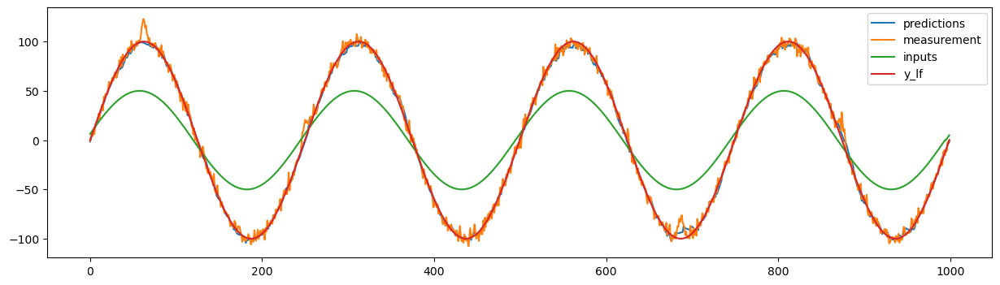

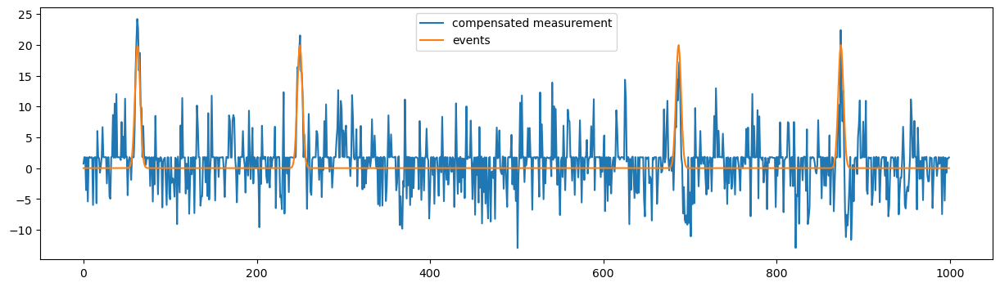

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0429472065610635, 'q_process_noise_0': 1.0817609360183362, 'loc': 0.002200899880678545}
mse: 16.39716529374129


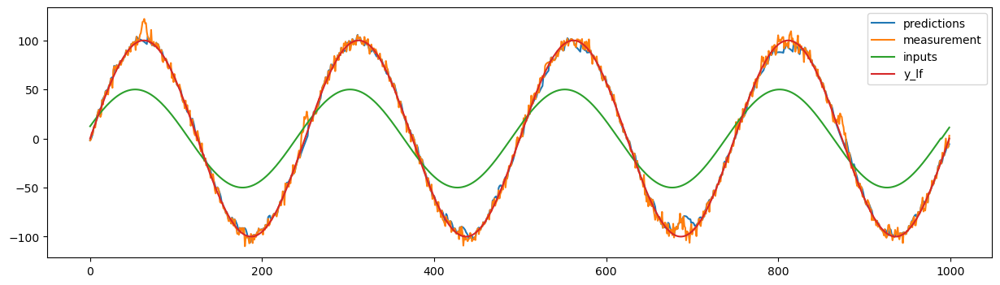

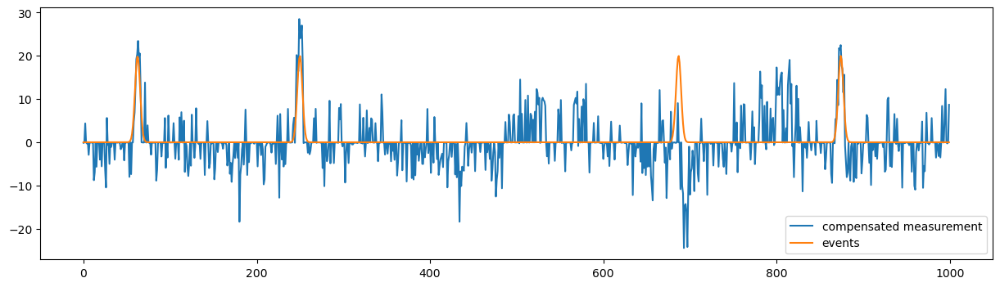

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.9541295854135675, 'q_process_noise_0': 1.485753938427808, 'loc': 0.40259219172790495}
mse: 14.030648132441904


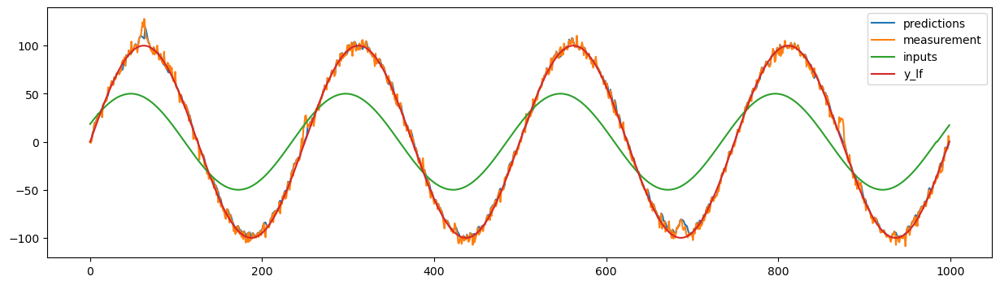

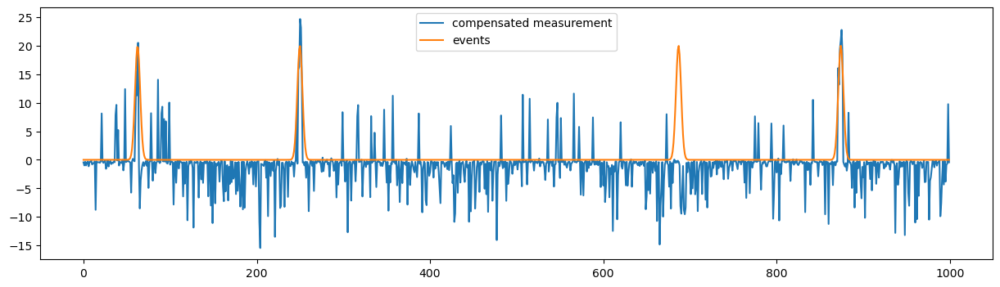

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.055286171265107674, 'q_process_noise_0': 1.6749043294072727, 'loc': 0.03423898804244601}
mse: 21.993909381593294


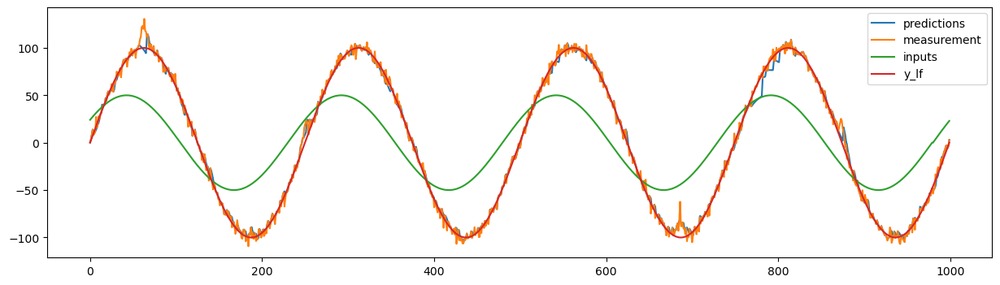

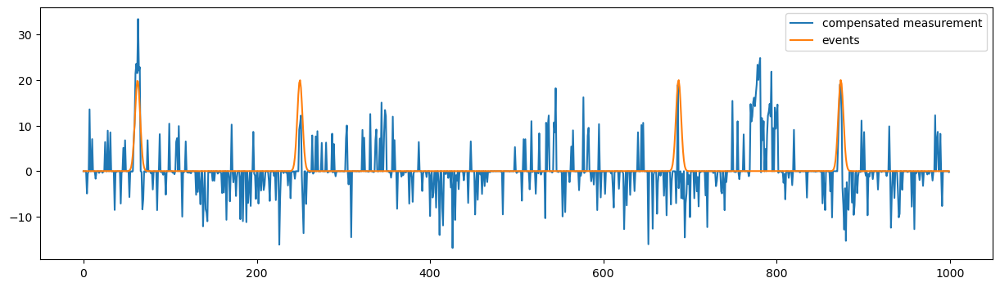

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0016704437448000903, 'q_process_noise_0': 0.9713481207216025, 'loc': 0.7477427162885852}
mse: 17.07747179873278


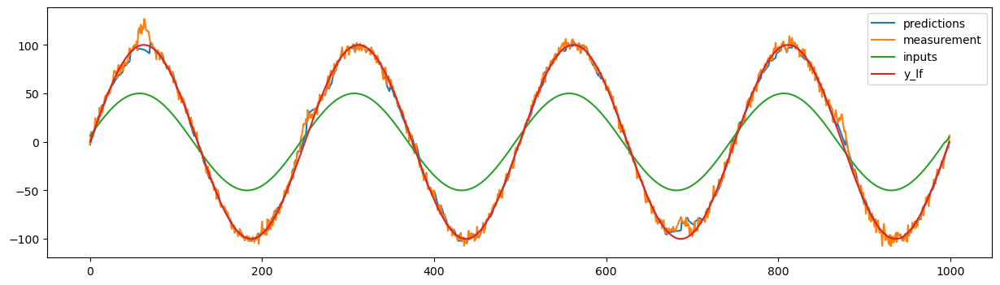

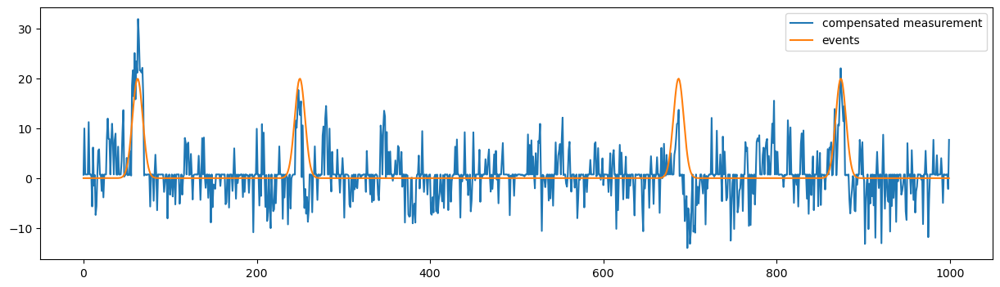

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0002866038077606509, 'q_process_noise_0': 1.2829480660469774, 'loc': 0.00023627576508110143}
mse: 23.790853747504375


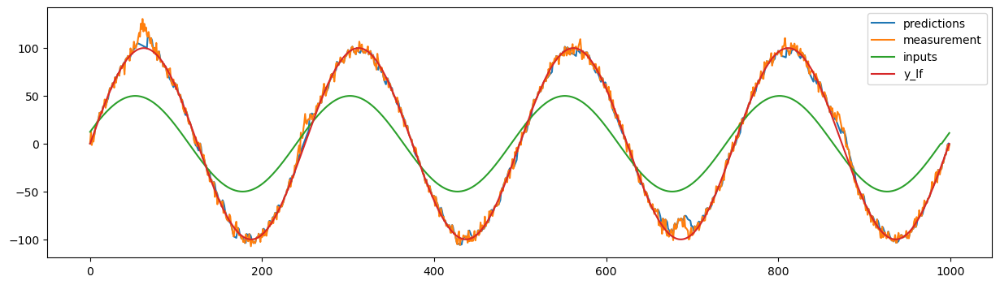

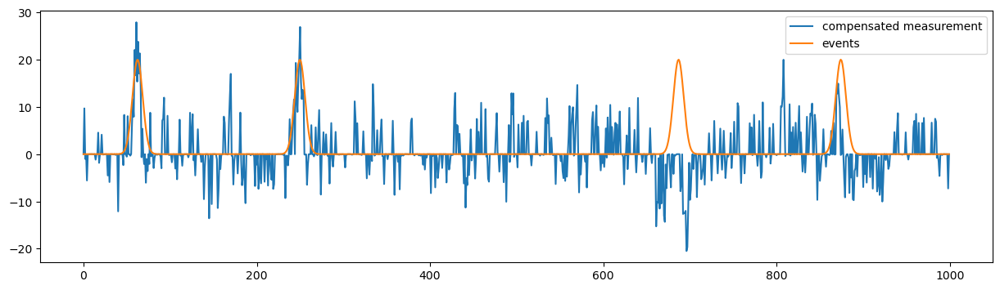

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.0016734040390215961, 'q_process_noise_0': 1.8458786069064017, 'loc': 0.2741144636420867}
mse: 29.58606943075073


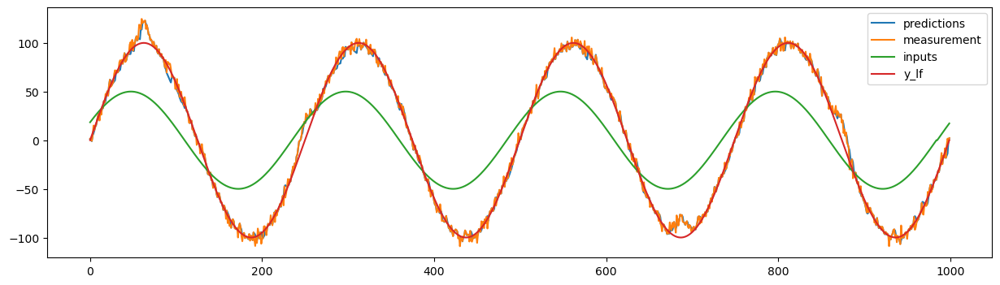

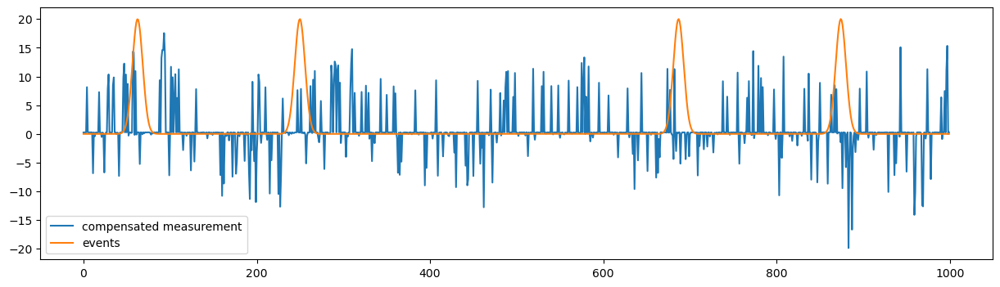

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.006476900342152148, 'q_process_noise_0': 2.1415710049518064, 'loc': 1.8746560659398162}
mse: 167.27179906334678


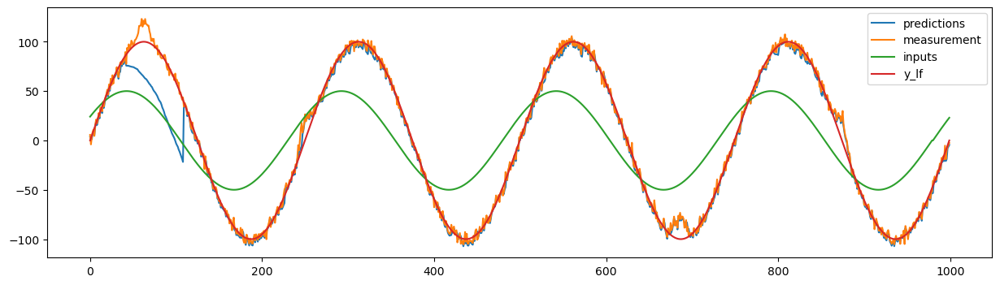

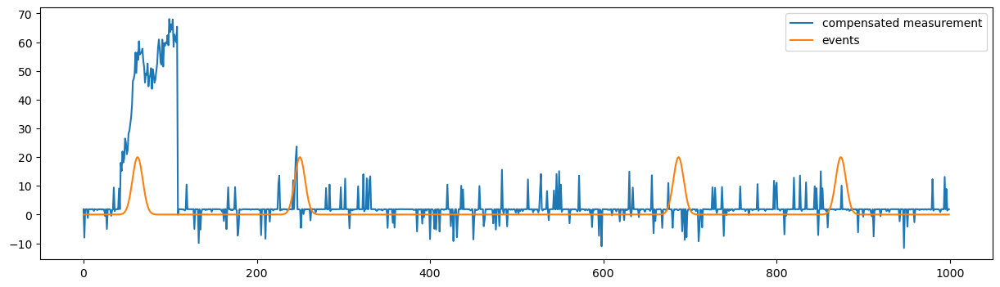

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.008034955715150756, 'q_process_noise_0': 0.7209985106280716, 'loc': 0.2820711277622904}
mse: 13.992734117278046


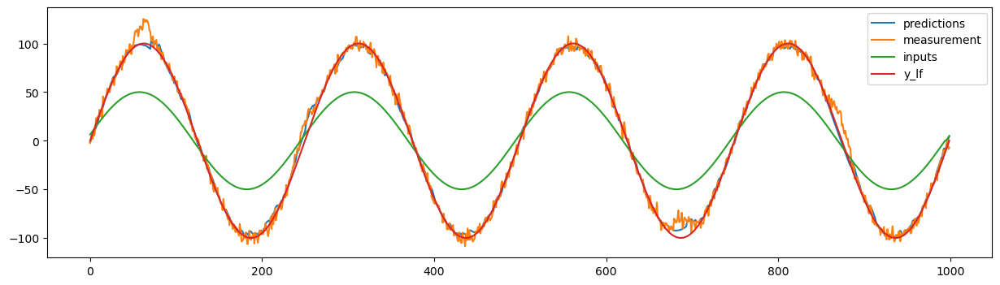

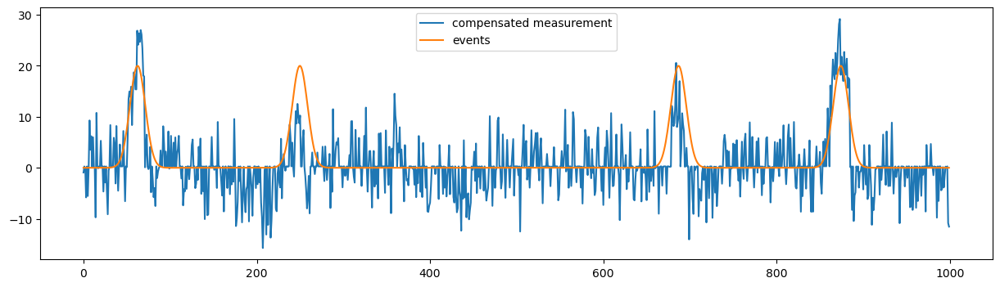

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.6676576385641595, 'q_process_noise_0': 1.2681777809151664, 'loc': 3.150766227922007}
mse: 29.563729381733125


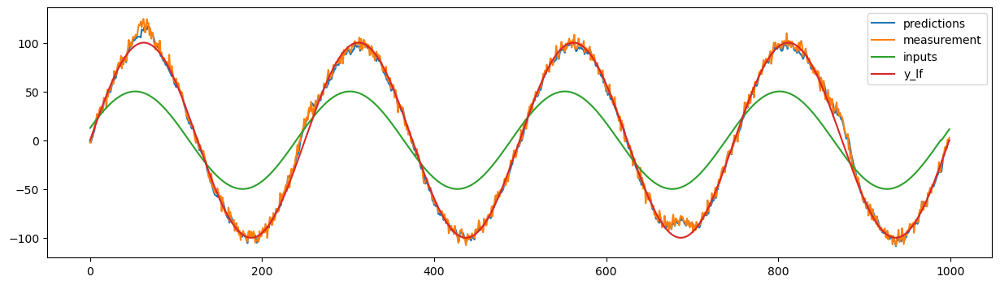

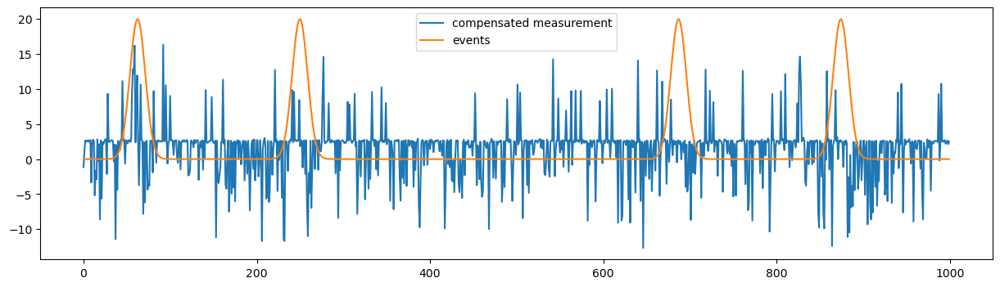

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.014623604099743072, 'q_process_noise_0': 2.0324705935719374, 'loc': 1.5894076675640967}
mse: 35.63248643141891


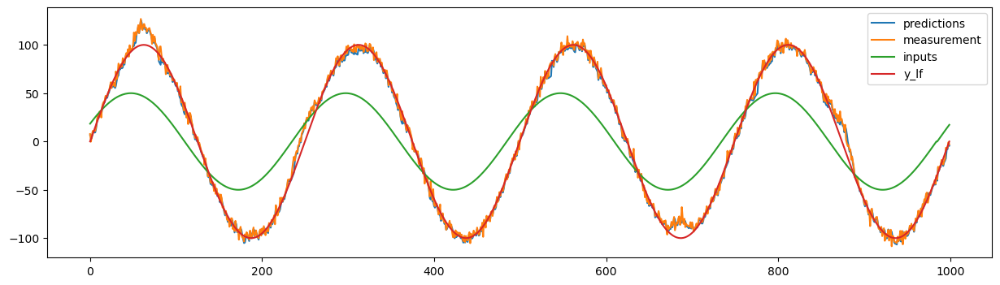

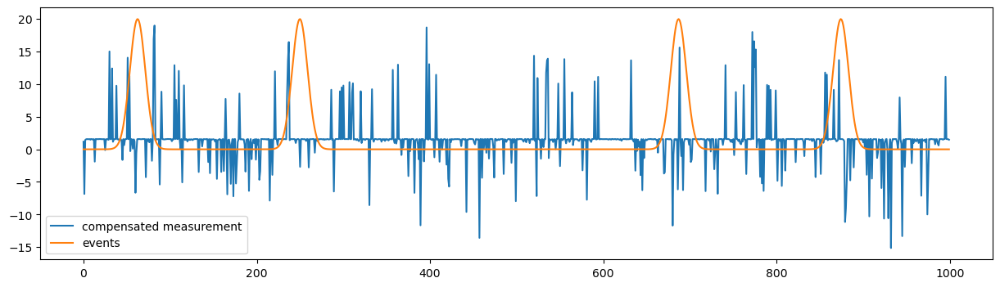

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.018381017167740273, 'q_process_noise_0': 1.8401942502962396, 'loc': 1.8273934681711101}
mse: 33.59150009962928


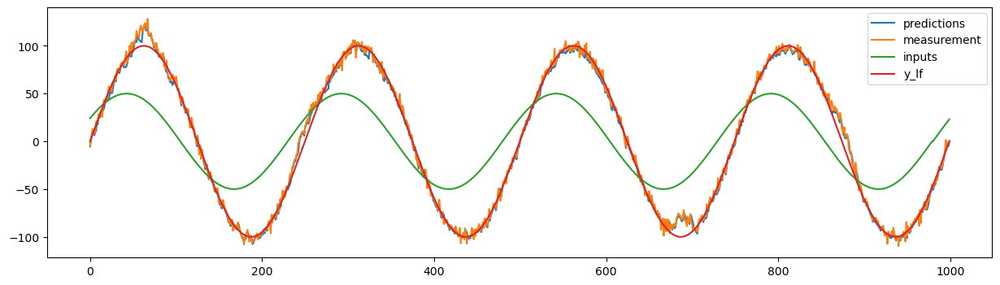

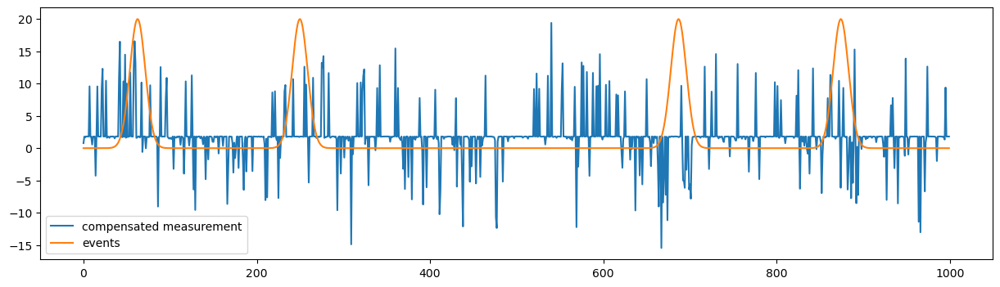

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.28908942108588026, 'q_process_noise_0': 0.5637184236835951, 'loc': 1.8866957664006057}
mse: 22.176050950987147


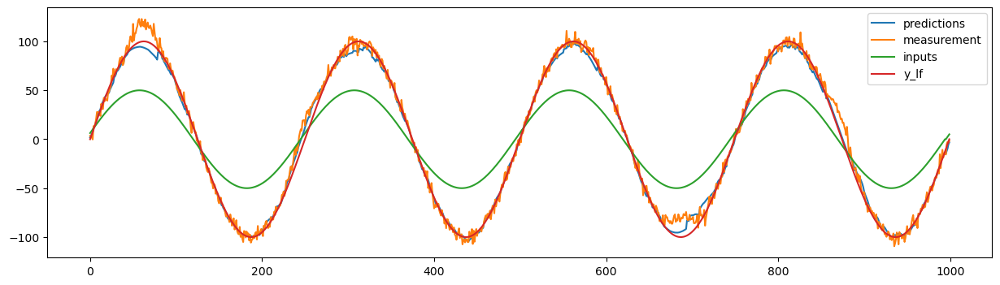

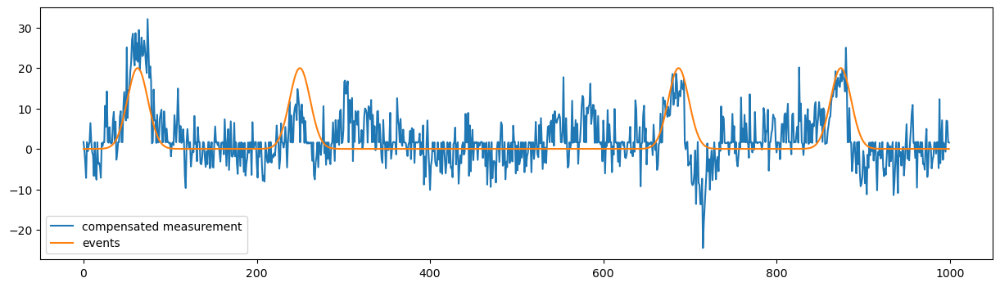

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.007245111043369308, 'q_process_noise_0': 2.206372235530858, 'loc': 2.377882646134942}
mse: 43.358441273691554


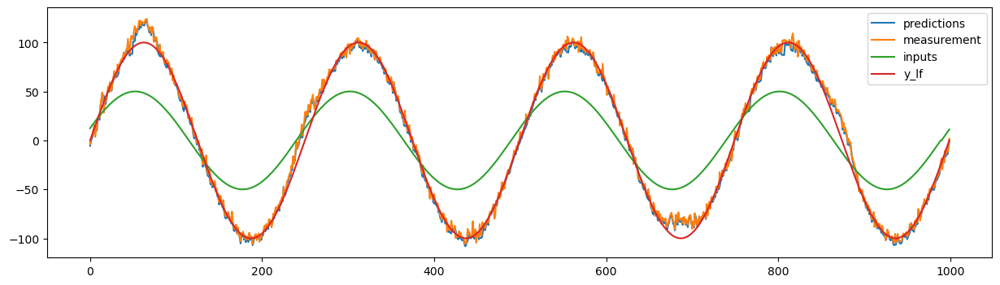

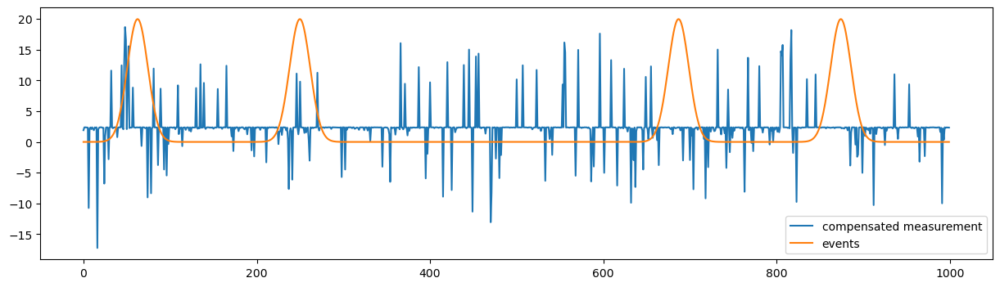

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00015418743038167945, 'q_process_noise_0': 2.060315326841959, 'loc': 2.214670551990339}
mse: 40.112876341551285


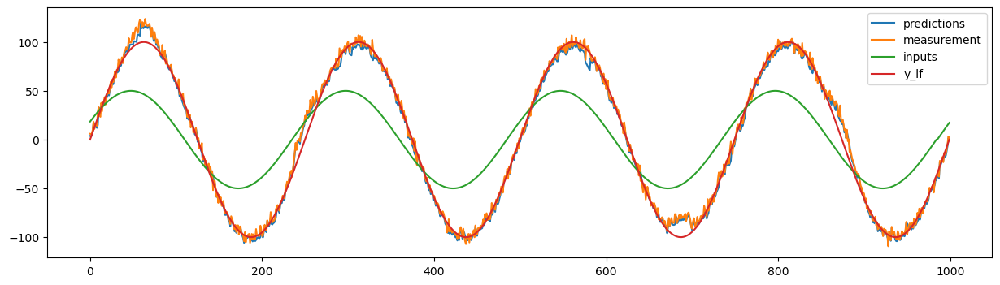

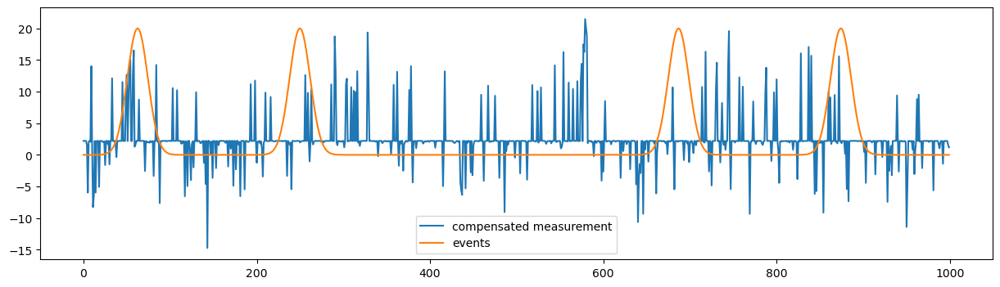

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 1.5037848084510863, 'q_process_noise_0': 1.6037750997909728, 'loc': 5.063832325332993}
mse: 38.84747320163301


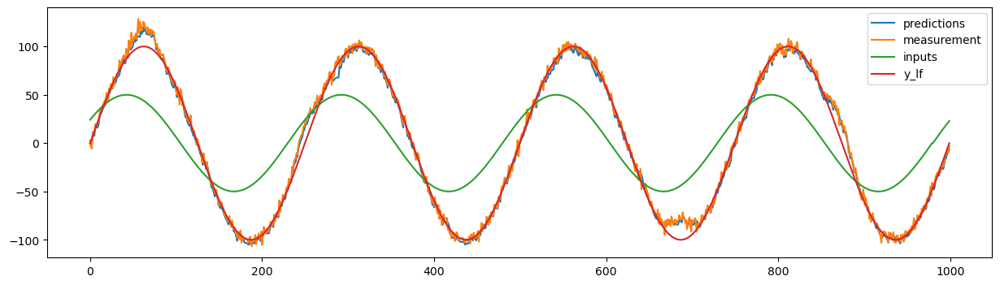

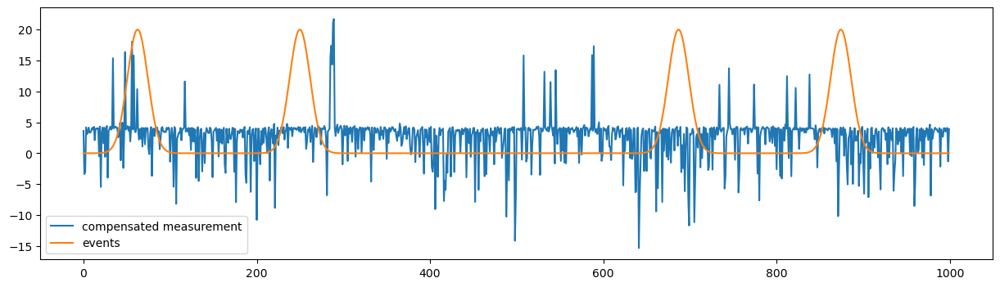

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.05084392069008957, 'q_process_noise_0': 0.8634014360486097, 'loc': 2.4908406096900957}
mse: 30.812522140291687


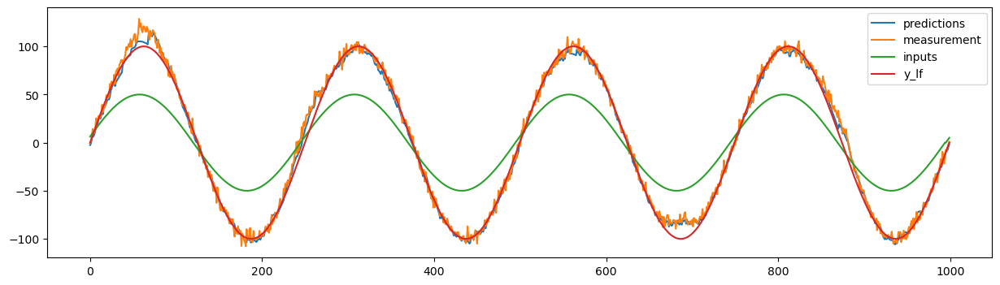

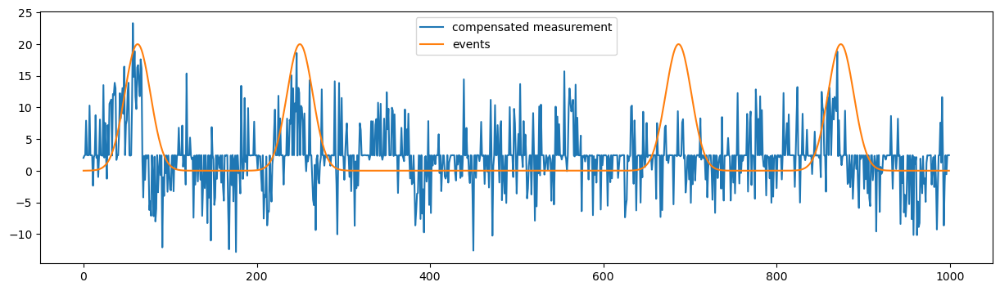

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 6.62574562936612, 'q_process_noise_0': 1.4954630378783458, 'loc': 9.284885802992322}
mse: 38.48387625421185


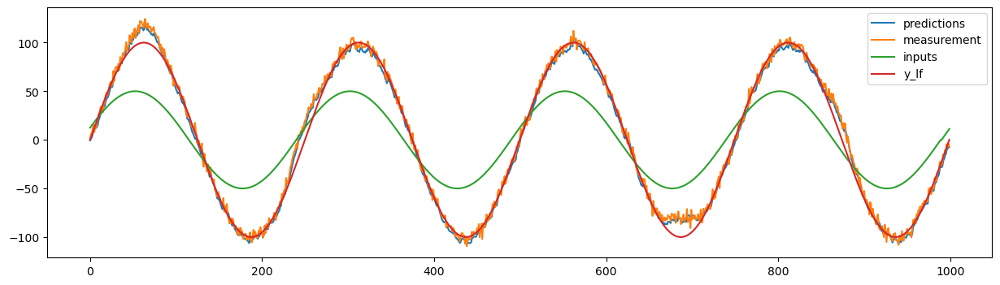

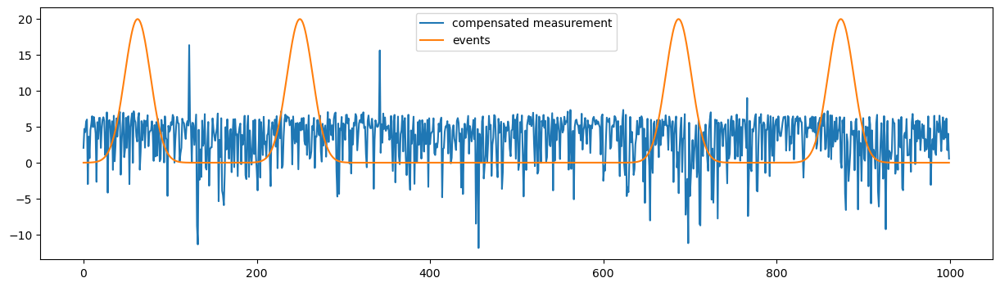

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 1.6257514685005663, 'q_process_noise_0': 1.607143283231739, 'loc': 4.882995624550889}
mse: 40.35364941816106


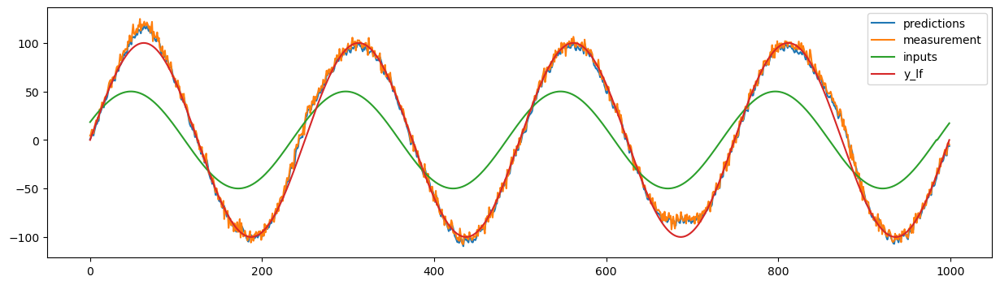

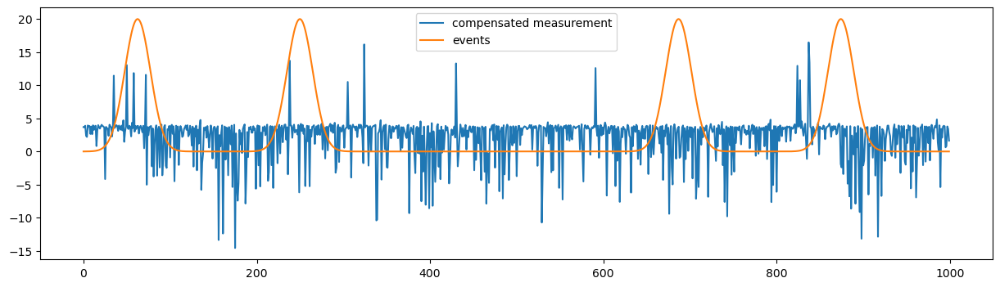

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.01230529271195391, 'q_process_noise_0': 31.913304699054258, 'loc': 3.0419518897259152}
mse: 50.24007541486921


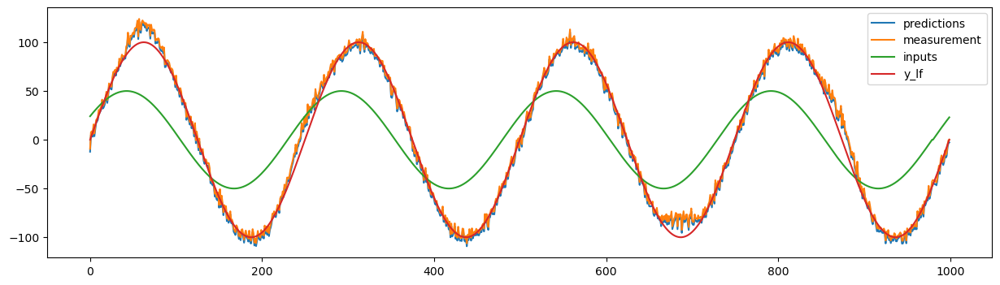

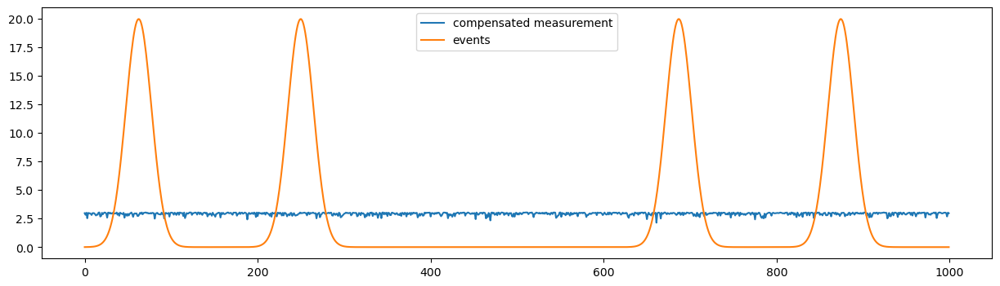

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.006999851713404726, 'q_process_noise_0': 1.0024434672850282, 'loc': 2.9596970849449757}
mse: 39.673485737296055


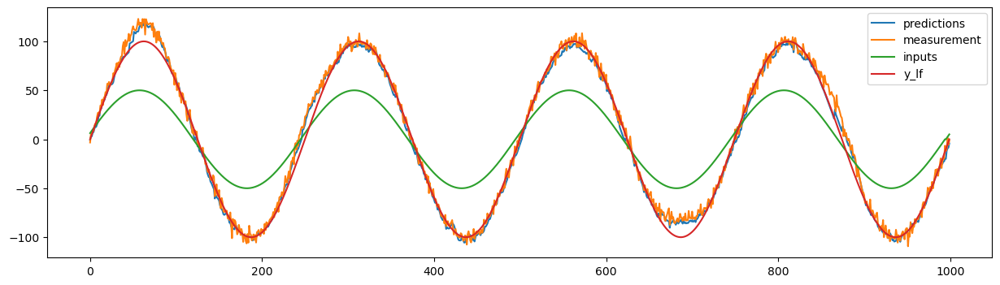

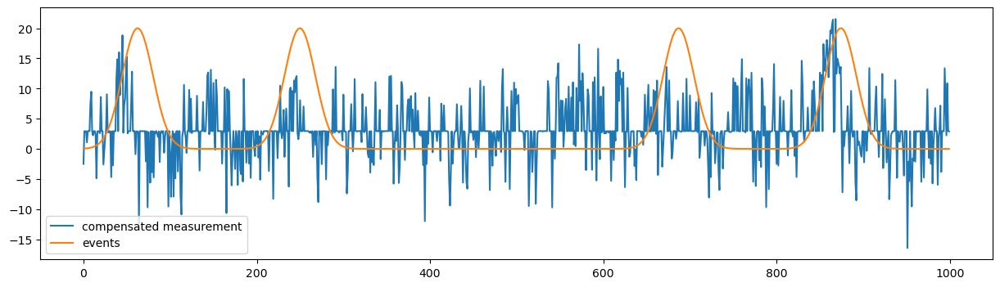

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 7.366457548006706, 'q_process_noise_0': 1.7234531055669604, 'loc': 9.713595639440094}
mse: 44.12523324787249


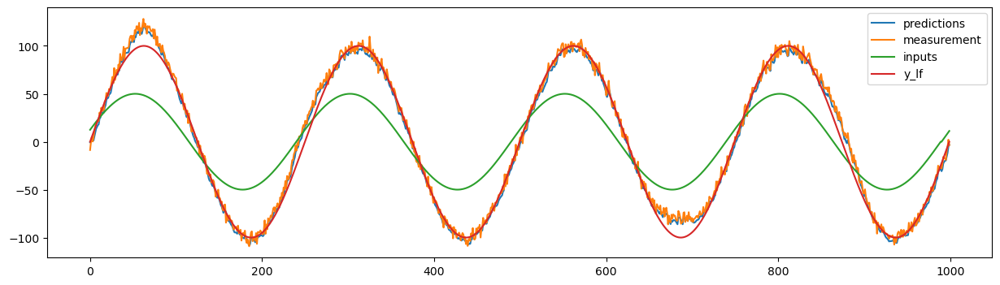

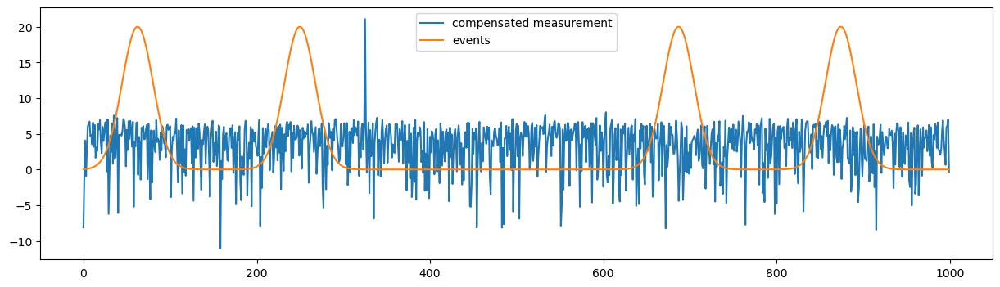

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.03087919089729984, 'q_process_noise_0': 2.634164076260121, 'loc': 3.485405267832323}
mse: 51.84228698908141


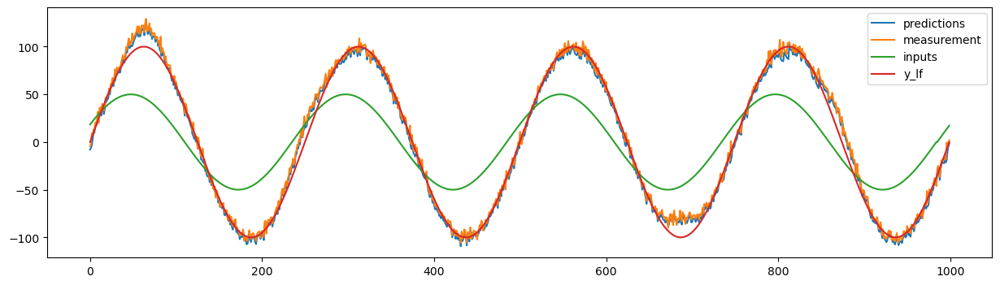

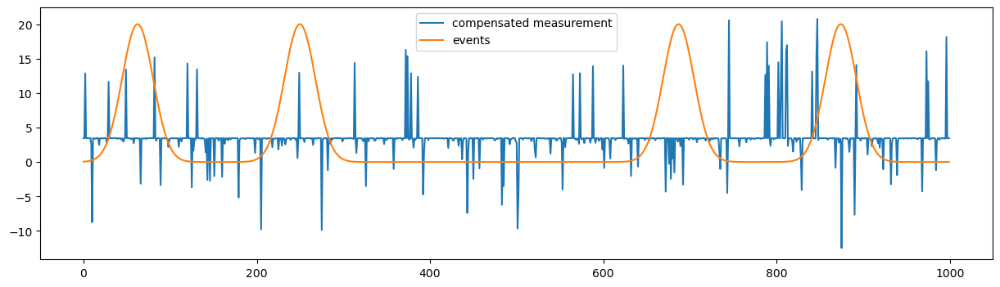

event_to_trend_amplitude: 0.1 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.2000383266673267, 'q_process_noise_0': 3.192273297476799, 'loc': 3.4757707226270997}
mse: 47.805187339933205


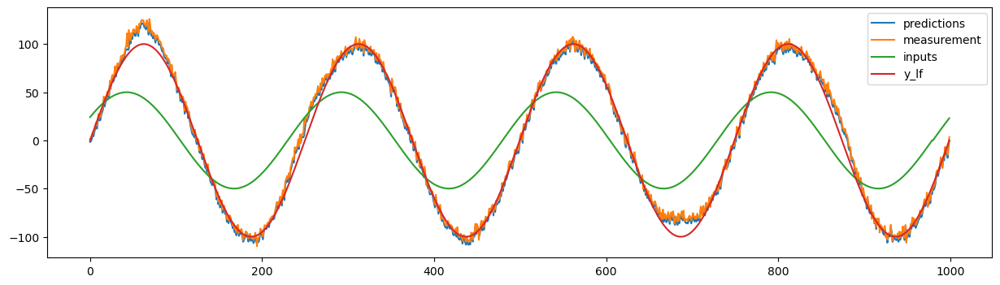

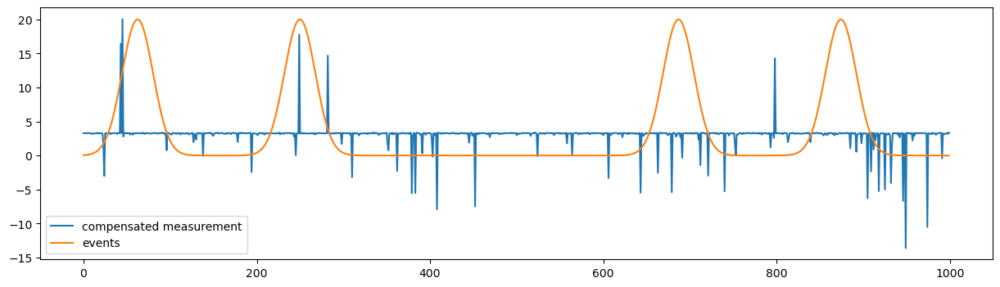

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.010446747360653565, 'q_process_noise_0': 0.6455074589126848, 'loc': 0.0008137053712827765}
mse: 10.833734533904833


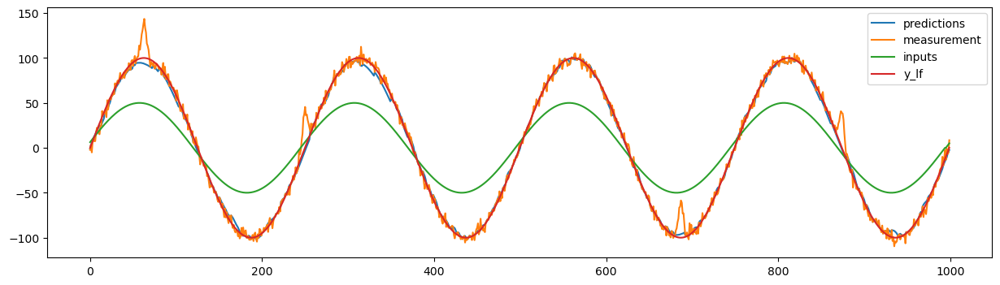

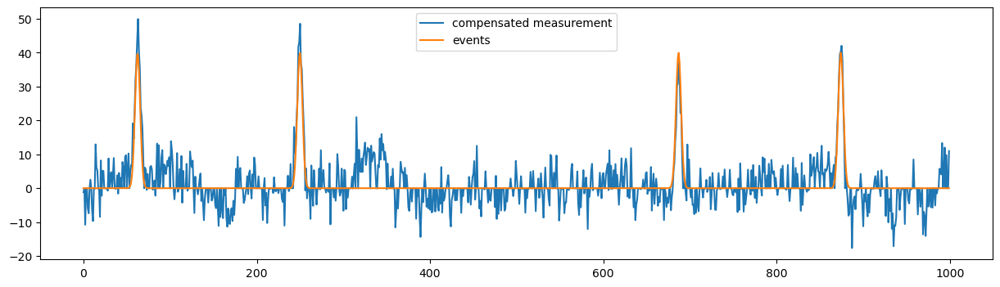

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.5166924375428166, 'q_process_noise_0': 0.7833676351633893, 'loc': 3.5657602901471837}
mse: 15.249093697626716


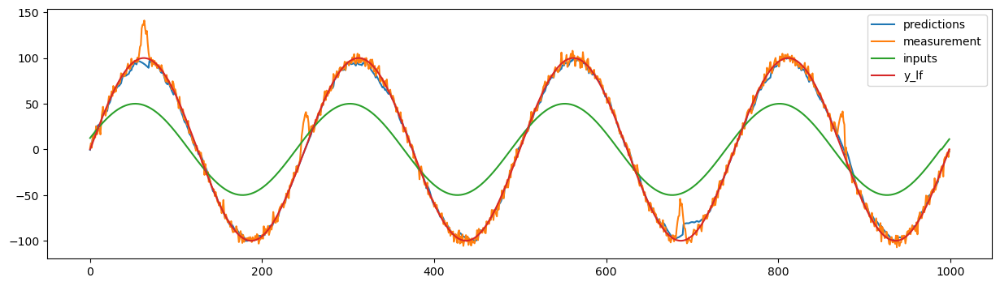

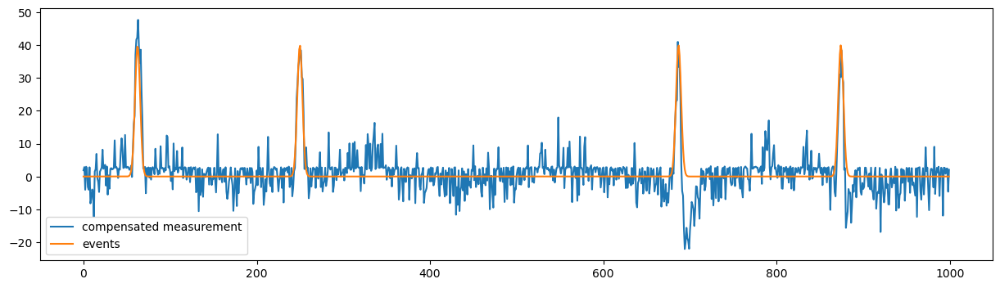

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.014563984553410117, 'q_process_noise_0': 1.641579671467856, 'loc': 0.011453596378306433}
mse: 16.37829190649058


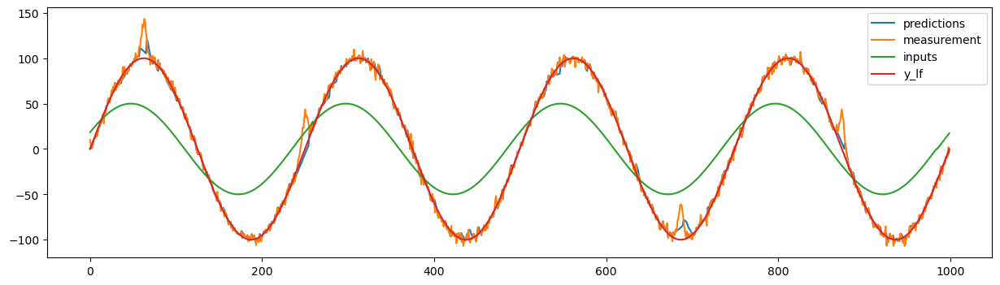

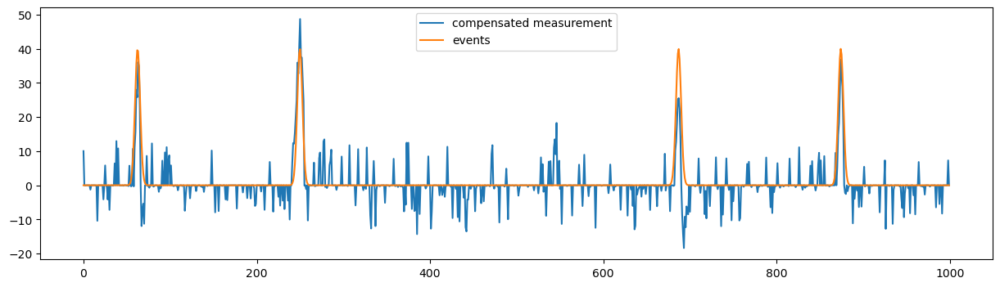

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.1096863018964099, 'q_process_noise_0': 1.6200489927982769, 'loc': 0.008096856038176656}
mse: 19.07607732737175


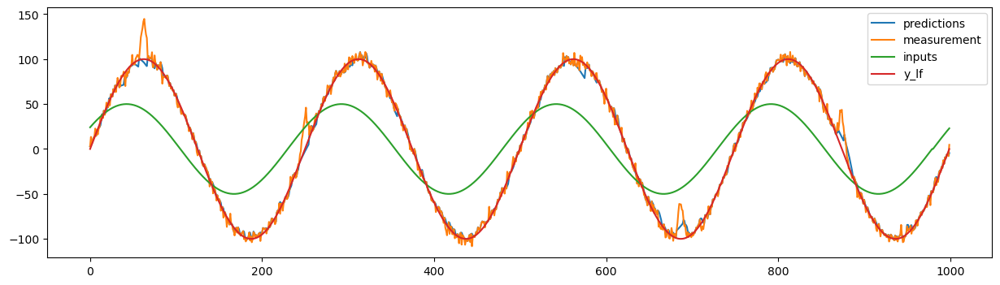

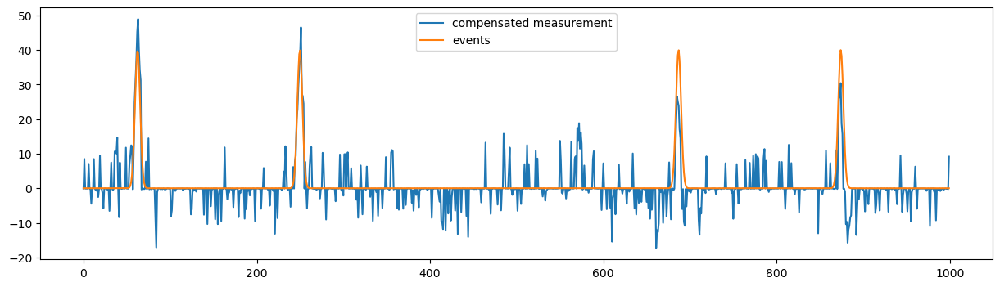

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0005201146078472981, 'q_process_noise_0': 0.7807108064376997, 'loc': 0.3256537439789454}
mse: 15.33136174586614


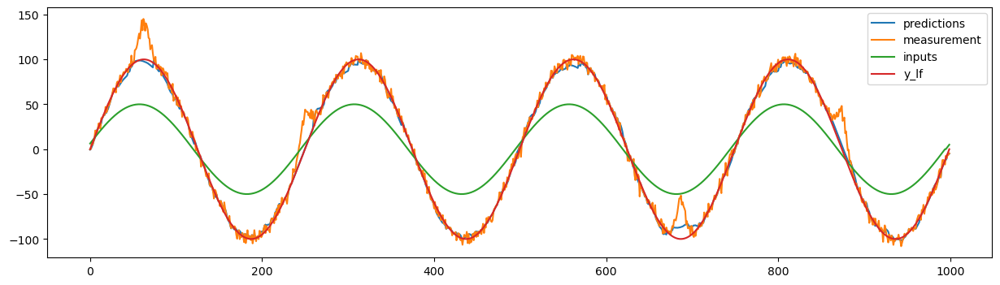

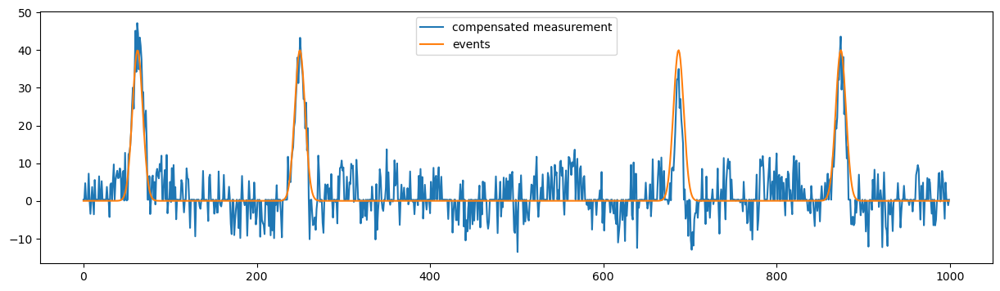

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.04150919018953941, 'q_process_noise_0': 1.2847168614003452, 'loc': 0.0895024302322225}
mse: 14.939492434367988


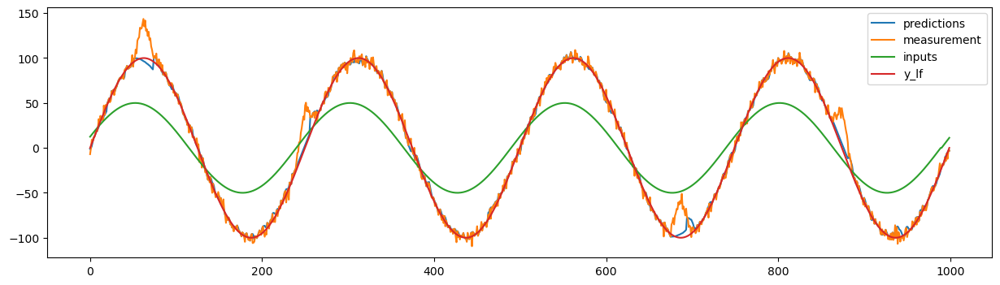

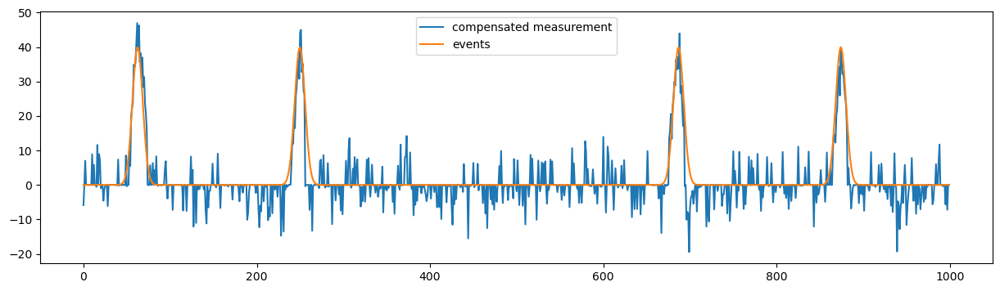

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.07319085983157635, 'q_process_noise_0': 1.804257784159071, 'loc': 0.0014974387625009424}
mse: 54.21815586038917


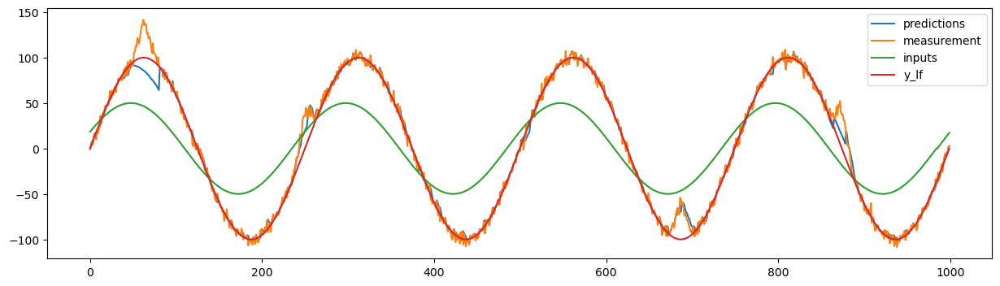

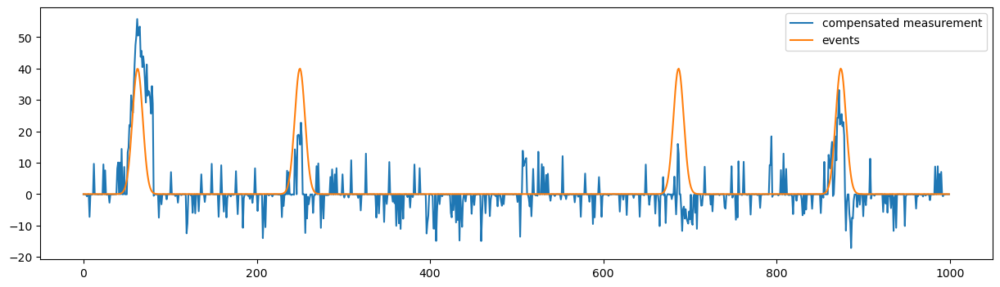

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.060856190300593735, 'q_process_noise_0': 18.06124989892996, 'loc': 2.60829443210226}
mse: 78.98923516850854


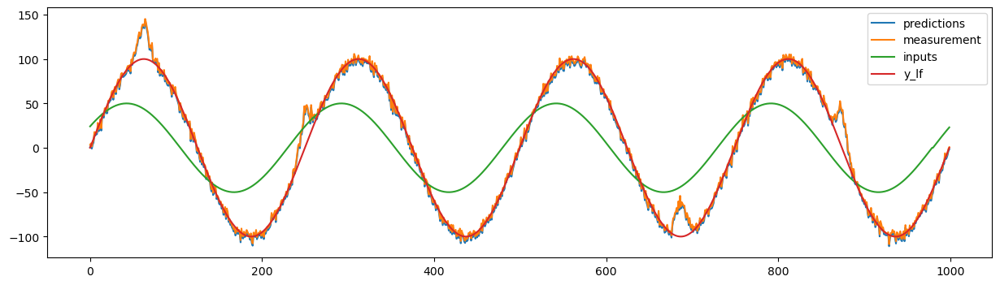

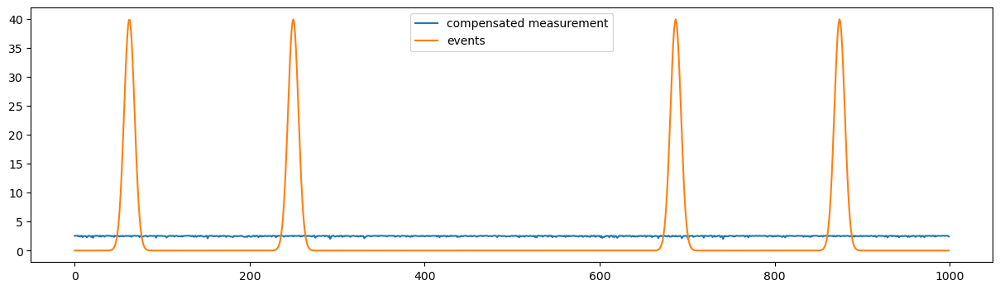

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.06909761351064214, 'q_process_noise_0': 0.6640114320452969, 'loc': 1.5229141436505713}
mse: 22.560211938694557


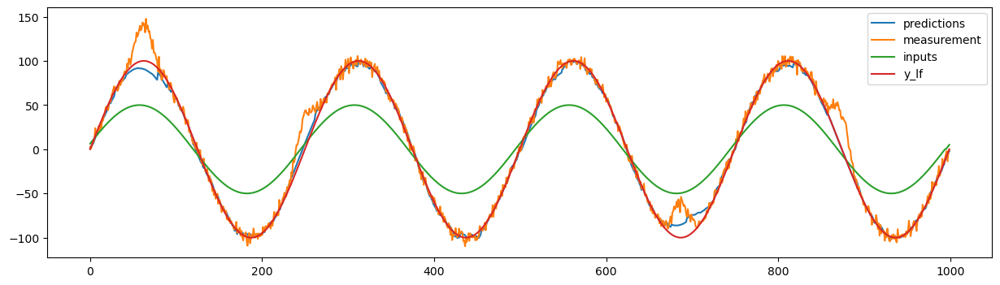

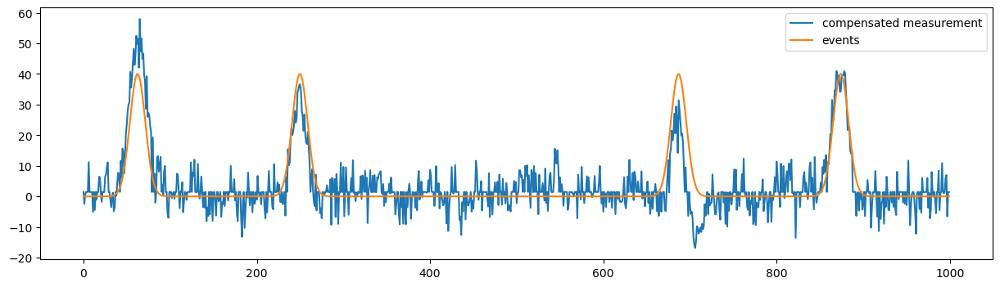

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0002107857677357056, 'q_process_noise_0': 1.1267161725600523, 'loc': 0.10278445752715351}
mse: 51.400279811132535


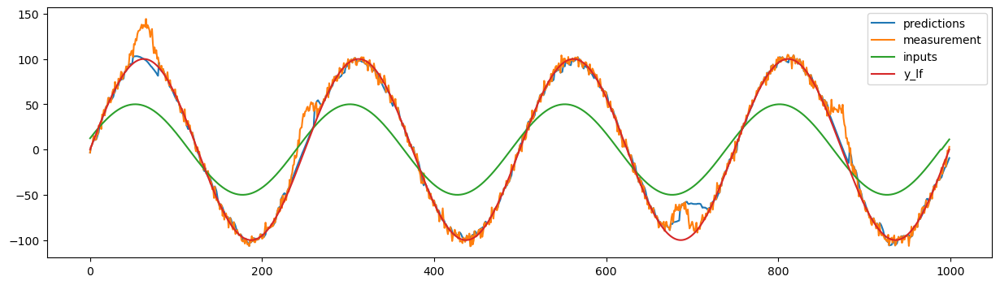

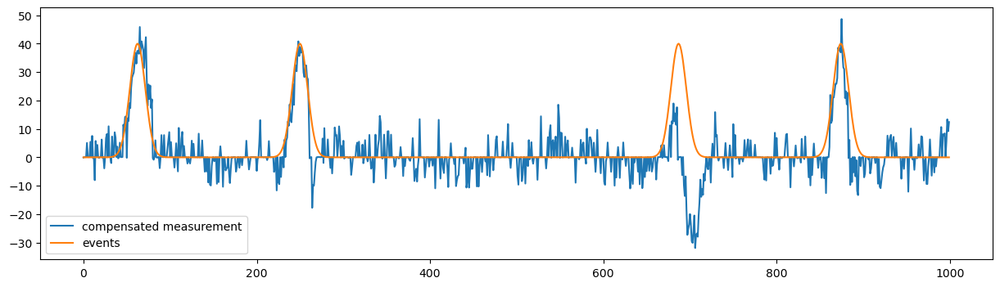

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00015006714628122843, 'q_process_noise_0': 4.822623558662553, 'loc': 3.4260981522120346}
mse: 104.61835173516549


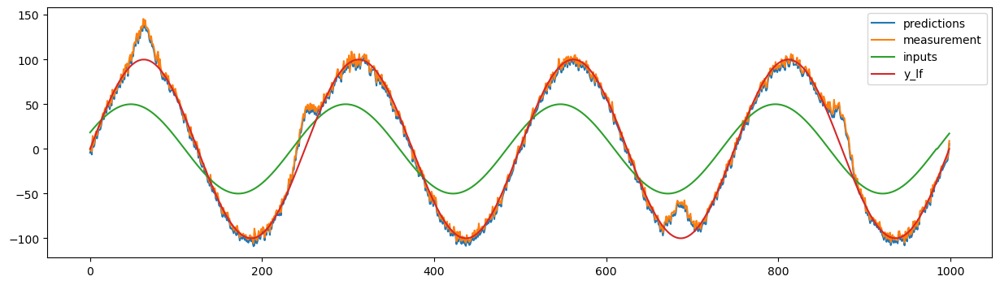

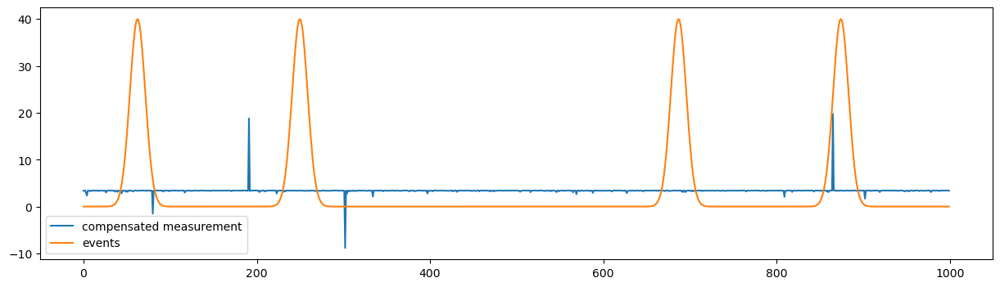

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.08492876038740366, 'q_process_noise_0': 1.6287674228755662, 'loc': 0.09393791214937881}
mse: 103.85223250990913


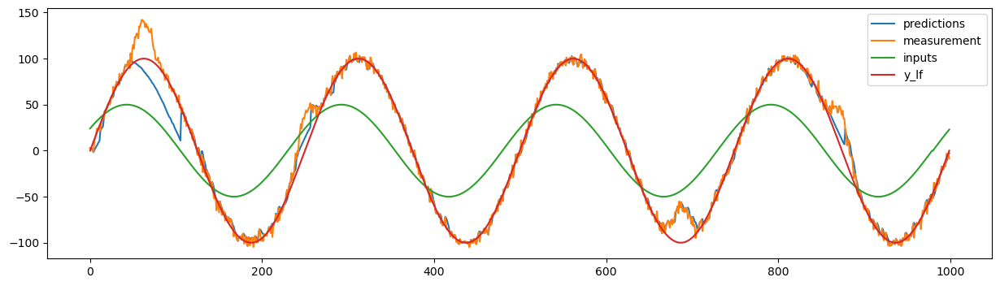

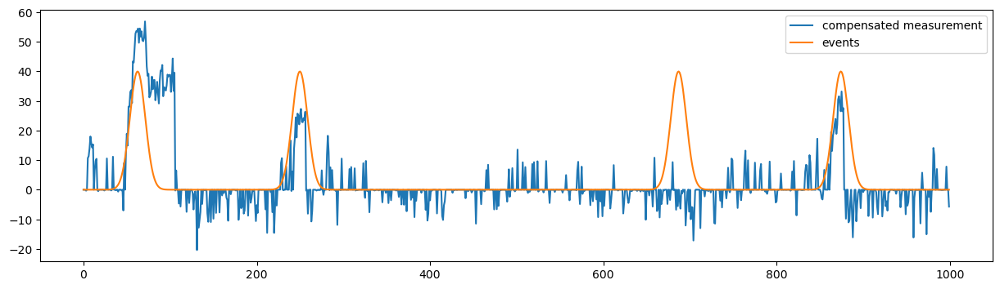

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0002443293281527972, 'q_process_noise_0': 0.6433222830740534, 'loc': 1.5834354773806487}
mse: 36.16697285802617


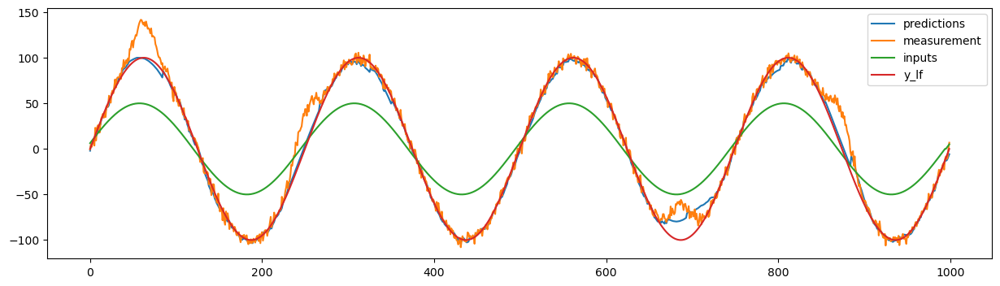

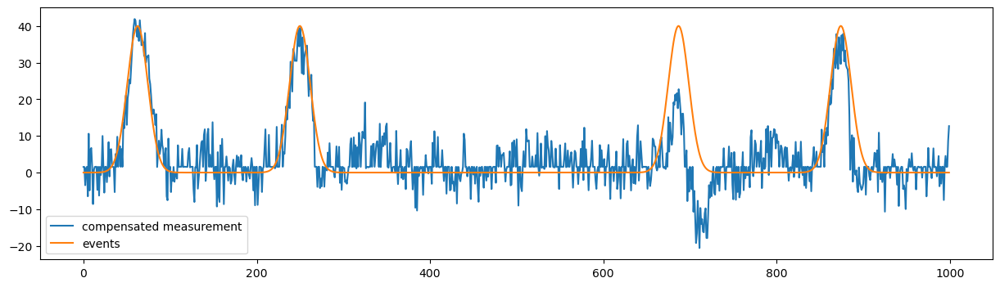

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0001315394266625055, 'q_process_noise_0': 1.2884563413440833, 'loc': 0.0001882313300507329}
mse: 133.08633763685287


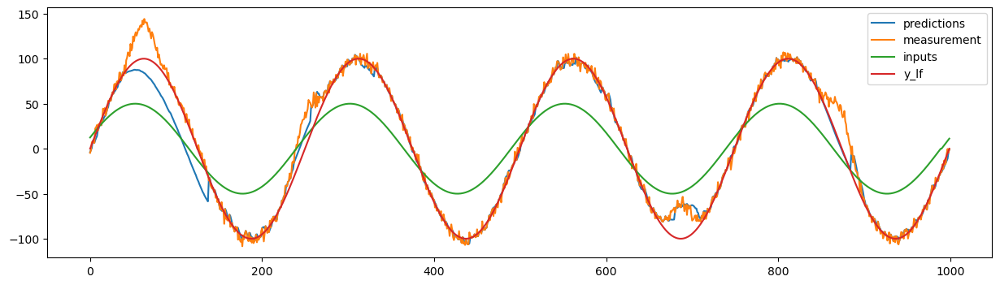

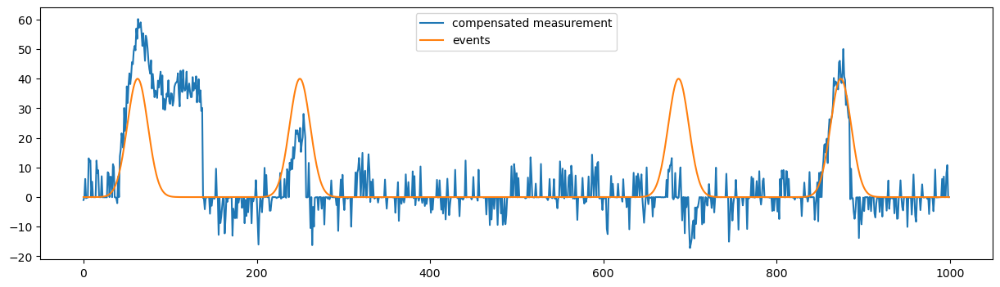

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 2.7268596484977152, 'q_process_noise_0': 12.277052760562661, 'loc': 6.970129646060129}
mse: 124.96518217868157


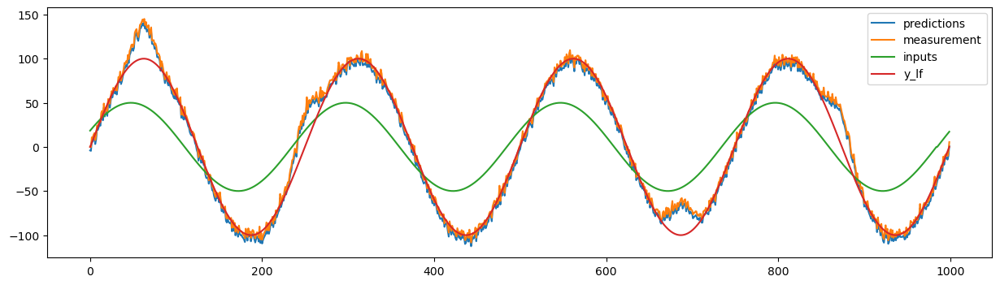

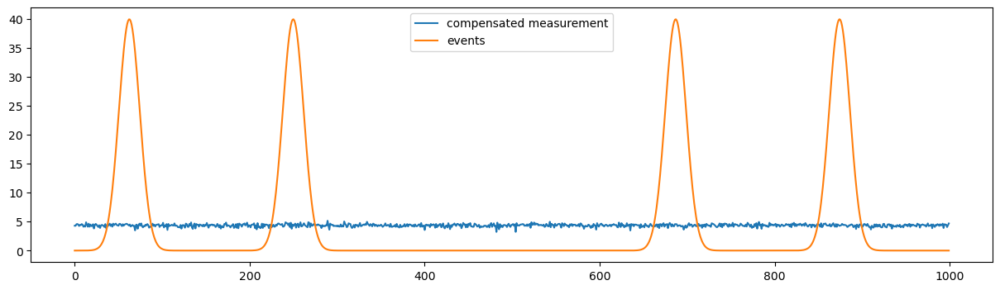

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.002509918684284108, 'q_process_noise_0': 2.3605128122672534, 'loc': 4.690879117626071}
mse: 124.73338977452224


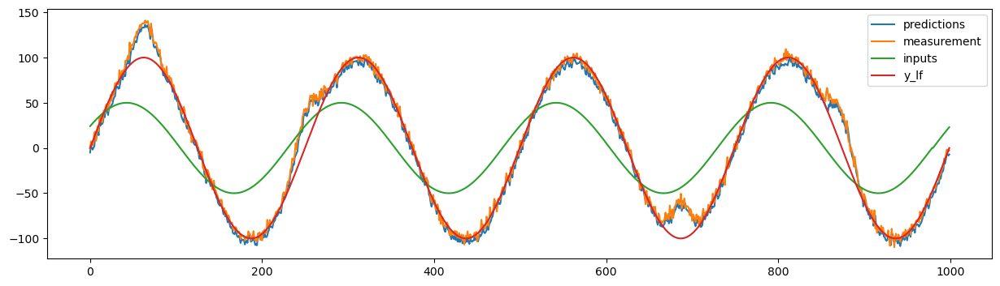

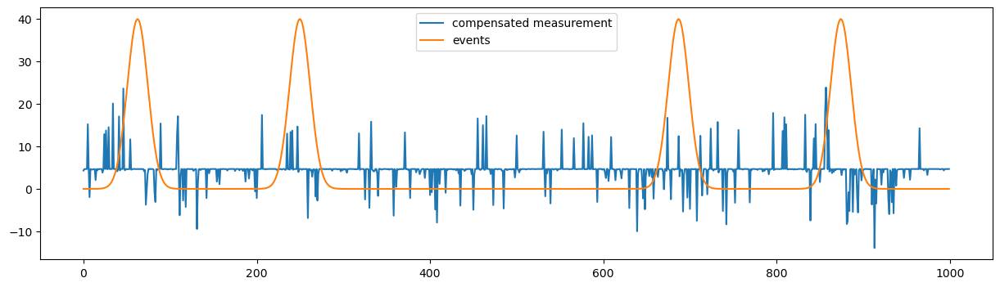

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.028223441835211006, 'q_process_noise_0': 0.7394585325763874, 'loc': 1.8818917873654015}
mse: 55.823518677980346


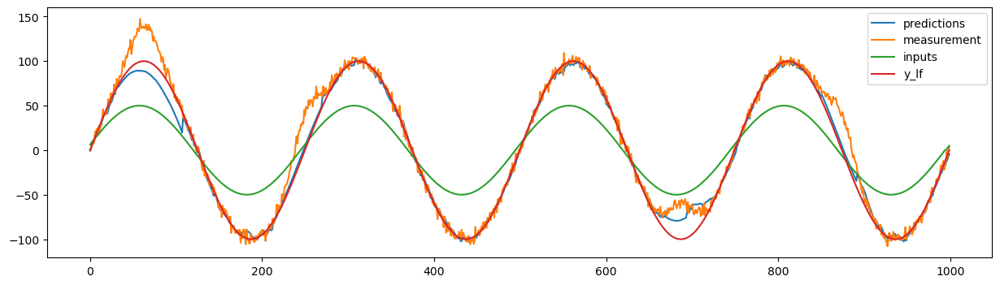

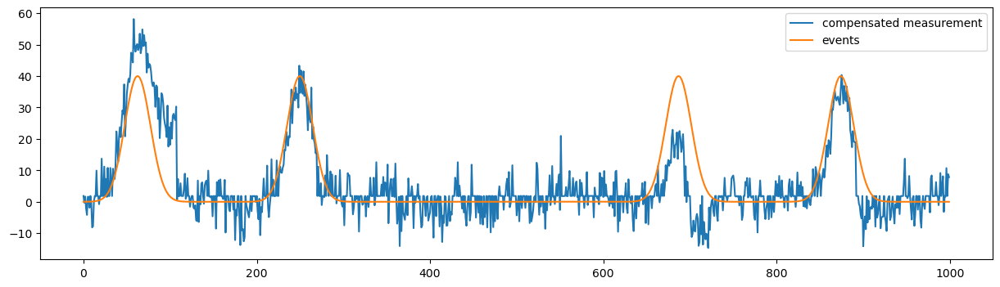

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.06120919435707937, 'q_process_noise_0': 0.9248692446262123, 'loc': 0.9563336034770027}
mse: 100.45930801586292


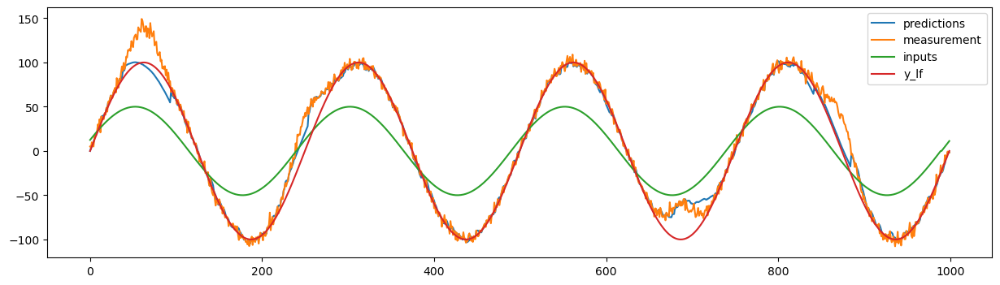

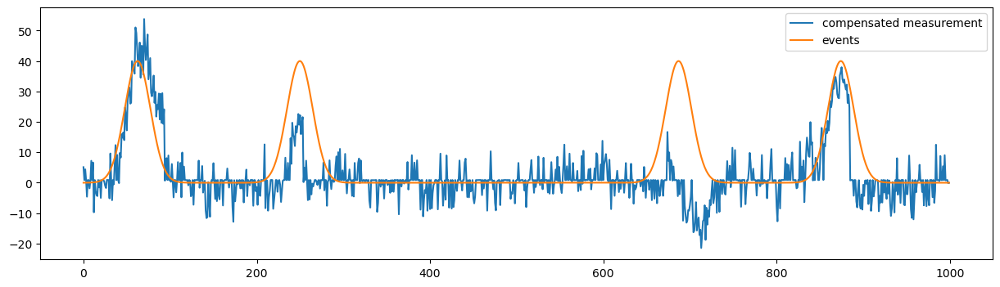

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.013265789218800355, 'q_process_noise_0': 2.807928694324843, 'loc': 4.988033579652853}
mse: 147.99503609612123


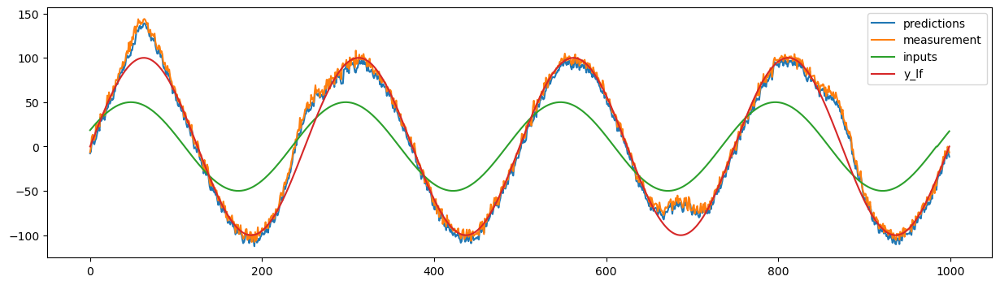

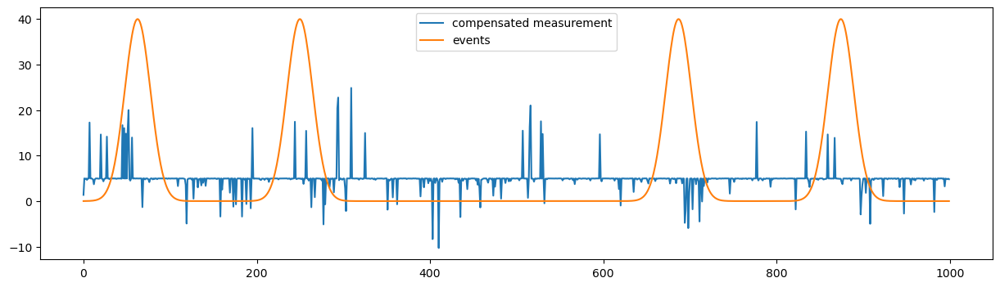

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0013039182611824548, 'q_process_noise_0': 1.807617153196122, 'loc': 2.286150897648135}
mse: 123.7352589419878


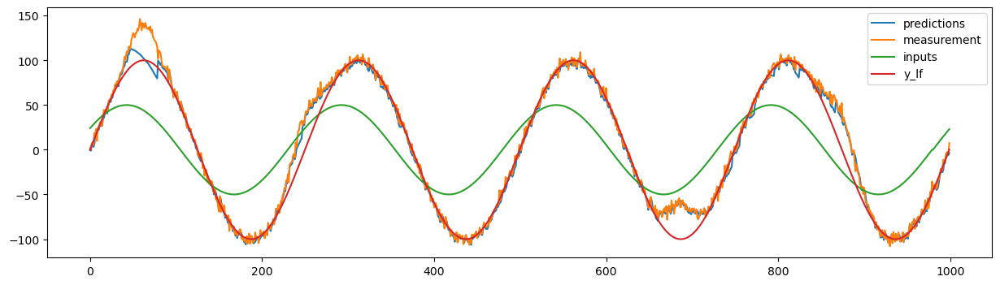

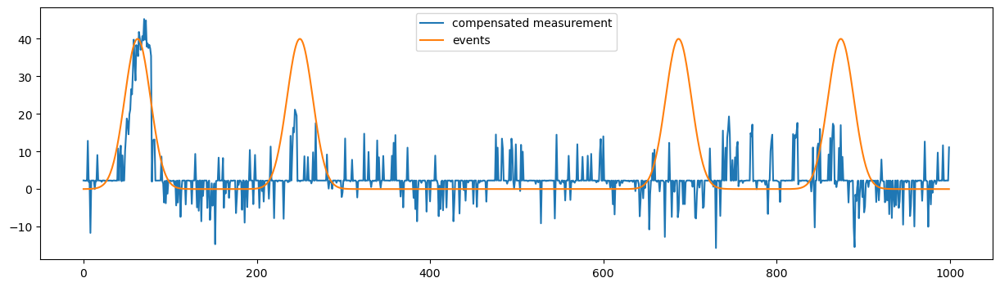

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0007761018573335653, 'q_process_noise_0': 0.7078770053215164, 'loc': 1.2963555206651998}
mse: 50.44856948694374


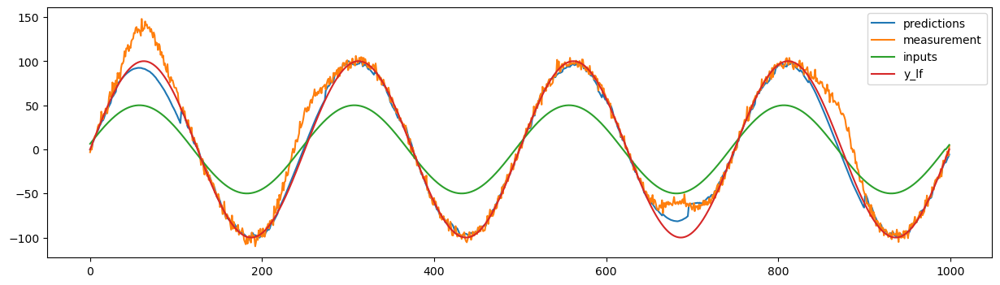

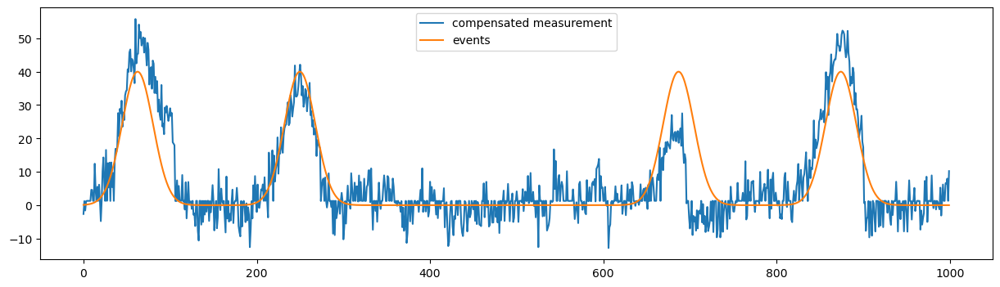

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 1.310245936793912, 'q_process_noise_0': 2.2968448548321643, 'loc': 9.437295273882931}
mse: 164.8675331297298


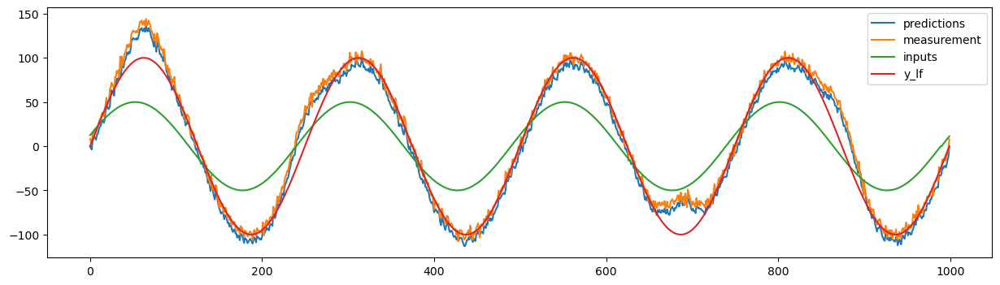

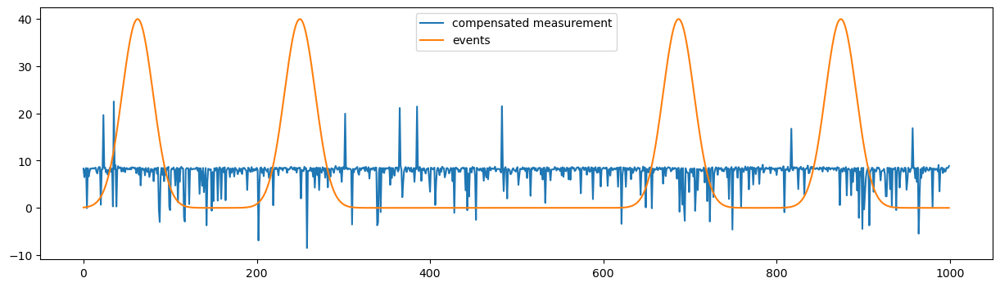

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00011068546940852271, 'q_process_noise_0': 2.788515076682073, 'loc': 6.994621545066532}
mse: 159.8383124421275


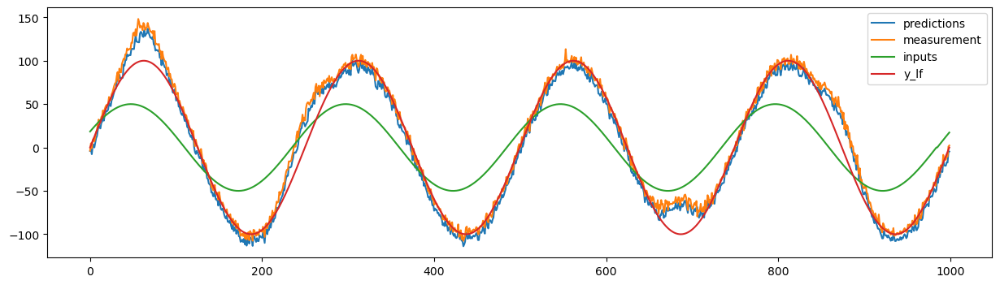

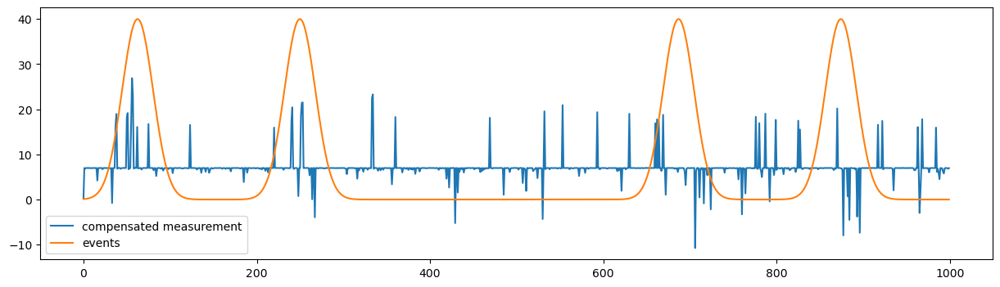

event_to_trend_amplitude: 0.2 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.08533452337013192, 'q_process_noise_0': 2.299752323523914, 'loc': 7.592049368512695}
mse: 162.8688721693943


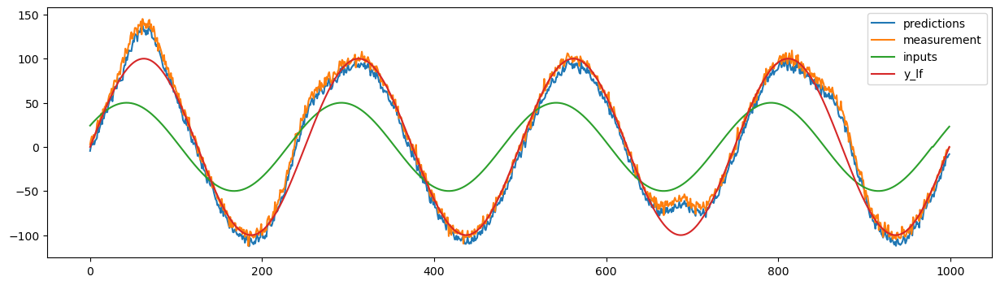

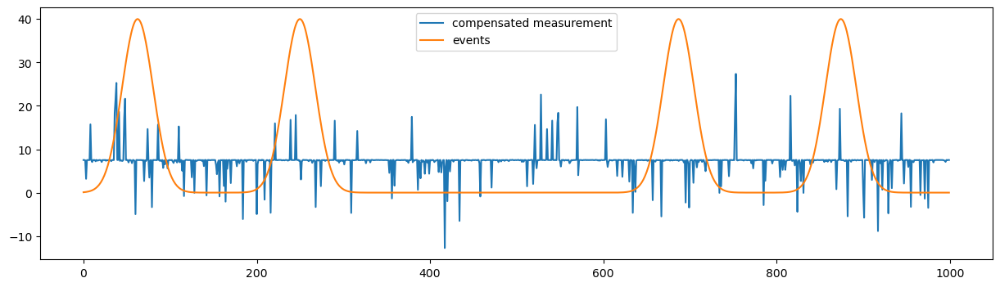

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.010984773053238047, 'q_process_noise_0': 0.818488797938764, 'loc': 0.06678948882513781}
mse: 11.270984876295474


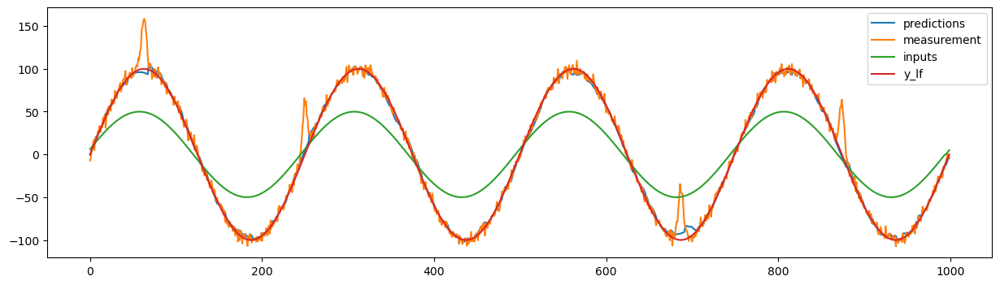

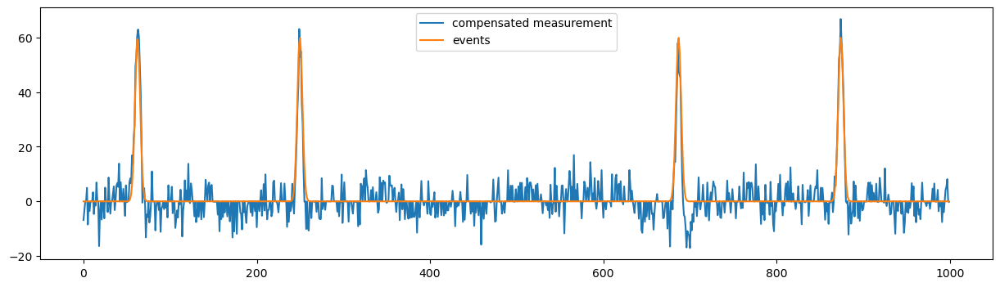

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.04005741431453843, 'q_process_noise_0': 1.0910481926525342, 'loc': 0.005151361819606707}
mse: 14.227911699474825


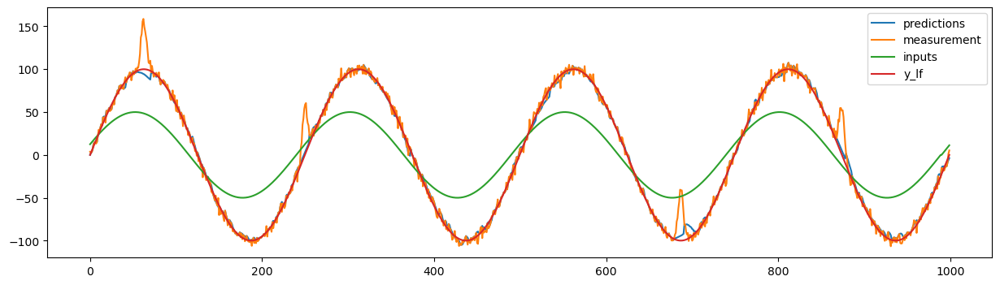

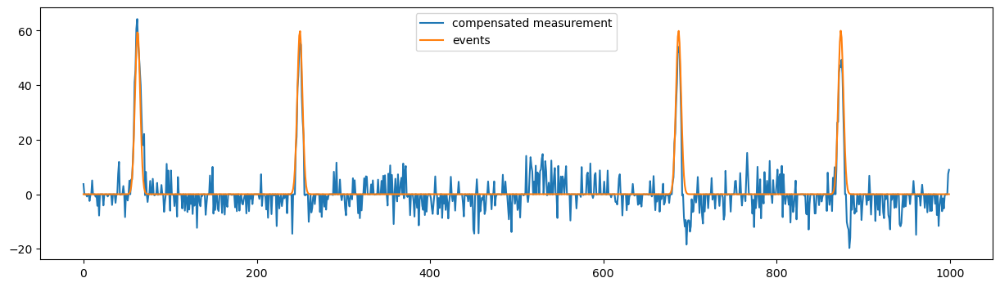

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.009634507014621155, 'q_process_noise_0': 1.9230040395183974, 'loc': 0.0002300134784865489}
mse: 22.19057693338088


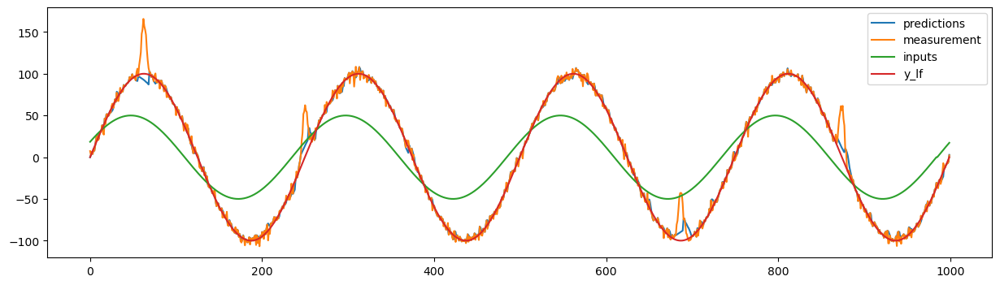

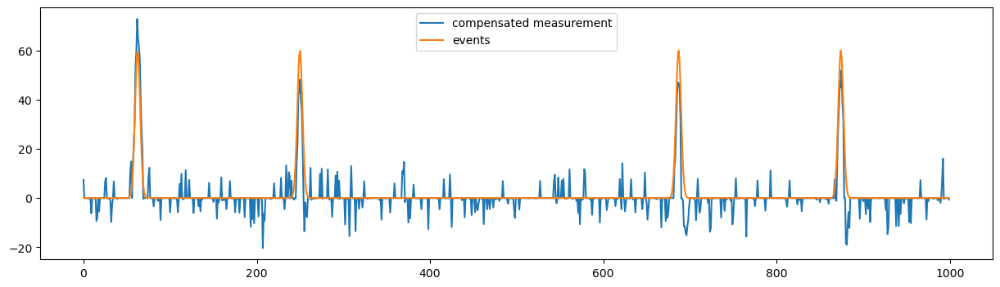

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.003999402704792217, 'q_process_noise_0': 1.590030102617653, 'loc': 0.5855174462790779}
mse: 24.296396096514492


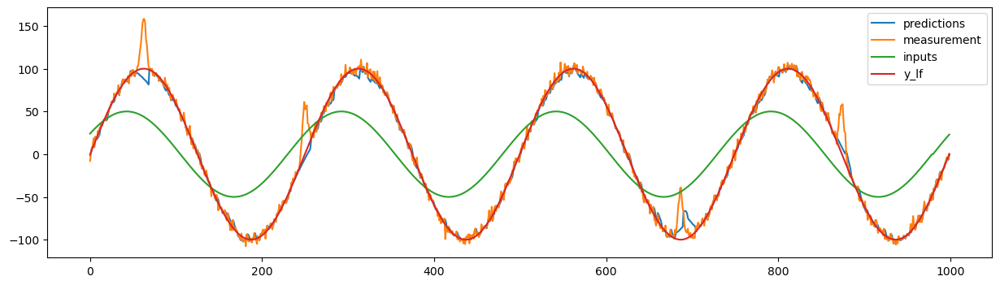

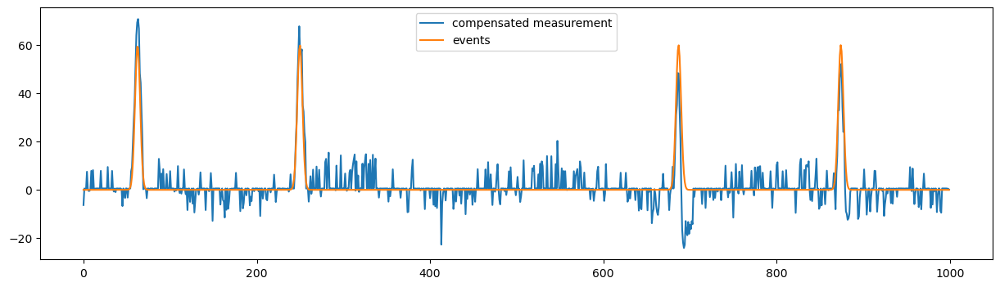

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.004905967917558943, 'q_process_noise_0': 0.6756825855075298, 'loc': 0.0013073853592863091}
mse: 12.7948999602109


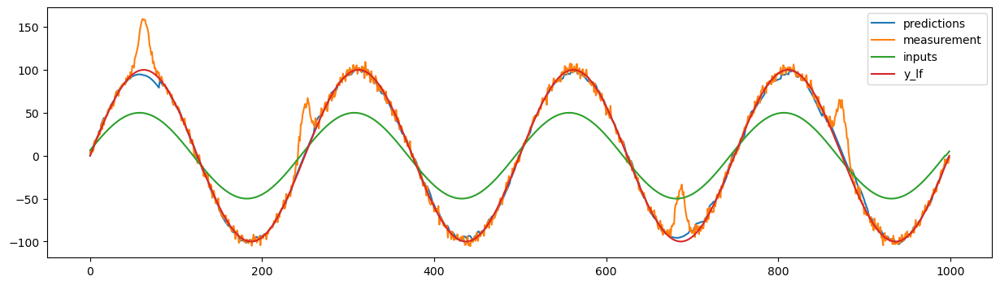

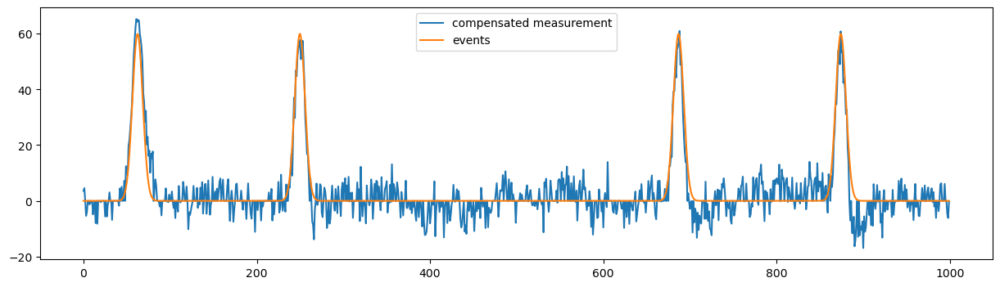

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0001719899652829843, 'q_process_noise_0': 1.1744072574677826, 'loc': 0.002060914434698079}
mse: 25.966501465958242


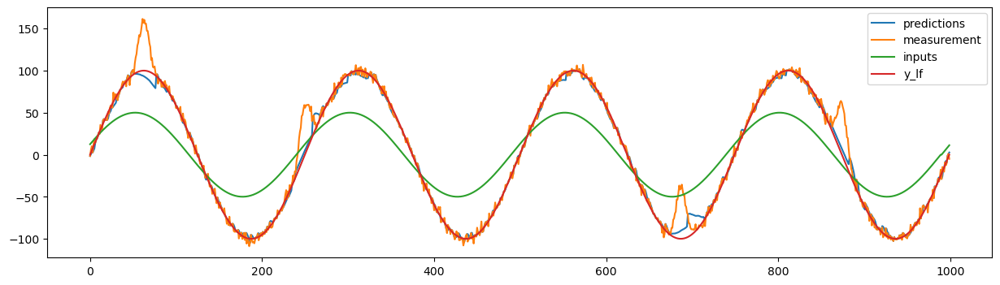

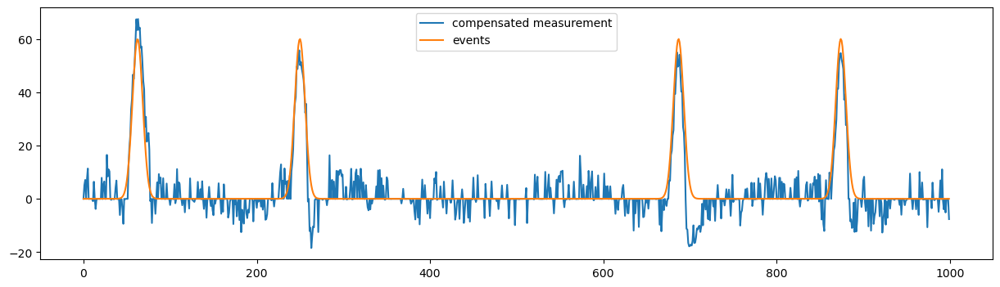

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.05257563908273203, 'q_process_noise_0': 1.8813544960629824, 'loc': 2.3656163183198857}
mse: 133.77451132291765


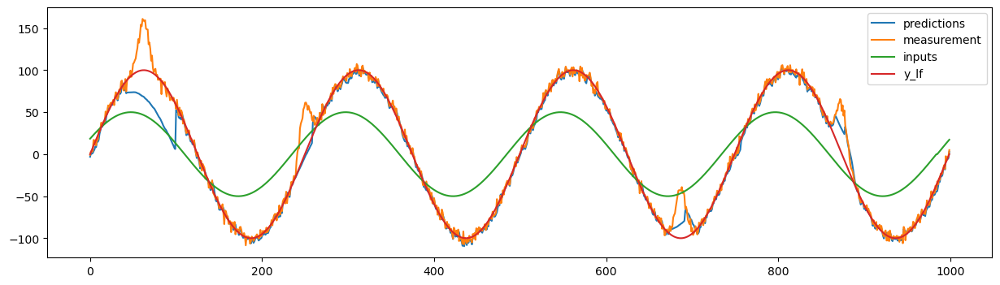

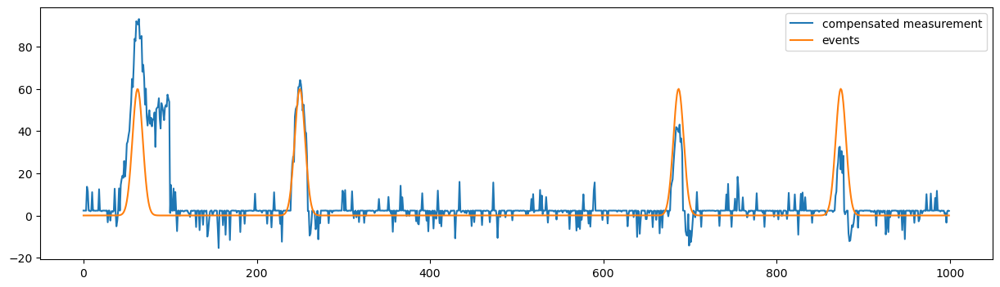

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.036817989423959155, 'q_process_noise_0': 2.2098339278377845, 'loc': 1.535991367846451}
mse: 42.030055515572585


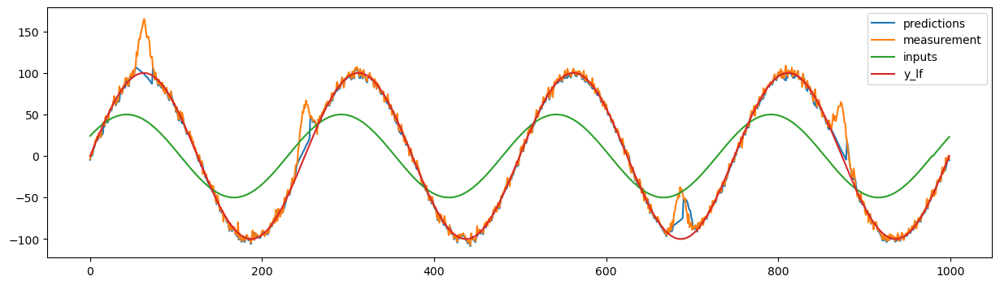

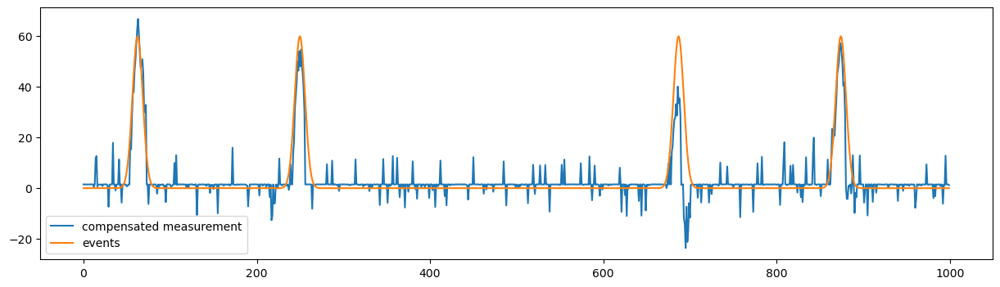

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.28911237939434153, 'q_process_noise_0': 0.6313294384588441, 'loc': 0.023470700283748987}
mse: 26.910409161100887


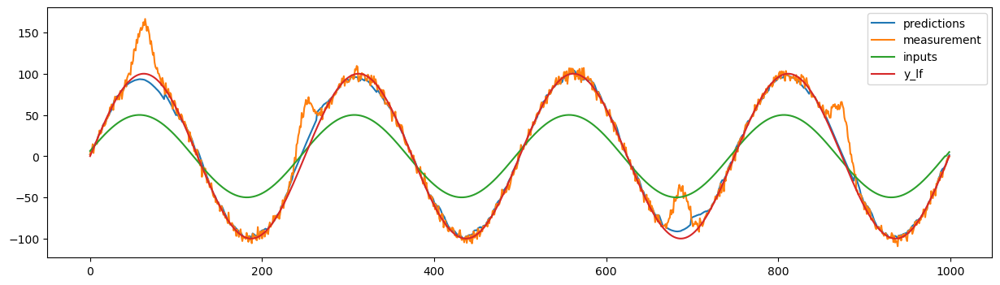

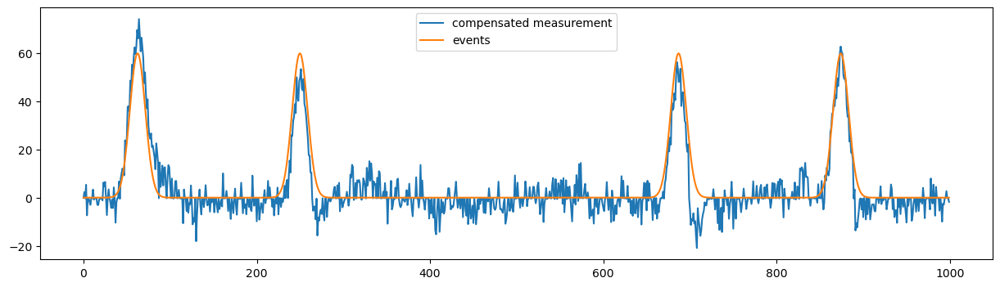

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.00013842400235463575, 'q_process_noise_0': 1.1839108285877664, 'loc': 0.16454400065666494}
mse: 57.872577278385364


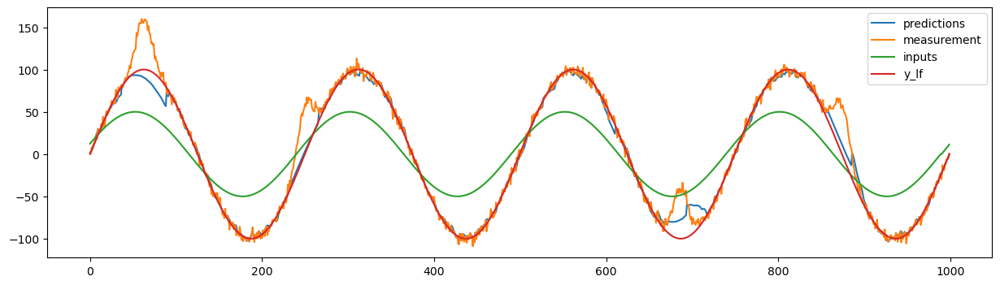

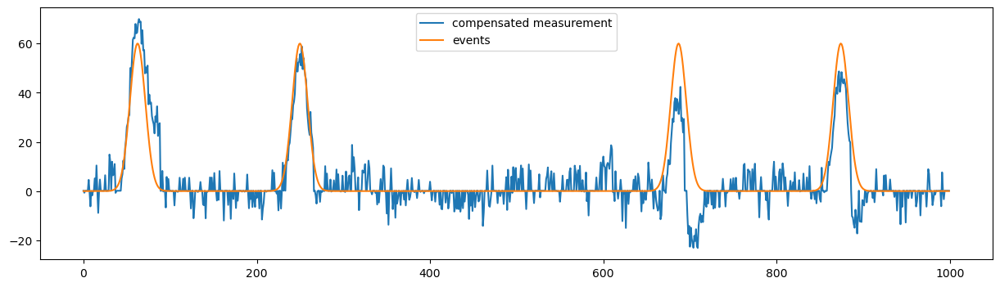

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.0010241726603333386, 'q_process_noise_0': 1.5609596840646005, 'loc': 0.7858765181626272}
mse: 49.994763026649586


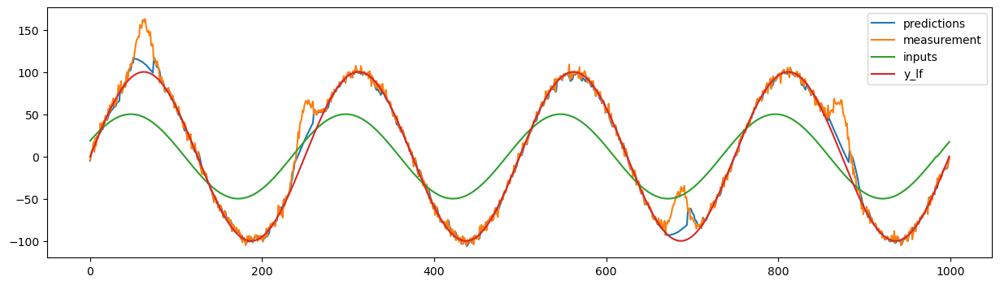

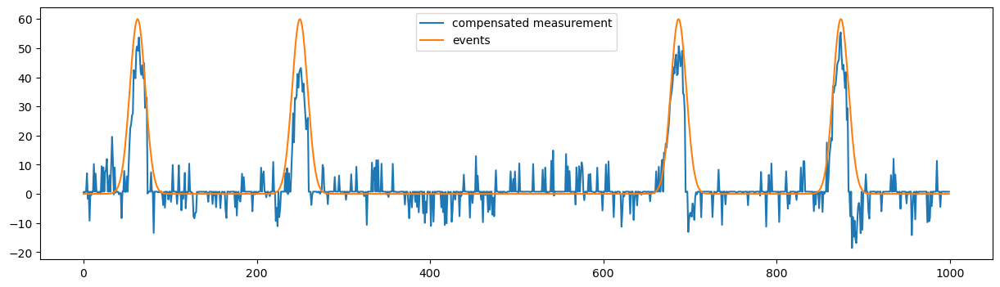

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0005844561307605901, 'q_process_noise_0': 1.9800054653762265, 'loc': 0.03152787180930433}
mse: 175.29618116655817


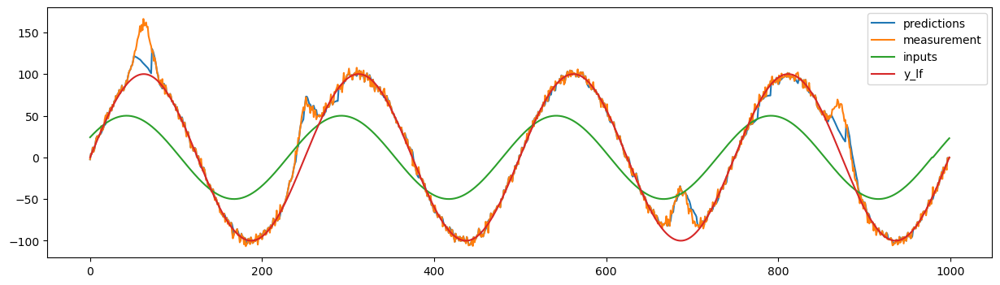

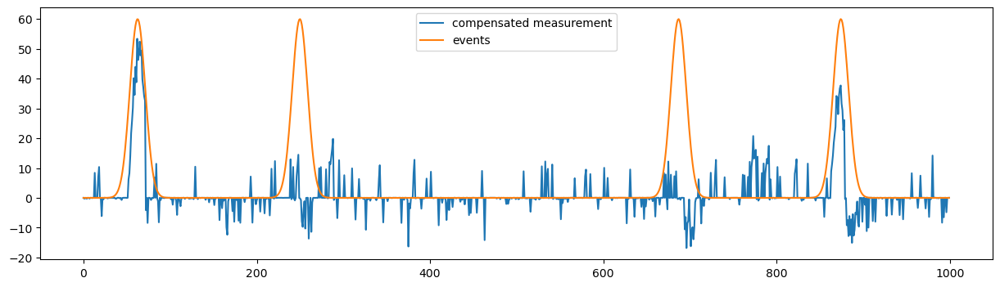

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.001056681615194748, 'q_process_noise_0': 0.7674264667846821, 'loc': 0.0007855641220588544}
mse: 54.85250226171014


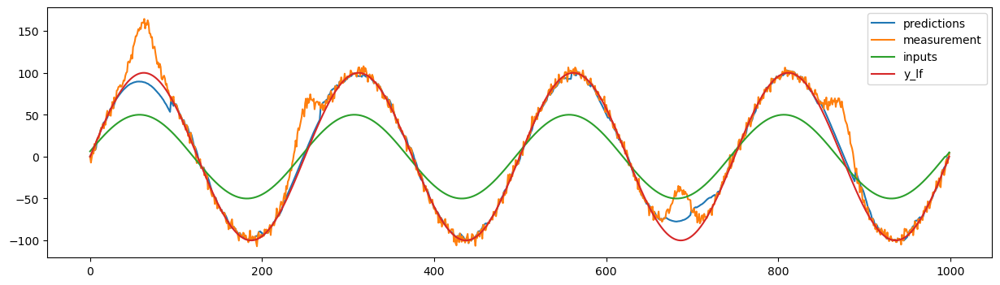

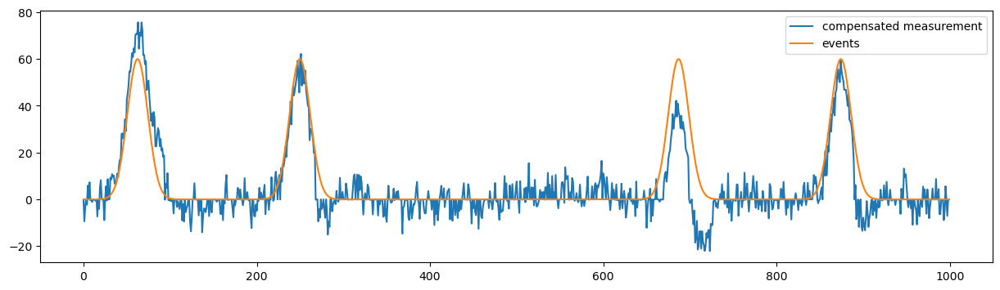

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0003409886012435456, 'q_process_noise_0': 1.0814343820185102, 'loc': 0.0002471167283720891}
mse: 80.44569731932407


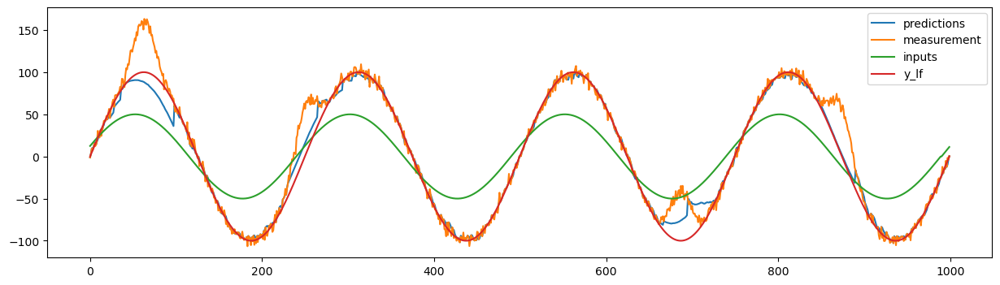

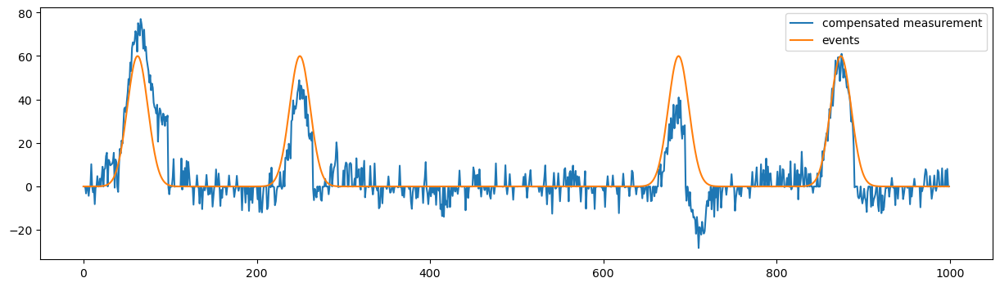

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.0010548942119226214, 'q_process_noise_0': 1.706042934420182, 'loc': 2.0535029187223426}
mse: 150.23697890566487


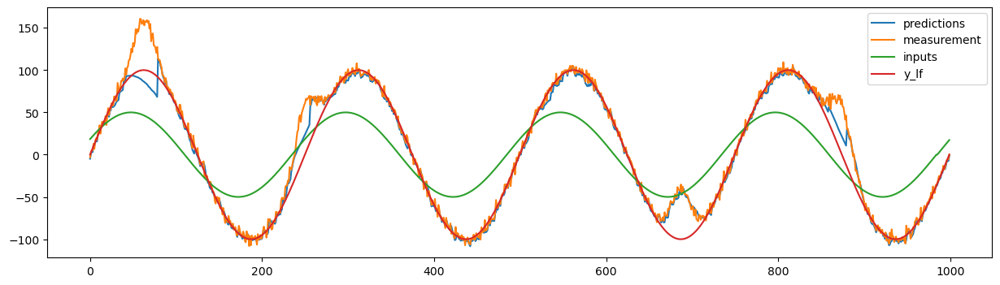

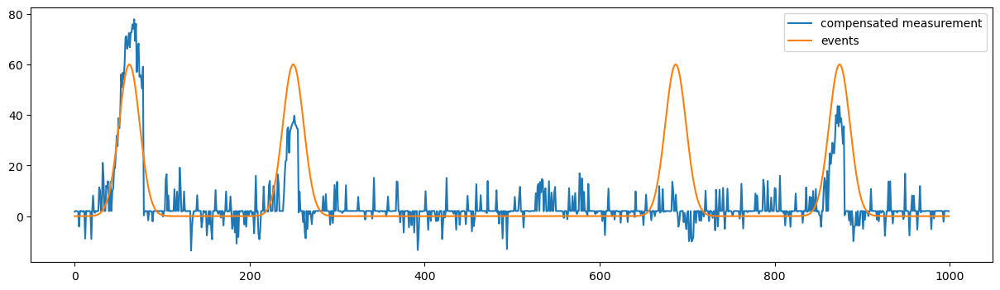

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.002943753497566802, 'q_process_noise_0': 2.505646009658034, 'loc': 6.477238533328743}
mse: 192.3775779837582


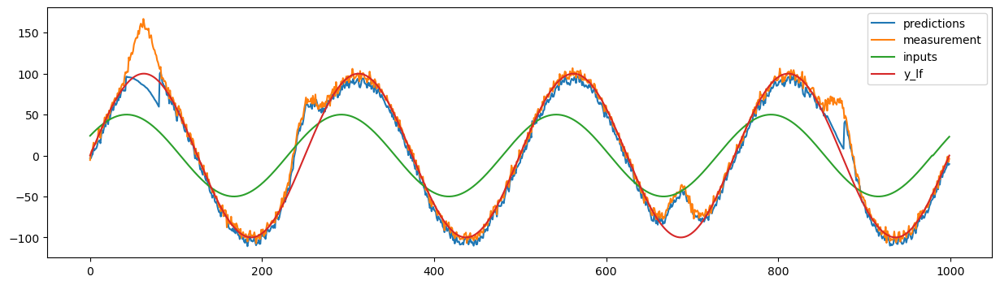

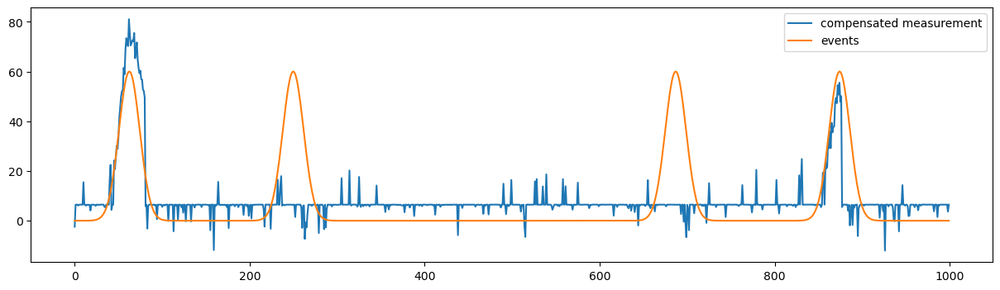

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.03259832824258603, 'q_process_noise_0': 0.7795479003641368, 'loc': 0.0004652041321720497}
mse: 36.74688046654203


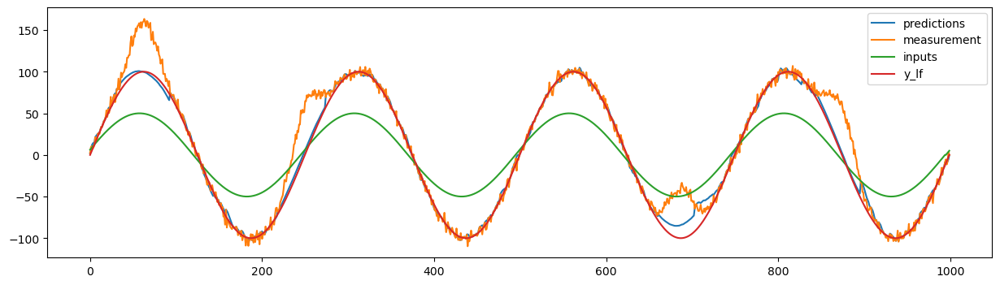

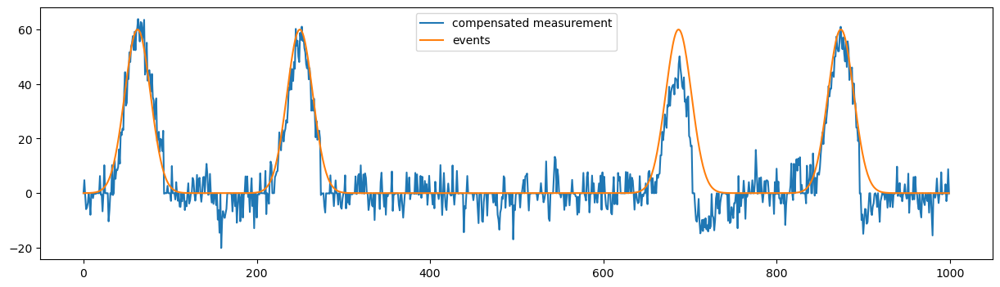

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.03450099086772451, 'q_process_noise_0': 1.2171642431415461, 'loc': 3.7635752585216435}
mse: 145.1289032204329


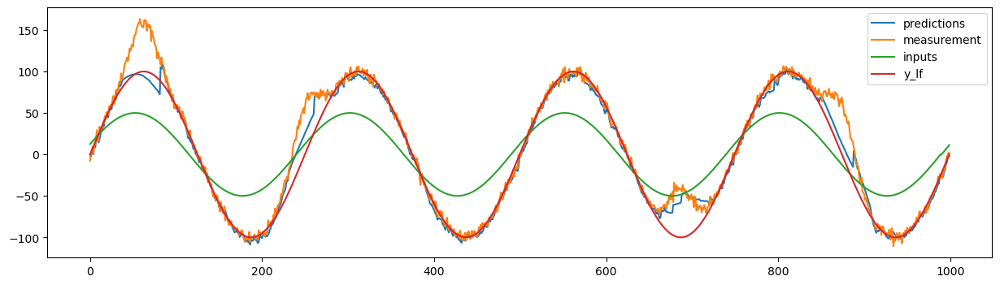

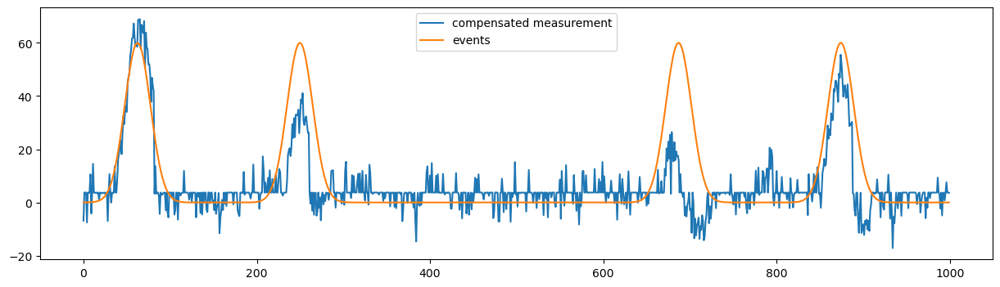

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.003223860145425111, 'q_process_noise_0': 1.618796570144917, 'loc': 0.00010891344093321514}
mse: 236.7947572203905


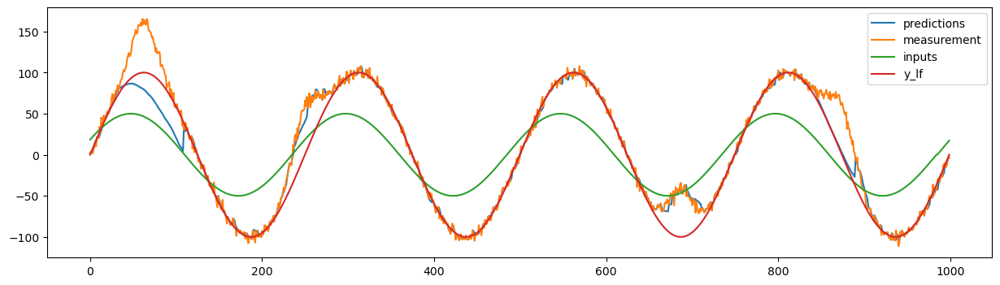

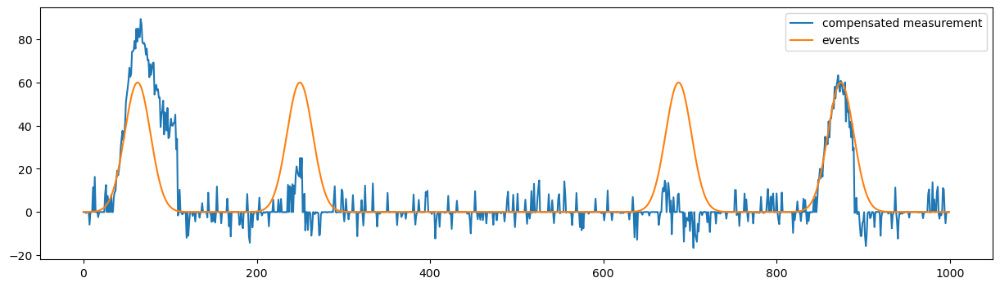

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0025396598634613104, 'q_process_noise_0': 2.342768853537473, 'loc': 10.88524588135888}
mse: 306.8658880031667


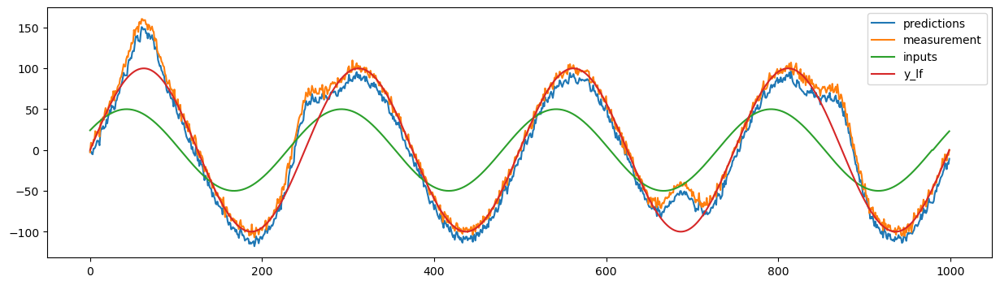

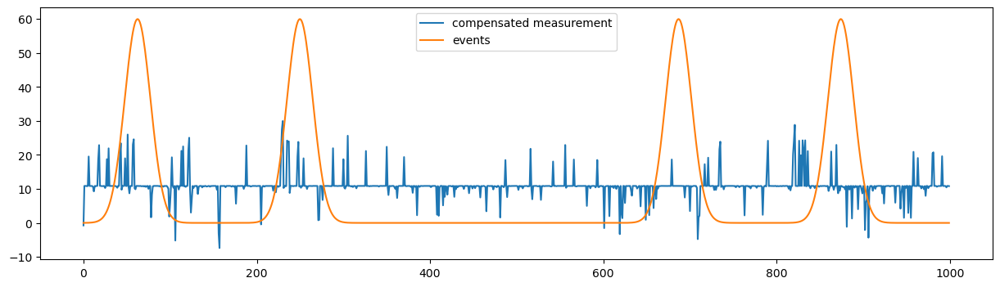

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.11900529838292984, 'q_process_noise_0': 0.6367357823880508, 'loc': 0.002836753489687459}
mse: 96.40365532722149


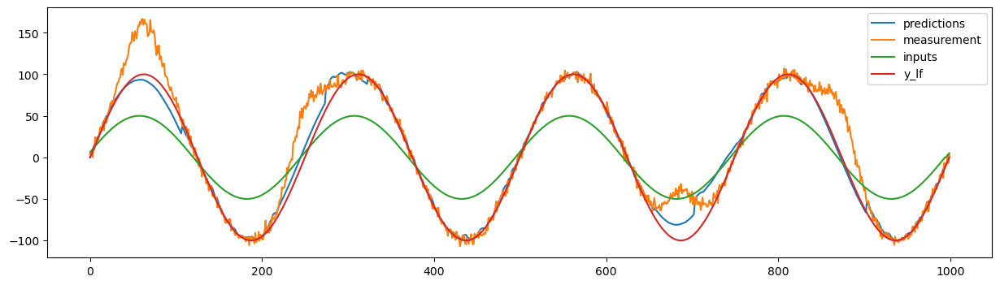

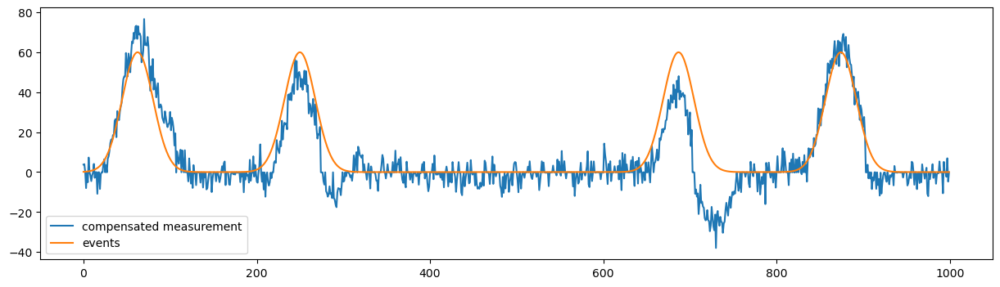

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.05626679353544993, 'q_process_noise_0': 0.9299649117228079, 'loc': 0.0009973287930837738}
mse: 244.38288812445072


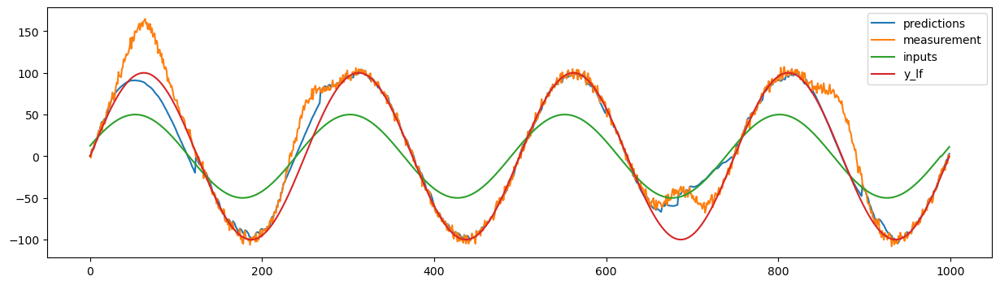

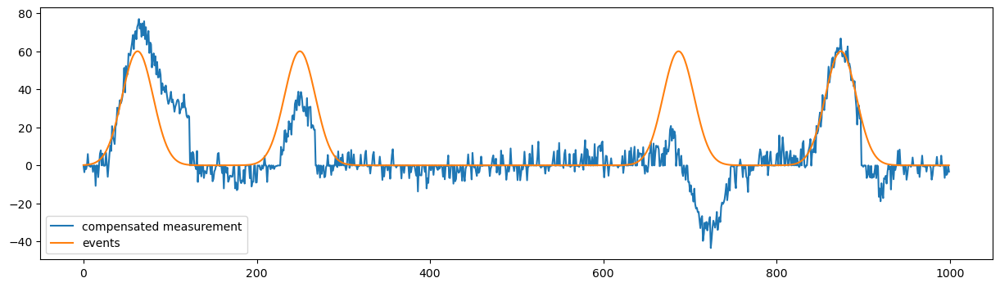

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.2387524895249212, 'q_process_noise_0': 1.5765947445271546, 'loc': 11.43813720043358}
mse: 307.7280483022273


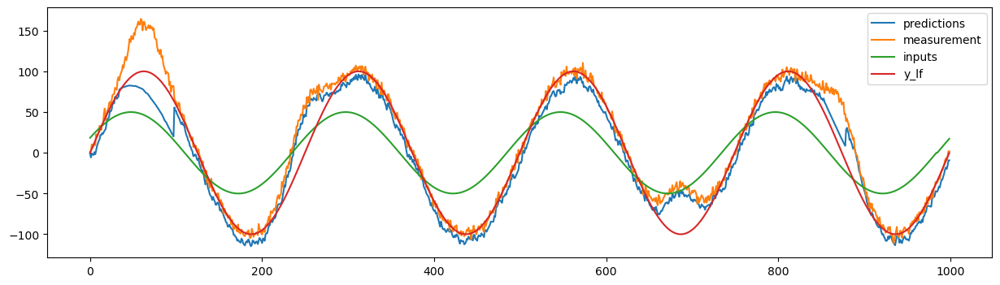

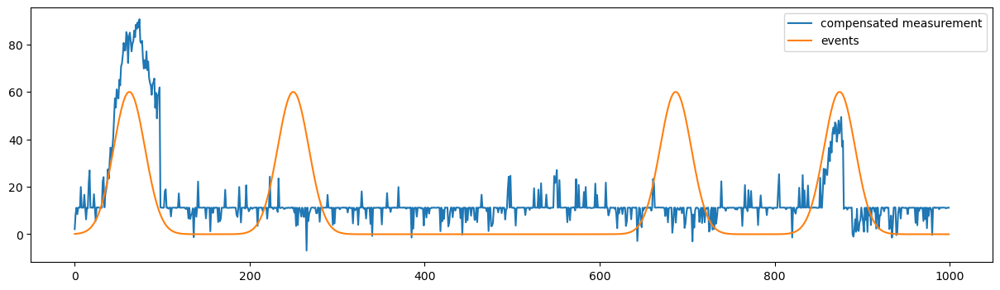

event_to_trend_amplitude: 0.30000000000000004 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 1.3380460493825284, 'q_process_noise_0': 1.575540100457418, 'loc': 9.658945718347823}
mse: 333.39369312179576


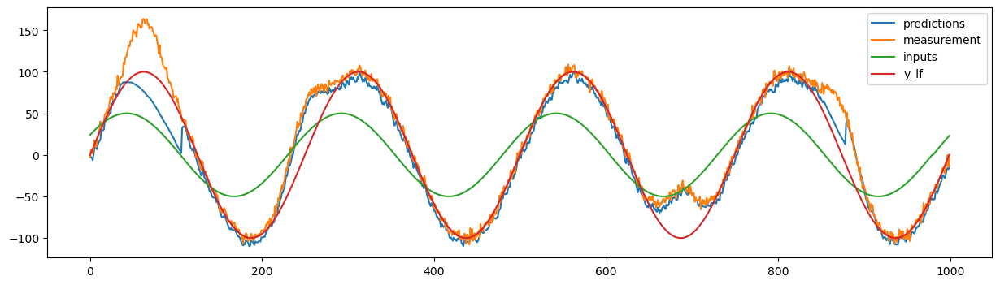

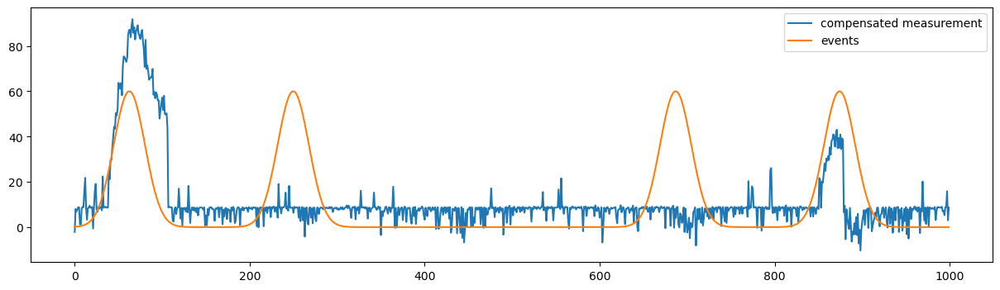

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.34881601644290816, 'q_process_noise_0': 0.8136907887162684, 'loc': 0.5187899072316339}
mse: 10.185564200241767


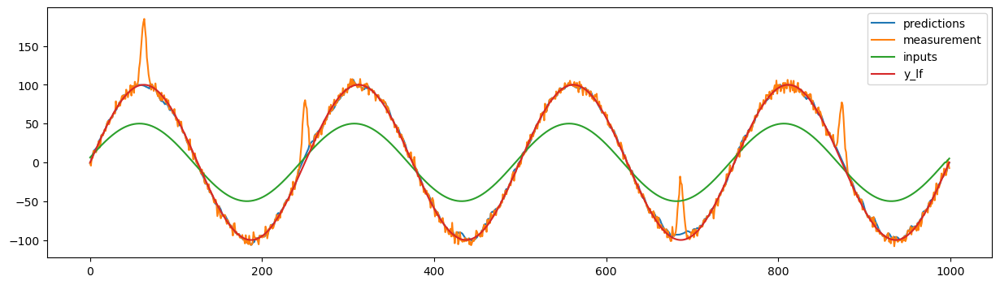

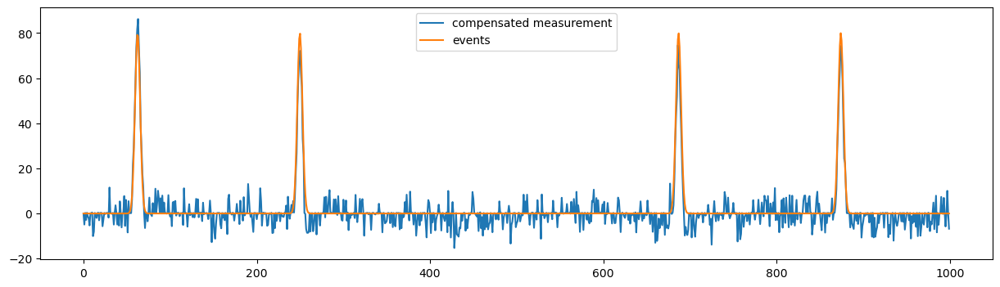

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0013027665434529026, 'q_process_noise_0': 1.402398131607442, 'loc': 0.48382268056237204}
mse: 21.973577993489336


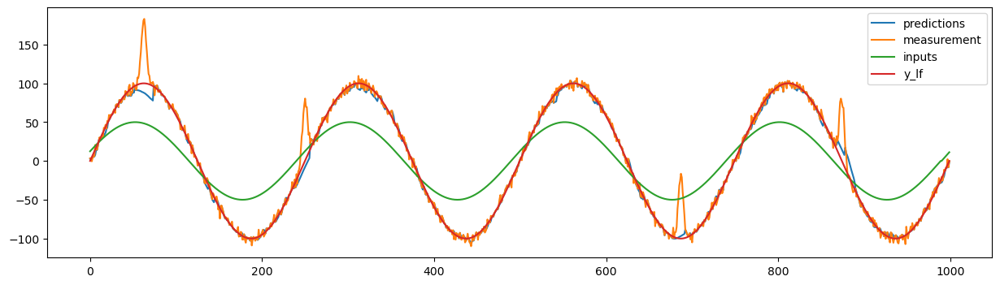

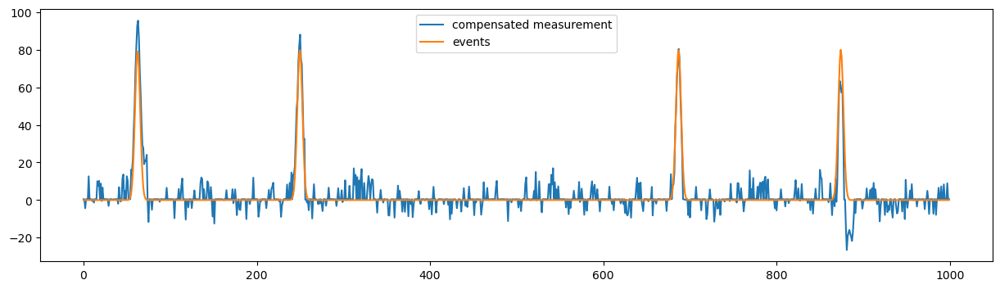

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.0208247066672947, 'q_process_noise_0': 1.9827753003155113, 'loc': 0.0006451453416100811}
mse: 21.240568184840445


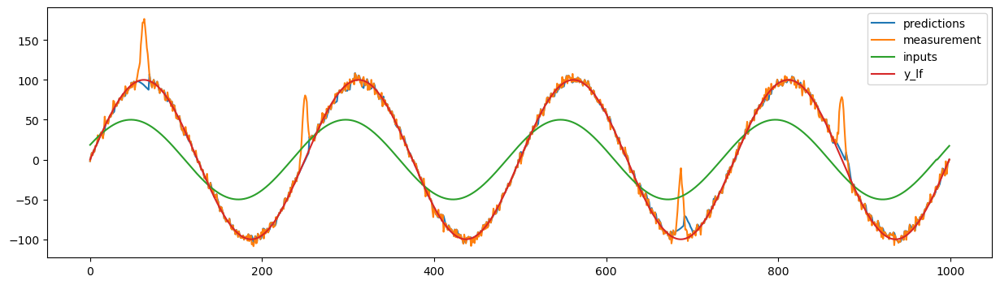

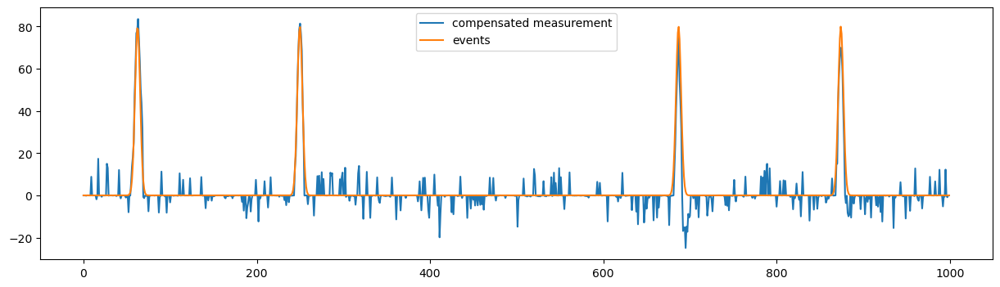

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.00023172750256398385, 'q_process_noise_0': 2.0869341387954026, 'loc': 0.003208375643319819}
mse: 24.513359313251204


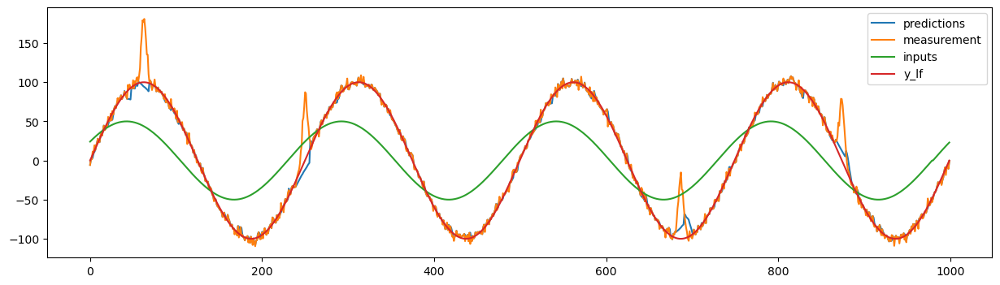

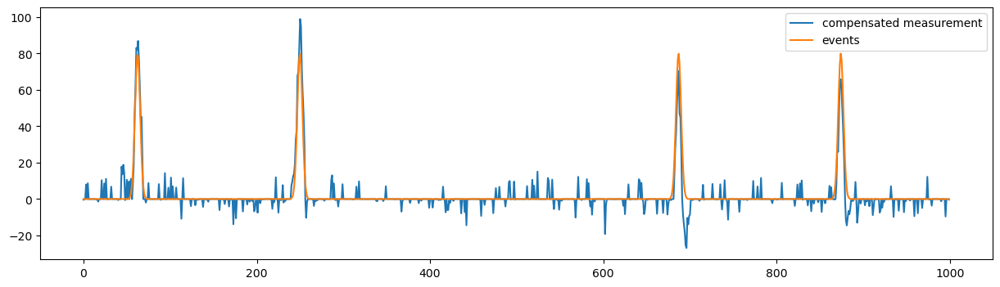

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.00042088077198823776, 'q_process_noise_0': 1.0391489748823883, 'loc': 0.06307699285193656}
mse: 14.112123571844954


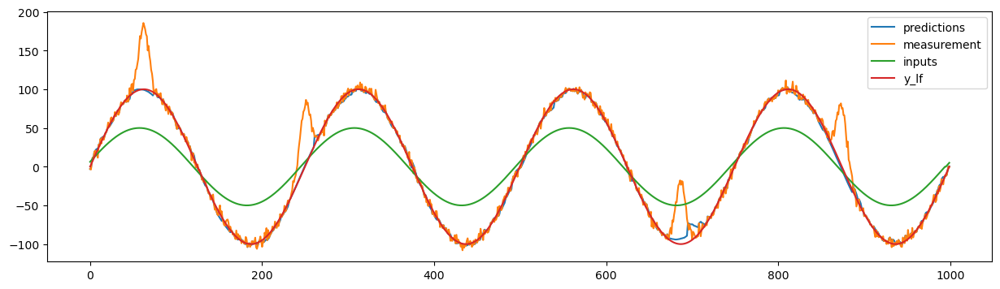

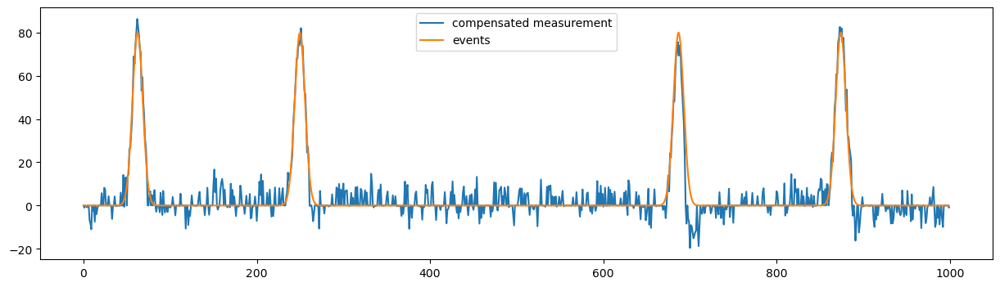

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0005554787772687257, 'q_process_noise_0': 1.399760855480075, 'loc': 0.00030291705672557924}
mse: 35.068157392221146


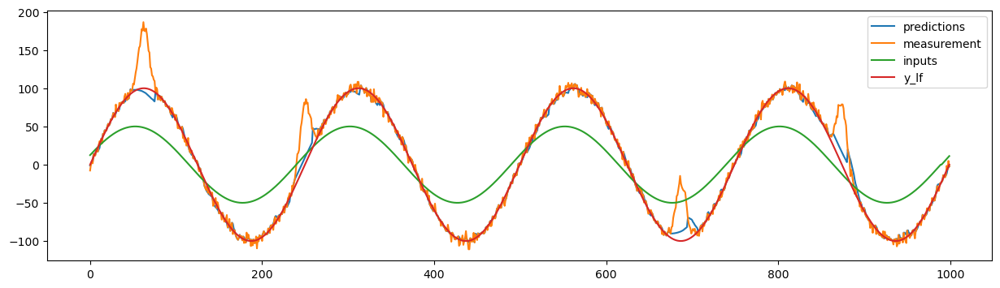

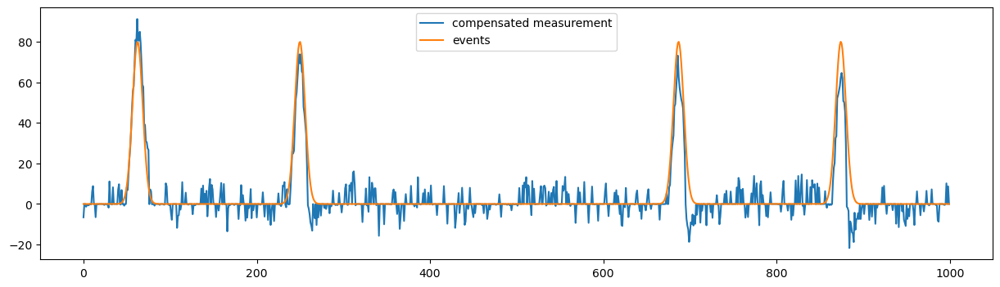

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00021466416440204289, 'q_process_noise_0': 1.5456328996237552, 'loc': 0.00012184184432599687}
mse: 68.02172627776555


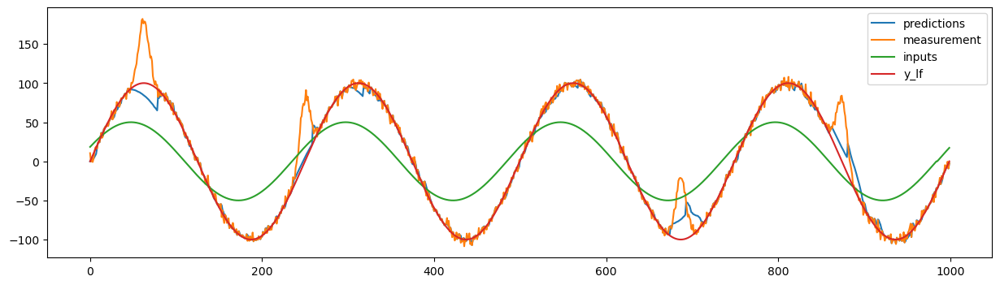

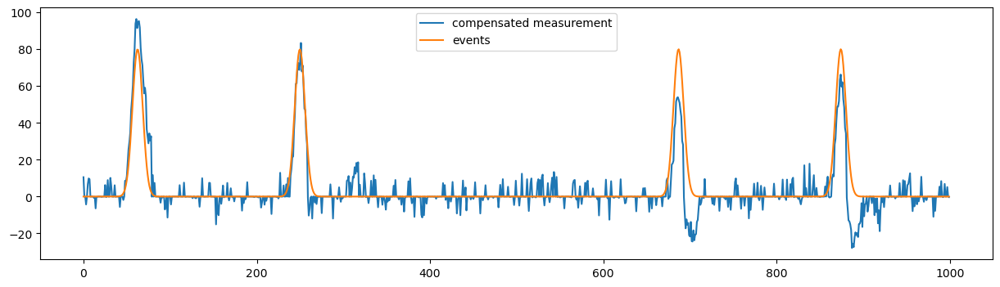

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0018348365451644488, 'q_process_noise_0': 1.8704670684191311, 'loc': 1.5973532388145217}
mse: 83.14612746399237


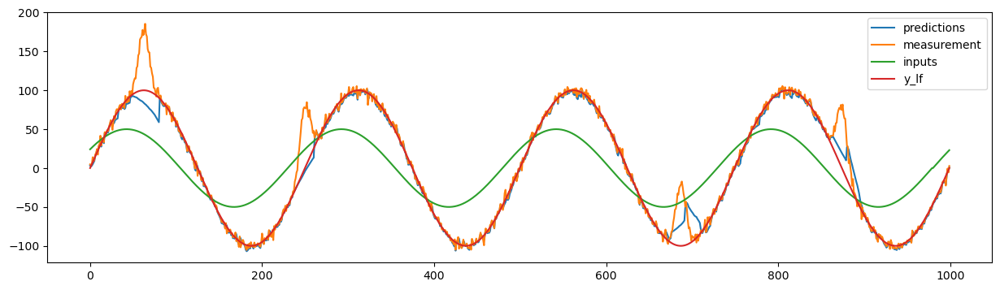

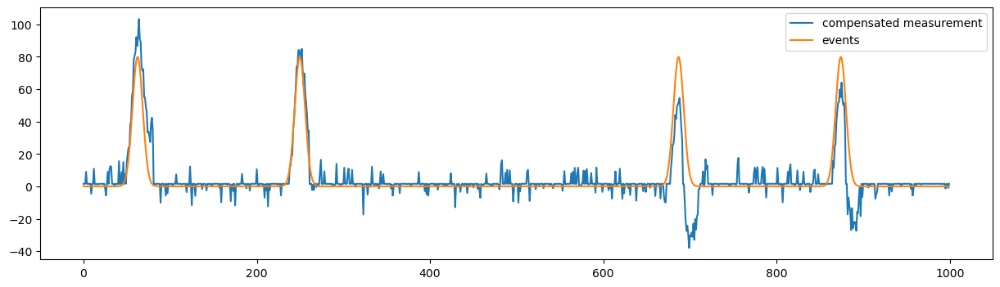

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0002611199300517094, 'q_process_noise_0': 0.7697577399158541, 'loc': 0.0768315954980258}
mse: 24.45578623790532


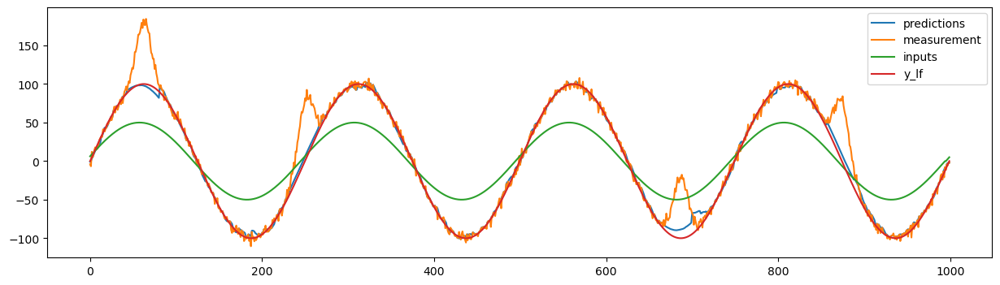

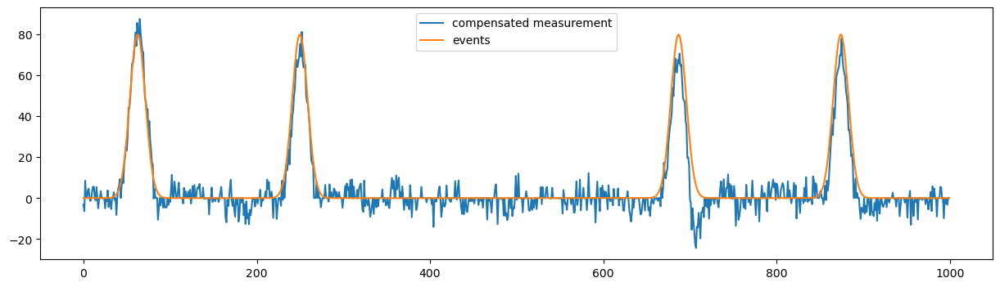

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.013244307567576807, 'q_process_noise_0': 1.4180049240312207, 'loc': 0.00025031406535082974}
mse: 50.21400531920054


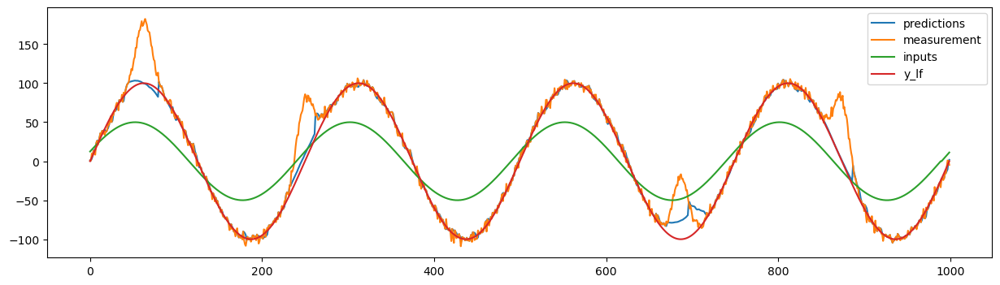

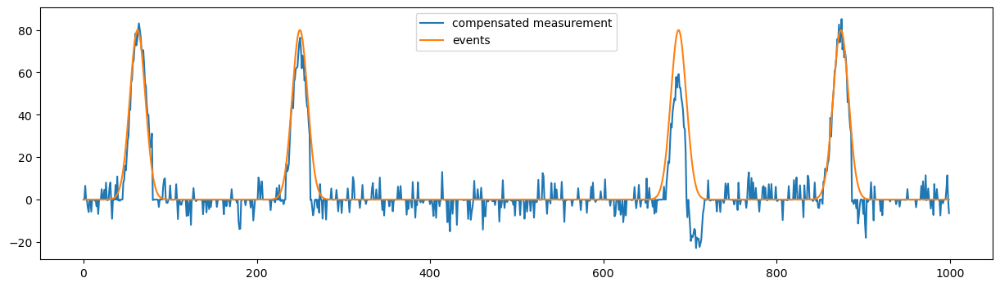

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.14845106673970343, 'q_process_noise_0': 1.6762792258651322, 'loc': 0.0015408611470379367}
mse: 140.23861589723018


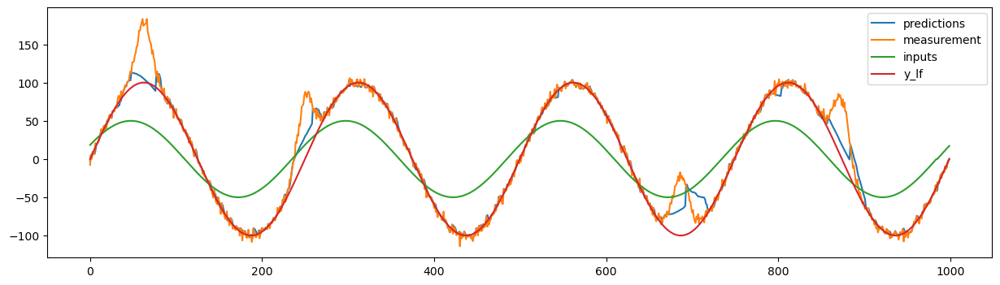

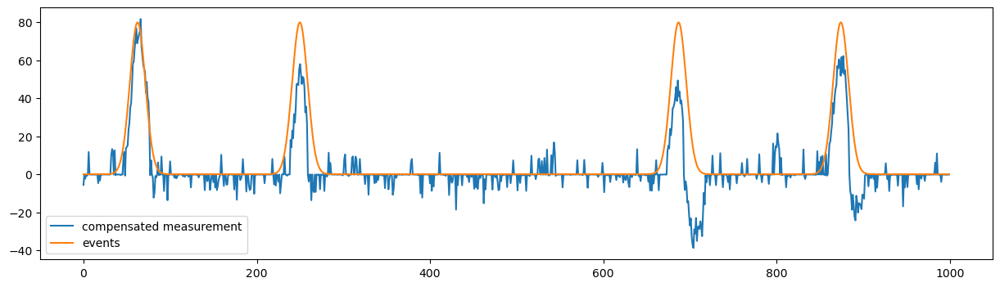

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.009815676836968627, 'q_process_noise_0': 1.906328534654088, 'loc': 1.3923765245183897}
mse: 207.2453889937826


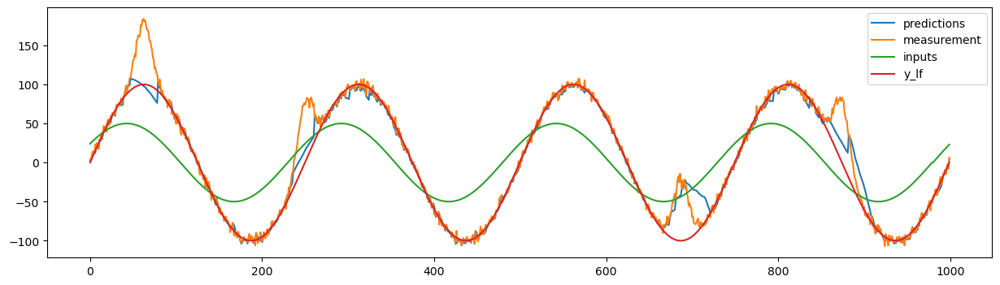

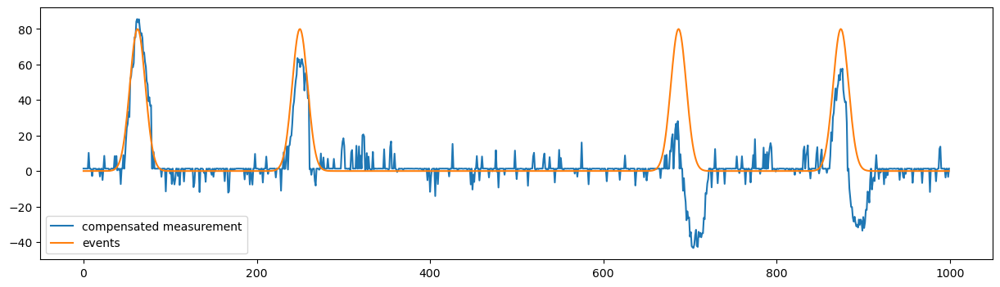

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0815187174520051, 'q_process_noise_0': 0.6297077283600466, 'loc': 0.14187445784705863}
mse: 108.13999534666297


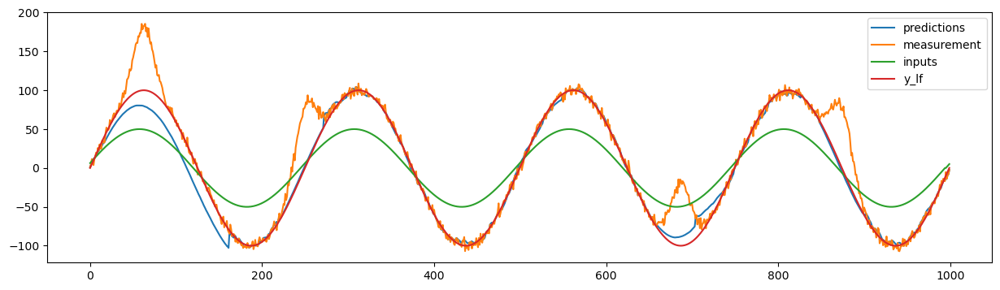

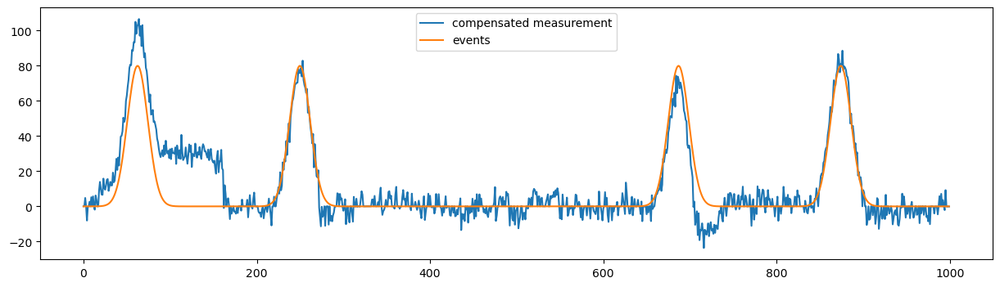

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.09386908349840281, 'q_process_noise_0': 1.0945805246004474, 'loc': 0.0011129890901543339}
mse: 186.59203030835087


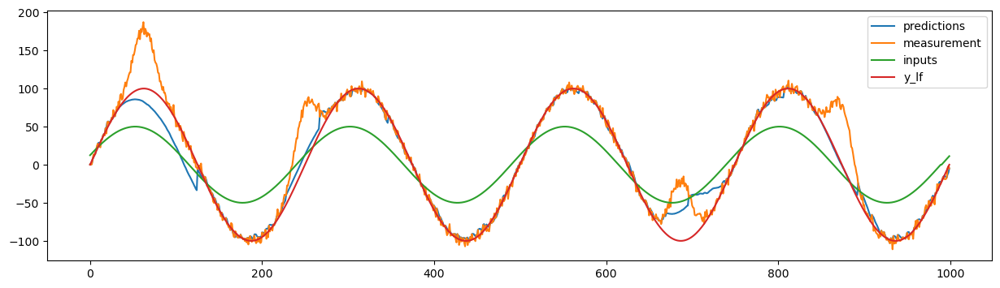

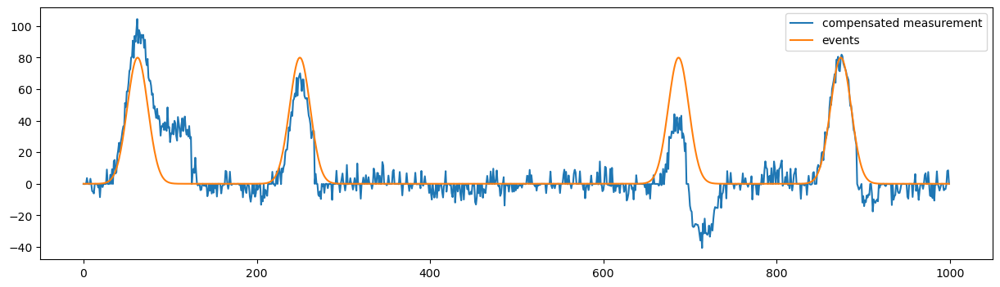

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.15051780166165524, 'q_process_noise_0': 1.5037027822522493, 'loc': 0.0054595735732101405}
mse: 253.15369623708273


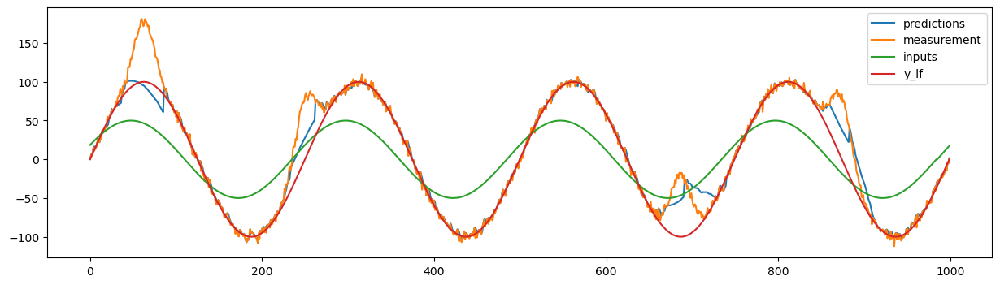

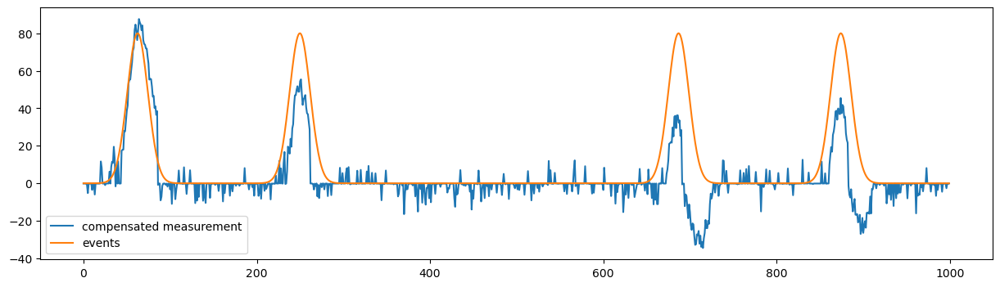

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0003816039752453138, 'q_process_noise_0': 1.854899040846034, 'loc': 3.6720569316956517}
mse: 180.6281805876002


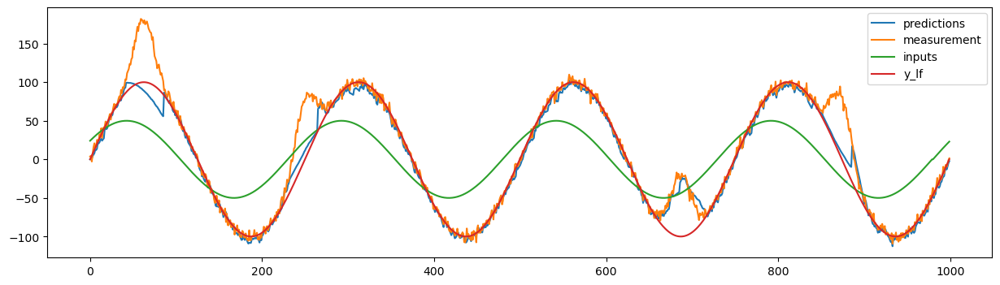

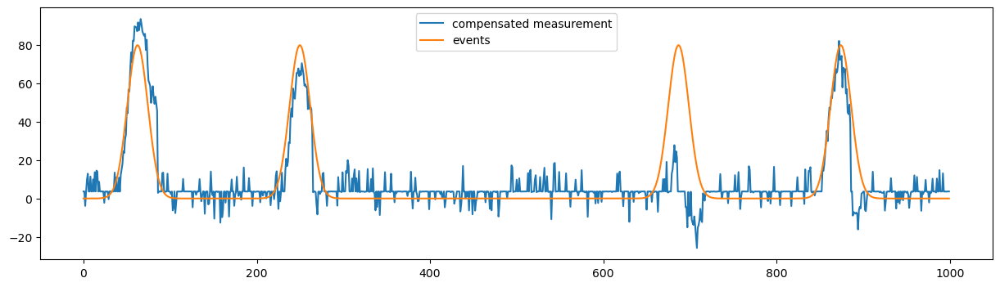

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.48638250635094743, 'q_process_noise_0': 0.5740324603843279, 'loc': 5.400273368398514}
mse: 43.910966298695215


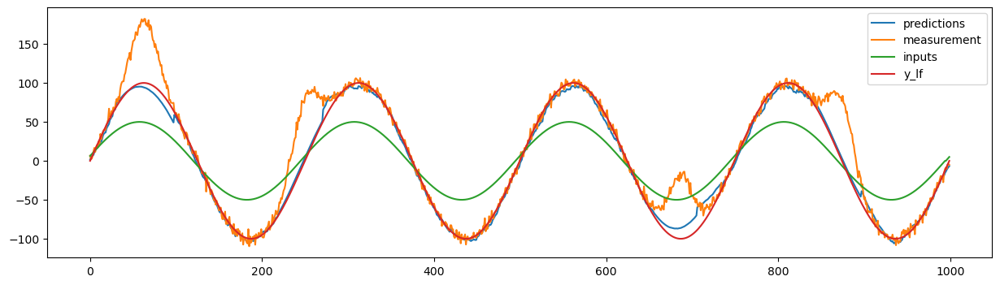

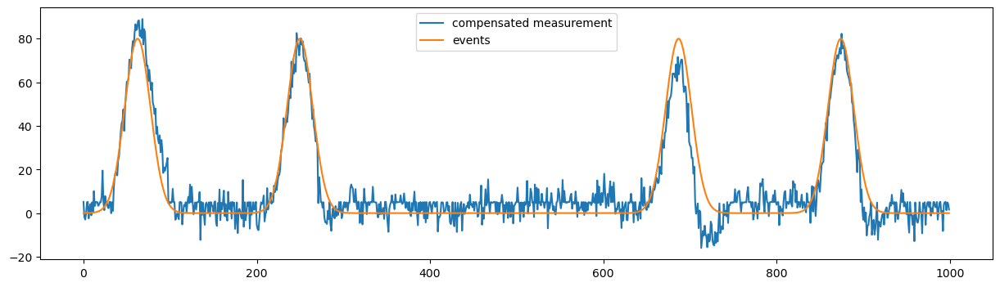

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.005593735707920705, 'q_process_noise_0': 1.2079749778660678, 'loc': 1.7294221261981946}
mse: 97.39689608476833


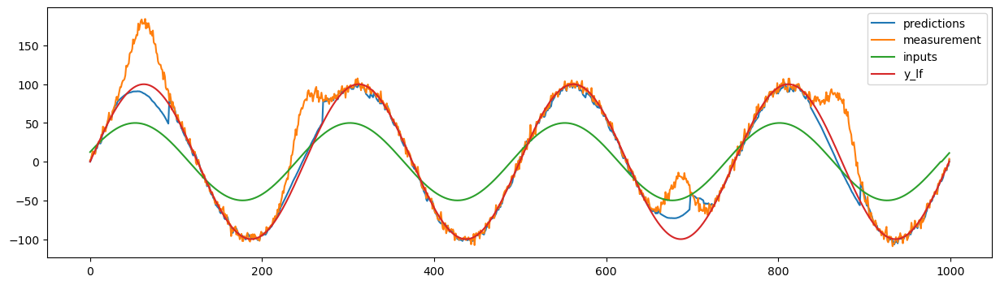

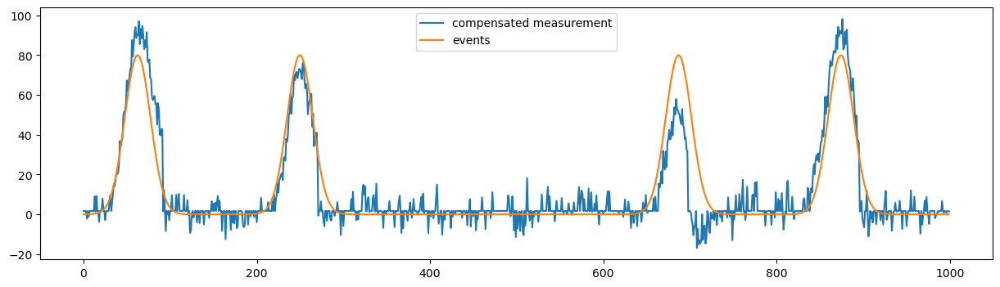

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.14956937098230477, 'q_process_noise_0': 1.085454557963925, 'loc': 0.04284495674714549}
mse: 494.39929948033057


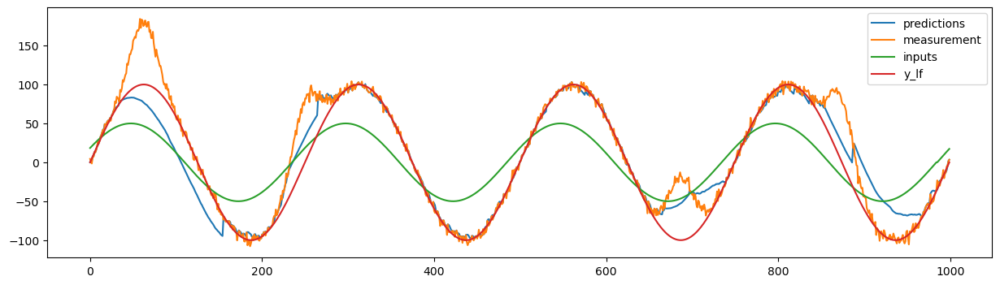

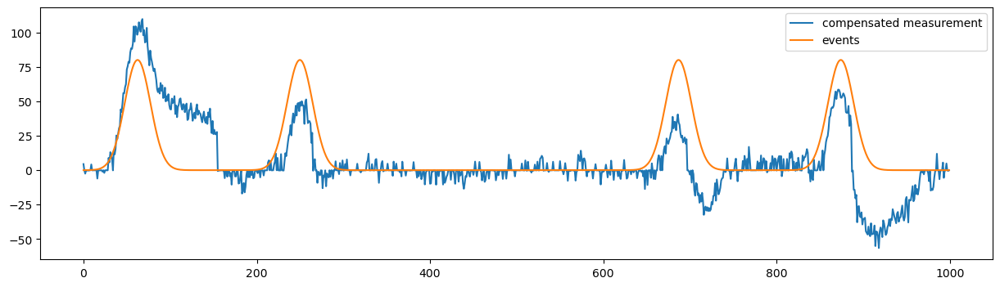

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0003919030907777844, 'q_process_noise_0': 1.7811040059261556, 'loc': 7.2877489566140135}
mse: 238.26966638306374


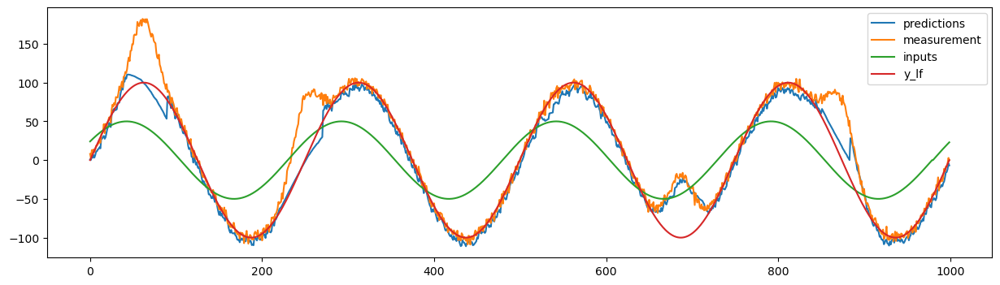

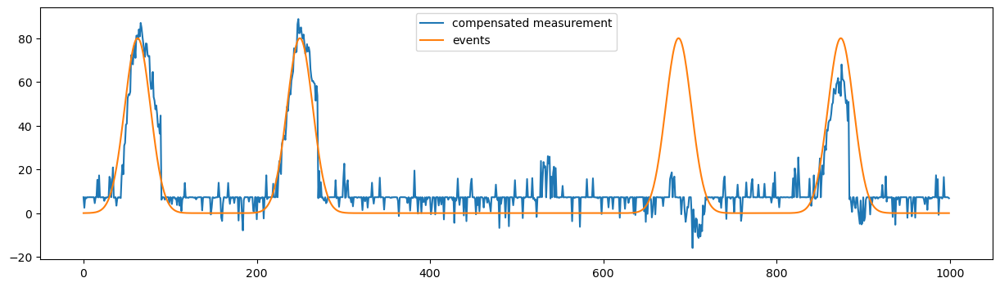

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.010954192639270681, 'q_process_noise_0': 0.7209356323285141, 'loc': 1.935997079404526}
mse: 92.06386177221243


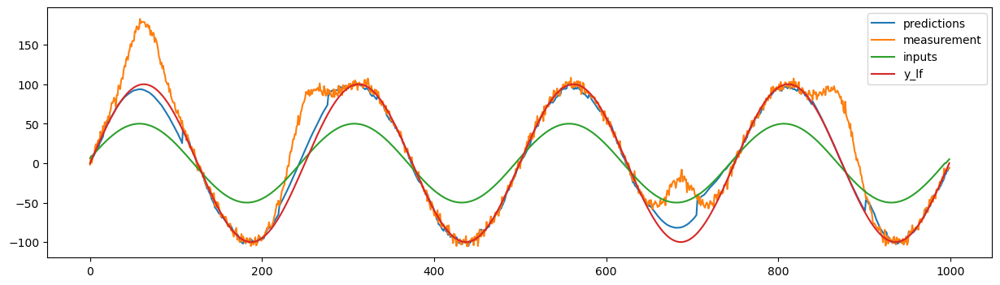

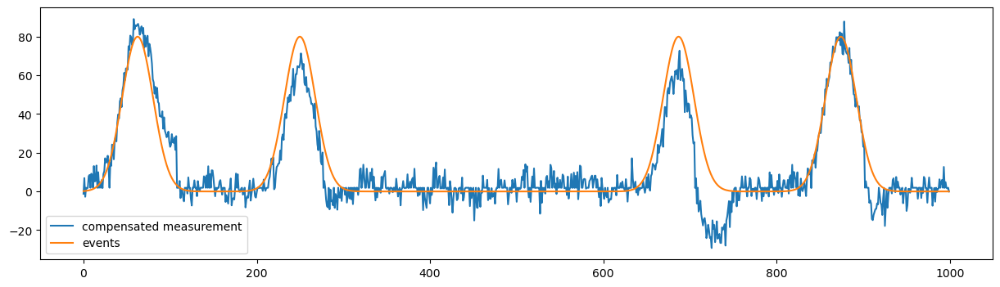

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.00012093820750257125, 'q_process_noise_0': 1.2168848391804767, 'loc': 0.3450722486457696}
mse: 259.3202607216661


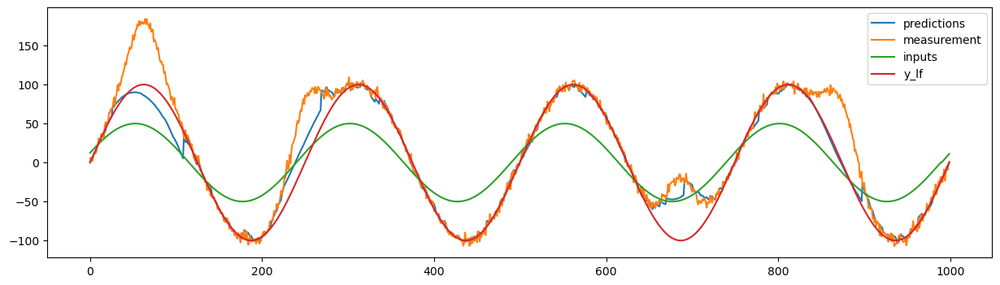

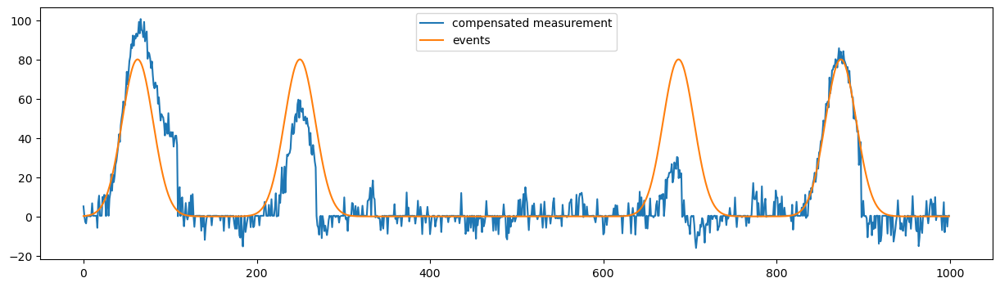

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00012752965939113764, 'q_process_noise_0': 1.4987871768964691, 'loc': 5.443992097499059}
mse: 340.2366205034992


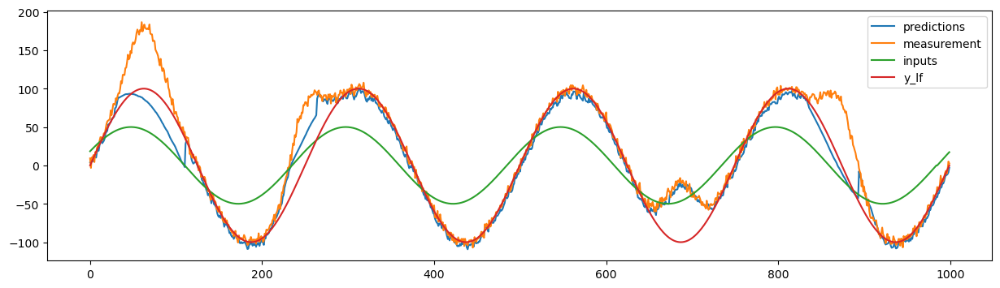

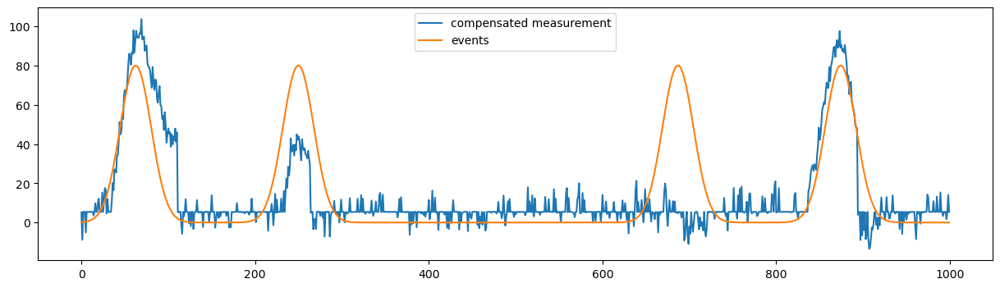

event_to_trend_amplitude: 0.4 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0005223930166913899, 'q_process_noise_0': 1.5919270918552624, 'loc': 3.2230526370934}
mse: 642.1112455926898


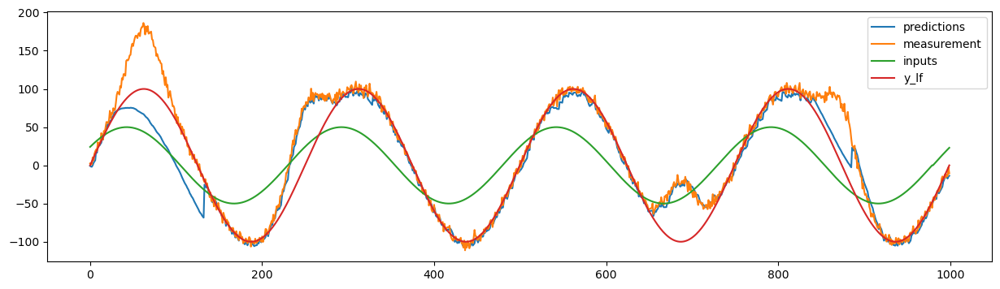

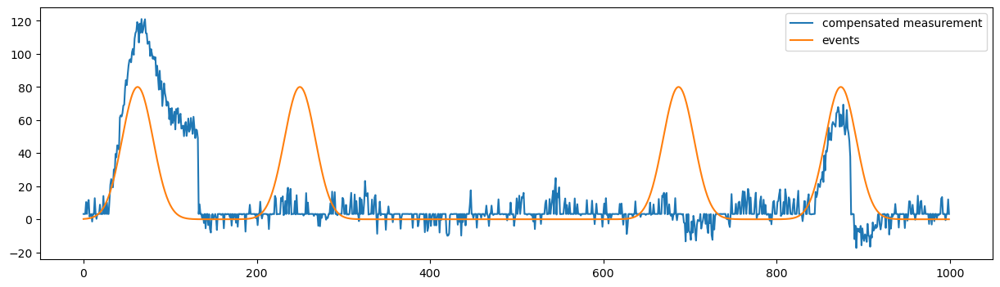

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.11001236719631226, 'q_process_noise_0': 0.7946060566673301, 'loc': 0.3802942499865637}
mse: 7.944821967629963


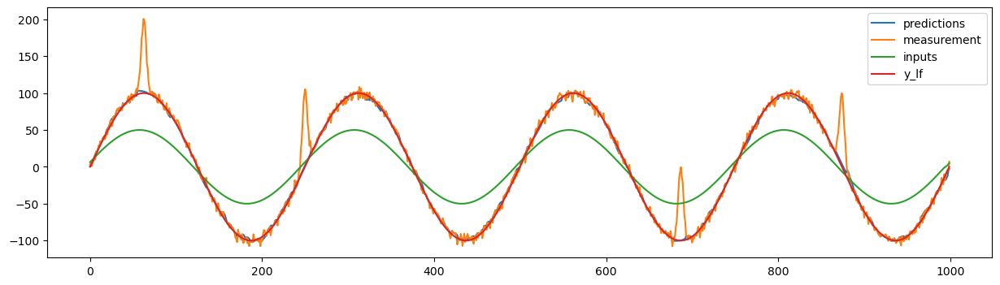

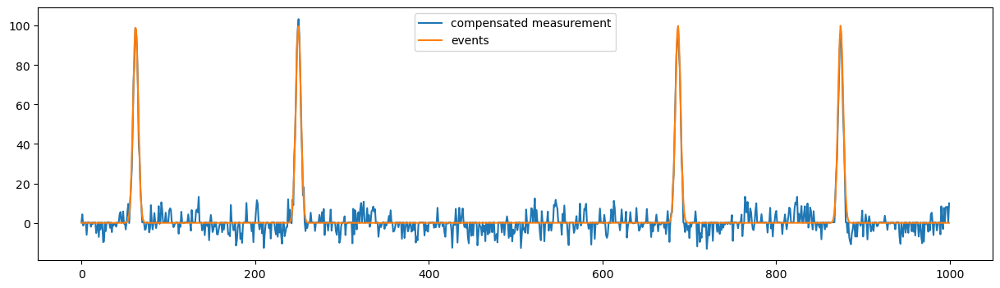

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0011737295486667746, 'q_process_noise_0': 1.2902101391665972, 'loc': 0.008828665783881195}
mse: 28.59330624905494


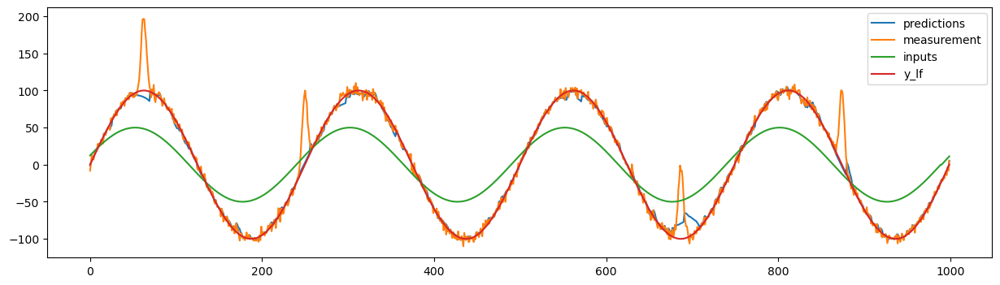

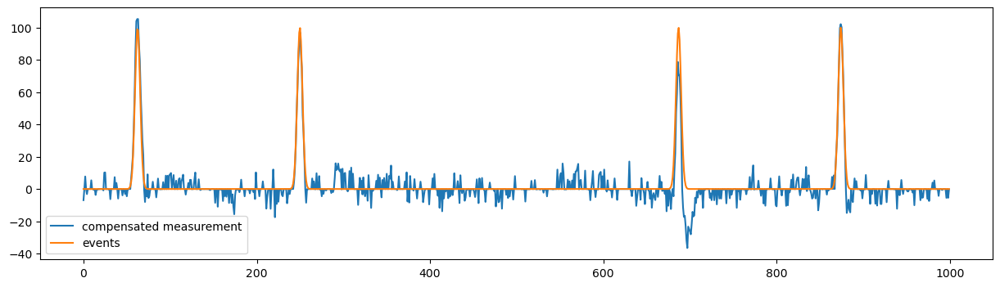

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.3184801780384919, 'q_process_noise_0': 1.2046792639887167, 'loc': 0.21642142244516152}
mse: 24.122101744492685


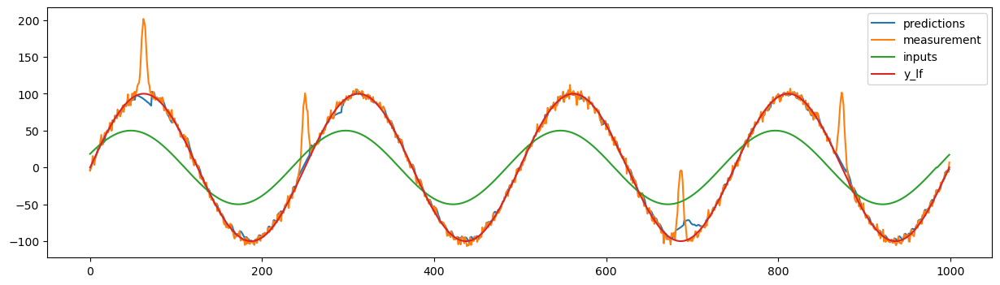

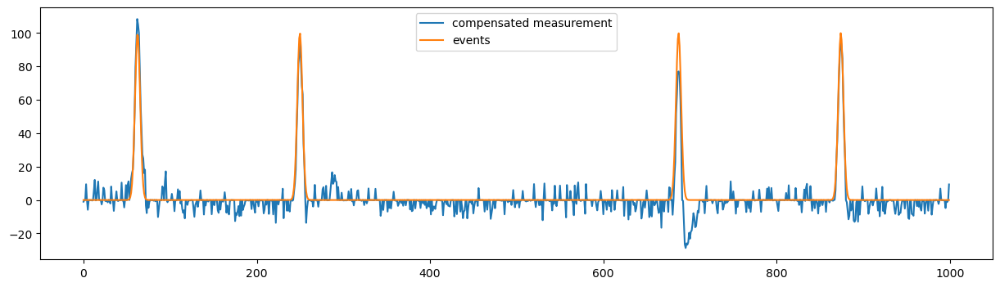

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0007751616148412339, 'q_process_noise_0': 2.5333344363880634, 'loc': 0.003919142485892629}
mse: 27.743711828730753


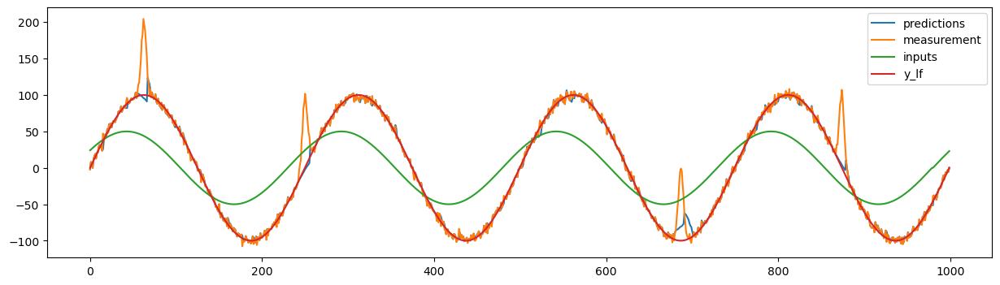

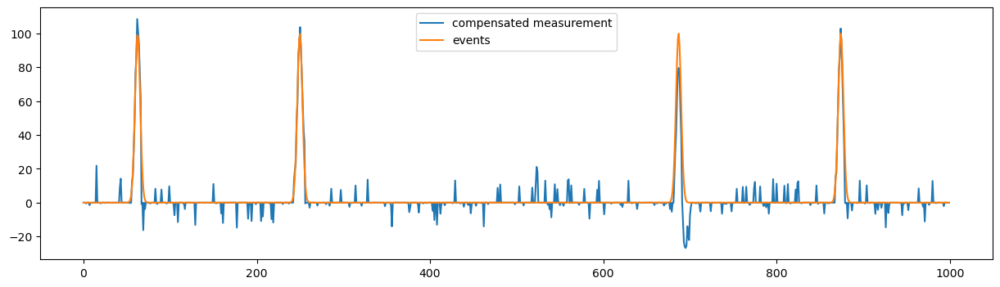

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.14834912345841947, 'q_process_noise_0': 0.577311252413932, 'loc': 0.02104915446444976}
mse: 12.924991037271717


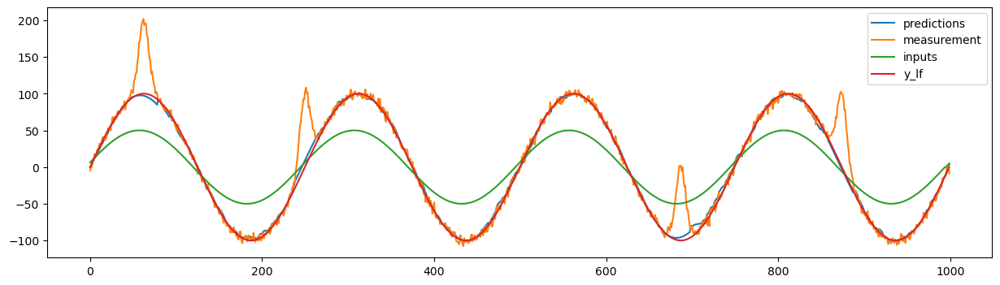

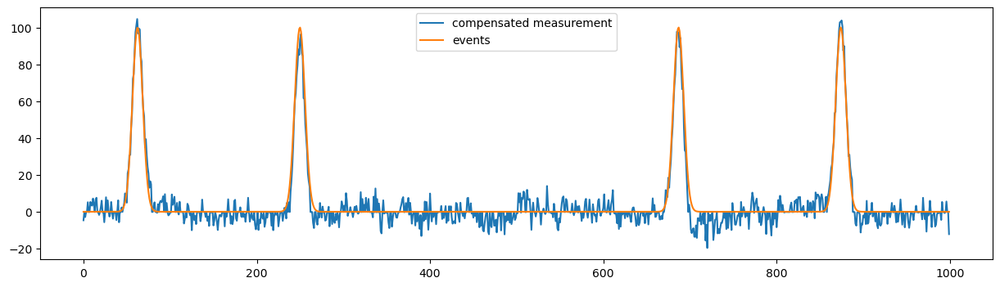

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.20694409175452427, 'q_process_noise_0': 1.3585856951919606, 'loc': 0.6940988230296682}
mse: 24.999072143699564


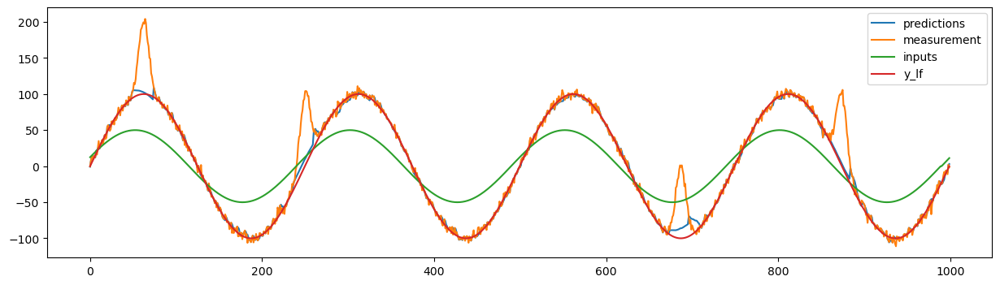

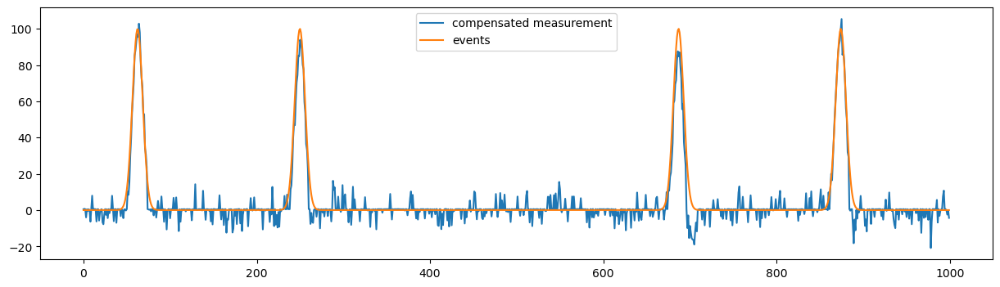

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.46049372344932005, 'q_process_noise_0': 1.6880383012221252, 'loc': 0.015608012073544396}
mse: 47.05482513043542


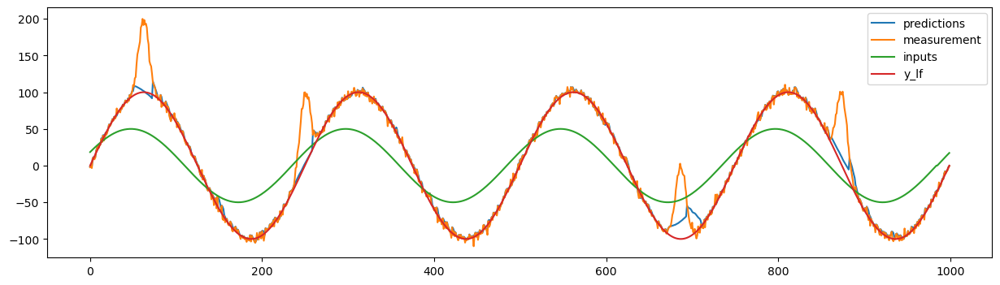

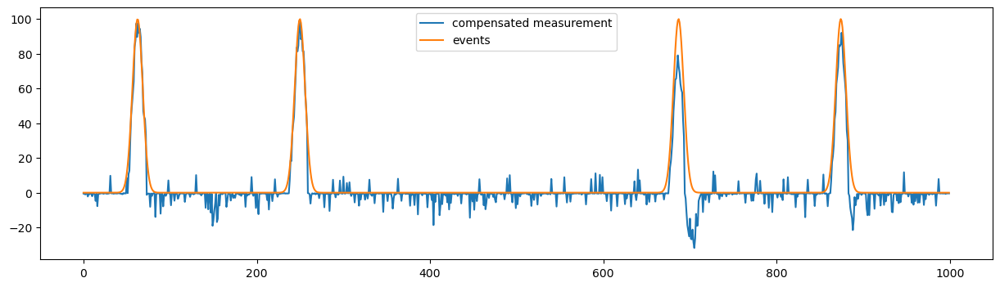

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0006534860741126015, 'q_process_noise_0': 1.9102302906776762, 'loc': 0.003237547328466686}
mse: 69.2490363271452


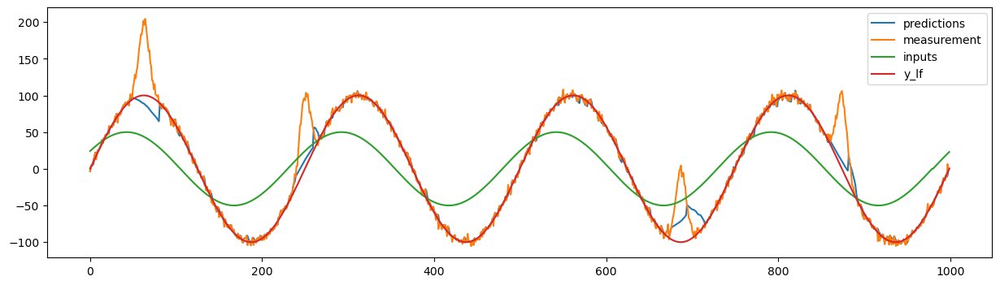

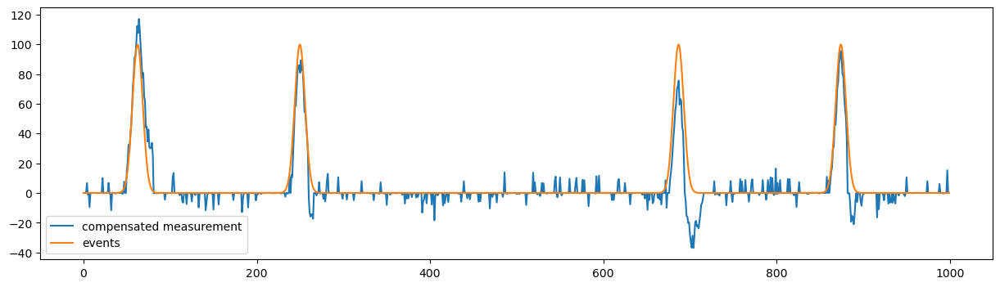

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.00014383503752558716, 'q_process_noise_0': 0.9328574056911221, 'loc': 0.11148070775215353}
mse: 31.704911198640474


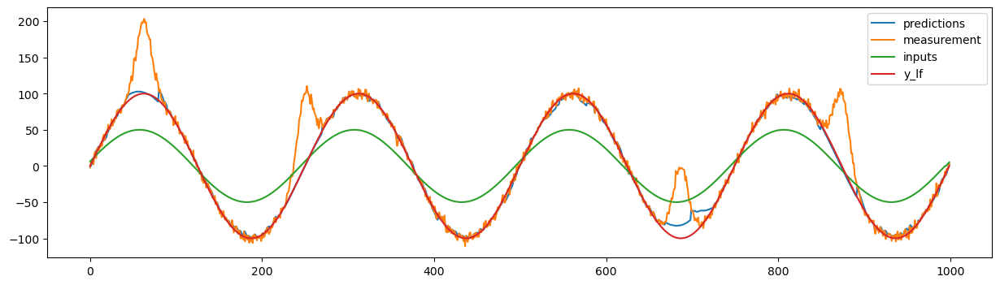

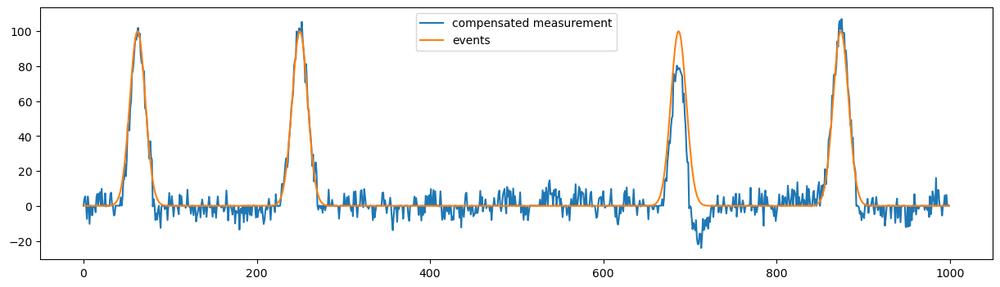

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.0002941304558620542, 'q_process_noise_0': 1.4026531853770103, 'loc': 0.000644335567017104}
mse: 57.076343341764485


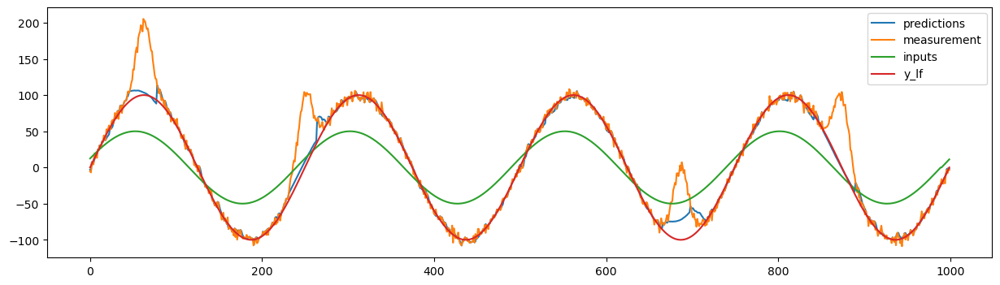

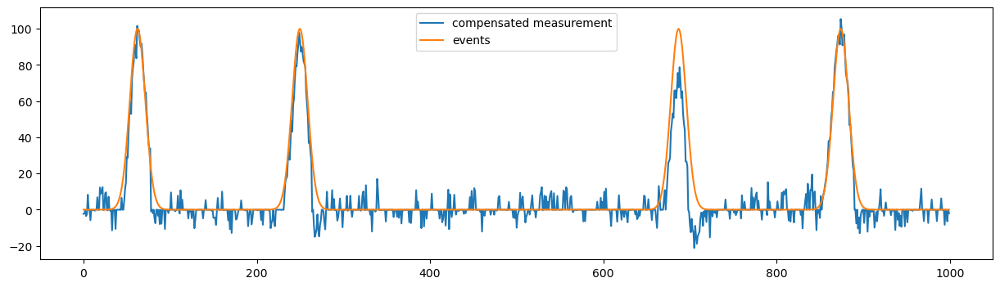

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00028338879040944333, 'q_process_noise_0': 1.7838073874478113, 'loc': 2.826455248339855}
mse: 114.17376924997741


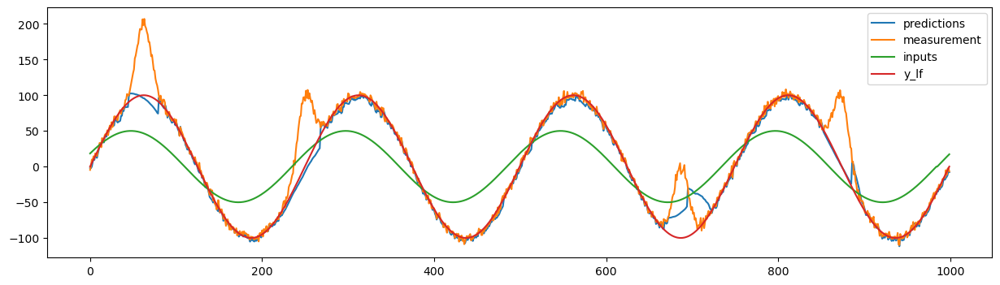

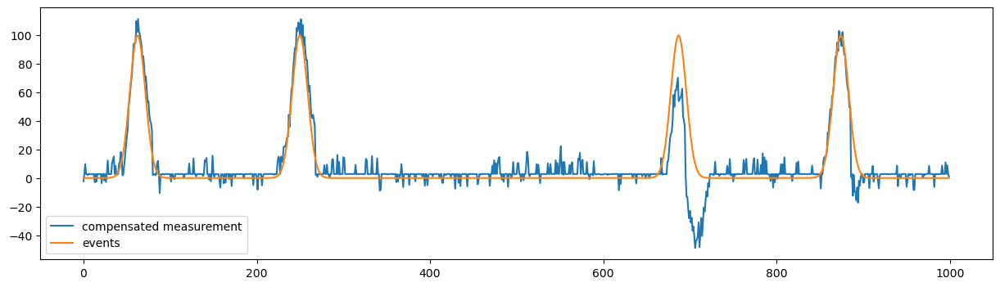

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.10604648435976725, 'q_process_noise_0': 2.344211193014217, 'loc': 0.5668631412455616}
mse: 149.22158222429465


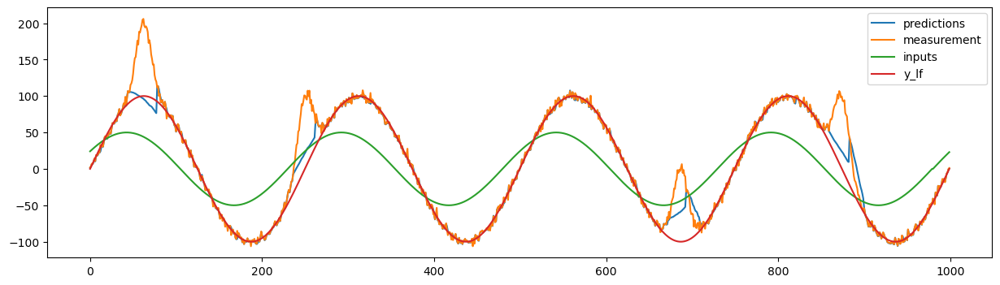

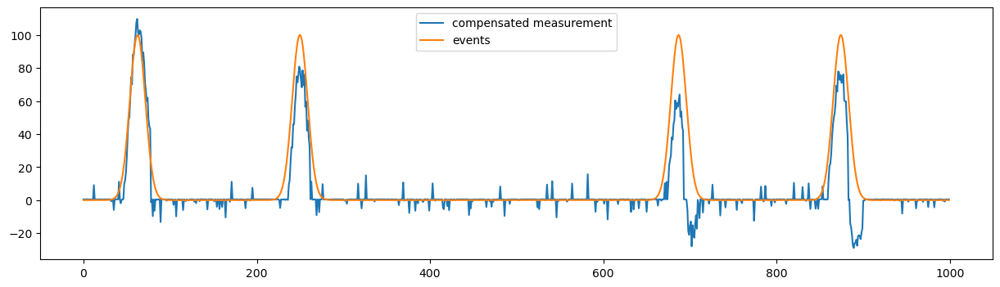

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.006933558460762266, 'q_process_noise_0': 0.8686073717870919, 'loc': 1.2909682891076555}
mse: 34.57856172878791


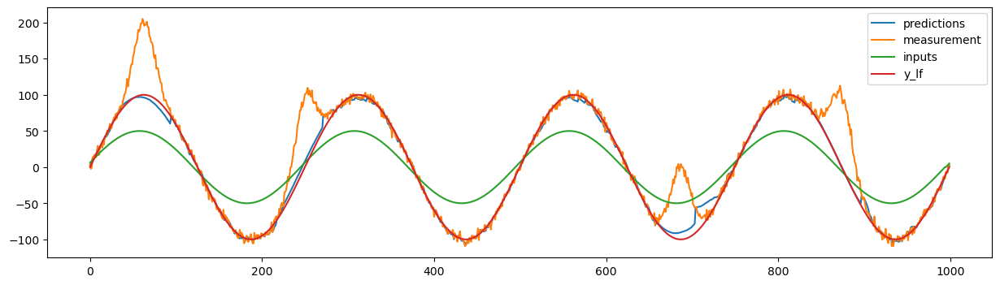

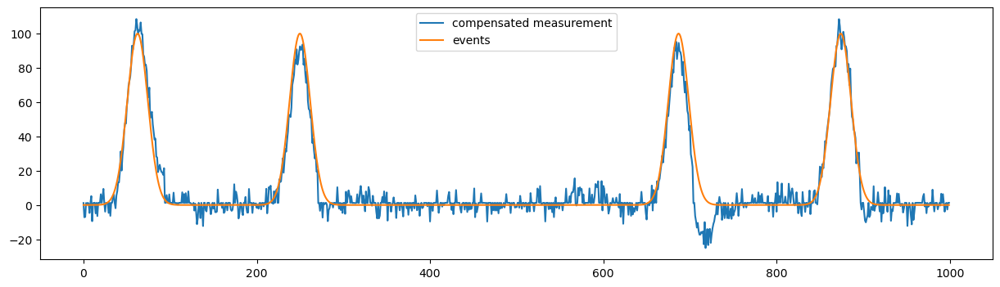

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.010960077448476014, 'q_process_noise_0': 1.6991332382697095, 'loc': 2.917779848025894}
mse: 80.0328840827873


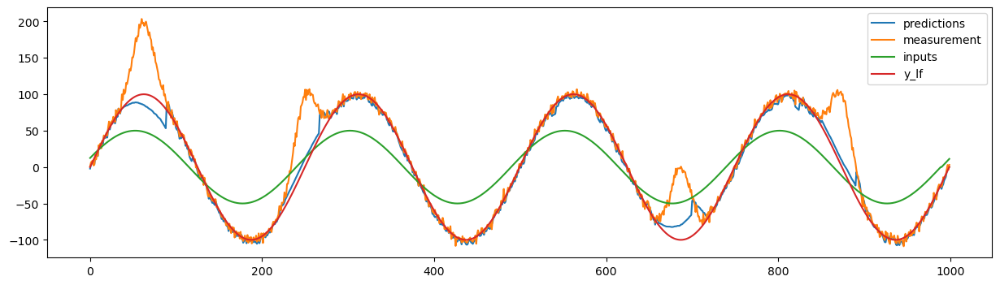

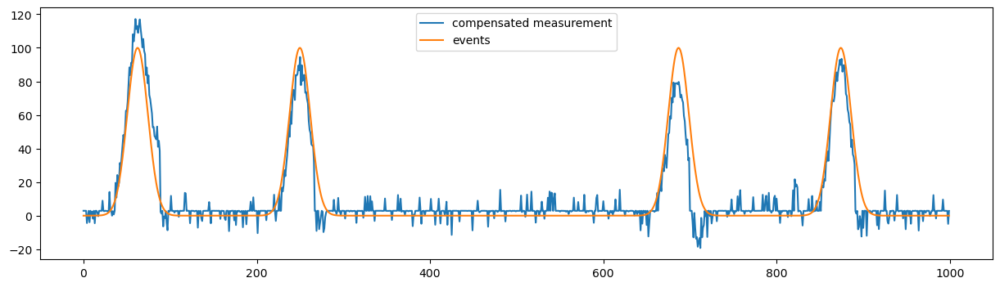

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.0008772984525591372, 'q_process_noise_0': 1.4702466230080458, 'loc': 6.1944356215262335}
mse: 316.8390107549465


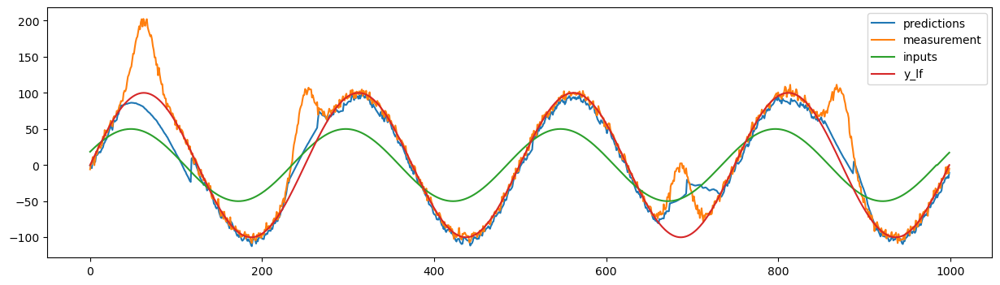

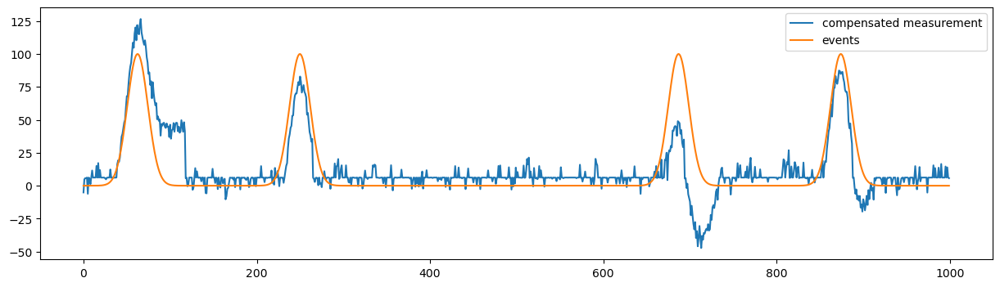

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.05974655492529191, 'q_process_noise_0': 1.6890766605617304, 'loc': 0.00013356672323990837}
mse: 446.26083255908503


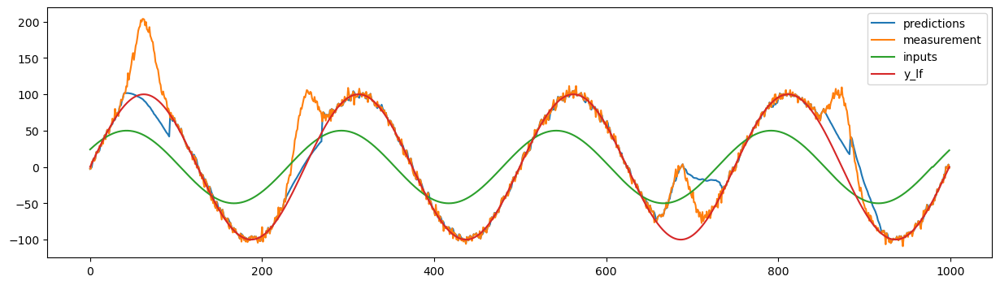

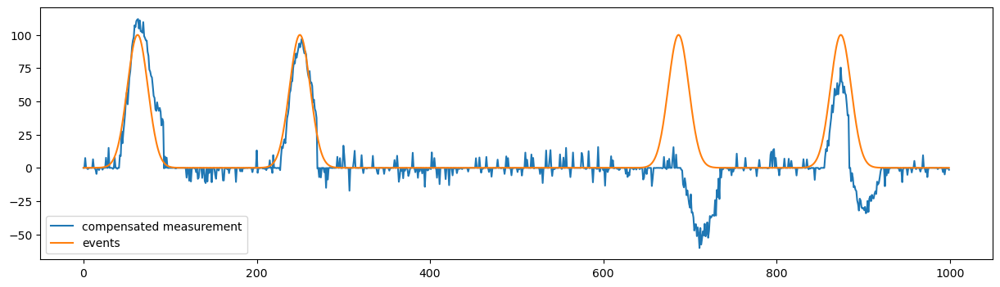

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0002785931892839395, 'q_process_noise_0': 0.93121406584434, 'loc': 0.00399287092774599}
mse: 95.55227825953197


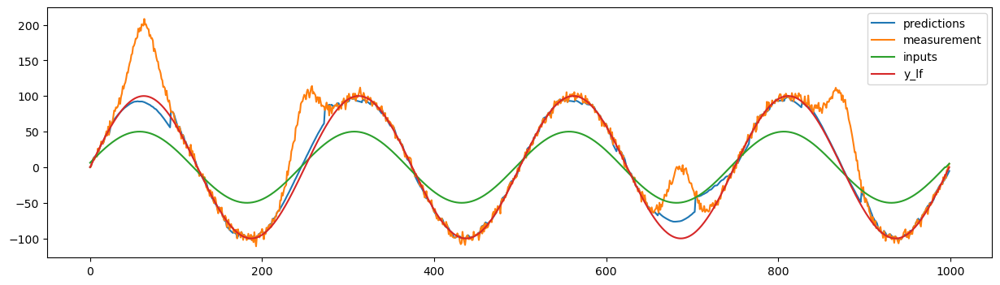

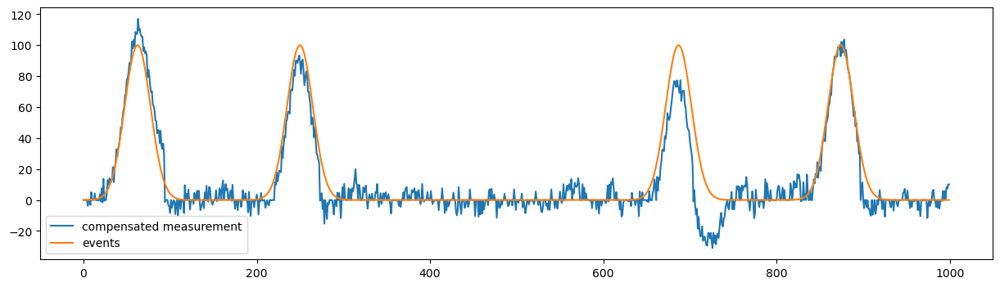

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.018406400648528682, 'q_process_noise_0': 1.3997243576725644, 'loc': 4.169214354479307}
mse: 210.41245093604056


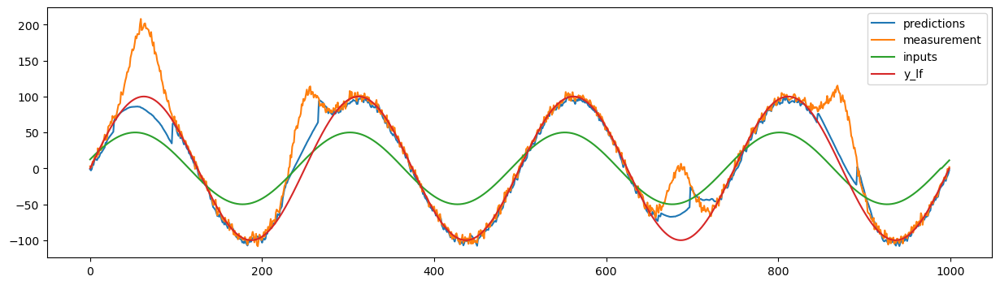

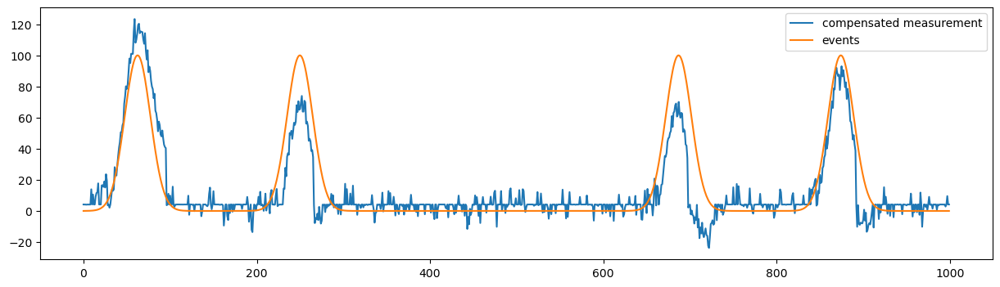

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00036467521221969815, 'q_process_noise_0': 1.4811785496872065, 'loc': 0.00695760379524442}
mse: 350.68928891158595


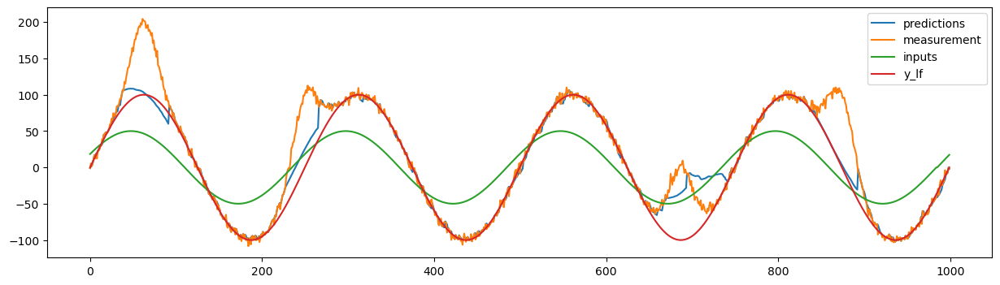

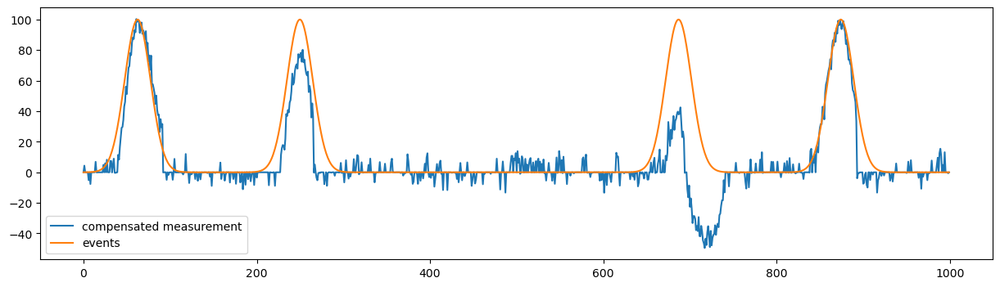

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0007779105411560223, 'q_process_noise_0': 1.9785325006381371, 'loc': 0.07729848781191771}
mse: 483.7950807605903


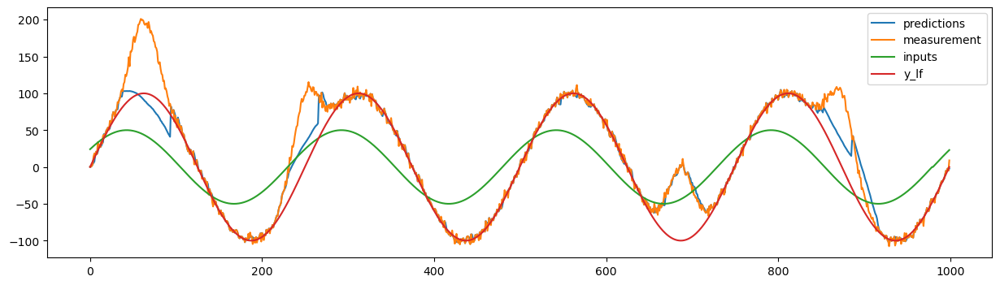

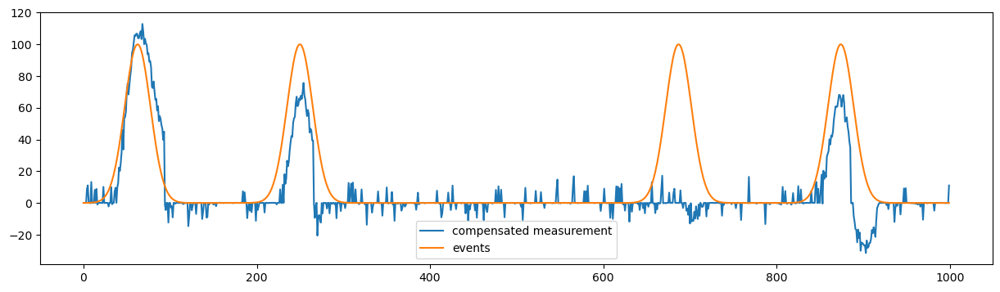

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.01510922896034135, 'q_process_noise_0': 0.8992590106500653, 'loc': 3.6164941033297633}
mse: 115.82867025879857


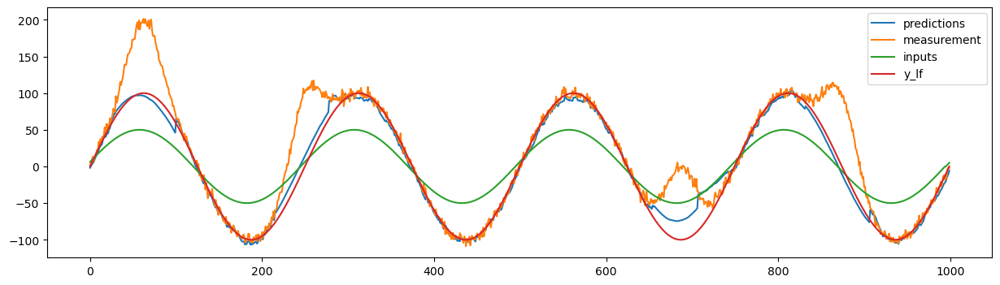

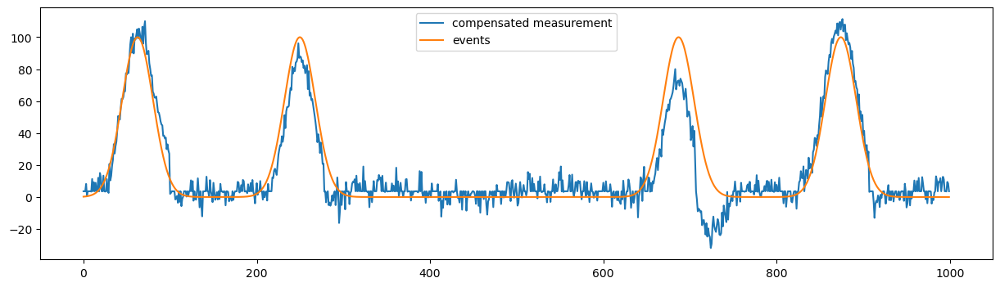

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.07683817605236107, 'q_process_noise_0': 0.8715735245479795, 'loc': 0.003925780858278524}
mse: 239.8082506066598


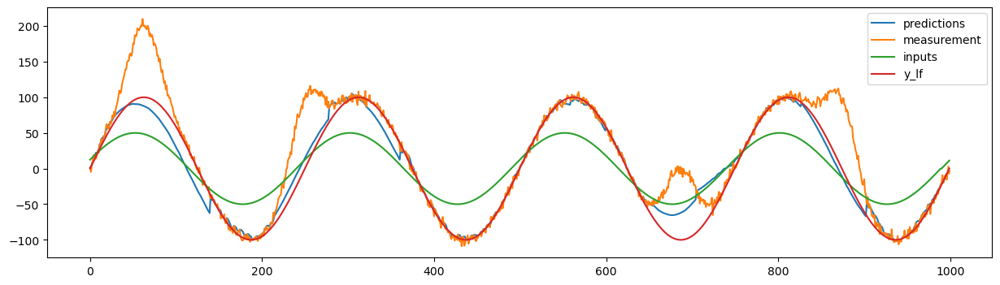

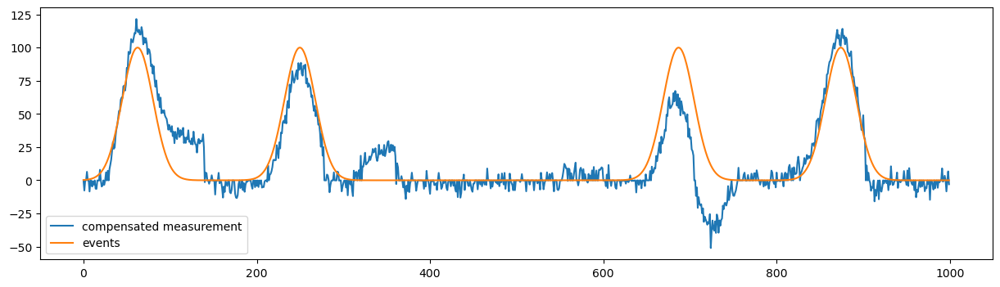

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.008557517513087129, 'q_process_noise_0': 1.685471763853505, 'loc': 8.540913608114671}
mse: 423.62424207493746


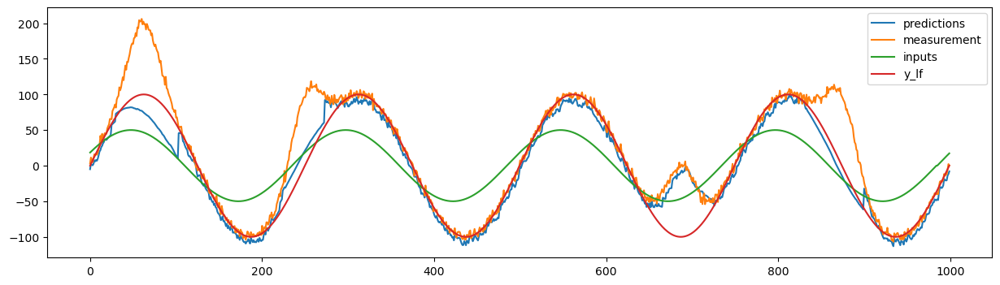

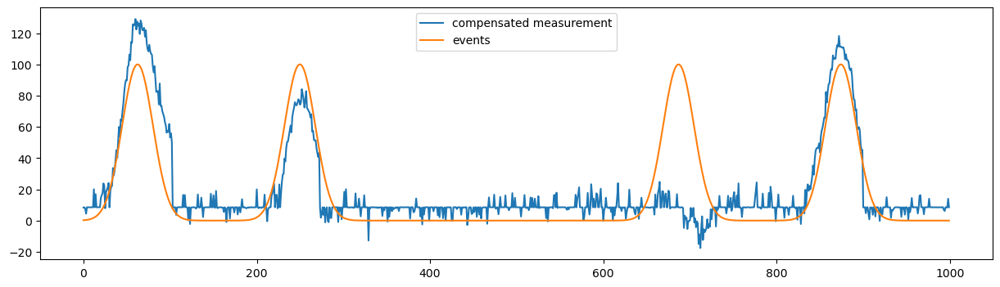

event_to_trend_amplitude: 0.5 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0011303205807816857, 'q_process_noise_0': 1.9310733720348934, 'loc': 16.4234272726691}
mse: 752.0945291000538


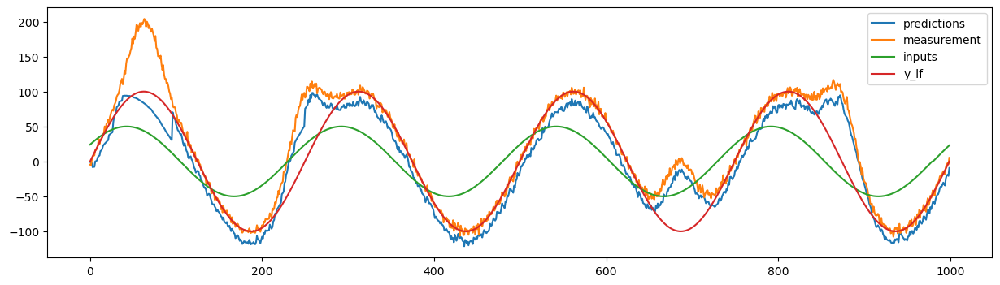

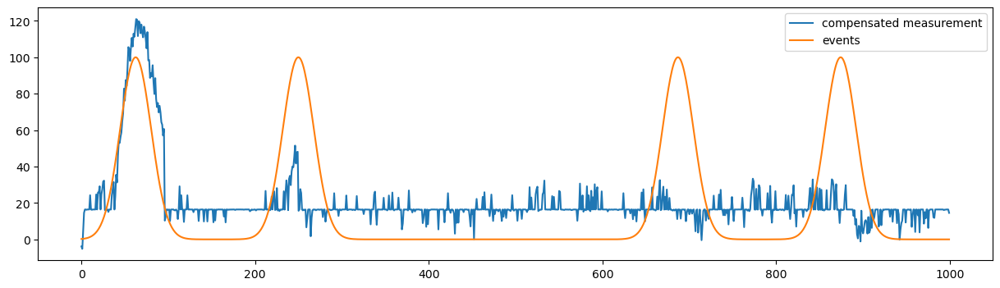

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.8724996724619908, 'q_process_noise_0': 0.8612764012088809, 'loc': 1.9247962031960777}
mse: 8.104436910962358


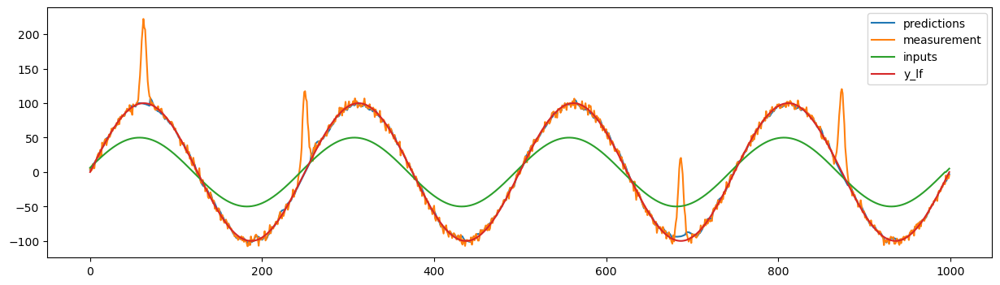

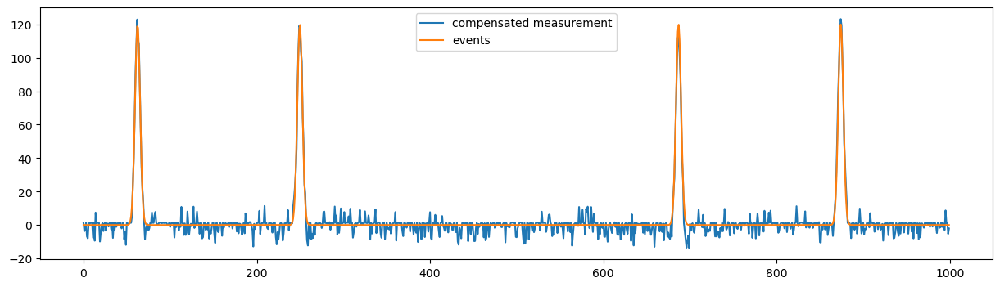

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.31491601856828055, 'q_process_noise_0': 0.9934420585951649, 'loc': 0.013077225039937615}
mse: 18.2956164813004


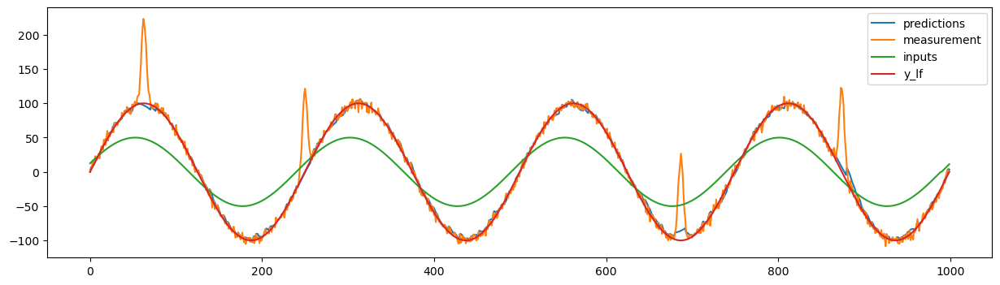

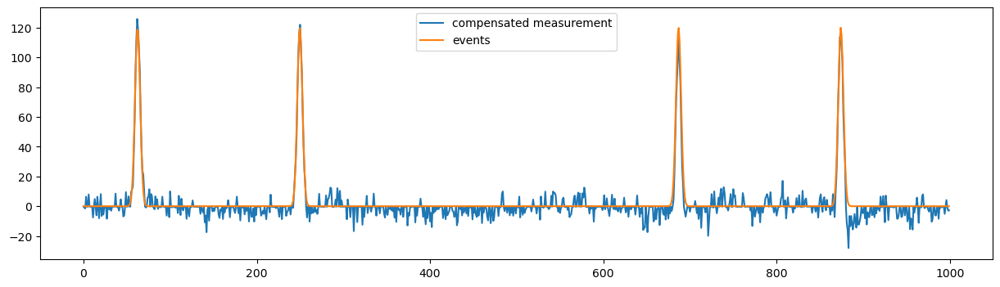

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.08369893498302697, 'q_process_noise_0': 1.7795333992231486, 'loc': 1.038466808843222}
mse: 21.4897087169749


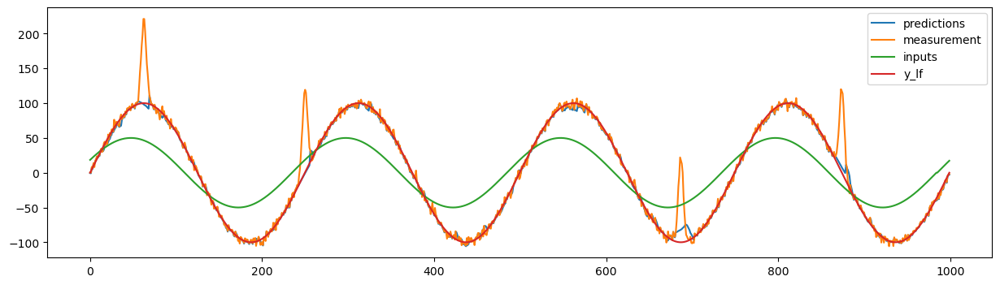

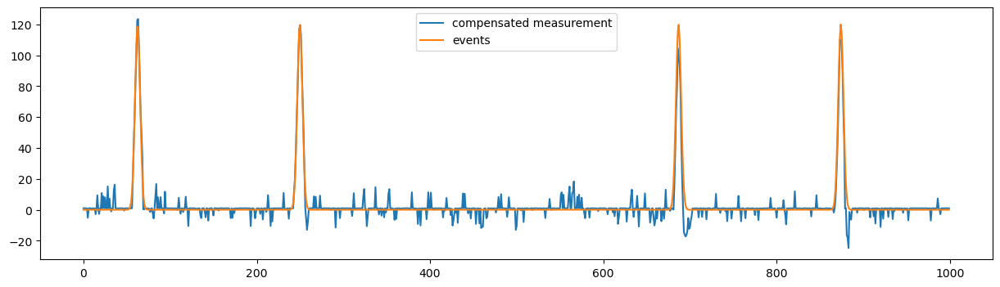

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.1 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.005797583099718867, 'q_process_noise_0': 1.683763372023417, 'loc': 0.0361412940528219}
mse: 480.9100625000775


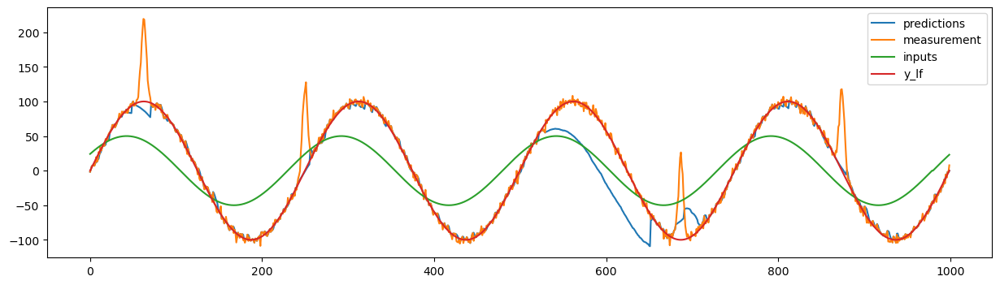

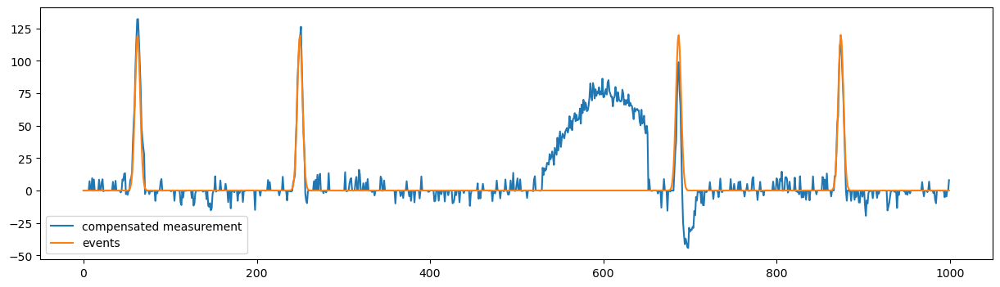

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0023715509267326993, 'q_process_noise_0': 1.121643320439438, 'loc': 0.8816730668061901}
mse: 17.861258085789242


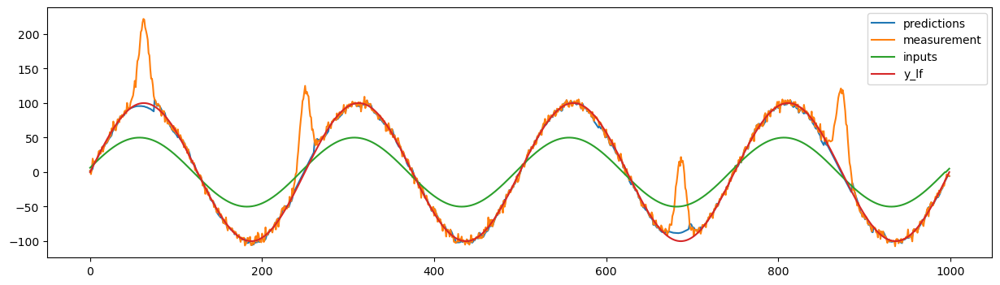

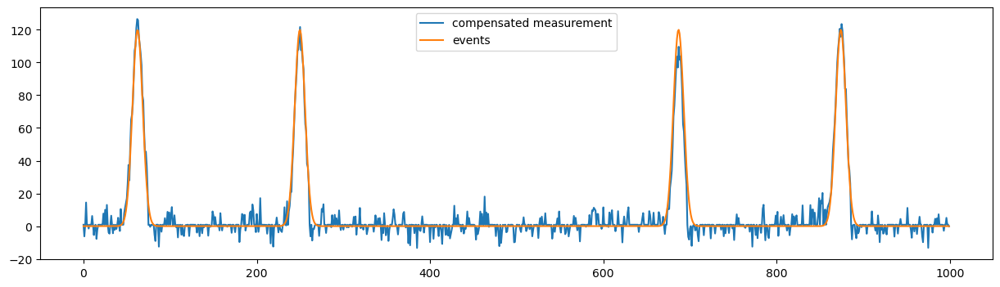

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.5772140713377698, 'q_process_noise_0': 0.8879668450828613, 'loc': 3.2056891441167026}
mse: 21.83416229515813


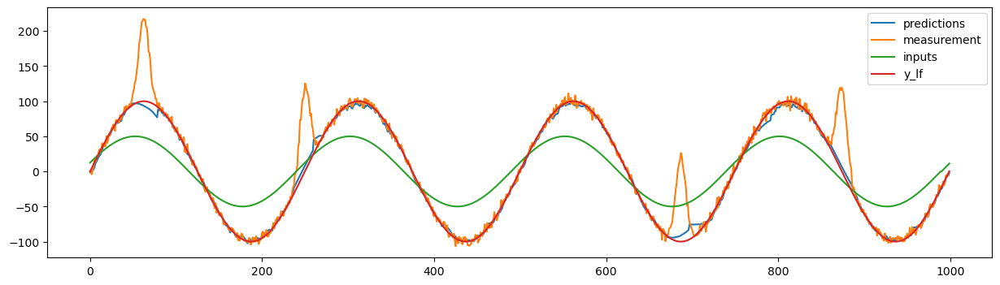

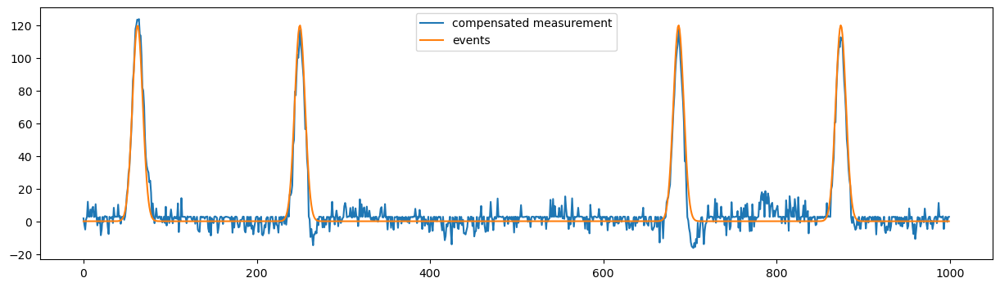

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.3425169310896252, 'q_process_noise_0': 1.6845474013801875, 'loc': 3.7560850318443437}
mse: 48.13734459551534


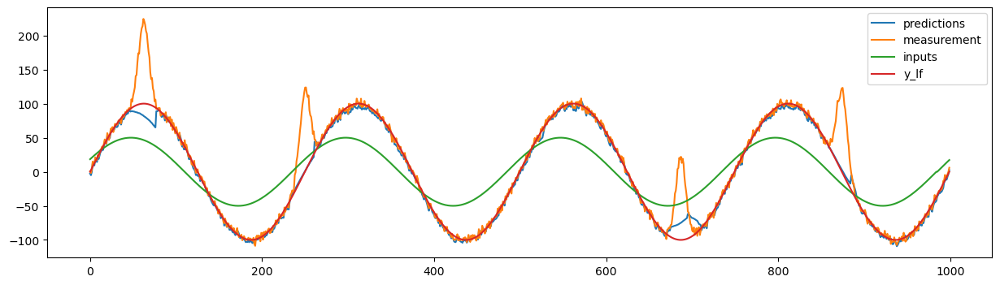

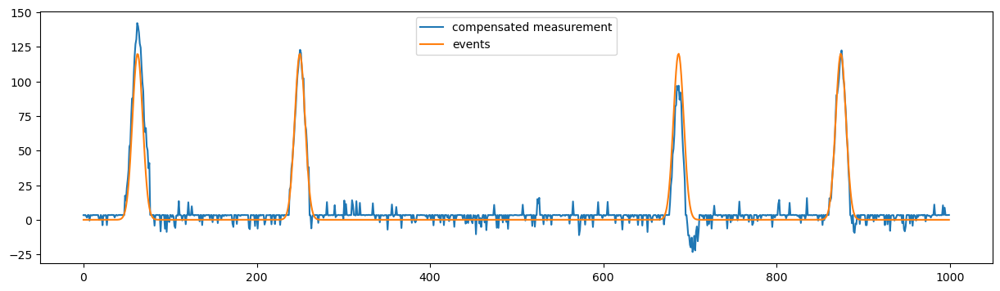

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.2 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.0009466637199310604, 'q_process_noise_0': 2.1219870924687187, 'loc': 0.06825025413369525}
mse: 61.9653457209596


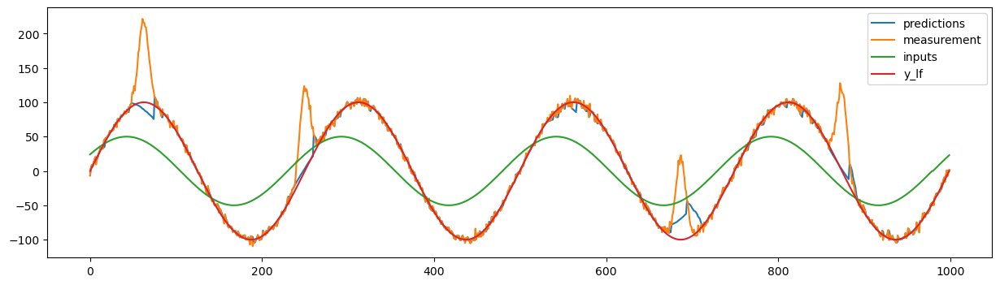

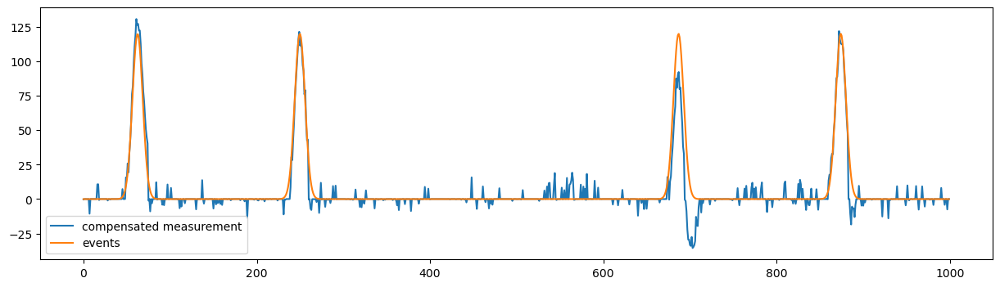

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.00023570341759833585, 'q_process_noise_0': 0.7917150524554752, 'loc': 0.49417174024112487}
mse: 46.824762750101996


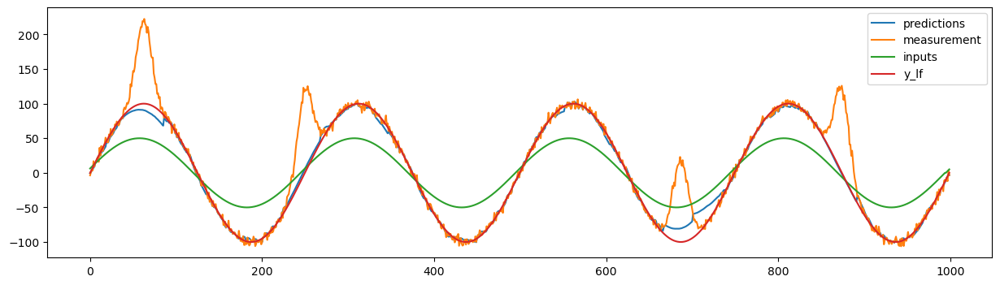

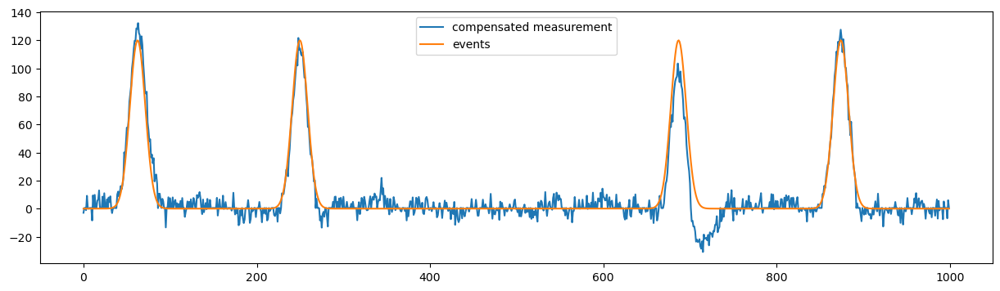

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.4300121979347207, 'q_process_noise_0': 1.2105441617843933, 'loc': 0.0002192777186678868}
mse: 79.77442348885126


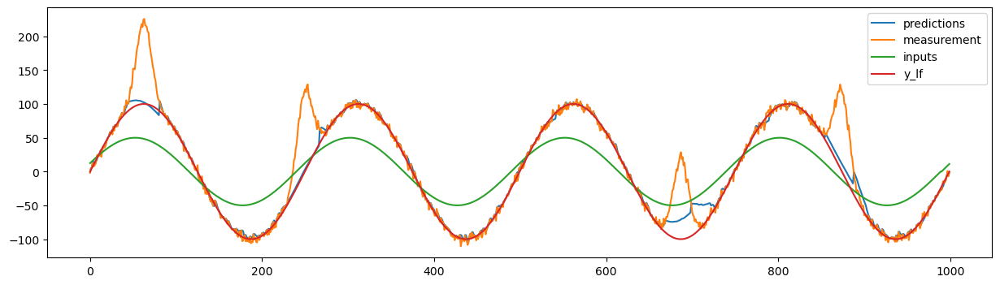

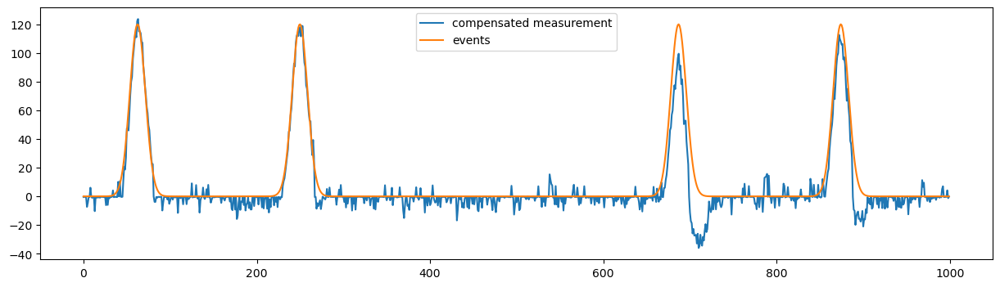

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 1.1950949568051588, 'q_process_noise_0': 1.1124671382683862, 'loc': 3.1097969396351886}
mse: 86.26089793805647


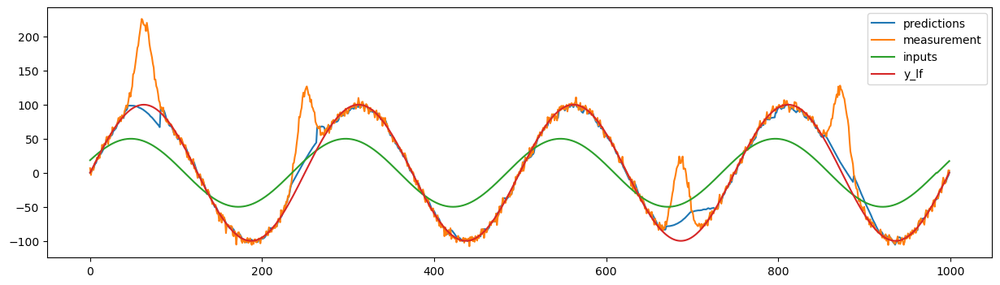

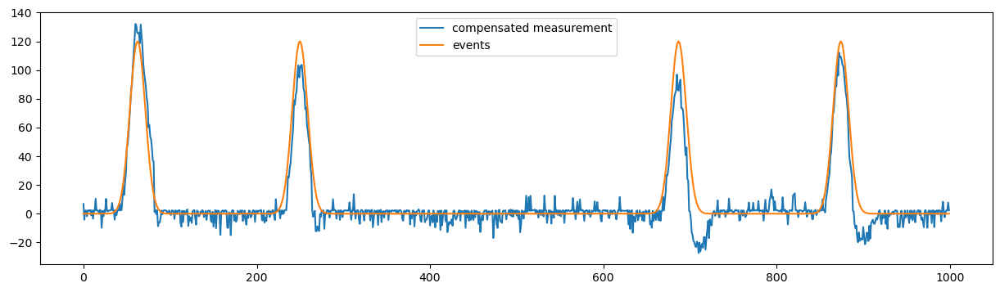

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.30000000000000004 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.6223141795332625, 'q_process_noise_0': 1.6529737190121028, 'loc': 0.0016109275994554936}
mse: 204.14796656196302


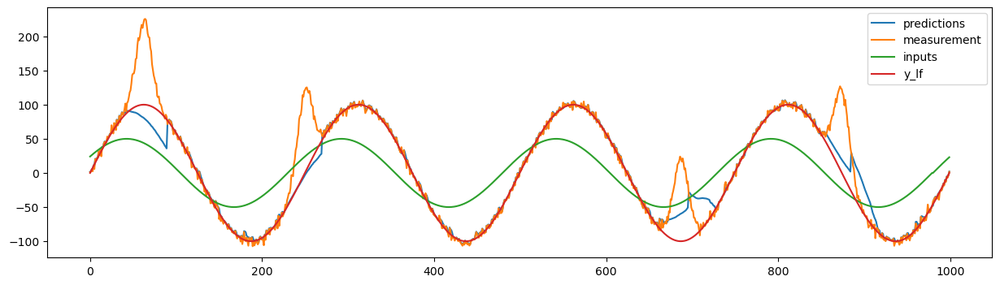

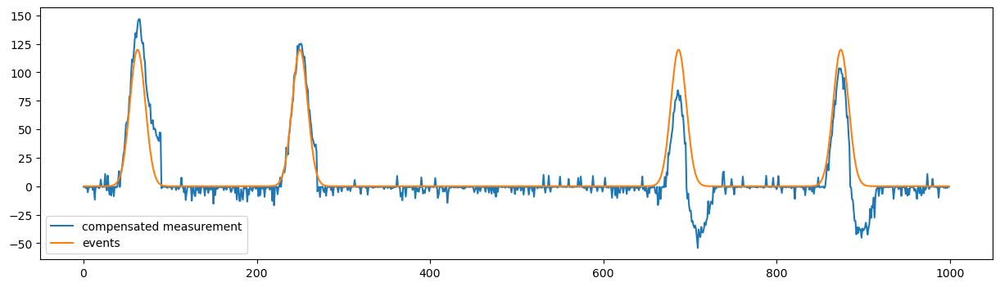

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0008816584955985574, 'q_process_noise_0': 0.884336178871215, 'loc': 0.0011863226534180487}
mse: 28.487097520648863


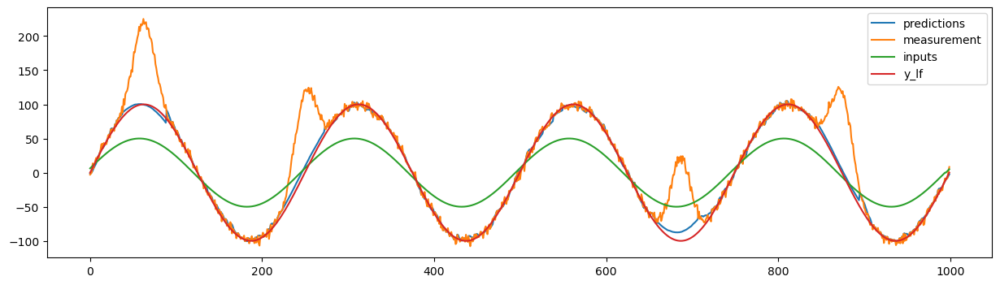

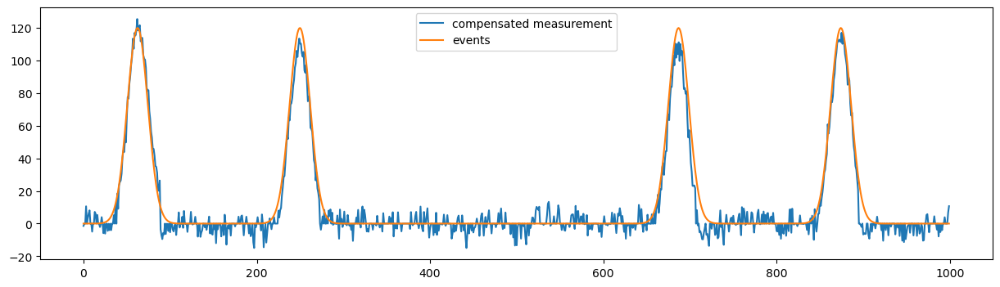

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.5890023849050372, 'q_process_noise_0': 1.0587519045311669, 'loc': 0.014102203310579597}
mse: 208.66061495784302


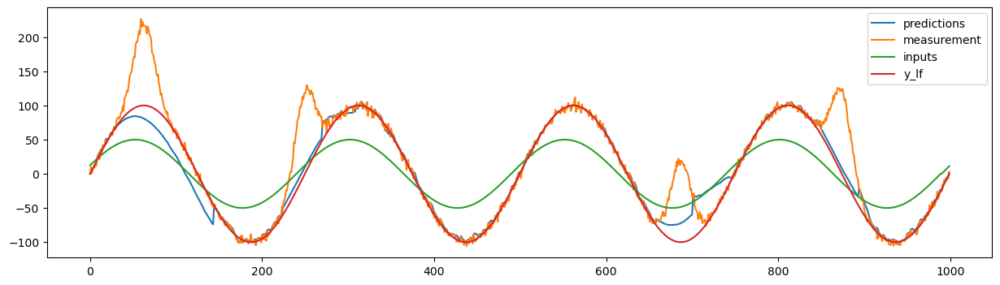

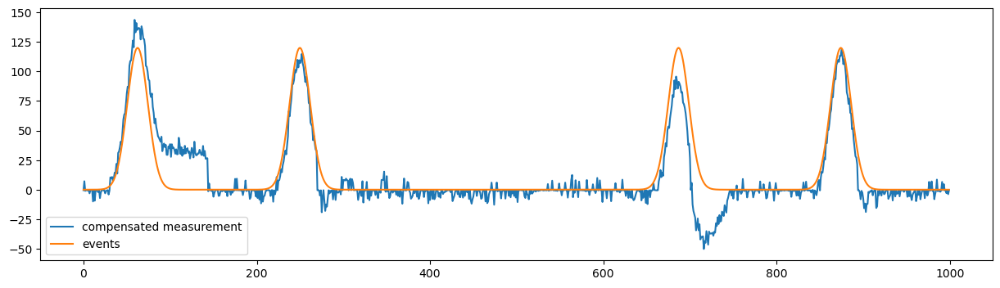

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00234401978252222, 'q_process_noise_0': 1.3373548934398203, 'loc': 3.238230771183769}
mse: 304.44084355906074


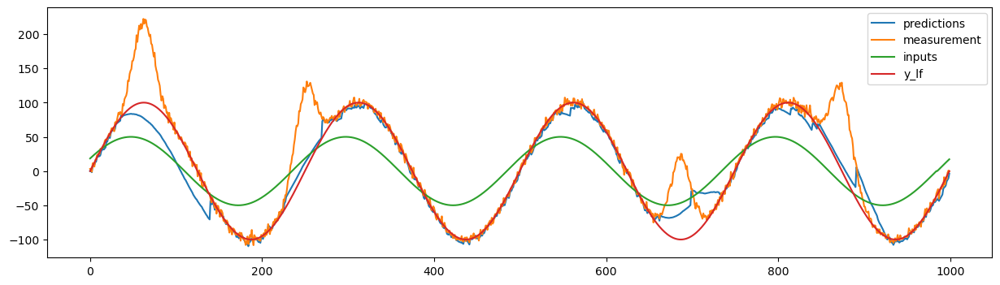

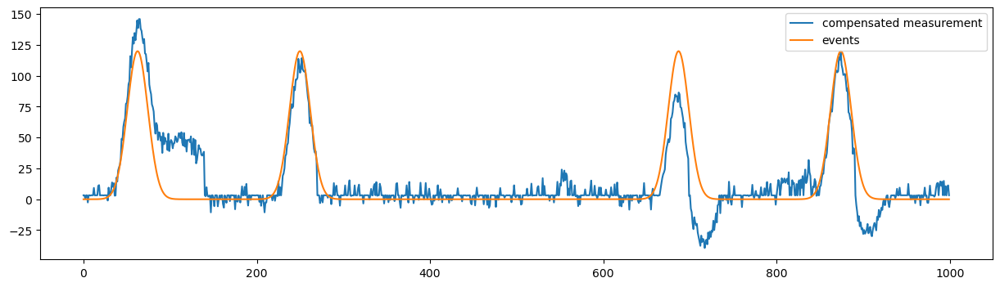

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.4 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.07792999800421956, 'q_process_noise_0': 1.955011895989783, 'loc': 0.15182803439013978}
mse: 505.8184343246008


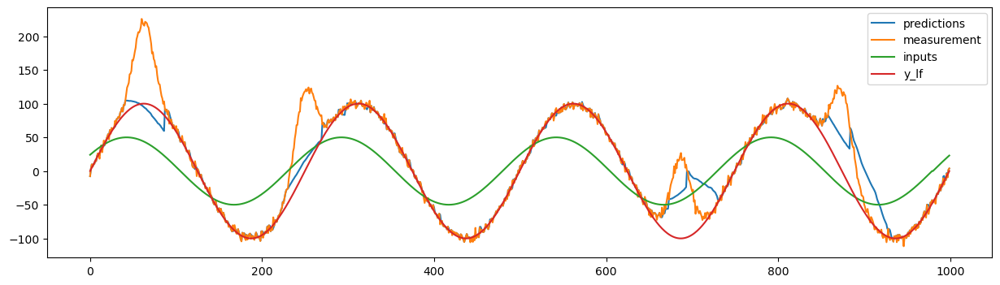

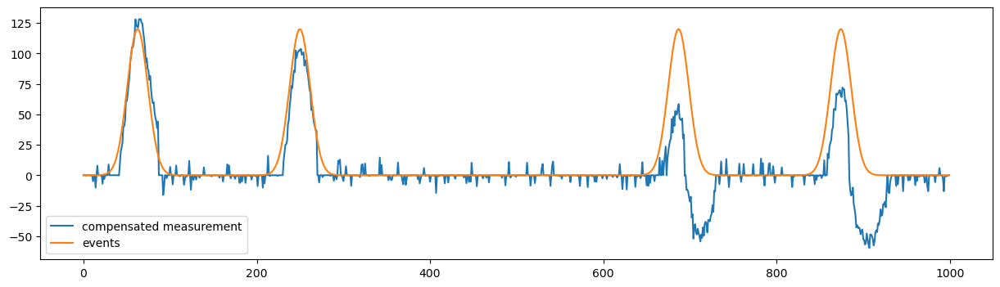

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.025629047790814083, 'q_process_noise_0': 0.9003397426248576, 'loc': 0.0010395754080602055}
mse: 59.890836074323225


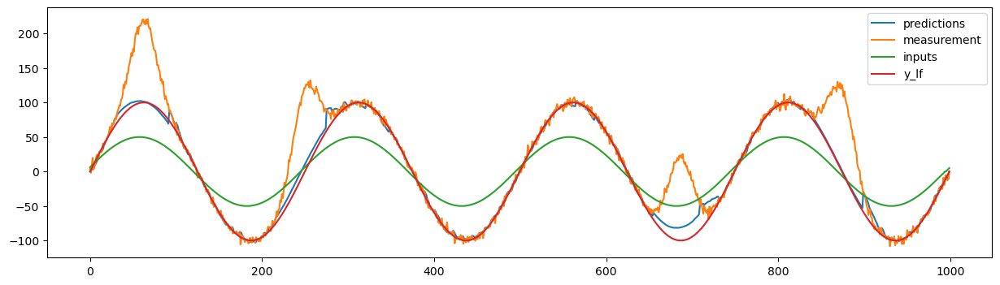

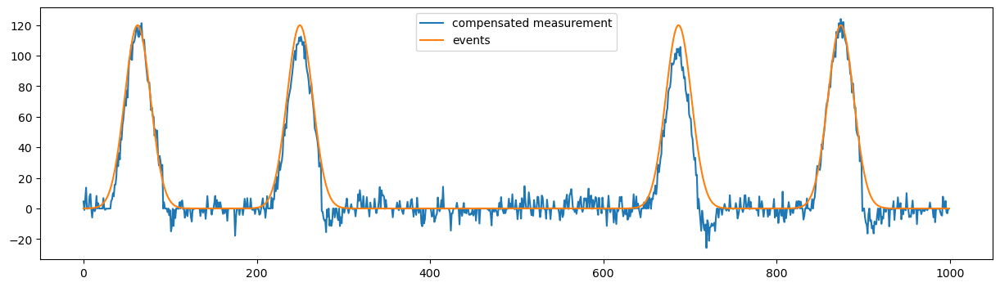

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.005722178303774132, 'q_process_noise_0': 1.29071422275699, 'loc': 1.7800963374363532}
mse: 221.06851560238488


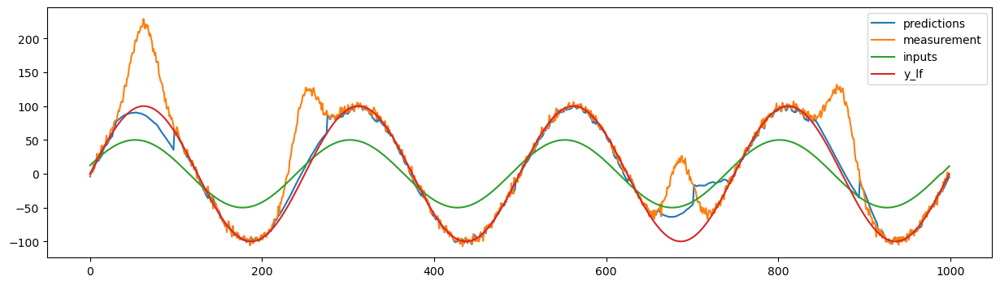

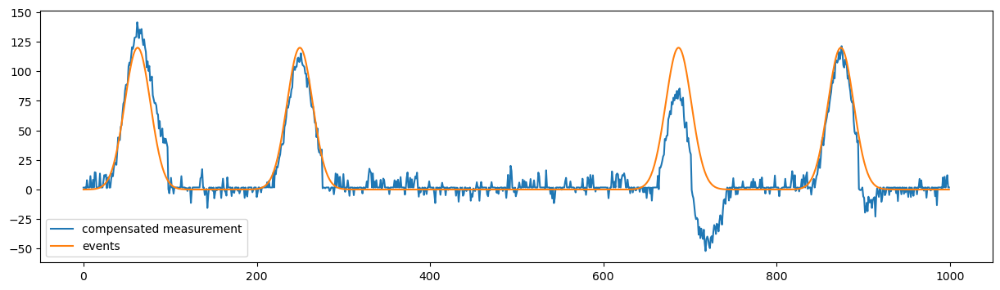

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00017958197649167642, 'q_process_noise_0': 1.340387260317291, 'loc': 0.00010749001299604005}
mse: 290.28653009639135


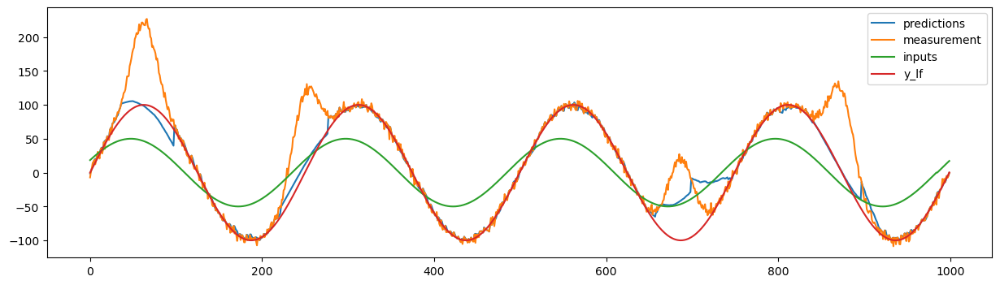

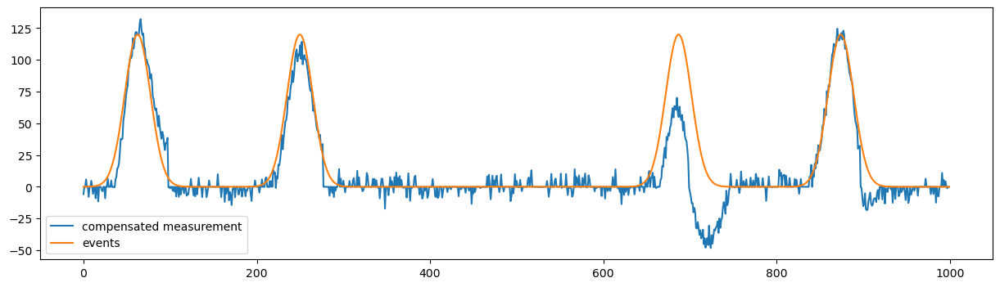

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.5 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.02723488889918562, 'q_process_noise_0': 1.9696475206667348, 'loc': 0.010661771504819397}
mse: 650.1653302393568


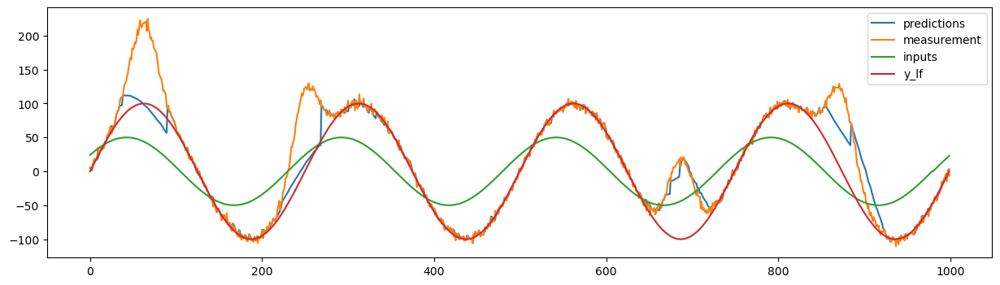

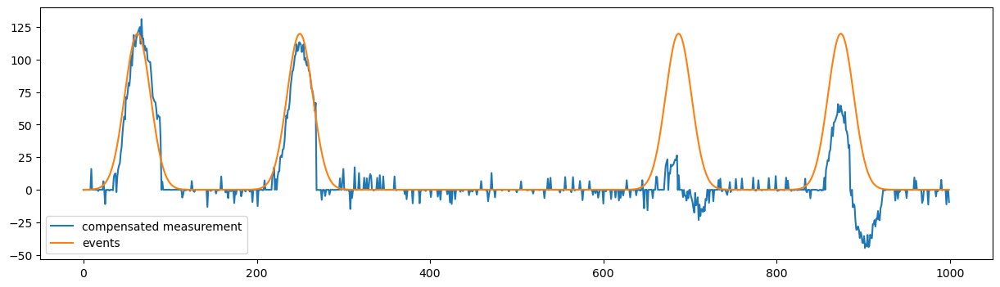

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.005
optimal parameters: {'r_measurement_noise': 0.0020961986139450893, 'q_process_noise_0': 0.8934487482656687, 'loc': 0.003523035466347345}
mse: 74.17564399537648


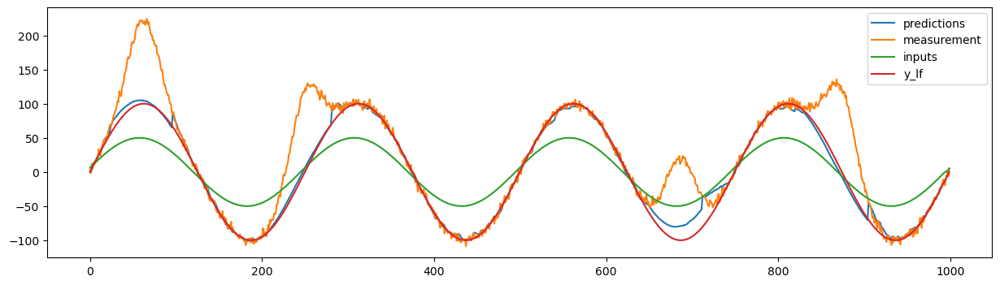

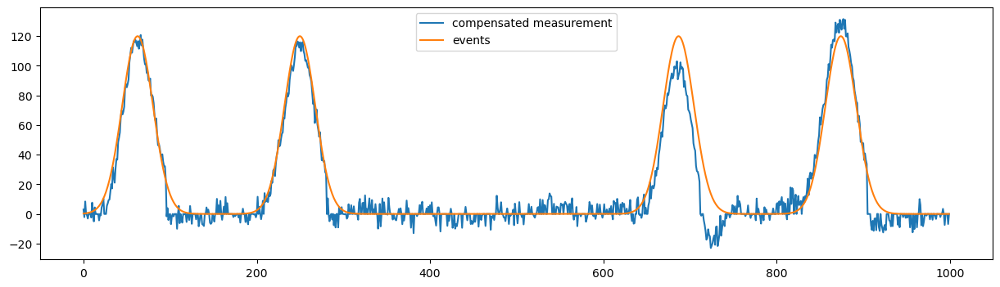

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.01
optimal parameters: {'r_measurement_noise': 0.00045268740393254855, 'q_process_noise_0': 1.2968960276694659, 'loc': 0.11981379485251124}
mse: 252.57252459450078


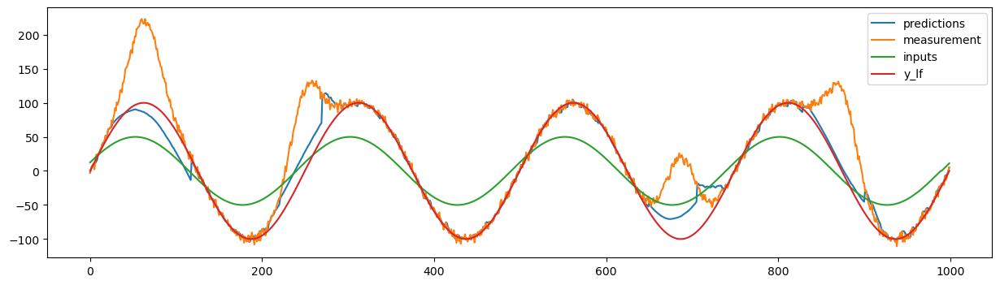

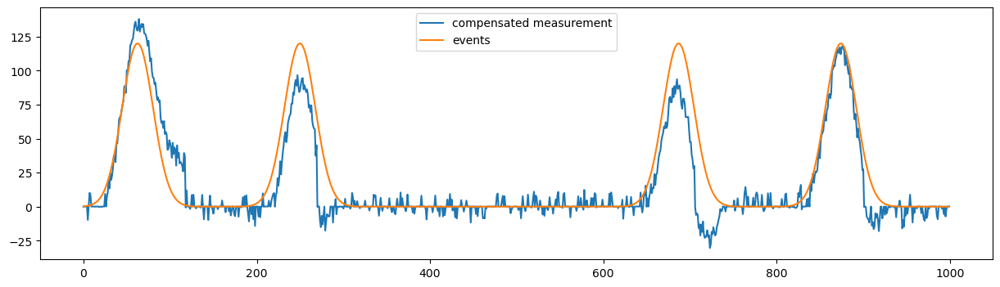

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.015
optimal parameters: {'r_measurement_noise': 0.00016163601456419482, 'q_process_noise_0': 2.072831209824439, 'loc': 1.9840580812693078}
mse: 334.93027944553234


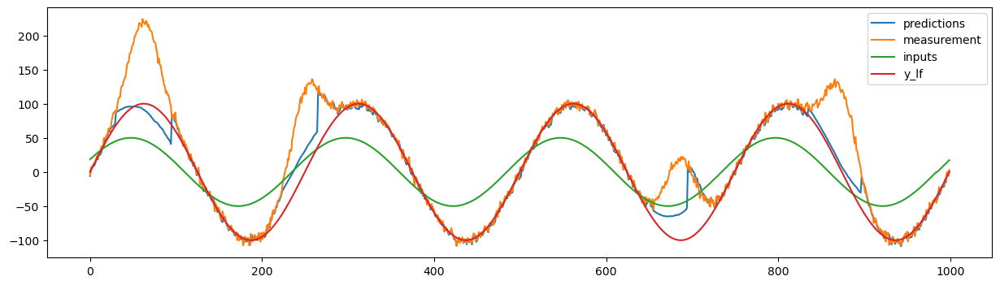

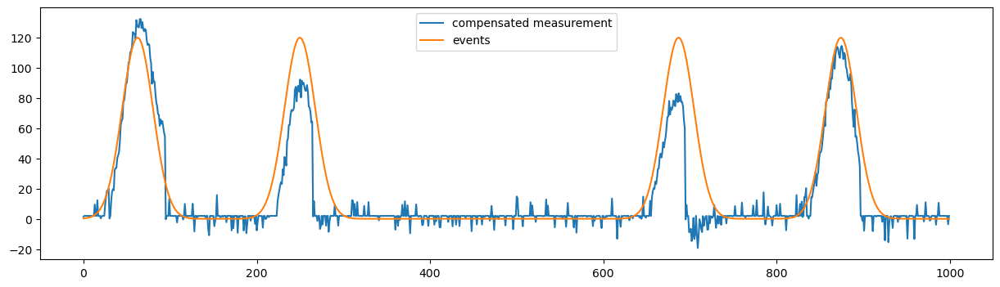

event_to_trend_amplitude: 0.6 , event_length_to_trend_period: 0.6 , time_shift: 0.02
optimal parameters: {'r_measurement_noise': 0.010575767329454144, 'q_process_noise_0': 1.6541378225544718, 'loc': 0.008378409382239655}
mse: 599.4449592512339


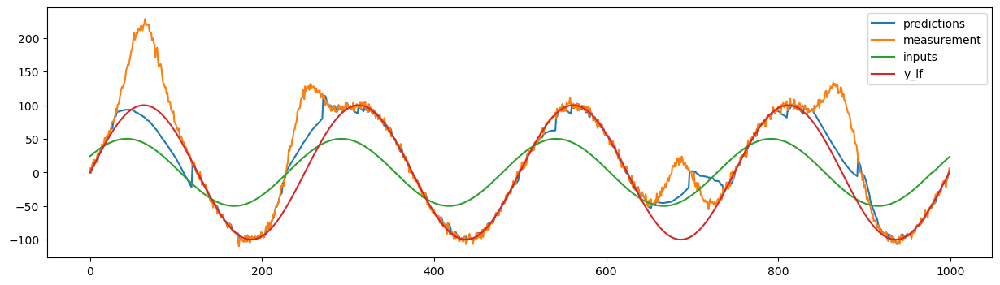

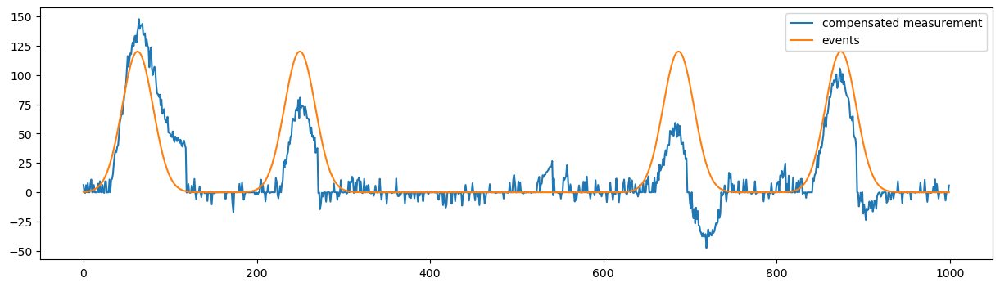

In [8]:
for key in best_params.keys():
    print('event_to_trend_amplitude:', key[0], ', event_length_to_trend_period:', key[1], ', time_shift:', key[2])
    print('optimal parameters:', best_params[key])

    inputs = np.vstack([datasets[key]['input_'], np.insert(np.diff(datasets[key]['input_']),0,0)])
    measurement = datasets[key]['y_measurements']
    y_lf = datasets[key]['y_lf']
    
    pf_alpha = learn_alpha(inputs[0].reshape(-1, 1), measurement)
    # Suggest values for the hyperparameters
    num_particles = 1000 # best_params[key]['num_particles']
    r_measurement_noise = best_params[key]['r_measurement_noise']
    q_process_noise_0 = best_params[key]['q_process_noise_0']
    loc = best_params[key]['loc']
    
    pf = ParticleFilter(
        num_particles=num_particles,
        r_measurement_noise=r_measurement_noise,
        q_process_noise=np.array([q_process_noise_0, 1]),
        loc=-loc,
        alpha=pf_alpha
    )
    predictions = pf.filter(measurement, inputs, loading=loading)
    print('mse:', mean_squared_error(predictions, y_lf))
    plt.figure(figsize=(15, 4))
    plt.plot(predictions, label='predictions')
    plt.plot(measurement, label='measurement')
    plt.plot(inputs[0], label='inputs')
    plt.plot(y_lf, label='y_lf')
    plt.legend()
    plt.show()
    plt.close()
    plt.figure(figsize=(15, 4))
    plt.plot(measurement-predictions, label='compensated measurement')
    plt.plot(datasets[key]['y_events'], label='events')
    plt.legend()
    plt.show()
    plt.close()

In [9]:
import pandas as pd
parameters = pd.DataFrame(index=[i for i in range(len(list(best_params.keys())))],
                          columns=['event_to_trend_amplitude', 'event_length_to_trend_period', 'time_shift', 'r_measurement_noise', 'q_process_noise_0', 'loc', 'mse'])
for i, key in enumerate(list(best_params.keys())):
    parameters['event_to_trend_amplitude'][i] = key[0]
    parameters['event_length_to_trend_period'][i] = key[1]
    parameters['time_shift'][i] = key[2]
    #parameters['num_particles'][i] = best_params[key]['num_particles']
    parameters['r_measurement_noise'][i] = best_params[key]['r_measurement_noise']
    parameters['q_process_noise_0'][i] = best_params[key]['q_process_noise_0']
    parameters['loc'][i] = best_params[key]['loc']
    parameters['mse'][i] = studies[key].best_trial.values[0]

In [10]:
parameters

,event_to_trend_amplitude,event_length_to_trend_period,time_shift,r_measurement_noise,q_process_noise_0,loc,mse
0,0.1,0.1,0.005,0.211458,0.791115,1.958288,7.704022
1,0.1,0.1,0.01,0.042947,1.081761,0.002201,15.137852
2,0.1,0.1,0.015,0.95413,1.485754,0.402592,13.375947
3,0.1,0.1,0.02,0.055286,1.674904,0.034239,16.712448
4,0.1,0.2,0.005,0.00167,0.971348,0.747743,15.913205
...,...,...,...,...,...,...,...
139,0.6,0.5,0.02,0.027235,1.969648,0.010662,451.017155
140,0.6,0.6,0.005,0.002096,0.893449,0.003523,69.069584
141,0.6,0.6,0.01,0.000453,1.296896,0.119814,213.893347
142,0.6,0.6,0.015,0.000162,2.072831,1.984058,288.473836


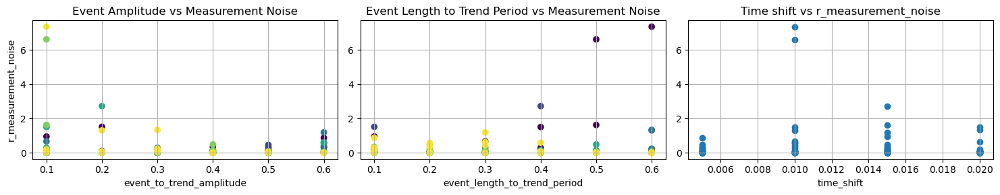

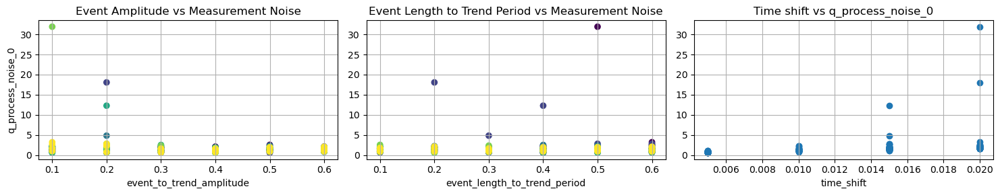

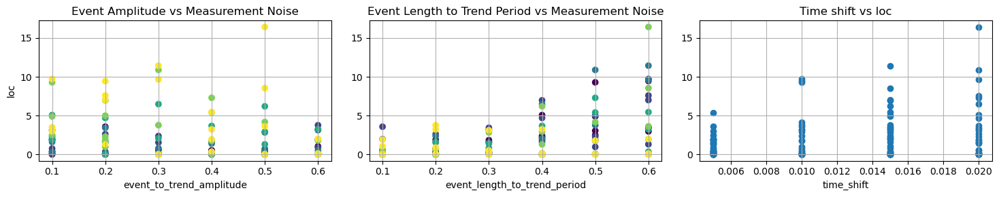

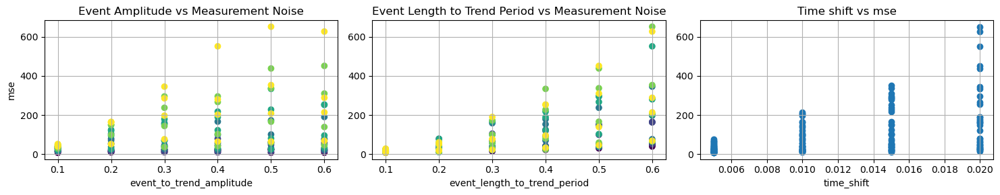

In [11]:
# Create a figure and a set of subplots
y_param = 'r_measurement_noise'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+ y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

# Create a figure and a set of subplots
y_param = 'q_process_noise_0'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+ y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

# Create a figure and a set of subplots
y_param = 'loc'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

# Create a figure and a set of subplots
y_param = 'mse'
fig, axs = plt.subplots(1, 3, figsize=(15, 3))  # 1 row, 2 columns, optional figure size
# First subplot
axs[0].scatter(parameters['event_to_trend_amplitude'], parameters[y_param], 
               marker='o', c=parameters['event_length_to_trend_period'])
axs[0].set_xlabel('event_to_trend_amplitude')
axs[0].set_ylabel(y_param)
axs[0].set_title('Event Amplitude vs Measurement Noise')
axs[0].grid()
# Second subplot
axs[1].scatter(parameters['event_length_to_trend_period'], parameters[y_param], 
               marker='o', c=parameters['event_to_trend_amplitude'])
axs[1].set_xlabel('event_length_to_trend_period')
axs[1].set_title('Event Length to Trend Period vs Measurement Noise')
axs[1].grid()
# Third subplot
axs[2].scatter(parameters['time_shift'], parameters[y_param], 
               marker='o')
axs[2].set_xlabel('time_shift')
axs[2].set_title('Time shift vs '+ y_param)
axs[2].grid()
# Display the figure
plt.tight_layout()  # Adjusts the subplots to fit into the figure area
plt.show()

In [12]:
from optuna.visualization import *
for key in studies.keys():
    print('event_to_trend_amplitude:', key[0], 'event_length_to_trend_period:', key[1])
    print('optimal parameters:', best_params[key])
    plot_slice(studies[key])
    plt.show()

event_to_trend_amplitude: 0.1 event_length_to_trend_period: 0.1
optimal parameters: {'r_measurement_noise': 0.211457751135852, 'q_process_noise_0': 0.7911146598499116, 'loc': 1.9582876842846466}
event_to_trend_amplitude: 0.1 event_length_to_trend_period: 0.1
optimal parameters: {'r_measurement_noise': 0.0429472065610635, 'q_process_noise_0': 1.0817609360183362, 'loc': 0.002200899880678545}
event_to_trend_amplitude: 0.1 event_length_to_trend_period: 0.1
optimal parameters: {'r_measurement_noise': 0.9541295854135675, 'q_process_noise_0': 1.485753938427808, 'loc': 0.40259219172790495}
event_to_trend_amplitude: 0.1 event_length_to_trend_period: 0.1
optimal parameters: {'r_measurement_noise': 0.055286171265107674, 'q_process_noise_0': 1.6749043294072727, 'loc': 0.03423898804244601}
event_to_trend_amplitude: 0.1 event_length_to_trend_period: 0.2
optimal parameters: {'r_measurement_noise': 0.0016704437448000903, 'q_process_noise_0': 0.9713481207216025, 'loc': 0.7477427162885852}
event_to_tren

In [13]:
keys_ = list(studies.keys())

In [14]:
keynr = 140
print(keys_[keynr])
plot_slice(studies[keys_[keynr]])

(0.6, 0.6, 0.005)
